In [1]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-5-10')]

In [4]:
df_radon.keys()

dict_keys(['48', '9'])

In [5]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6243 entries, 0 to 6242
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     6243 non-null   object        
 1   DeviceName   6243 non-null   object        
 2   SyncDate     6243 non-null   datetime64[ns]
 3   Radon        6243 non-null   float64       
 4   eC02         6243 non-null   int64         
 5   VOC          6243 non-null   int64         
 6   Temperature  6243 non-null   int64         
 7   AirPressure  6243 non-null   float64       
 8   Humidity     6243 non-null   int64         
 9   LogIndex     6243 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 536.5+ KB


In [7]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [8]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
6238,2022-05-10 04:21:23,57,76,30.18,4.20
6239,2022-05-10 03:21:23,58,75,30.18,4.00
6240,2022-05-10 02:21:23,59,74,30.18,4.00
6241,2022-05-10 01:21:23,59,74,30.19,3.90


In [9]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [10]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,77.50,55.08,30.21,6.90
2022-05-11,81.54,47.04,30.17,14.80
2022-05-12,82.92,45.33,30.09,17.04
2022-05-13,78.08,51.88,30.05,8.16
2022-05-14,81.52,51.70,30.01,10.77
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [11]:
df = df[df.index<= '2022-8-10']

In [12]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,77.50,55.08,30.21,6.90
2022-05-11,81.54,47.04,30.17,14.80
2022-05-12,82.92,45.33,30.09,17.04
2022-05-13,78.08,51.88,30.05,8.16
2022-05-14,81.52,51.70,30.01,10.77
...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75
2022-08-07,87.29,64.95,30.22,45.77
2022-08-08,88.26,66.61,30.15,59.79


In [13]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [14]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [15]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [16]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [17]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [18]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,77.50,55.08,30.21,6.90,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,81.54,47.04,30.17,14.80,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,82.92,45.33,30.09,17.04,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,78.08,51.88,30.05,8.16,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,81.52,51.70,30.01,10.77,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,87.29,64.95,30.22,45.77,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,88.26,66.61,30.15,59.79,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [19]:
df.dropna(inplace=True)

In [20]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,77.50,55.08,30.21,6.90,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,81.54,47.04,30.17,14.80,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,82.92,45.33,30.09,17.04,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,78.08,51.88,30.05,8.16,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,81.52,51.70,30.01,10.77,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,87.29,64.95,30.22,45.77,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,88.26,66.61,30.15,59.79,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [21]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [22]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [23]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,87.63,55.64,30.06,56.56,76.83,0.18,0.75,4.30,293.74,0.01,0.15,0.05,0.37,2.15,28.44,29.00,77.70,29.00,301.24,0.10
std,4.96,8.03,0.09,70.53,4.29,0.11,0.40,1.50,10.43,0.02,0.35,0.15,0.68,2.21,4.48,0.09,8.79,0.09,9.53,0.09
min,75.78,37.91,29.88,6.90,65.19,0.02,0.17,2.04,231.74,0.00,0.00,0.00,0.00,0.00,22.72,28.81,50.50,28.81,231.71,0.00
25%,83.96,50.79,29.99,17.66,74.01,0.11,0.51,3.33,288.05,0.00,0.00,0.00,0.00,0.64,25.40,28.93,72.20,28.93,298.84,0.04
50%,88.04,56.37,30.06,30.37,77.24,0.15,0.62,4.07,295.40,0.00,0.00,0.00,0.02,0.76,26.05,29.00,77.62,29.00,302.76,0.08
75%,91.22,62.26,30.13,65.23,79.63,0.24,0.94,5.02,300.25,0.00,0.09,0.01,0.40,3.43,31.96,29.07,83.47,29.07,306.52,0.13
max,98.30,70.00,30.22,436.68,86.16,0.65,2.44,9.81,310.53,0.08,2.11,0.74,2.67,8.01,37.50,29.16,93.24,29.16,314.83,0.45


In [24]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [25]:
df.fillna(0, inplace=True)

In [26]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Yearly Rain (in),0.60
Monthly Rain (in)_lag_1,0.59
Monthly Rain (in)_lag_2,0.57
Event Rain (in)_lag_31,0.56
...,...
Wind Gust (mph),-0.29
Wind Speed (mph)_lag_1,-0.29
Avg Wind Speed (10 mins) (mph),-0.29
Avg Wind Speed (10 mins) (mph)_lag_1,-0.31


In [27]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Yearly Rain (in) 0.5958521631031254
Monthly Rain (in)_lag_1 0.5852295908364143
Monthly Rain (in)_lag_2 0.5742058005692159
Event Rain (in)_lag_31 0.5614112738061603
Monthly Rain (in)_lag_3 0.5372133303110966
Yearly Rain (in)_lag_1 0.5272734207643083
Monthly Rain (in)_lag_4 0.5126620740198563
Monthly Rain (in)_lag_5 0.5006599136771896
Outdoor h Temperature (°F)_lag_39 0.4992967990835334
Outdoor h Temperature (°F)_lag_38 0.49719668566459585
Temperature_lag_39 0.4932410404090132
Temperature_lag_38 0.49260077115876233
Yearly Rain (in)_lag_39 0.4924014525835459
Yearly Rain (in)_lag_38 0.4844387116683301
Outdoor h Temperature (°F)_lag_37 0.4830869351573969
Temperature_lag_37 0.48003653079958897
Monthly Rain (in)_lag_6 0.47606433985041074
Yearly Rain (in)_lag_37 0.4749373339064221
Monthly Rain (in)_lag_9 0.4712733872134148
Yearly Rain (in)_lag_2 0.4700911708133699
Monthly Rain (in) 0.4677393232478944
Yearly Rain (in)_lag_36 0.467047342057633
Temperature_lag_36 0.4642451579219288
Outd

In [29]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.58]
df_corrH

,Radon
Radon,1.00
Yearly Rain (in),0.60
Monthly Rain (in)_lag_1,0.59


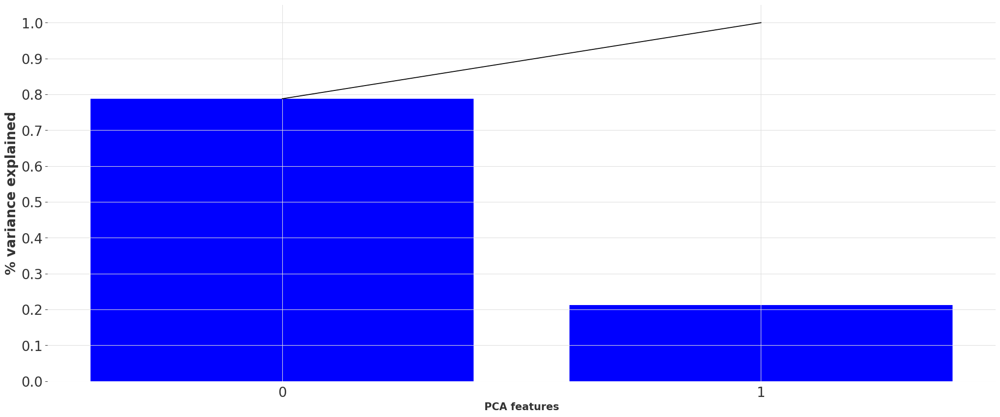

In [31]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=2)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [32]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1'], dtype='object')

In [33]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,0.67


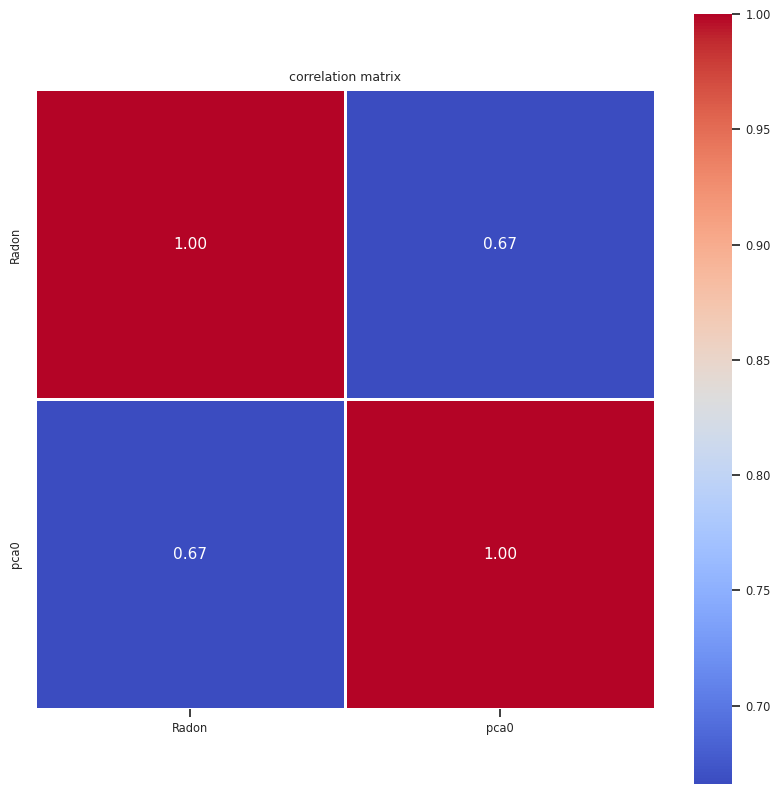

In [34]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [35]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [36]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [37]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [38]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [39]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [40]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-10 00:00:00
training end: 2022-07-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-07-23 00:00:00
test end: 2022-08-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-10,0.00
2022-08-10,0.25


In [41]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0
SyncDate,
2022-05-10,0.00
2022-08-10,0.88


In [42]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-10,0.00
2022-07-22,0.83


In [43]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [44]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [45]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [46]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 23:09:21 (running for 00:00:00.18)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |        lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+---

(build_fit_tft_model pid=1027944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1027944)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1027944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1027944)   rank_zero_deprecation(
(build_fit_tft_model pid=1027944) Auto select gpus: [0]
(build_fit_tft_model pid=1027944) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1027944) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1027944) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1027944) HPU available: False, using: 0 HPUs
(build_fit_tft

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_00d6267b,2023-02-22_23-33-11,True,,d17cd131bdce46f390e6d96a41bc984f,ip-172-31-10-87,10,0.799839,172.31.10.87,1059673,1.33895,7.94281,0.286649,7.94281,1677108791,0,,10,00d6267b,0.00648737
build_fit_tft_model_011cc2ff,2023-02-23_00-47-32,True,,70f685f06e59436c8a181a1361e569dd,ip-172-31-10-87,10,0.809343,172.31.10.87,1155532,1.11657,9.95566,0.442552,9.95566,1677113252,0,,10,011cc2ff,0.0070045
build_fit_tft_model_0155a154,2023-02-23_01-14-14,True,,09953047b0024cb1a3b408601b932c06,ip-172-31-10-87,10,0.691644,172.31.10.87,1189431,1.11545,7.84508,0.155139,7.84508,1677114854,0,,10,0155a154,0.00974536
build_fit_tft_model_0158b6da,2023-02-22_23-46-28,True,,85488decb67d428dbe0caa483f024567,ip-172-31-10-87,20,0.604547,172.31.10.87,1077166,1.02722,9.27824,0.221961,9.27824,1677109588,0,,20,0158b6da,0.00746179
build_fit_tft_model_01f3fd00,2023-02-23_00-42-20,True,,0ef194a89413457f9dbf2b66f4e6258e,ip-172-31-10-87,10,0.582181,172.31.10.87,1149301,1.15542,7.14422,0.175327,7.14422,1677112940,0,,10,01f3fd00,0.00670242
build_fit_tft_model_034d99fc,2023-02-23_01-23-29,True,,35c4a1d8d9a14360a11a4bf1caed0dff,ip-172-31-10-87,40,0.61051,172.31.10.87,1201403,0.834712,13.948,0.21106,13.948,1677115409,0,,40,034d99fc,0.0107539
build_fit_tft_model_037fdf93,2023-02-22_23-34-00,True,,77b13ade4d814f298060cec948cfc311,ip-172-31-10-87,40,0.633354,172.31.10.87,1060636,0.833942,15.9942,0.267684,15.9942,1677108840,0,,40,037fdf93,0.00840616
build_fit_tft_model_04a5b356,2023-02-22_23-25-10,True,,7ce9c858bf954702a357fb4fa22285db,ip-172-31-10-87,10,0.842444,172.31.10.87,1048814,1.21121,9.51558,0.374701,9.51558,1677108310,0,,10,04a5b356,0.00765133
build_fit_tft_model_04ec1e72,2023-02-22_23-16-46,True,,fb8acab73d854034a5ab9febbde855f6,ip-172-31-10-87,20,0.870851,172.31.10.87,1038109,1.13306,11.3473,0.346889,11.3473,1677107806,0,,20,04ec1e72,0.00623417
build_fit_tft_model_05cd6fa3,2023-02-23_02-04-03,True,,00e2aa35d104487ab3b72344ebcffca3,ip-172-31-10-87,10,0.627751,172.31.10.87,1255656,1.01538,10.2698,0.249342,10.2698,1677117843,0,,10,05cd6fa3,0.0273061


== Status ==
Current time: 2023-02-22 23:09:33 (running for 00:00:12.60)
Memory usage on this node: 9.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 16a071c9 with sMAPE=1.000658631324768 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.2344298480836797, 'lr': 0.04372521941378921, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+----------------+---------+---------+----------------------+
| Trial name                   | status   | loc 

(build_fit_tft_model pid=1028250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028250)   rank_zero_deprecation(
(build_fit_tft_model pid=1028250) Auto select gpus: [0]
(build_fit_tft_model pid=1028250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028250) 
(build_fit_tft_model pid=1028250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028250) ---------------

== Status ==
Current time: 2023-02-22 23:09:58 (running for 00:00:37.57)
Memory usage on this node: 8.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.2691868543624878 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 16a071c9 with sMAPE=0.878503143787384 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.2344298480836797, 'lr': 0.04372521941378921, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-----------+----------------+----------+----------+---------

(build_fit_tft_model pid=1028582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028582)   rank_zero_deprecation(
(build_fit_tft_model pid=1028582) Auto select gpus: [0]
(build_fit_tft_model pid=1028582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028582) 
(build_fit_tft_model pid=1028582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028582) ---------------

== Status ==
Current time: 2023-02-22 23:10:20 (running for 00:00:59.97)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.7918709814548492 | Iter 10.000: -1.0508908927440643
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----------+----

(build_fit_tft_model pid=1028776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1028776)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1028776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028776)   rank_zero_deprecation(
(build_fit_tft_model pid=1028776) Auto select gpus: [0]
(build_fit_tft_model pid=1028776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028776) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:10:34 (running for 00:01:13.49)
Memory usage on this node: 8.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.7918709814548492 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1029028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029028)   rank_zero_deprecation(
(build_fit_tft_model pid=1029028) Auto select gpus: [0]
(build_fit_tft_model pid=1029028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029028) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029028) 
(build_fit_tft_model pid=1029028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029028) ---------------

== Status ==
Current time: 2023-02-22 23:10:48 (running for 00:01:27.34)
Memory usage on this node: 7.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.7918709814548492 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1029229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029229)   rank_zero_deprecation(
(build_fit_tft_model pid=1029229) Auto select gpus: [0]
(build_fit_tft_model pid=1029229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029229) 
(build_fit_tft_model pid=1029229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029229) ---------------

== Status ==
Current time: 2023-02-22 23:11:00 (running for 00:01:40.05)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.7918709814548492 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1029416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029416)   rank_zero_deprecation(
(build_fit_tft_model pid=1029416) Auto select gpus: [0]
(build_fit_tft_model pid=1029416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029416) 
(build_fit_tft_model pid=1029416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029416) ---------------

== Status ==
Current time: 2023-02-22 23:11:20 (running for 00:01:60.00)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---

(build_fit_tft_model pid=1030330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030330)   rank_zero_deprecation(
(build_fit_tft_model pid=1030330) Auto select gpus: [0]
(build_fit_tft_model pid=1030330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030330) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030330) 
(build_fit_tft_model pid=1030330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030330) ---------------

== Status ==
Current time: 2023-02-22 23:11:35 (running for 00:02:14.65)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-----

(build_fit_tft_model pid=1030641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030641)   rank_zero_deprecation(
(build_fit_tft_model pid=1030641) Auto select gpus: [0]
(build_fit_tft_model pid=1030641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030641) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030641) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030641) 
(build_fit_tft_model pid=1030641)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030641) ---------------

== Status ==
Current time: 2023-02-22 23:11:54 (running for 00:02:33.80)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0630145967006683 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.2114197611808777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44663fb9 with sMAPE=0.7474976778030396 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 7, 'dropout': 0.3657497065344556, 'lr': 0.021877351935180166, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--

== Status ==
Current time: 2023-02-22 23:12:11 (running for 00:02:50.21)
Memory usage on this node: 9.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9246180355548859 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 80212531 with sMAPE=0.7391297221183777 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3890066443808724, 'lr': 0.045971845907717135, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1031828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031828)   rank_zero_deprecation(
(build_fit_tft_model pid=1031828) Auto select gpus: [0]
(build_fit_tft_model pid=1031828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1031828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1031828) 
(build_fit_tft_model pid=1031828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1031828) ---------------

== Status ==
Current time: 2023-02-22 23:12:19 (running for 00:02:58.95)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9246180355548859 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 80212531 with sMAPE=0.7391297221183777 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3890066443808724, 'lr': 0.045971845907717135, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---

(build_fit_tft_model pid=1032125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1032125)   rank_zero_deprecation(
(build_fit_tft_model pid=1032125) Auto select gpus: [0]
(build_fit_tft_model pid=1032125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1032125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1032125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1032125) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1032125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1032125) 
(build_fit_tft_model pid=1032125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1032125) ---------------

== Status ==
Current time: 2023-02-22 23:12:38 (running for 00:03:17.98)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9246180355548859 | Iter 10.000: -1.2114197611808777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 80212531 with sMAPE=0.7391297221183777 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3890066443808724, 'lr': 0.045971845907717135, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

(build_fit_tft_model pid=1033212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033212)   rank_zero_deprecation(
(build_fit_tft_model pid=1033212) Auto select gpus: [0]
(build_fit_tft_model pid=1033212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033212) 
(build_fit_tft_model pid=1033212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033212) ---------------

== Status ==
Current time: 2023-02-22 23:12:59 (running for 00:03:38.80)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 80212531 with sMAPE=0.7391297221183777 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3890066443808724, 'lr': 0.045971845907717135, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--

== Status ==
Current time: 2023-02-22 23:13:12 (running for 00:03:51.32)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1033620) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033620)   rank_zero_deprecation(
(build_fit_tft_model pid=1033620) Auto select gpus: [0]
(build_fit_tft_model pid=1033620) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033620) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033620) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033620) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:13:24 (running for 00:04:03.58)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1033620) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033620) 
(build_fit_tft_model pid=1033620)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033620) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1033620) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1033620) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1033620) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1033620) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1033620) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1033620) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:13:29 (running for 00:04:08.72)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1034093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034093)   rank_zero_deprecation(
(build_fit_tft_model pid=1034093) Auto select gpus: [0]
(build_fit_tft_model pid=1034093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034093) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034093) 
(build_fit_tft_model pid=1034093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034093) ---------------

== Status ==
Current time: 2023-02-22 23:13:48 (running for 00:04:27.35)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1034577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034577)   rank_zero_deprecation(
(build_fit_tft_model pid=1034577) Auto select gpus: [0]
(build_fit_tft_model pid=1034577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034577) 
(build_fit_tft_model pid=1034577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034577) ---------------

== Status ==
Current time: 2023-02-22 23:14:06 (running for 00:04:45.39)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9234251976013184 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:14:16 (running for 00:04:55.64)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4efbc5f9 with sMAPE=0.7339386940002441 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.39832671834806993, 'lr': 0.0043405559454261534, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1035153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035153)   rank_zero_deprecation(
(build_fit_tft_model pid=1035153) Auto select gpus: [0]
(build_fit_tft_model pid=1035153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035153) 
(build_fit_tft_model pid=1035153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035153) ---------------

== Status ==
Current time: 2023-02-22 23:14:35 (running for 00:05:14.25)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1035620) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035620)   rank_zero_deprecation(
(build_fit_tft_model pid=1035620) Auto select gpus: [0]
(build_fit_tft_model pid=1035620) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035620) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035620) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035620) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035620) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035620) 
(build_fit_tft_model pid=1035620)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035620) ---------------

== Status ==
Current time: 2023-02-22 23:14:56 (running for 00:05:35.38)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.119659423828125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1036121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036121)   rank_zero_deprecation(
(build_fit_tft_model pid=1036121) Auto select gpus: [0]
(build_fit_tft_model pid=1036121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036121) 
(build_fit_tft_model pid=1036121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036121) ---------------

== Status ==
Current time: 2023-02-22 23:15:16 (running for 00:05:55.33)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1036582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036582)   rank_zero_deprecation(
(build_fit_tft_model pid=1036582) Auto select gpus: [0]
(build_fit_tft_model pid=1036582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036582) 
(build_fit_tft_model pid=1036582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036582) ---------------

== Status ==
Current time: 2023-02-22 23:15:35 (running for 00:06:14.15)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1037002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037002)   rank_zero_deprecation(
(build_fit_tft_model pid=1037002) Auto select gpus: [0]
(build_fit_tft_model pid=1037002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037002) 
(build_fit_tft_model pid=1037002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037002) ---------------

== Status ==
Current time: 2023-02-22 23:15:52 (running for 00:06:32.09)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.142972469329834
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-22 23:16:06 (running for 00:06:45.34)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1037518) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037518)   rank_zero_deprecation(
(build_fit_tft_model pid=1037518) Auto select gpus: [0]
(build_fit_tft_model pid=1037518) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037518) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037518) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037518) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037518) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037518) 
(build_fit_tft_model pid=1037518)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037518) ---------------

== Status ==
Current time: 2023-02-22 23:16:17 (running for 00:06:56.63)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8901337683200836 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-22 23:16:30 (running for 00:07:09.33)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1038109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038109)   rank_zero_deprecation(
(build_fit_tft_model pid=1038109) Auto select gpus: [0]
(build_fit_tft_model pid=1038109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038109) 
(build_fit_tft_model pid=1038109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038109) ---------------

== Status ==
Current time: 2023-02-22 23:16:40 (running for 00:07:19.58)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-22 23:16:52 (running for 00:07:31.37)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.119659423828125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--

(build_fit_tft_model pid=1038581) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038581)   rank_zero_deprecation(
(build_fit_tft_model pid=1038581) Auto select gpus: [0]
(build_fit_tft_model pid=1038581) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038581) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038581) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038581) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038581) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038581) 
(build_fit_tft_model pid=1038581)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038581) ---------------

== Status ==
Current time: 2023-02-22 23:17:02 (running for 00:07:41.28)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.931809812784195 | Iter 10.000: -1.119659423828125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--

(build_fit_tft_model pid=1039040) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039040)   rank_zero_deprecation(
(build_fit_tft_model pid=1039040) Auto select gpus: [0]
(build_fit_tft_model pid=1039040) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039040) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039040) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039040) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039040) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039040) 
(build_fit_tft_model pid=1039040)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039040) ---------------

== Status ==
Current time: 2023-02-22 23:17:21 (running for 00:08:00.62)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1039390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039390)   rank_zero_deprecation(
(build_fit_tft_model pid=1039390) Auto select gpus: [0]
(build_fit_tft_model pid=1039390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039390) 
(build_fit_tft_model pid=1039390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039390) ---------------

== Status ==
Current time: 2023-02-22 23:17:39 (running for 00:08:18.32)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.894999086856842 | Iter 20.000: -0.9500799775123596 | Iter 10.000: -1.119659423828125
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

== Status ==
Current time: 2023-02-22 23:17:49 (running for 00:08:28.57)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.945124626159668 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

== Status ==
Current time: 2023-02-22 23:18:04 (running for 00:08:43.36)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.945124626159668 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1040045) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040045)   rank_zero_deprecation(
(build_fit_tft_model pid=1040045) Auto select gpus: [0]
(build_fit_tft_model pid=1040045) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040045) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040045) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040045) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040045) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040045) 
(build_fit_tft_model pid=1040045)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040045) ---------------

== Status ==
Current time: 2023-02-22 23:18:15 (running for 00:08:54.32)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.945124626159668 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1040496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040496)   rank_zero_deprecation(
(build_fit_tft_model pid=1040496) Auto select gpus: [0]
(build_fit_tft_model pid=1040496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040496) 
(build_fit_tft_model pid=1040496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040496) ---------------

== Status ==
Current time: 2023-02-22 23:18:34 (running for 00:09:13.99)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.945124626159668 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:18:49 (running for 00:09:28.37)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9401692748069763 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1041025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041025)   rank_zero_deprecation(
(build_fit_tft_model pid=1041025) Auto select gpus: [0]
(build_fit_tft_model pid=1041025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041025) 
(build_fit_tft_model pid=1041025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041025) ---------------

== Status ==
Current time: 2023-02-22 23:19:00 (running for 00:09:39.15)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9401692748069763 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:19:11 (running for 00:09:50.38)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9268544614315033 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1041500) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041500)   rank_zero_deprecation(
(build_fit_tft_model pid=1041500) Auto select gpus: [0]
(build_fit_tft_model pid=1041500) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041500) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041500) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041500) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041500) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041500) 
(build_fit_tft_model pid=1041500)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041500) ---------------

== Status ==
Current time: 2023-02-22 23:19:22 (running for 00:10:02.04)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9268544614315033 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:19:34 (running for 00:10:13.38)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1041967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041967)   rank_zero_deprecation(
(build_fit_tft_model pid=1041967) Auto select gpus: [0]
(build_fit_tft_model pid=1041967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041967) 
(build_fit_tft_model pid=1041967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041967) ---------------

== Status ==
Current time: 2023-02-22 23:19:44 (running for 00:10:23.99)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1042361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042361)   rank_zero_deprecation(
(build_fit_tft_model pid=1042361) Auto select gpus: [0]
(build_fit_tft_model pid=1042361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042361) 
(build_fit_tft_model pid=1042361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042361) ---------------

== Status ==
Current time: 2023-02-22 23:20:06 (running for 00:10:45.19)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:20:16 (running for 00:10:55.65)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8759207129478455 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:20:26 (running for 00:11:05.93)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f2d969fa with sMAPE=0.6699343323707581 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.2203515394960504, 'lr': 0.03882481976713383, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

== Status ==
Current time: 2023-02-22 23:20:37 (running for 00:11:16.52)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.723884105682373 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1043459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043459)   rank_zero_deprecation(
(build_fit_tft_model pid=1043459) Auto select gpus: [0]
(build_fit_tft_model pid=1043459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043459) 
(build_fit_tft_model pid=1043459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043459) ---------------

== Status ==
Current time: 2023-02-22 23:20:55 (running for 00:11:34.93)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1043952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043952)   rank_zero_deprecation(
(build_fit_tft_model pid=1043952) Auto select gpus: [0]
(build_fit_tft_model pid=1043952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043952) 
(build_fit_tft_model pid=1043952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043952) ---------------

== Status ==
Current time: 2023-02-22 23:21:16 (running for 00:11:55.58)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1044294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044294)   rank_zero_deprecation(
(build_fit_tft_model pid=1044294) Auto select gpus: [0]
(build_fit_tft_model pid=1044294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044294) 
(build_fit_tft_model pid=1044294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044294) ---------------

== Status ==
Current time: 2023-02-22 23:21:34 (running for 00:12:13.85)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:21:45 (running for 00:12:24.43)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1044746) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044746)   rank_zero_deprecation(
(build_fit_tft_model pid=1044746) Auto select gpus: [0]
(build_fit_tft_model pid=1044746) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044746) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044746) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044746) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044746) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044746) 
(build_fit_tft_model pid=1044746)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044746) ---------------

== Status ==
Current time: 2023-02-22 23:21:55 (running for 00:12:35.00)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1045203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045203)   rank_zero_deprecation(
(build_fit_tft_model pid=1045203) Auto select gpus: [0]
(build_fit_tft_model pid=1045203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045203) 
(build_fit_tft_model pid=1045203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045203) ---------------

== Status ==
Current time: 2023-02-22 23:22:16 (running for 00:12:55.89)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1045597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045597)   rank_zero_deprecation(
(build_fit_tft_model pid=1045597) Auto select gpus: [0]
(build_fit_tft_model pid=1045597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045597) 
(build_fit_tft_model pid=1045597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045597) ---------------

== Status ==
Current time: 2023-02-22 23:22:35 (running for 00:13:14.29)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8568423390388489 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:22:45 (running for 00:13:24.59)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7319614589214325 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:22:56 (running for 00:13:35.36)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1046388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046388)   rank_zero_deprecation(
(build_fit_tft_model pid=1046388) Auto select gpus: [0]
(build_fit_tft_model pid=1046388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046388) 
(build_fit_tft_model pid=1046388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046388) ---------------

== Status ==
Current time: 2023-02-22 23:23:12 (running for 00:13:51.70)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1046893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046893)   rank_zero_deprecation(
(build_fit_tft_model pid=1046893) Auto select gpus: [0]
(build_fit_tft_model pid=1046893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046893) 
(build_fit_tft_model pid=1046893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046893) ---------------

== Status ==
Current time: 2023-02-22 23:23:32 (running for 00:14:11.80)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:23:42 (running for 00:14:21.96)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:23:53 (running for 00:14:32.32)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1047558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047558)   rank_zero_deprecation(
(build_fit_tft_model pid=1047558) Auto select gpus: [0]
(build_fit_tft_model pid=1047558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047558) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047558) 
(build_fit_tft_model pid=1047558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047558) ---------------

== Status ==
Current time: 2023-02-22 23:24:11 (running for 00:14:50.73)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1048038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048038)   rank_zero_deprecation(
(build_fit_tft_model pid=1048038) Auto select gpus: [0]
(build_fit_tft_model pid=1048038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048038) 
(build_fit_tft_model pid=1048038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048038) ---------------

== Status ==
Current time: 2023-02-22 23:24:30 (running for 00:15:09.21)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1048488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048488)   rank_zero_deprecation(
(build_fit_tft_model pid=1048488) Auto select gpus: [0]
(build_fit_tft_model pid=1048488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048488) 
(build_fit_tft_model pid=1048488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048488) ---------------

== Status ==
Current time: 2023-02-22 23:24:48 (running for 00:15:27.48)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1048814) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048814)   rank_zero_deprecation(
(build_fit_tft_model pid=1048814) Auto select gpus: [0]
(build_fit_tft_model pid=1048814) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048814) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048814) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048814) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048814) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048814) 
(build_fit_tft_model pid=1048814)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048814) ---------------

== Status ==
Current time: 2023-02-22 23:25:06 (running for 00:15:45.62)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1049304) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049304)   rank_zero_deprecation(
(build_fit_tft_model pid=1049304) Auto select gpus: [0]
(build_fit_tft_model pid=1049304) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049304) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049304) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049304) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049304) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049304) 
(build_fit_tft_model pid=1049304)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049304) ---------------

== Status ==
Current time: 2023-02-22 23:25:27 (running for 00:16:06.51)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1049738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1049738)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1049738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049738)   rank_zero_deprecation(
(build_fit_tft_model pid=1049738) Auto select gpus: [0]
(build_fit_tft_model pid=1049738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049738) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:25:48 (running for 00:16:27.26)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9063478708267212 | Iter 10.000: -1.1351560950279236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:26:01 (running for 00:16:40.49)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1050165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1050165)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1050165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050165)   rank_zero_deprecation(
(build_fit_tft_model pid=1050165) Auto select gpus: [0]
(build_fit_tft_model pid=1050165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050165) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:26:12 (running for 00:16:51.13)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:26:26 (running for 00:17:05.50)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1050690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050690)   rank_zero_deprecation(
(build_fit_tft_model pid=1050690) Auto select gpus: [0]
(build_fit_tft_model pid=1050690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050690) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050690) 
(build_fit_tft_model pid=1050690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050690) ---------------

== Status ==
Current time: 2023-02-22 23:26:37 (running for 00:17:16.30)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1051119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051119)   rank_zero_deprecation(
(build_fit_tft_model pid=1051119) Auto select gpus: [0]
(build_fit_tft_model pid=1051119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051119) 
(build_fit_tft_model pid=1051119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051119) ---------------

== Status ==
Current time: 2023-02-22 23:26:57 (running for 00:17:36.88)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1051629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051629)   rank_zero_deprecation(
(build_fit_tft_model pid=1051629) Auto select gpus: [0]
(build_fit_tft_model pid=1051629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051629) 
(build_fit_tft_model pid=1051629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051629) ---------------

== Status ==
Current time: 2023-02-22 23:27:18 (running for 00:17:57.51)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9336581230163574 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1052055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052055)   rank_zero_deprecation(
(build_fit_tft_model pid=1052055) Auto select gpus: [0]
(build_fit_tft_model pid=1052055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052055) 
(build_fit_tft_model pid=1052055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052055) ---------------

== Status ==
Current time: 2023-02-22 23:27:37 (running for 00:18:16.26)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9336581230163574 | Iter 10.000: -1.1273397207260132
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1052561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052561)   rank_zero_deprecation(
(build_fit_tft_model pid=1052561) Auto select gpus: [0]
(build_fit_tft_model pid=1052561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052561) 
(build_fit_tft_model pid=1052561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052561) ---------------

== Status ==
Current time: 2023-02-22 23:27:58 (running for 00:18:37.92)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9369136989116669 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:28:12 (running for 00:18:51.53)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9336581230163574 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1053109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053109)   rank_zero_deprecation(
(build_fit_tft_model pid=1053109) Auto select gpus: [0]
(build_fit_tft_model pid=1053109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053109) 
(build_fit_tft_model pid=1053109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053109) ---------------

== Status ==
Current time: 2023-02-22 23:28:23 (running for 00:19:02.53)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9336581230163574 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1053604) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053604)   rank_zero_deprecation(
(build_fit_tft_model pid=1053604) Auto select gpus: [0]
(build_fit_tft_model pid=1053604) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053604) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053604) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053604) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053604) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053604) 
(build_fit_tft_model pid=1053604)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053604) ---------------

== Status ==
Current time: 2023-02-22 23:28:41 (running for 00:19:20.88)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9336581230163574 | Iter 10.000: -1.1204625368118286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:28:52 (running for 00:19:31.13)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1054136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054136)   rank_zero_deprecation(
(build_fit_tft_model pid=1054136) Auto select gpus: [0]
(build_fit_tft_model pid=1054136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054136) 
(build_fit_tft_model pid=1054136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054136) ---------------

== Status ==
Current time: 2023-02-22 23:29:08 (running for 00:19:47.65)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:29:23 (running for 00:20:02.98)
Memory usage on this node: 8.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1054693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054693)   rank_zero_deprecation(
(build_fit_tft_model pid=1054693) Auto select gpus: [0]
(build_fit_tft_model pid=1054693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054693) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:29:34 (running for 00:20:13.40)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1054693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054693) 
(build_fit_tft_model pid=1054693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054693) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1054693) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1054693) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1054693) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1054693) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1054693) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1054693) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:29:39 (running for 00:20:18.58)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1055257) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055257)   rank_zero_deprecation(
(build_fit_tft_model pid=1055257) Auto select gpus: [0]
(build_fit_tft_model pid=1055257) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055257) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055257) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055257) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055257) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055257) 
(build_fit_tft_model pid=1055257)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055257) ---------------

== Status ==
Current time: 2023-02-22 23:29:57 (running for 00:20:36.66)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1055672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055672)   rank_zero_deprecation(
(build_fit_tft_model pid=1055672) Auto select gpus: [0]
(build_fit_tft_model pid=1055672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055672) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055672) 
(build_fit_tft_model pid=1055672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055672) ---------------

== Status ==
Current time: 2023-02-22 23:30:15 (running for 00:20:54.73)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1056102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056102)   rank_zero_deprecation(
(build_fit_tft_model pid=1056102) Auto select gpus: [0]
(build_fit_tft_model pid=1056102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056102) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056102) 
(build_fit_tft_model pid=1056102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056102) ---------------

== Status ==
Current time: 2023-02-22 23:30:34 (running for 00:21:13.40)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8447157740592957 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.113585352897644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:30:44 (running for 00:21:23.47)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1056751) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056751)   rank_zero_deprecation(
(build_fit_tft_model pid=1056751) Auto select gpus: [0]
(build_fit_tft_model pid=1056751) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056751) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056751) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056751) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056751) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056751) 
(build_fit_tft_model pid=1056751)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056751) ---------------

== Status ==
Current time: 2023-02-22 23:31:02 (running for 00:21:42.02)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1127822399139404
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1057272) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057272)   rank_zero_deprecation(
(build_fit_tft_model pid=1057272) Auto select gpus: [0]
(build_fit_tft_model pid=1057272) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057272) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057272) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057272) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057272) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057272) 
(build_fit_tft_model pid=1057272)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057272) ---------------

== Status ==
Current time: 2023-02-22 23:31:24 (running for 00:22:04.08)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9235988855361938 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:31:37 (running for 00:22:16.58)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1057816) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057816)   rank_zero_deprecation(
(build_fit_tft_model pid=1057816) Auto select gpus: [0]
(build_fit_tft_model pid=1057816) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057816) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057816) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057816) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057816) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057816) 
(build_fit_tft_model pid=1057816)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057816) ---------------

== Status ==
Current time: 2023-02-22 23:31:47 (running for 00:22:26.94)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:31:58 (running for 00:22:37.21)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:32:12 (running for 00:22:51.61)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1058644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058644)   rank_zero_deprecation(
(build_fit_tft_model pid=1058644) Auto select gpus: [0]
(build_fit_tft_model pid=1058644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058644) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058644) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058644) 
(build_fit_tft_model pid=1058644)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058644) ---------------

== Status ==
Current time: 2023-02-22 23:32:23 (running for 00:23:02.47)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:32:38 (running for 00:23:17.61)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1059246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059246)   rank_zero_deprecation(
(build_fit_tft_model pid=1059246) Auto select gpus: [0]
(build_fit_tft_model pid=1059246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059246) 
(build_fit_tft_model pid=1059246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059246) ---------------

== Status ==
Current time: 2023-02-22 23:32:49 (running for 00:23:28.27)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1059673) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059673)   rank_zero_deprecation(
(build_fit_tft_model pid=1059673) Auto select gpus: [0]
(build_fit_tft_model pid=1059673) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059673) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059673) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059673) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059673) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059673) 
(build_fit_tft_model pid=1059673)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059673) ---------------

== Status ==
Current time: 2023-02-22 23:33:08 (running for 00:23:47.49)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1060080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060080)   rank_zero_deprecation(
(build_fit_tft_model pid=1060080) Auto select gpus: [0]
(build_fit_tft_model pid=1060080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060080) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060080) 
(build_fit_tft_model pid=1060080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060080) ---------------

== Status ==
Current time: 2023-02-22 23:33:27 (running for 00:24:06.41)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:33:38 (running for 00:24:17.63)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1060636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060636)   rank_zero_deprecation(
(build_fit_tft_model pid=1060636) Auto select gpus: [0]
(build_fit_tft_model pid=1060636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060636) 
(build_fit_tft_model pid=1060636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060636) ---------------

== Status ==
Current time: 2023-02-22 23:33:49 (running for 00:24:28.37)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:33:59 (running for 00:24:38.54)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1061197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061197)   rank_zero_deprecation(
(build_fit_tft_model pid=1061197) Auto select gpus: [0]
(build_fit_tft_model pid=1061197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061197) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061197) 
(build_fit_tft_model pid=1061197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061197) ---------------

== Status ==
Current time: 2023-02-22 23:34:16 (running for 00:24:55.78)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:34:27 (running for 00:25:06.24)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1061826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061826)   rank_zero_deprecation(
(build_fit_tft_model pid=1061826) Auto select gpus: [0]
(build_fit_tft_model pid=1061826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061826) 
(build_fit_tft_model pid=1061826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061826) ---------------

== Status ==
Current time: 2023-02-22 23:34:45 (running for 00:25:24.52)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:34:55 (running for 00:25:35.06)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:35:06 (running for 00:25:45.63)
Memory usage on this node: 8.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8436446189880371 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1062503) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062503)   rank_zero_deprecation(
(build_fit_tft_model pid=1062503) Auto select gpus: [0]
(build_fit_tft_model pid=1062503) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062503) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062503) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062503) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062503) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062503) 
(build_fit_tft_model pid=1062503)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062503) ---------------

== Status ==
Current time: 2023-02-22 23:35:17 (running for 00:25:56.94)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8436446189880371 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1063003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063003)   rank_zero_deprecation(
(build_fit_tft_model pid=1063003) Auto select gpus: [0]
(build_fit_tft_model pid=1063003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063003) 
(build_fit_tft_model pid=1063003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063003) ---------------

== Status ==
Current time: 2023-02-22 23:35:37 (running for 00:26:16.89)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8436446189880371 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1063475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063475)   rank_zero_deprecation(
(build_fit_tft_model pid=1063475) Auto select gpus: [0]
(build_fit_tft_model pid=1063475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063475) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063475) 
(build_fit_tft_model pid=1063475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063475) ---------------

== Status ==
Current time: 2023-02-22 23:35:57 (running for 00:26:36.76)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8436446189880371 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1063955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063955)   rank_zero_deprecation(
(build_fit_tft_model pid=1063955) Auto select gpus: [0]
(build_fit_tft_model pid=1063955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063955) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063955) 
(build_fit_tft_model pid=1063955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063955) ---------------

== Status ==
Current time: 2023-02-22 23:36:18 (running for 00:26:57.79)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8436446189880371 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:36:29 (running for 00:27:08.32)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1064598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064598)   rank_zero_deprecation(
(build_fit_tft_model pid=1064598) Auto select gpus: [0]
(build_fit_tft_model pid=1064598) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064598) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064598) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064598) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064598) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064598) 
(build_fit_tft_model pid=1064598)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064598) ---------------

== Status ==
Current time: 2023-02-22 23:36:49 (running for 00:27:28.72)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1065035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065035)   rank_zero_deprecation(
(build_fit_tft_model pid=1065035) Auto select gpus: [0]
(build_fit_tft_model pid=1065035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065035) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065035) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065035) 
(build_fit_tft_model pid=1065035)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065035) ---------------

== Status ==
Current time: 2023-02-22 23:37:09 (running for 00:27:48.27)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1065401) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065401)   rank_zero_deprecation(
(build_fit_tft_model pid=1065401) Auto select gpus: [0]
(build_fit_tft_model pid=1065401) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065401) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065401) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065401) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065401) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065401) 
(build_fit_tft_model pid=1065401)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065401) ---------------

== Status ==
Current time: 2023-02-22 23:37:28 (running for 00:28:07.45)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1065836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065836)   rank_zero_deprecation(
(build_fit_tft_model pid=1065836) Auto select gpus: [0]
(build_fit_tft_model pid=1065836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065836) 
(build_fit_tft_model pid=1065836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065836) ---------------

== Status ==
Current time: 2023-02-22 23:37:48 (running for 00:28:27.79)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:38:00 (running for 00:28:39.68)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1066266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066266)   rank_zero_deprecation(
(build_fit_tft_model pid=1066266) Auto select gpus: [0]
(build_fit_tft_model pid=1066266) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066266) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066266) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066266) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066266) 
(build_fit_tft_model pid=1066266)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066266) ---------------

== Status ==
Current time: 2023-02-22 23:38:11 (running for 00:28:50.74)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1066746) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066746)   rank_zero_deprecation(
(build_fit_tft_model pid=1066746) Auto select gpus: [0]
(build_fit_tft_model pid=1066746) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066746) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066746) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066746) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066746) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066746) 
(build_fit_tft_model pid=1066746)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066746) ---------------

== Status ==
Current time: 2023-02-22 23:38:30 (running for 00:29:09.90)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1067122) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067122)   rank_zero_deprecation(
(build_fit_tft_model pid=1067122) Auto select gpus: [0]
(build_fit_tft_model pid=1067122) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067122) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067122) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067122) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067122) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067122) 
(build_fit_tft_model pid=1067122)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067122) ---------------

== Status ==
Current time: 2023-02-22 23:38:49 (running for 00:29:28.23)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1067579) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067579)   rank_zero_deprecation(
(build_fit_tft_model pid=1067579) Auto select gpus: [0]
(build_fit_tft_model pid=1067579) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067579) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067579) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067579) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067579) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067579) 
(build_fit_tft_model pid=1067579)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067579) ---------------

== Status ==
Current time: 2023-02-22 23:39:07 (running for 00:29:46.41)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1067988) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067988)   rank_zero_deprecation(
(build_fit_tft_model pid=1067988) Auto select gpus: [0]
(build_fit_tft_model pid=1067988) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067988) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067988) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067988) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067988) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067988) 
(build_fit_tft_model pid=1067988)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067988) ---------------

== Status ==
Current time: 2023-02-22 23:39:25 (running for 00:30:04.51)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:39:39 (running for 00:30:18.70)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1068581) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068581)   rank_zero_deprecation(
(build_fit_tft_model pid=1068581) Auto select gpus: [0]
(build_fit_tft_model pid=1068581) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068581) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068581) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068581) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:39:51 (running for 00:30:30.26)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1068581) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068581) 
(build_fit_tft_model pid=1068581)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068581) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1068581) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1068581) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1068581) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1068581) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1068581) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1068581) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:39:56 (running for 00:30:35.61)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1069084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069084)   rank_zero_deprecation(
(build_fit_tft_model pid=1069084) Auto select gpus: [0]
(build_fit_tft_model pid=1069084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069084) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069084) 
(build_fit_tft_model pid=1069084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069084) ---------------

== Status ==
Current time: 2023-02-22 23:40:13 (running for 00:30:52.14)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1069567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069567)   rank_zero_deprecation(
(build_fit_tft_model pid=1069567) Auto select gpus: [0]
(build_fit_tft_model pid=1069567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069567) 
(build_fit_tft_model pid=1069567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069567) ---------------

== Status ==
Current time: 2023-02-22 23:40:32 (running for 00:31:11.53)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1070005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070005)   rank_zero_deprecation(
(build_fit_tft_model pid=1070005) Auto select gpus: [0]
(build_fit_tft_model pid=1070005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070005) 
(build_fit_tft_model pid=1070005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070005) ---------------

== Status ==
Current time: 2023-02-22 23:40:53 (running for 00:31:33.07)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1070514) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070514)   rank_zero_deprecation(
(build_fit_tft_model pid=1070514) Auto select gpus: [0]
(build_fit_tft_model pid=1070514) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070514) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070514) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070514) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070514) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070514) 
(build_fit_tft_model pid=1070514)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070514) ---------------

== Status ==
Current time: 2023-02-22 23:41:14 (running for 00:31:53.36)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.1119791269302368
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:41:24 (running for 00:32:03.67)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1071071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071071)   rank_zero_deprecation(
(build_fit_tft_model pid=1071071) Auto select gpus: [0]
(build_fit_tft_model pid=1071071) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071071) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071071) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071071) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071071) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071071) 
(build_fit_tft_model pid=1071071)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071071) ---------------

== Status ==
Current time: 2023-02-22 23:41:40 (running for 00:32:19.91)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8347417712211609 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.1098636388778687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:41:50 (running for 00:32:30.13)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8343417048454285 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1071768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071768)   rank_zero_deprecation(
(build_fit_tft_model pid=1071768) Auto select gpus: [0]
(build_fit_tft_model pid=1071768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071768) 
(build_fit_tft_model pid=1071768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071768) ---------------

== Status ==
Current time: 2023-02-22 23:42:12 (running for 00:32:52.02)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8343417048454285 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.1077481508255005
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:42:23 (running for 00:33:02.27)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8343417048454285 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1072324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072324)   rank_zero_deprecation(
(build_fit_tft_model pid=1072324) Auto select gpus: [0]
(build_fit_tft_model pid=1072324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072324) 
(build_fit_tft_model pid=1072324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072324) ---------------

== Status ==
Current time: 2023-02-22 23:42:40 (running for 00:33:19.92)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9055591821670532 | Iter 10.000: -1.0932193398475647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:42:51 (running for 00:33:30.78)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1072924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072924)   rank_zero_deprecation(
(build_fit_tft_model pid=1072924) Auto select gpus: [0]
(build_fit_tft_model pid=1072924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072924) 
(build_fit_tft_model pid=1072924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072924) ---------------

== Status ==
Current time: 2023-02-22 23:43:01 (running for 00:33:40.47)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:43:11 (running for 00:33:50.68)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9093421399593353 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1073313) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073313)   rank_zero_deprecation(
(build_fit_tft_model pid=1073313) Auto select gpus: [0]
(build_fit_tft_model pid=1073313) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073313) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073313) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073313) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073313) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073313) 
(build_fit_tft_model pid=1073313)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073313) ---------------

== Status ==
Current time: 2023-02-22 23:43:27 (running for 00:34:06.29)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9093421399593353 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1073785) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073785)   rank_zero_deprecation(
(build_fit_tft_model pid=1073785) Auto select gpus: [0]
(build_fit_tft_model pid=1073785) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073785) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073785) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073785) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073785) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073785) 
(build_fit_tft_model pid=1073785)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073785) ---------------

== Status ==
Current time: 2023-02-22 23:43:46 (running for 00:34:25.68)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9093421399593353 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 23:43:56 (running for 00:34:35.82)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 479e3b2c with sMAPE=0.6654381155967712 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.26844747051654594, 'lr': 0.013497628621858418, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1074393) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074393)   rank_zero_deprecation(
(build_fit_tft_model pid=1074393) Auto select gpus: [0]
(build_fit_tft_model pid=1074393) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074393) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074393) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074393) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074393) 
(build_fit_tft_model pid=1074393)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074393) ---------------

== Status ==
Current time: 2023-02-22 23:44:15 (running for 00:34:54.26)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:44:25 (running for 00:35:04.72)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9029390513896942 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1074924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074924)   rank_zero_deprecation(
(build_fit_tft_model pid=1074924) Auto select gpus: [0]
(build_fit_tft_model pid=1074924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074924) 
(build_fit_tft_model pid=1074924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074924) ---------------

== Status ==
Current time: 2023-02-22 23:44:41 (running for 00:35:20.33)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9029390513896942 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1075372) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075372)   rank_zero_deprecation(
(build_fit_tft_model pid=1075372) Auto select gpus: [0]
(build_fit_tft_model pid=1075372) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075372) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075372) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075372) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075372) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075372) 
(build_fit_tft_model pid=1075372)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075372) ---------------

== Status ==
Current time: 2023-02-22 23:45:00 (running for 00:35:39.83)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9029390513896942 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 23:45:11 (running for 00:35:50.83)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1075823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075823)   rank_zero_deprecation(
(build_fit_tft_model pid=1075823) Auto select gpus: [0]
(build_fit_tft_model pid=1075823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075823) 
(build_fit_tft_model pid=1075823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075823) ---------------

== Status ==
Current time: 2023-02-22 23:45:22 (running for 00:36:01.70)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1076256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076256)   rank_zero_deprecation(
(build_fit_tft_model pid=1076256) Auto select gpus: [0]
(build_fit_tft_model pid=1076256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076256) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076256) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076256) 
(build_fit_tft_model pid=1076256)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076256) ---------------

== Status ==
Current time: 2023-02-22 23:45:42 (running for 00:36:21.85)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0750395059585571
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1076661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076661)   rank_zero_deprecation(
(build_fit_tft_model pid=1076661) Auto select gpus: [0]
(build_fit_tft_model pid=1076661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076661) 
(build_fit_tft_model pid=1076661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076661) ---------------

== Status ==
Current time: 2023-02-22 23:46:02 (running for 00:36:41.94)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.078690528869629
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1077166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077166)   rank_zero_deprecation(
(build_fit_tft_model pid=1077166) Auto select gpus: [0]
(build_fit_tft_model pid=1077166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077166) 
(build_fit_tft_model pid=1077166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077166) ---------------

== Status ==
Current time: 2023-02-22 23:46:24 (running for 00:37:03.39)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0760961771011353
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1077624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077624)   rank_zero_deprecation(
(build_fit_tft_model pid=1077624) Auto select gpus: [0]
(build_fit_tft_model pid=1077624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077624) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077624) 
(build_fit_tft_model pid=1077624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077624) ---------------

== Status ==
Current time: 2023-02-22 23:46:45 (running for 00:37:24.60)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0735018253326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1077990) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077990)   rank_zero_deprecation(
(build_fit_tft_model pid=1077990) Auto select gpus: [0]
(build_fit_tft_model pid=1077990) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077990) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077990) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077990) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077990) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077990) 
(build_fit_tft_model pid=1077990)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077990) ---------------

== Status ==
Current time: 2023-02-22 23:47:06 (running for 00:37:45.68)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.909391313791275 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1078399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1078399)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1078399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078399)   rank_zero_deprecation(
(build_fit_tft_model pid=1078399) Auto select gpus: [0]
(build_fit_tft_model pid=1078399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078399) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:47:25 (running for 00:38:04.69)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.909391313791275 | Iter 10.000: -1.0735018253326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:47:38 (running for 00:38:17.89)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1078872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078872)   rank_zero_deprecation(
(build_fit_tft_model pid=1078872) Auto select gpus: [0]
(build_fit_tft_model pid=1078872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078872) 
(build_fit_tft_model pid=1078872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078872) ---------------

== Status ==
Current time: 2023-02-22 23:47:49 (running for 00:38:28.75)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1079322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079322)   rank_zero_deprecation(
(build_fit_tft_model pid=1079322) Auto select gpus: [0]
(build_fit_tft_model pid=1079322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079322) 
(build_fit_tft_model pid=1079322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079322) ---------------

== Status ==
Current time: 2023-02-22 23:48:08 (running for 00:38:47.39)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0735018253326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:48:18 (running for 00:38:57.85)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1079764) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079764)   rank_zero_deprecation(
(build_fit_tft_model pid=1079764) Auto select gpus: [0]
(build_fit_tft_model pid=1079764) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079764) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079764) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079764) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079764) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079764) 
(build_fit_tft_model pid=1079764)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079764) ---------------

== Status ==
Current time: 2023-02-22 23:48:29 (running for 00:39:08.90)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.833941638469696 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:48:40 (running for 00:39:19.20)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1080319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080319)   rank_zero_deprecation(
(build_fit_tft_model pid=1080319) Auto select gpus: [0]
(build_fit_tft_model pid=1080319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080319) 
(build_fit_tft_model pid=1080319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080319) ---------------

== Status ==
Current time: 2023-02-22 23:49:00 (running for 00:39:39.59)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1080707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080707)   rank_zero_deprecation(
(build_fit_tft_model pid=1080707) Auto select gpus: [0]
(build_fit_tft_model pid=1080707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080707) 
(build_fit_tft_model pid=1080707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080707) ---------------

== Status ==
Current time: 2023-02-22 23:49:20 (running for 00:39:59.40)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:49:30 (running for 00:40:09.88)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1081291) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081291)   rank_zero_deprecation(
(build_fit_tft_model pid=1081291) Auto select gpus: [0]
(build_fit_tft_model pid=1081291) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081291) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081291) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081291) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081291) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081291) 
(build_fit_tft_model pid=1081291)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081291) ---------------

== Status ==
Current time: 2023-02-22 23:49:41 (running for 00:40:21.10)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:49:52 (running for 00:40:31.44)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:50:03 (running for 00:40:42.89)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1081901) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081901)   rank_zero_deprecation(
(build_fit_tft_model pid=1081901) Auto select gpus: [0]
(build_fit_tft_model pid=1081901) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081901) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081901) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081901) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081901) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081901) 
(build_fit_tft_model pid=1081901)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081901) ---------------

== Status ==
Current time: 2023-02-22 23:50:14 (running for 00:40:54.02)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1082381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082381)   rank_zero_deprecation(
(build_fit_tft_model pid=1082381) Auto select gpus: [0]
(build_fit_tft_model pid=1082381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082381) 
(build_fit_tft_model pid=1082381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082381) ---------------

== Status ==
Current time: 2023-02-22 23:50:36 (running for 00:41:15.46)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1082894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082894)   rank_zero_deprecation(
(build_fit_tft_model pid=1082894) Auto select gpus: [0]
(build_fit_tft_model pid=1082894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082894) 
(build_fit_tft_model pid=1082894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082894) ---------------

== Status ==
Current time: 2023-02-22 23:50:58 (running for 00:41:37.15)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1083320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083320)   rank_zero_deprecation(
(build_fit_tft_model pid=1083320) Auto select gpus: [0]
(build_fit_tft_model pid=1083320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083320) 
(build_fit_tft_model pid=1083320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083320) ---------------

== Status ==
Current time: 2023-02-22 23:51:18 (running for 00:41:57.13)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1083766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083766)   rank_zero_deprecation(
(build_fit_tft_model pid=1083766) Auto select gpus: [0]
(build_fit_tft_model pid=1083766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083766) 
(build_fit_tft_model pid=1083766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083766) ---------------

== Status ==
Current time: 2023-02-22 23:51:37 (running for 00:42:16.24)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1084235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084235)   rank_zero_deprecation(
(build_fit_tft_model pid=1084235) Auto select gpus: [0]
(build_fit_tft_model pid=1084235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084235) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084235) 
(build_fit_tft_model pid=1084235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084235) ---------------

== Status ==
Current time: 2023-02-22 23:51:59 (running for 00:42:38.14)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8332654237747192 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:52:09 (running for 00:42:48.60)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1084860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084860)   rank_zero_deprecation(
(build_fit_tft_model pid=1084860) Auto select gpus: [0]
(build_fit_tft_model pid=1084860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084860) 
(build_fit_tft_model pid=1084860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084860) ---------------

== Status ==
Current time: 2023-02-22 23:52:27 (running for 00:43:07.00)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1085281) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085281)   rank_zero_deprecation(
(build_fit_tft_model pid=1085281) Auto select gpus: [0]
(build_fit_tft_model pid=1085281) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085281) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085281) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085281) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085281) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085281) 
(build_fit_tft_model pid=1085281)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085281) ---------------

== Status ==
Current time: 2023-02-22 23:52:47 (running for 00:43:26.42)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1085684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085684)   rank_zero_deprecation(
(build_fit_tft_model pid=1085684) Auto select gpus: [0]
(build_fit_tft_model pid=1085684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085684) 
(build_fit_tft_model pid=1085684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085684) ---------------

== Status ==
Current time: 2023-02-22 23:53:07 (running for 00:43:46.42)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1086162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086162)   rank_zero_deprecation(
(build_fit_tft_model pid=1086162) Auto select gpus: [0]
(build_fit_tft_model pid=1086162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086162) 
(build_fit_tft_model pid=1086162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086162) ---------------

== Status ==
Current time: 2023-02-22 23:53:28 (running for 00:44:07.49)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1086571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1086571)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1086571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086571)   rank_zero_deprecation(
(build_fit_tft_model pid=1086571) Auto select gpus: [0]
(build_fit_tft_model pid=1086571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086571) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:53:49 (running for 00:44:29.05)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0724451541900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:54:04 (running for 00:44:43.95)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1087207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087207)   rank_zero_deprecation(
(build_fit_tft_model pid=1087207) Auto select gpus: [0]
(build_fit_tft_model pid=1087207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087207) 
(build_fit_tft_model pid=1087207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087207) ---------------

== Status ==
Current time: 2023-02-22 23:54:15 (running for 00:44:54.51)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:54:26 (running for 00:45:05.27)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b65878b7 with sMAPE=0.6428934335708618 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 6, 'dropout': 0.4165314558953511, 'lr': 0.006720532257112797, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1087844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087844)   rank_zero_deprecation(
(build_fit_tft_model pid=1087844) Auto select gpus: [0]
(build_fit_tft_model pid=1087844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087844) 
(build_fit_tft_model pid=1087844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087844) ---------------

== Status ==
Current time: 2023-02-22 23:54:46 (running for 00:45:26.05)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1088313) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088313)   rank_zero_deprecation(
(build_fit_tft_model pid=1088313) Auto select gpus: [0]
(build_fit_tft_model pid=1088313) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088313) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088313) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088313) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088313) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088313) 
(build_fit_tft_model pid=1088313)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088313) ---------------

== Status ==
Current time: 2023-02-22 23:55:06 (running for 00:45:45.49)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8306020498275757 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0713884830474854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:55:16 (running for 00:45:55.92)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1088863) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088863)   rank_zero_deprecation(
(build_fit_tft_model pid=1088863) Auto select gpus: [0]
(build_fit_tft_model pid=1088863) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088863) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088863) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088863) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088863) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088863) 
(build_fit_tft_model pid=1088863)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088863) ---------------

== Status ==
Current time: 2023-02-22 23:55:33 (running for 00:46:12.25)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0712146162986755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1089303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089303)   rank_zero_deprecation(
(build_fit_tft_model pid=1089303) Auto select gpus: [0]
(build_fit_tft_model pid=1089303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089303) 
(build_fit_tft_model pid=1089303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089303) ---------------

== Status ==
Current time: 2023-02-22 23:55:55 (running for 00:46:34.31)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0710407495498657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1089775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089775)   rank_zero_deprecation(
(build_fit_tft_model pid=1089775) Auto select gpus: [0]
(build_fit_tft_model pid=1089775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089775) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089775) 
(build_fit_tft_model pid=1089775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089775) ---------------

== Status ==
Current time: 2023-02-22 23:56:15 (running for 00:46:54.77)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0688651204109192
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1090250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090250)   rank_zero_deprecation(
(build_fit_tft_model pid=1090250) Auto select gpus: [0]
(build_fit_tft_model pid=1090250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090250) 
(build_fit_tft_model pid=1090250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090250) ---------------

== Status ==
Current time: 2023-02-22 23:56:37 (running for 00:47:16.34)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9261615872383118 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:56:47 (running for 00:47:26.71)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1090930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090930)   rank_zero_deprecation(
(build_fit_tft_model pid=1090930) Auto select gpus: [0]
(build_fit_tft_model pid=1090930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090930) 
(build_fit_tft_model pid=1090930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090930) ---------------

== Status ==
Current time: 2023-02-22 23:57:06 (running for 00:47:45.52)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:57:16 (running for 00:47:55.80)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:57:30 (running for 00:48:10.05)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1091684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091684)   rank_zero_deprecation(
(build_fit_tft_model pid=1091684) Auto select gpus: [0]
(build_fit_tft_model pid=1091684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091684) 
(build_fit_tft_model pid=1091684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091684) ---------------

== Status ==
Current time: 2023-02-22 23:57:41 (running for 00:48:20.76)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1092054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092054)   rank_zero_deprecation(
(build_fit_tft_model pid=1092054) Auto select gpus: [0]
(build_fit_tft_model pid=1092054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092054) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:58:00 (running for 00:48:39.38)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1092054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092054) 
(build_fit_tft_model pid=1092054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092054) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1092054) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1092054) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1092054) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1092054) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1092054) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1092054) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:58:09 (running for 00:48:49.03)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1092492) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092492)   rank_zero_deprecation(
(build_fit_tft_model pid=1092492) Auto select gpus: [0]
(build_fit_tft_model pid=1092492) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092492) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092492) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092492) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092492) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092492) 
(build_fit_tft_model pid=1092492)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092492) ---------------

== Status ==
Current time: 2023-02-22 23:58:20 (running for 00:48:59.84)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1092930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092930)   rank_zero_deprecation(
(build_fit_tft_model pid=1092930) Auto select gpus: [0]
(build_fit_tft_model pid=1092930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092930) 
(build_fit_tft_model pid=1092930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092930) ---------------

== Status ==
Current time: 2023-02-22 23:58:41 (running for 00:49:20.73)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1093419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093419)   rank_zero_deprecation(
(build_fit_tft_model pid=1093419) Auto select gpus: [0]
(build_fit_tft_model pid=1093419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093419) 
(build_fit_tft_model pid=1093419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093419) ---------------

== Status ==
Current time: 2023-02-22 23:59:00 (running for 00:49:39.74)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.919850617647171 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:59:10 (running for 00:49:49.92)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1094088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094088)   rank_zero_deprecation(
(build_fit_tft_model pid=1094088) Auto select gpus: [0]
(build_fit_tft_model pid=1094088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094088) 
(build_fit_tft_model pid=1094088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094088) ---------------

== Status ==
Current time: 2023-02-22 23:59:28 (running for 00:50:07.70)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1094547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094547)   rank_zero_deprecation(
(build_fit_tft_model pid=1094547) Auto select gpus: [0]
(build_fit_tft_model pid=1094547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094547) 
(build_fit_tft_model pid=1094547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094547) ---------------

== Status ==
Current time: 2023-02-22 23:59:47 (running for 00:50:26.85)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1094991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094991)   rank_zero_deprecation(
(build_fit_tft_model pid=1094991) Auto select gpus: [0]
(build_fit_tft_model pid=1094991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094991) 
(build_fit_tft_model pid=1094991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094991) ---------------

== Status ==
Current time: 2023-02-23 00:00:06 (running for 00:50:45.51)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0688651204109192
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:00:16 (running for 00:50:56.09)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9181479513645172 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1095509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095509)   rank_zero_deprecation(
(build_fit_tft_model pid=1095509) Auto select gpus: [0]
(build_fit_tft_model pid=1095509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095509) 
(build_fit_tft_model pid=1095509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095509) ---------------

== Status ==
Current time: 2023-02-23 00:00:27 (running for 00:51:06.77)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9181479513645172 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:00:42 (running for 00:51:22.08)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1096043) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096043)   rank_zero_deprecation(
(build_fit_tft_model pid=1096043) Auto select gpus: [0]
(build_fit_tft_model pid=1096043) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096043) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096043) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096043) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096043) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096043) 
(build_fit_tft_model pid=1096043)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096043) ---------------

== Status ==
Current time: 2023-02-23 00:00:53 (running for 00:51:32.61)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:01:03 (running for 00:51:42.95)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:01:14 (running for 00:51:53.27)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1096919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096919)   rank_zero_deprecation(
(build_fit_tft_model pid=1096919) Auto select gpus: [0]
(build_fit_tft_model pid=1096919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096919) 
(build_fit_tft_model pid=1096919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096919) ---------------

== Status ==
Current time: 2023-02-23 00:01:30 (running for 00:52:10.08)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1097430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097430)   rank_zero_deprecation(
(build_fit_tft_model pid=1097430) Auto select gpus: [0]
(build_fit_tft_model pid=1097430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097430) 
(build_fit_tft_model pid=1097430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097430) ---------------

== Status ==
Current time: 2023-02-23 00:01:51 (running for 00:52:30.69)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9135396480560303 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:02:01 (running for 00:52:41.05)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1097938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097938)   rank_zero_deprecation(
(build_fit_tft_model pid=1097938) Auto select gpus: [0]
(build_fit_tft_model pid=1097938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097938) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097938) 
(build_fit_tft_model pid=1097938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097938) ---------------

== Status ==
Current time: 2023-02-23 00:02:18 (running for 00:52:57.88)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1098358) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098358)   rank_zero_deprecation(
(build_fit_tft_model pid=1098358) Auto select gpus: [0]
(build_fit_tft_model pid=1098358) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098358) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098358) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098358) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098358) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098358) 
(build_fit_tft_model pid=1098358)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098358) ---------------

== Status ==
Current time: 2023-02-23 00:02:37 (running for 00:53:16.68)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1098747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1098747)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1098747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098747)   rank_zero_deprecation(
(build_fit_tft_model pid=1098747) Auto select gpus: [0]
(build_fit_tft_model pid=1098747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098747) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:02:56 (running for 00:53:36.05)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1099267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099267)   rank_zero_deprecation(
(build_fit_tft_model pid=1099267) Auto select gpus: [0]
(build_fit_tft_model pid=1099267) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099267) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099267) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099267) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099267) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099267) 
(build_fit_tft_model pid=1099267)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099267) ---------------

== Status ==
Current time: 2023-02-23 00:03:17 (running for 00:53:56.84)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1099744) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099744)   rank_zero_deprecation(
(build_fit_tft_model pid=1099744) Auto select gpus: [0]
(build_fit_tft_model pid=1099744) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099744) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099744) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099744) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099744) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099744) 
(build_fit_tft_model pid=1099744)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099744) ---------------

== Status ==
Current time: 2023-02-23 00:03:36 (running for 00:54:15.56)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8325892090797424 | Iter 20.000: -0.9127509593963623 | Iter 10.000: -1.0666894912719727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:03:46 (running for 00:54:25.67)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1100398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100398)   rank_zero_deprecation(
(build_fit_tft_model pid=1100398) Auto select gpus: [0]
(build_fit_tft_model pid=1100398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100398) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100398) 
(build_fit_tft_model pid=1100398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100398) ---------------

== Status ==
Current time: 2023-02-23 00:04:07 (running for 00:54:46.38)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8318585157394409 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0657808184623718
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:04:17 (running for 00:54:56.63)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:04:32 (running for 00:55:11.15)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1101067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101067)   rank_zero_deprecation(
(build_fit_tft_model pid=1101067) Auto select gpus: [0]
(build_fit_tft_model pid=1101067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101067) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:04:42 (running for 00:55:21.72)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1101067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101067) 
(build_fit_tft_model pid=1101067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101067) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1101067) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1101067) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1101067) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1101067) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1101067) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1101067) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:04:47 (running for 00:55:27.04)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:04:58 (running for 00:55:37.17)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7631921768188477 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1101838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101838)   rank_zero_deprecation(
(build_fit_tft_model pid=1101838) Auto select gpus: [0]
(build_fit_tft_model pid=1101838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101838) 
(build_fit_tft_model pid=1101838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101838) ---------------

== Status ==
Current time: 2023-02-23 00:05:18 (running for 00:55:57.48)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:05:29 (running for 00:56:08.19)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1102268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102268)   rank_zero_deprecation(
(build_fit_tft_model pid=1102268) Auto select gpus: [0]
(build_fit_tft_model pid=1102268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102268) 
(build_fit_tft_model pid=1102268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102268) ---------------

== Status ==
Current time: 2023-02-23 00:05:39 (running for 00:56:18.86)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1102750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102750)   rank_zero_deprecation(
(build_fit_tft_model pid=1102750) Auto select gpus: [0]
(build_fit_tft_model pid=1102750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102750) 
(build_fit_tft_model pid=1102750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102750) ---------------

== Status ==
Current time: 2023-02-23 00:06:01 (running for 00:56:40.17)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:06:11 (running for 00:56:50.30)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1103387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103387)   rank_zero_deprecation(
(build_fit_tft_model pid=1103387) Auto select gpus: [0]
(build_fit_tft_model pid=1103387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103387) 
(build_fit_tft_model pid=1103387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103387) ---------------

== Status ==
Current time: 2023-02-23 00:06:31 (running for 00:57:10.23)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1103768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103768)   rank_zero_deprecation(
(build_fit_tft_model pid=1103768) Auto select gpus: [0]
(build_fit_tft_model pid=1103768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103768) 
(build_fit_tft_model pid=1103768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103768) ---------------

== Status ==
Current time: 2023-02-23 00:06:49 (running for 00:57:29.04)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1104297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104297)   rank_zero_deprecation(
(build_fit_tft_model pid=1104297) Auto select gpus: [0]
(build_fit_tft_model pid=1104297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104297) 
(build_fit_tft_model pid=1104297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104297) ---------------

== Status ==
Current time: 2023-02-23 00:07:11 (running for 00:57:50.21)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1104677) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104677)   rank_zero_deprecation(
(build_fit_tft_model pid=1104677) Auto select gpus: [0]
(build_fit_tft_model pid=1104677) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104677) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104677) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104677) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104677) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104677) 
(build_fit_tft_model pid=1104677)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104677) ---------------

== Status ==
Current time: 2023-02-23 00:07:30 (running for 00:58:09.35)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:07:40 (running for 00:58:19.53)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0564892292022705
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1105131) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105131)   rank_zero_deprecation(
(build_fit_tft_model pid=1105131) Auto select gpus: [0]
(build_fit_tft_model pid=1105131) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105131) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105131) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105131) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105131) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105131) 
(build_fit_tft_model pid=1105131)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105131) ---------------

== Status ==
Current time: 2023-02-23 00:07:57 (running for 00:58:36.15)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1105633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105633)   rank_zero_deprecation(
(build_fit_tft_model pid=1105633) Auto select gpus: [0]
(build_fit_tft_model pid=1105633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105633) 
(build_fit_tft_model pid=1105633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105633) ---------------

== Status ==
Current time: 2023-02-23 00:08:18 (running for 00:58:57.79)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1106080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106080)   rank_zero_deprecation(
(build_fit_tft_model pid=1106080) Auto select gpus: [0]
(build_fit_tft_model pid=1106080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106080) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106080) 
(build_fit_tft_model pid=1106080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106080) ---------------

== Status ==
Current time: 2023-02-23 00:08:37 (running for 00:59:16.41)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1106510) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106510)   rank_zero_deprecation(
(build_fit_tft_model pid=1106510) Auto select gpus: [0]
(build_fit_tft_model pid=1106510) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106510) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106510) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106510) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106510) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106510) 
(build_fit_tft_model pid=1106510)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106510) ---------------

== Status ==
Current time: 2023-02-23 00:08:56 (running for 00:59:35.50)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1106955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106955)   rank_zero_deprecation(
(build_fit_tft_model pid=1106955) Auto select gpus: [0]
(build_fit_tft_model pid=1106955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106955) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106955) 
(build_fit_tft_model pid=1106955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106955) ---------------

== Status ==
Current time: 2023-02-23 00:09:15 (running for 00:59:54.72)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1107341) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107341)   rank_zero_deprecation(
(build_fit_tft_model pid=1107341) Auto select gpus: [0]
(build_fit_tft_model pid=1107341) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107341) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107341) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107341) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107341) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107341) 
(build_fit_tft_model pid=1107341)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107341) ---------------

== Status ==
Current time: 2023-02-23 00:09:35 (running for 01:00:14.81)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1107842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1107842)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1107842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107842)   rank_zero_deprecation(
(build_fit_tft_model pid=1107842) Auto select gpus: [0]
(build_fit_tft_model pid=1107842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107842) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:09:54 (running for 01:00:33.29)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1108256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1108256)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1108256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108256)   rank_zero_deprecation(
(build_fit_tft_model pid=1108256) Auto select gpus: [0]
(build_fit_tft_model pid=1108256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108256) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:10:14 (running for 01:00:53.48)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0650929808616638
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1108681) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108681)   rank_zero_deprecation(
(build_fit_tft_model pid=1108681) Auto select gpus: [0]
(build_fit_tft_model pid=1108681) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108681) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108681) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108681) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108681) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108681) 
(build_fit_tft_model pid=1108681)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108681) ---------------

== Status ==
Current time: 2023-02-23 00:10:35 (running for 01:01:14.61)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0653138160705566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1109061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109061)   rank_zero_deprecation(
(build_fit_tft_model pid=1109061) Auto select gpus: [0]
(build_fit_tft_model pid=1109061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109061) 
(build_fit_tft_model pid=1109061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109061) ---------------

== Status ==
Current time: 2023-02-23 00:10:55 (running for 01:01:34.27)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0660016536712646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:11:05 (running for 01:01:44.43)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0653138160705566
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1109661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109661)   rank_zero_deprecation(
(build_fit_tft_model pid=1109661) Auto select gpus: [0]
(build_fit_tft_model pid=1109661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109661) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:11:21 (running for 01:02:01.02)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0653138160705566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1109661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109661) 
(build_fit_tft_model pid=1109661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109661) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1109661) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1109661) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1109661) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1109661) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1109661) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1109661) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:11:27 (running for 01:02:06.19)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0650929808616638
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:11:37 (running for 01:02:16.29)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0650929808616638
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1110362) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110362)   rank_zero_deprecation(
(build_fit_tft_model pid=1110362) Auto select gpus: [0]
(build_fit_tft_model pid=1110362) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110362) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110362) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110362) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110362) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110362) 
(build_fit_tft_model pid=1110362)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110362) ---------------

== Status ==
Current time: 2023-02-23 00:11:57 (running for 01:02:36.40)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0650929808616638
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1110831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110831)   rank_zero_deprecation(
(build_fit_tft_model pid=1110831) Auto select gpus: [0]
(build_fit_tft_model pid=1110831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110831) 
(build_fit_tft_model pid=1110831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110831) ---------------

== Status ==
Current time: 2023-02-23 00:12:17 (running for 01:02:56.74)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:12:28 (running for 01:03:07.28)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1111158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111158)   rank_zero_deprecation(
(build_fit_tft_model pid=1111158) Auto select gpus: [0]
(build_fit_tft_model pid=1111158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111158) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111158) 
(build_fit_tft_model pid=1111158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111158) ---------------

== Status ==
Current time: 2023-02-23 00:12:39 (running for 01:03:18.73)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9119622707366943 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:12:49 (running for 01:03:28.86)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:13:01 (running for 01:03:40.32)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1111851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111851)   rank_zero_deprecation(
(build_fit_tft_model pid=1111851) Auto select gpus: [0]
(build_fit_tft_model pid=1111851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111851) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111851) 
(build_fit_tft_model pid=1111851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111851) ---------------

== Status ==
Current time: 2023-02-23 00:13:12 (running for 01:03:51.39)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1112288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112288)   rank_zero_deprecation(
(build_fit_tft_model pid=1112288) Auto select gpus: [0]
(build_fit_tft_model pid=1112288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112288) 
(build_fit_tft_model pid=1112288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112288) ---------------

== Status ==
Current time: 2023-02-23 00:13:31 (running for 01:04:10.21)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:13:45 (running for 01:04:24.28)
Memory usage on this node: 9.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1112826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112826)   rank_zero_deprecation(
(build_fit_tft_model pid=1112826) Auto select gpus: [0]
(build_fit_tft_model pid=1112826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112826) 
(build_fit_tft_model pid=1112826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112826) ---------------

== Status ==
Current time: 2023-02-23 00:13:55 (running for 01:04:34.25)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1113264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113264)   rank_zero_deprecation(
(build_fit_tft_model pid=1113264) Auto select gpus: [0]
(build_fit_tft_model pid=1113264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113264) 
(build_fit_tft_model pid=1113264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113264) ---------------

== Status ==
Current time: 2023-02-23 00:14:15 (running for 01:04:54.48)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1113734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113734)   rank_zero_deprecation(
(build_fit_tft_model pid=1113734) Auto select gpus: [0]
(build_fit_tft_model pid=1113734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113734) 
(build_fit_tft_model pid=1113734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113734) ---------------

== Status ==
Current time: 2023-02-23 00:14:35 (running for 01:05:14.44)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:14:47 (running for 01:05:26.32)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1114256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114256)   rank_zero_deprecation(
(build_fit_tft_model pid=1114256) Auto select gpus: [0]
(build_fit_tft_model pid=1114256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114256) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114256) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114256) 
(build_fit_tft_model pid=1114256)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114256) ---------------

== Status ==
Current time: 2023-02-23 00:14:58 (running for 01:05:37.71)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1114698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114698)   rank_zero_deprecation(
(build_fit_tft_model pid=1114698) Auto select gpus: [0]
(build_fit_tft_model pid=1114698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114698) 
(build_fit_tft_model pid=1114698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114698) ---------------

== Status ==
Current time: 2023-02-23 00:15:18 (running for 01:05:57.19)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9101123511791229 | Iter 10.000: -1.064872145652771
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:15:28 (running for 01:06:07.33)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1115174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115174)   rank_zero_deprecation(
(build_fit_tft_model pid=1115174) Auto select gpus: [0]
(build_fit_tft_model pid=1115174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115174) 
(build_fit_tft_model pid=1115174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115174) ---------------

== Status ==
Current time: 2023-02-23 00:15:45 (running for 01:06:24.68)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:15:58 (running for 01:06:37.36)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1115731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115731)   rank_zero_deprecation(
(build_fit_tft_model pid=1115731) Auto select gpus: [0]
(build_fit_tft_model pid=1115731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115731) 
(build_fit_tft_model pid=1115731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115731) ---------------

== Status ==
Current time: 2023-02-23 00:16:09 (running for 01:06:48.20)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:16:19 (running for 01:06:58.27)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1116302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116302)   rank_zero_deprecation(
(build_fit_tft_model pid=1116302) Auto select gpus: [0]
(build_fit_tft_model pid=1116302) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116302) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116302) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116302) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116302) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116302) 
(build_fit_tft_model pid=1116302)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116302) ---------------

== Status ==
Current time: 2023-02-23 00:16:35 (running for 01:07:14.58)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:16:49 (running for 01:07:28.36)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1116772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116772)   rank_zero_deprecation(
(build_fit_tft_model pid=1116772) Auto select gpus: [0]
(build_fit_tft_model pid=1116772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116772) 
(build_fit_tft_model pid=1116772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116772) ---------------

== Status ==
Current time: 2023-02-23 00:17:00 (running for 01:07:39.41)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1117267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117267)   rank_zero_deprecation(
(build_fit_tft_model pid=1117267) Auto select gpus: [0]
(build_fit_tft_model pid=1117267) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117267) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117267) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117267) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117267) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117267) 
(build_fit_tft_model pid=1117267)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117267) ---------------

== Status ==
Current time: 2023-02-23 00:17:18 (running for 01:07:58.12)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:17:30 (running for 01:08:09.40)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1117707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117707)   rank_zero_deprecation(
(build_fit_tft_model pid=1117707) Auto select gpus: [0]
(build_fit_tft_model pid=1117707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117707) 
(build_fit_tft_model pid=1117707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117707) ---------------

== Status ==
Current time: 2023-02-23 00:17:40 (running for 01:08:19.55)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:17:50 (running for 01:08:29.74)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1118361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118361)   rank_zero_deprecation(
(build_fit_tft_model pid=1118361) Auto select gpus: [0]
(build_fit_tft_model pid=1118361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118361) 
(build_fit_tft_model pid=1118361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118361) ---------------

== Status ==
Current time: 2023-02-23 00:18:11 (running for 01:08:50.50)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:18:23 (running for 01:09:02.42)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1118803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118803)   rank_zero_deprecation(
(build_fit_tft_model pid=1118803) Auto select gpus: [0]
(build_fit_tft_model pid=1118803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118803) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118803) 
(build_fit_tft_model pid=1118803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118803) ---------------

== Status ==
Current time: 2023-02-23 00:18:34 (running for 01:09:13.74)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1119217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119217)   rank_zero_deprecation(
(build_fit_tft_model pid=1119217) Auto select gpus: [0]
(build_fit_tft_model pid=1119217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119217) 
(build_fit_tft_model pid=1119217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119217) ---------------

== Status ==
Current time: 2023-02-23 00:18:52 (running for 01:09:31.76)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:19:03 (running for 01:09:42.41)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1119694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119694)   rank_zero_deprecation(
(build_fit_tft_model pid=1119694) Auto select gpus: [0]
(build_fit_tft_model pid=1119694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119694) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:19:13 (running for 01:09:52.40)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1119694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119694) 
(build_fit_tft_model pid=1119694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119694) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1119694) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1119694) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1119694) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1119694) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1119694) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1119694) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:19:23 (running for 01:10:02.39)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1120123) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120123)   rank_zero_deprecation(
(build_fit_tft_model pid=1120123) Auto select gpus: [0]
(build_fit_tft_model pid=1120123) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120123) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120123) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120123) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120123) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120123) 
(build_fit_tft_model pid=1120123)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120123) ---------------

== Status ==
Current time: 2023-02-23 00:19:34 (running for 01:10:13.60)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1120522) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120522)   rank_zero_deprecation(
(build_fit_tft_model pid=1120522) Auto select gpus: [0]
(build_fit_tft_model pid=1120522) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120522) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120522) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120522) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120522) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120522) 
(build_fit_tft_model pid=1120522)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120522) ---------------

== Status ==
Current time: 2023-02-23 00:19:53 (running for 01:10:32.65)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:20:04 (running for 01:10:43.43)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1120898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120898)   rank_zero_deprecation(
(build_fit_tft_model pid=1120898) Auto select gpus: [0]
(build_fit_tft_model pid=1120898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120898) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120898) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120898) 
(build_fit_tft_model pid=1120898)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120898) ---------------

== Status ==
Current time: 2023-02-23 00:20:15 (running for 01:10:54.47)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1121362) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121362)   rank_zero_deprecation(
(build_fit_tft_model pid=1121362) Auto select gpus: [0]
(build_fit_tft_model pid=1121362) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121362) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121362) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121362) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121362) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121362) 
(build_fit_tft_model pid=1121362)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121362) ---------------

== Status ==
Current time: 2023-02-23 00:20:34 (running for 01:11:13.76)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1121788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121788)   rank_zero_deprecation(
(build_fit_tft_model pid=1121788) Auto select gpus: [0]
(build_fit_tft_model pid=1121788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121788) 
(build_fit_tft_model pid=1121788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121788) ---------------

== Status ==
Current time: 2023-02-23 00:20:53 (running for 01:11:32.20)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1122289) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122289)   rank_zero_deprecation(
(build_fit_tft_model pid=1122289) Auto select gpus: [0]
(build_fit_tft_model pid=1122289) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122289) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122289) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122289) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122289) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122289) 
(build_fit_tft_model pid=1122289)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122289) ---------------

== Status ==
Current time: 2023-02-23 00:21:13 (running for 01:11:52.69)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1122753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122753)   rank_zero_deprecation(
(build_fit_tft_model pid=1122753) Auto select gpus: [0]
(build_fit_tft_model pid=1122753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122753) 
(build_fit_tft_model pid=1122753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122753) ---------------

== Status ==
Current time: 2023-02-23 00:21:33 (running for 01:12:12.86)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0635330080986023
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1123262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123262)   rank_zero_deprecation(
(build_fit_tft_model pid=1123262) Auto select gpus: [0]
(build_fit_tft_model pid=1123262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123262) 
(build_fit_tft_model pid=1123262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123262) ---------------

== Status ==
Current time: 2023-02-23 00:21:55 (running for 01:12:34.74)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.0621938705444336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:22:07 (running for 01:12:46.48)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1123729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123729)   rank_zero_deprecation(
(build_fit_tft_model pid=1123729) Auto select gpus: [0]
(build_fit_tft_model pid=1123729) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123729) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123729) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123729) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123729) 
(build_fit_tft_model pid=1123729)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123729) ---------------

== Status ==
Current time: 2023-02-23 00:22:18 (running for 01:12:57.77)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:22:29 (running for 01:13:08.24)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.0564892292022705
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1124221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124221)   rank_zero_deprecation(
(build_fit_tft_model pid=1124221) Auto select gpus: [0]
(build_fit_tft_model pid=1124221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124221) 
(build_fit_tft_model pid=1124221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124221) ---------------

== Status ==
Current time: 2023-02-23 00:22:45 (running for 01:13:24.18)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1124653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124653)   rank_zero_deprecation(
(build_fit_tft_model pid=1124653) Auto select gpus: [0]
(build_fit_tft_model pid=1124653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124653) 
(build_fit_tft_model pid=1124653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124653) ---------------

== Status ==
Current time: 2023-02-23 00:23:04 (running for 01:13:43.53)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.059341549873352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1125146) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125146)   rank_zero_deprecation(
(build_fit_tft_model pid=1125146) Auto select gpus: [0]
(build_fit_tft_model pid=1125146) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125146) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125146) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125146) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125146) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125146) 
(build_fit_tft_model pid=1125146)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125146) ---------------

== Status ==
Current time: 2023-02-23 00:23:25 (running for 01:14:04.64)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.0564892292022705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1125582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125582)   rank_zero_deprecation(
(build_fit_tft_model pid=1125582) Auto select gpus: [0]
(build_fit_tft_model pid=1125582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125582) 
(build_fit_tft_model pid=1125582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125582) ---------------

== Status ==
Current time: 2023-02-23 00:23:47 (running for 01:14:26.36)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.909596860408783 | Iter 10.000: -1.0556769967079163
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:24:01 (running for 01:14:40.51)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1126125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126125)   rank_zero_deprecation(
(build_fit_tft_model pid=1126125) Auto select gpus: [0]
(build_fit_tft_model pid=1126125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126125) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126125) 
(build_fit_tft_model pid=1126125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126125) ---------------

== Status ==
Current time: 2023-02-23 00:24:12 (running for 01:14:51.46)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9082624316215515 | Iter 10.000: -1.054864764213562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:24:22 (running for 01:15:01.68)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.054713785648346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 075dda65 with sMAPE=0.6836042404174805 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4170417919866661, 'lr': 0.003949553851331754, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1126637) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126637)   rank_zero_deprecation(
(build_fit_tft_model pid=1126637) Auto select gpus: [0]
(build_fit_tft_model pid=1126637) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126637) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126637) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126637) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126637) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126637) 
(build_fit_tft_model pid=1126637)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126637) ---------------

== Status ==
Current time: 2023-02-23 00:24:40 (running for 01:15:19.92)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9075413942337036 | Iter 10.000: -1.054713785648346
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:24:51 (running for 01:15:30.14)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0545628070831299
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:25:04 (running for 01:15:43.51)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0545628070831299
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1127395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127395)   rank_zero_deprecation(
(build_fit_tft_model pid=1127395) Auto select gpus: [0]
(build_fit_tft_model pid=1127395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127395) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127395) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127395) 
(build_fit_tft_model pid=1127395)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127395) ---------------

== Status ==
Current time: 2023-02-23 00:25:14 (running for 01:15:53.96)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0545628070831299
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:25:25 (running for 01:16:04.43)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0525989532470703
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1127963) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127963)   rank_zero_deprecation(
(build_fit_tft_model pid=1127963) Auto select gpus: [0]
(build_fit_tft_model pid=1127963) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127963) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127963) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127963) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127963) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127963) 
(build_fit_tft_model pid=1127963)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127963) ---------------

== Status ==
Current time: 2023-02-23 00:25:40 (running for 01:16:20.09)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0525989532470703
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:25:51 (running for 01:16:30.62)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0506350994110107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1128625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128625)   rank_zero_deprecation(
(build_fit_tft_model pid=1128625) Auto select gpus: [0]
(build_fit_tft_model pid=1128625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128625) 
(build_fit_tft_model pid=1128625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128625) ---------------

== Status ==
Current time: 2023-02-23 00:26:10 (running for 01:16:49.42)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0506350994110107
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:26:20 (running for 01:16:59.92)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.0498156547546387
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1129285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129285)   rank_zero_deprecation(
(build_fit_tft_model pid=1129285) Auto select gpus: [0]
(build_fit_tft_model pid=1129285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129285) 
(build_fit_tft_model pid=1129285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129285) ---------------

== Status ==
Current time: 2023-02-23 00:26:36 (running for 01:17:16.05)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.0498156547546387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1129761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129761)   rank_zero_deprecation(
(build_fit_tft_model pid=1129761) Auto select gpus: [0]
(build_fit_tft_model pid=1129761) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129761) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129761) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129761) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129761) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129761) 
(build_fit_tft_model pid=1129761)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129761) ---------------

== Status ==
Current time: 2023-02-23 00:26:58 (running for 01:17:37.70)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1130179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130179)   rank_zero_deprecation(
(build_fit_tft_model pid=1130179) Auto select gpus: [0]
(build_fit_tft_model pid=1130179) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130179) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130179) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130179) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:27:20 (running for 01:17:59.54)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0482665300369263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1130179) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130179) 
(build_fit_tft_model pid=1130179)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130179) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1130179) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1130179) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1130179) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1130179) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1130179) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1130179) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:27:25 (running for 01:18:04.74)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:27:36 (running for 01:18:15.49)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1130733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130733)   rank_zero_deprecation(
(build_fit_tft_model pid=1130733) Auto select gpus: [0]
(build_fit_tft_model pid=1130733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130733) 
(build_fit_tft_model pid=1130733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130733) ---------------

== Status ==
Current time: 2023-02-23 00:27:47 (running for 01:18:26.95)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:27:58 (running for 01:18:37.57)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1131212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131212)   rank_zero_deprecation(
(build_fit_tft_model pid=1131212) Auto select gpus: [0]
(build_fit_tft_model pid=1131212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131212) 
(build_fit_tft_model pid=1131212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131212) ---------------

== Status ==
Current time: 2023-02-23 00:28:09 (running for 01:18:48.64)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1131616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131616)   rank_zero_deprecation(
(build_fit_tft_model pid=1131616) Auto select gpus: [0]
(build_fit_tft_model pid=1131616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131616) 
(build_fit_tft_model pid=1131616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131616) ---------------

== Status ==
Current time: 2023-02-23 00:28:29 (running for 01:19:08.31)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1132070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132070)   rank_zero_deprecation(
(build_fit_tft_model pid=1132070) Auto select gpus: [0]
(build_fit_tft_model pid=1132070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132070) 
(build_fit_tft_model pid=1132070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132070) ---------------

== Status ==
Current time: 2023-02-23 00:28:48 (running for 01:19:27.37)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0482665300369263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:29:03 (running for 01:19:42.59)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1132648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132648)   rank_zero_deprecation(
(build_fit_tft_model pid=1132648) Auto select gpus: [0]
(build_fit_tft_model pid=1132648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132648) 
(build_fit_tft_model pid=1132648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132648) ---------------

== Status ==
Current time: 2023-02-23 00:29:13 (running for 01:19:53.09)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1133132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133132)   rank_zero_deprecation(
(build_fit_tft_model pid=1133132) Auto select gpus: [0]
(build_fit_tft_model pid=1133132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133132) 
(build_fit_tft_model pid=1133132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133132) ---------------

== Status ==
Current time: 2023-02-23 00:29:35 (running for 01:20:14.29)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0482665300369263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1133608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133608)   rank_zero_deprecation(
(build_fit_tft_model pid=1133608) Auto select gpus: [0]
(build_fit_tft_model pid=1133608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133608) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133608) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133608) 
(build_fit_tft_model pid=1133608)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133608) ---------------

== Status ==
Current time: 2023-02-23 00:29:54 (running for 01:20:33.82)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1133960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133960)   rank_zero_deprecation(
(build_fit_tft_model pid=1133960) Auto select gpus: [0]
(build_fit_tft_model pid=1133960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133960) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133960) 
(build_fit_tft_model pid=1133960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133960) ---------------

== Status ==
Current time: 2023-02-23 00:30:13 (running for 01:20:52.90)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8311278223991394 | Iter 20.000: -0.9068203568458557 | Iter 10.000: -1.0498156547546387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:30:24 (running for 01:21:03.16)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:30:35 (running for 01:21:14.60)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1134602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134602)   rank_zero_deprecation(
(build_fit_tft_model pid=1134602) Auto select gpus: [0]
(build_fit_tft_model pid=1134602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134602) 
(build_fit_tft_model pid=1134602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134602) ---------------

== Status ==
Current time: 2023-02-23 00:30:45 (running for 01:21:25.10)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.906771183013916 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:30:58 (running for 01:21:37.64)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1135109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135109)   rank_zero_deprecation(
(build_fit_tft_model pid=1135109) Auto select gpus: [0]
(build_fit_tft_model pid=1135109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135109) 
(build_fit_tft_model pid=1135109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135109) ---------------

== Status ==
Current time: 2023-02-23 00:31:10 (running for 01:21:49.15)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1135569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135569)   rank_zero_deprecation(
(build_fit_tft_model pid=1135569) Auto select gpus: [0]
(build_fit_tft_model pid=1135569) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135569) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135569) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135569) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135569) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135569) 
(build_fit_tft_model pid=1135569)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135569) ---------------

== Status ==
Current time: 2023-02-23 00:31:29 (running for 01:22:08.67)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8298713564872742 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0489962100982666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:31:39 (running for 01:22:18.85)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:31:52 (running for 01:22:31.63)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1136238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136238)   rank_zero_deprecation(
(build_fit_tft_model pid=1136238) Auto select gpus: [0]
(build_fit_tft_model pid=1136238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136238) 
(build_fit_tft_model pid=1136238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136238) ---------------

== Status ==
Current time: 2023-02-23 00:32:03 (running for 01:22:42.61)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:32:14 (running for 01:22:53.64)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1136730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136730)   rank_zero_deprecation(
(build_fit_tft_model pid=1136730) Auto select gpus: [0]
(build_fit_tft_model pid=1136730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136730) 
(build_fit_tft_model pid=1136730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136730) ---------------

== Status ==
Current time: 2023-02-23 00:32:25 (running for 01:23:04.51)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1137216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137216)   rank_zero_deprecation(
(build_fit_tft_model pid=1137216) Auto select gpus: [0]
(build_fit_tft_model pid=1137216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137216) 
(build_fit_tft_model pid=1137216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137216) ---------------

== Status ==
Current time: 2023-02-23 00:32:44 (running for 01:23:23.34)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8286148905754089 | Iter 20.000: -0.9067220091819763 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:32:54 (running for 01:23:33.70)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8276387453079224 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1137826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137826)   rank_zero_deprecation(
(build_fit_tft_model pid=1137826) Auto select gpus: [0]
(build_fit_tft_model pid=1137826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137826) 
(build_fit_tft_model pid=1137826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137826) ---------------

== Status ==
Current time: 2023-02-23 00:33:13 (running for 01:23:52.39)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8276387453079224 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1138277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138277)   rank_zero_deprecation(
(build_fit_tft_model pid=1138277) Auto select gpus: [0]
(build_fit_tft_model pid=1138277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138277) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138277) 
(build_fit_tft_model pid=1138277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138277) ---------------

== Status ==
Current time: 2023-02-23 00:33:32 (running for 01:24:12.09)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8276387453079224 | Iter 20.000: -0.9049465358257294 | Iter 10.000: -1.048887550830841
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:33:43 (running for 01:24:22.99)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8266626000404358 | Iter 20.000: -0.9031710624694824 | Iter 10.000: -1.0487788915634155
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1138859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138859)   rank_zero_deprecation(
(build_fit_tft_model pid=1138859) Auto select gpus: [0]
(build_fit_tft_model pid=1138859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138859) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138859) 
(build_fit_tft_model pid=1138859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138859) ---------------

== Status ==
Current time: 2023-02-23 00:34:00 (running for 01:24:39.29)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8266626000404358 | Iter 20.000: -0.9031710624694824 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:34:10 (running for 01:24:49.46)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8254612684249878 | Iter 20.000: -0.9011635780334473 | Iter 10.000: -1.0481578707695007
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1139384) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139384)   rank_zero_deprecation(
(build_fit_tft_model pid=1139384) Auto select gpus: [0]
(build_fit_tft_model pid=1139384) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139384) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139384) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139384) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139384) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139384) 
(build_fit_tft_model pid=1139384)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139384) ---------------

== Status ==
Current time: 2023-02-23 00:34:29 (running for 01:25:09.10)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8254612684249878 | Iter 20.000: -0.9011635780334473 | Iter 10.000: -1.0481578707695007
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1139827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139827)   rank_zero_deprecation(
(build_fit_tft_model pid=1139827) Auto select gpus: [0]
(build_fit_tft_model pid=1139827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139827) 
(build_fit_tft_model pid=1139827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139827) ---------------

== Status ==
Current time: 2023-02-23 00:34:49 (running for 01:25:28.73)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8254612684249878 | Iter 20.000: -0.9011635780334473 | Iter 10.000: -1.0487788915634155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:35:01 (running for 01:25:40.68)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8254612684249878 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.0481578707695007
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1140247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140247)   rank_zero_deprecation(
(build_fit_tft_model pid=1140247) Auto select gpus: [0]
(build_fit_tft_model pid=1140247) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140247) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140247) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140247) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140247) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140247) 
(build_fit_tft_model pid=1140247)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140247) ---------------

== Status ==
Current time: 2023-02-23 00:35:12 (running for 01:25:51.93)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8254612684249878 | Iter 20.000: -0.8991560935974121 | Iter 10.000: -1.0481578707695007
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 848668ad with sMAPE=0.6711234450340271 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.13049597078722575, 'lr': 0.002172964359640102, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:35:23 (running for 01:26:02.59)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8242599368095398 | Iter 20.000: -0.8987943530082703 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1140800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140800)   rank_zero_deprecation(
(build_fit_tft_model pid=1140800) Auto select gpus: [0]
(build_fit_tft_model pid=1140800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140800) 
(build_fit_tft_model pid=1140800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140800) ---------------

== Status ==
Current time: 2023-02-23 00:35:39 (running for 01:26:18.74)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8242599368095398 | Iter 20.000: -0.8987943530082703 | Iter 10.000: -1.047536849975586
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:35:49 (running for 01:26:28.92)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8241651058197021 | Iter 20.000: -0.8984326124191284 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1141400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141400)   rank_zero_deprecation(
(build_fit_tft_model pid=1141400) Auto select gpus: [0]
(build_fit_tft_model pid=1141400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141400) 
(build_fit_tft_model pid=1141400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141400) ---------------

== Status ==
Current time: 2023-02-23 00:36:08 (running for 01:26:47.61)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8241651058197021 | Iter 20.000: -0.8984326124191284 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:36:18 (running for 01:26:58.02)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8242599368095398 | Iter 20.000: -0.8982331454753876 | Iter 10.000: -1.0419617891311646
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1142007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142007)   rank_zero_deprecation(
(build_fit_tft_model pid=1142007) Auto select gpus: [0]
(build_fit_tft_model pid=1142007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142007) 
(build_fit_tft_model pid=1142007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142007) ---------------

== Status ==
Current time: 2023-02-23 00:36:35 (running for 01:27:15.12)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8242599368095398 | Iter 20.000: -0.8982331454753876 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1142443) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142443)   rank_zero_deprecation(
(build_fit_tft_model pid=1142443) Auto select gpus: [0]
(build_fit_tft_model pid=1142443) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142443) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142443) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142443) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142443) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142443) 
(build_fit_tft_model pid=1142443)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142443) ---------------

== Status ==
Current time: 2023-02-23 00:36:55 (running for 01:27:34.92)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8242599368095398 | Iter 20.000: -0.8982331454753876 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:37:06 (running for 01:27:45.17)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8241651058197021 | Iter 20.000: -0.8980336785316467 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1143068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143068)   rank_zero_deprecation(
(build_fit_tft_model pid=1143068) Auto select gpus: [0]
(build_fit_tft_model pid=1143068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143068) 
(build_fit_tft_model pid=1143068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143068) ---------------

== Status ==
Current time: 2023-02-23 00:37:22 (running for 01:28:02.06)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8241651058197021 | Iter 20.000: -0.8980336785316467 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1143378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143378)   rank_zero_deprecation(
(build_fit_tft_model pid=1143378) Auto select gpus: [0]
(build_fit_tft_model pid=1143378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143378) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143378) 
(build_fit_tft_model pid=1143378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143378) ---------------

== Status ==
Current time: 2023-02-23 00:37:42 (running for 01:28:21.37)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8241651058197021 | Iter 20.000: -0.8980336785316467 | Iter 10.000: -1.0447493195533752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:37:52 (running for 01:28:31.65)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8977254629135132 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1143989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143989)   rank_zero_deprecation(
(build_fit_tft_model pid=1143989) Auto select gpus: [0]
(build_fit_tft_model pid=1143989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143989) 
(build_fit_tft_model pid=1143989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143989) ---------------

== Status ==
Current time: 2023-02-23 00:38:09 (running for 01:28:48.38)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8977254629135132 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:38:19 (running for 01:28:58.54)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7601929306983948 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8974172472953796 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:38:32 (running for 01:29:11.73)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8974172472953796 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1144701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144701)   rank_zero_deprecation(
(build_fit_tft_model pid=1144701) Auto select gpus: [0]
(build_fit_tft_model pid=1144701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144701) 
(build_fit_tft_model pid=1144701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144701) ---------------

== Status ==
Current time: 2023-02-23 00:38:43 (running for 01:29:23.13)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8974172472953796 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1145083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145083)   rank_zero_deprecation(
(build_fit_tft_model pid=1145083) Auto select gpus: [0]
(build_fit_tft_model pid=1145083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145083) 
(build_fit_tft_model pid=1145083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145083) ---------------

== Status ==
Current time: 2023-02-23 00:39:03 (running for 01:29:42.80)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8974172472953796 | Iter 10.000: -1.0419617891311646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:39:17 (running for 01:29:56.69)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8963214755058289 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1145670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145670)   rank_zero_deprecation(
(build_fit_tft_model pid=1145670) Auto select gpus: [0]
(build_fit_tft_model pid=1145670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145670) 
(build_fit_tft_model pid=1145670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145670) ---------------

== Status ==
Current time: 2023-02-23 00:39:29 (running for 01:30:08.65)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8963214755058289 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:39:39 (running for 01:30:18.89)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:39:54 (running for 01:30:33.77)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1146428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146428)   rank_zero_deprecation(
(build_fit_tft_model pid=1146428) Auto select gpus: [0]
(build_fit_tft_model pid=1146428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146428) 
(build_fit_tft_model pid=1146428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146428) ---------------

== Status ==
Current time: 2023-02-23 00:40:05 (running for 01:30:44.63)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1146956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146956)   rank_zero_deprecation(
(build_fit_tft_model pid=1146956) Auto select gpus: [0]
(build_fit_tft_model pid=1146956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146956) 
(build_fit_tft_model pid=1146956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146956) ---------------

== Status ==
Current time: 2023-02-23 00:40:26 (running for 01:31:05.33)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8963214755058289 | Iter 10.000: -1.0406712293624878
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1147206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147206)   rank_zero_deprecation(
(build_fit_tft_model pid=1147206) Auto select gpus: [0]
(build_fit_tft_model pid=1147206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147206) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147206) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147206) 
(build_fit_tft_model pid=1147206)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147206) ---------------

== Status ==
Current time: 2023-02-23 00:40:45 (running for 01:31:25.09)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8963214755058289 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1147701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147701)   rank_zero_deprecation(
(build_fit_tft_model pid=1147701) Auto select gpus: [0]
(build_fit_tft_model pid=1147701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147701) 
(build_fit_tft_model pid=1147701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147701) ---------------

== Status ==
Current time: 2023-02-23 00:41:05 (running for 01:31:44.55)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8963214755058289 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:41:15 (running for 01:31:54.64)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.823866069316864 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1148303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148303)   rank_zero_deprecation(
(build_fit_tft_model pid=1148303) Auto select gpus: [0]
(build_fit_tft_model pid=1148303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148303) 
(build_fit_tft_model pid=1148303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148303) ---------------

== Status ==
Current time: 2023-02-23 00:41:34 (running for 01:32:13.74)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.823866069316864 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1148774) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148774)   rank_zero_deprecation(
(build_fit_tft_model pid=1148774) Auto select gpus: [0]
(build_fit_tft_model pid=1148774) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148774) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148774) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148774) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148774) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148774) 
(build_fit_tft_model pid=1148774)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148774) ---------------

== Status ==
Current time: 2023-02-23 00:41:53 (running for 01:32:33.00)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.823866069316864 | Iter 20.000: -0.8952257037162781 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:42:07 (running for 01:32:46.80)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8950057029724121 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1149301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149301)   rank_zero_deprecation(
(build_fit_tft_model pid=1149301) Auto select gpus: [0]
(build_fit_tft_model pid=1149301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149301) 
(build_fit_tft_model pid=1149301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149301) ---------------

== Status ==
Current time: 2023-02-23 00:42:18 (running for 01:32:57.52)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8950057029724121 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1149706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149706)   rank_zero_deprecation(
(build_fit_tft_model pid=1149706) Auto select gpus: [0]
(build_fit_tft_model pid=1149706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149706) 
(build_fit_tft_model pid=1149706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149706) ---------------

== Status ==
Current time: 2023-02-23 00:42:38 (running for 01:33:17.46)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8950057029724121 | Iter 10.000: -1.0416041612625122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:42:51 (running for 01:33:30.83)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1150264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150264)   rank_zero_deprecation(
(build_fit_tft_model pid=1150264) Auto select gpus: [0]
(build_fit_tft_model pid=1150264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150264) 
(build_fit_tft_model pid=1150264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150264) ---------------

== Status ==
Current time: 2023-02-23 00:43:02 (running for 01:33:41.93)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0412465333938599
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1150733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150733)   rank_zero_deprecation(
(build_fit_tft_model pid=1150733) Auto select gpus: [0]
(build_fit_tft_model pid=1150733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150733) 
(build_fit_tft_model pid=1150733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150733) ---------------

== Status ==
Current time: 2023-02-23 00:43:23 (running for 01:34:02.23)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8240702748298645 | Iter 20.000: -0.8950057029724121 | Iter 10.000: -1.0406712293624878
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:43:37 (running for 01:34:16.78)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0400959253311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1151224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151224)   rank_zero_deprecation(
(build_fit_tft_model pid=1151224) Auto select gpus: [0]
(build_fit_tft_model pid=1151224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151224) 
(build_fit_tft_model pid=1151224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151224) ---------------

== Status ==
Current time: 2023-02-23 00:43:48 (running for 01:34:27.71)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0400959253311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1151607) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151607)   rank_zero_deprecation(
(build_fit_tft_model pid=1151607) Auto select gpus: [0]
(build_fit_tft_model pid=1151607) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151607) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151607) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151607) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151607) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151607) 
(build_fit_tft_model pid=1151607)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151607) ---------------

== Status ==
Current time: 2023-02-23 00:44:07 (running for 01:34:46.91)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0406712293624878
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1152059) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152059)   rank_zero_deprecation(
(build_fit_tft_model pid=1152059) Auto select gpus: [0]
(build_fit_tft_model pid=1152059) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152059) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152059) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152059) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152059) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152059) 
(build_fit_tft_model pid=1152059)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152059) ---------------

== Status ==
Current time: 2023-02-23 00:44:28 (running for 01:35:07.86)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.8239681720733643 | Iter 20.000: -0.8950057029724121 | Iter 10.000: -1.0400959253311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:44:38 (running for 01:35:18.06)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7347136437892914 | Iter 40.000: -0.823866069316864 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0364471673965454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 44e5688b with sMAPE=0.6476094722747803 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2773448387935448, 'lr': 0.004097800623641625, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1152712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152712)   rank_zero_deprecation(
(build_fit_tft_model pid=1152712) Auto select gpus: [0]
(build_fit_tft_model pid=1152712) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152712) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152712) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152712) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152712) 
(build_fit_tft_model pid=1152712)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152712) ---------------

== Status ==
Current time: 2023-02-23 00:45:00 (running for 01:35:39.42)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.823866069316864 | Iter 20.000: -0.8947857022285461 | Iter 10.000: -1.0364471673965454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:45:10 (running for 01:35:49.73)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8191196322441101 | Iter 20.000: -0.8943740129470825 | Iter 10.000: -1.032798409461975
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1153116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153116)   rank_zero_deprecation(
(build_fit_tft_model pid=1153116) Auto select gpus: [0]
(build_fit_tft_model pid=1153116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153116) 
(build_fit_tft_model pid=1153116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153116) ---------------

== Status ==
Current time: 2023-02-23 00:45:27 (running for 01:36:06.20)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8191196322441101 | Iter 20.000: -0.8943740129470825 | Iter 10.000: -1.032798409461975
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:45:37 (running for 01:36:16.75)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8143731951713562 | Iter 20.000: -0.8939623236656189 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1153664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153664)   rank_zero_deprecation(
(build_fit_tft_model pid=1153664) Auto select gpus: [0]
(build_fit_tft_model pid=1153664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153664) 
(build_fit_tft_model pid=1153664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153664) ---------------

== Status ==
Current time: 2023-02-23 00:45:53 (running for 01:36:32.82)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8143731951713562 | Iter 20.000: -0.8939623236656189 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:46:06 (running for 01:36:45.88)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8143731951713562 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1154155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154155)   rank_zero_deprecation(
(build_fit_tft_model pid=1154155) Auto select gpus: [0]
(build_fit_tft_model pid=1154155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154155) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154155) 
(build_fit_tft_model pid=1154155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154155) ---------------

== Status ==
Current time: 2023-02-23 00:46:17 (running for 01:36:56.87)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8143731951713562 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1154616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154616)   rank_zero_deprecation(
(build_fit_tft_model pid=1154616) Auto select gpus: [0]
(build_fit_tft_model pid=1154616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154616) 
(build_fit_tft_model pid=1154616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154616) ---------------

== Status ==
Current time: 2023-02-23 00:46:38 (running for 01:37:17.74)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8143731951713562 | Iter 20.000: -0.8939623236656189 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:46:48 (running for 01:37:27.89)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1155188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155188)   rank_zero_deprecation(
(build_fit_tft_model pid=1155188) Auto select gpus: [0]
(build_fit_tft_model pid=1155188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155188) 
(build_fit_tft_model pid=1155188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155188) ---------------

== Status ==
Current time: 2023-02-23 00:47:08 (running for 01:37:47.35)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1155532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155532)   rank_zero_deprecation(
(build_fit_tft_model pid=1155532) Auto select gpus: [0]
(build_fit_tft_model pid=1155532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155532) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:47:27 (running for 01:38:06.78)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1155532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155532) 
(build_fit_tft_model pid=1155532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155532) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1155532) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1155532) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1155532) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1155532) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1155532) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1155532) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:47:32 (running for 01:38:11.83)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.03191077709198
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1156023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156023)   rank_zero_deprecation(
(build_fit_tft_model pid=1156023) Auto select gpus: [0]
(build_fit_tft_model pid=1156023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156023) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:47:49 (running for 01:38:28.65)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1156023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156023) 
(build_fit_tft_model pid=1156023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156023) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1156023) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1156023) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1156023) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1156023) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1156023) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1156023) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:47:54 (running for 01:38:33.79)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1156521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156521)   rank_zero_deprecation(
(build_fit_tft_model pid=1156521) Auto select gpus: [0]
(build_fit_tft_model pid=1156521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156521) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156521) 
(build_fit_tft_model pid=1156521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156521) ---------------

== Status ==
Current time: 2023-02-23 00:48:15 (running for 01:38:54.54)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8939623236656189 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:48:25 (running for 01:39:04.76)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8126298785209656 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:48:36 (running for 01:39:15.87)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.810886561870575 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1157165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157165)   rank_zero_deprecation(
(build_fit_tft_model pid=1157165) Auto select gpus: [0]
(build_fit_tft_model pid=1157165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157165) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:48:49 (running for 01:39:28.15)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.810886561870575 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1157165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157165) 
(build_fit_tft_model pid=1157165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157165) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1157165) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1157165) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1157165) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1157165) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1157165) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1157165) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:48:54 (running for 01:39:33.41)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.810886561870575 | Iter 20.000: -0.8932690322399139 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:49:04 (running for 01:39:43.73)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1157878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157878)   rank_zero_deprecation(
(build_fit_tft_model pid=1157878) Auto select gpus: [0]
(build_fit_tft_model pid=1157878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157878) 
(build_fit_tft_model pid=1157878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157878) ---------------

== Status ==
Current time: 2023-02-23 00:49:20 (running for 01:39:59.92)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1158261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158261)   rank_zero_deprecation(
(build_fit_tft_model pid=1158261) Auto select gpus: [0]
(build_fit_tft_model pid=1158261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158261) 
(build_fit_tft_model pid=1158261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158261) ---------------

== Status ==
Current time: 2023-02-23 00:49:40 (running for 01:40:20.01)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1158745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158745)   rank_zero_deprecation(
(build_fit_tft_model pid=1158745) Auto select gpus: [0]
(build_fit_tft_model pid=1158745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158745) 
(build_fit_tft_model pid=1158745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158745) ---------------

== Status ==
Current time: 2023-02-23 00:50:01 (running for 01:40:40.81)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1159075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159075)   rank_zero_deprecation(
(build_fit_tft_model pid=1159075) Auto select gpus: [0]
(build_fit_tft_model pid=1159075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159075) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:50:20 (running for 01:40:59.89)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1159075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159075) 
(build_fit_tft_model pid=1159075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159075) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1159075) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1159075) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1159075) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1159075) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1159075) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1159075) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:50:29 (running for 01:41:08.86)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1159550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159550)   rank_zero_deprecation(
(build_fit_tft_model pid=1159550) Auto select gpus: [0]
(build_fit_tft_model pid=1159550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159550) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:50:41 (running for 01:41:20.43)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1159550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159550) 
(build_fit_tft_model pid=1159550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159550) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1159550) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1159550) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1159550) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1159550) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1159550) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1159550) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:50:46 (running for 01:41:25.77)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.032798409461975
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1160041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160041)   rank_zero_deprecation(
(build_fit_tft_model pid=1160041) Auto select gpus: [0]
(build_fit_tft_model pid=1160041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160041) 
(build_fit_tft_model pid=1160041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160041) ---------------

== Status ==
Current time: 2023-02-23 00:51:03 (running for 01:41:42.16)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108570277690887 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.032798409461975
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:51:13 (running for 01:41:52.36)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108274936676025 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:51:23 (running for 01:42:02.83)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108274936676025 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1160835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160835)   rank_zero_deprecation(
(build_fit_tft_model pid=1160835) Auto select gpus: [0]
(build_fit_tft_model pid=1160835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160835) 
(build_fit_tft_model pid=1160835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160835) ---------------

== Status ==
Current time: 2023-02-23 00:51:38 (running for 01:42:17.95)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108274936676025 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0323545932769775
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:51:49 (running for 01:42:28.96)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108274936676025 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1161274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161274)   rank_zero_deprecation(
(build_fit_tft_model pid=1161274) Auto select gpus: [0]
(build_fit_tft_model pid=1161274) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161274) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161274) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161274) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161274) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161274) 
(build_fit_tft_model pid=1161274)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161274) ---------------

== Status ==
Current time: 2023-02-23 00:52:00 (running for 01:42:39.79)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8108274936676025 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.03191077709198
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 00:52:10 (running for 01:42:50.05)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:52:25 (running for 01:43:04.95)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1161988) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161988)   rank_zero_deprecation(
(build_fit_tft_model pid=1161988) Auto select gpus: [0]
(build_fit_tft_model pid=1161988) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161988) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161988) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161988) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161988) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161988) 
(build_fit_tft_model pid=1161988)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161988) ---------------

== Status ==
Current time: 2023-02-23 00:52:38 (running for 01:43:17.47)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.031441569328308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:52:48 (running for 01:43:27.98)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1162456) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162456)   rank_zero_deprecation(
(build_fit_tft_model pid=1162456) Auto select gpus: [0]
(build_fit_tft_model pid=1162456) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162456) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162456) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162456) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162456) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162456) 
(build_fit_tft_model pid=1162456)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162456) ---------------

== Status ==
Current time: 2023-02-23 00:52:59 (running for 01:43:38.61)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.892575740814209 | Iter 10.000: -1.0309723615646362
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:53:09 (running for 01:43:48.83)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:53:22 (running for 01:44:02.00)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1163184) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163184)   rank_zero_deprecation(
(build_fit_tft_model pid=1163184) Auto select gpus: [0]
(build_fit_tft_model pid=1163184) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163184) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163184) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163184) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163184) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163184) 
(build_fit_tft_model pid=1163184)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163184) ---------------

== Status ==
Current time: 2023-02-23 00:53:34 (running for 01:44:13.51)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:53:44 (running for 01:44:23.98)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7560378015041351 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 00:53:56 (running for 01:44:35.97)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1163884) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163884)   rank_zero_deprecation(
(build_fit_tft_model pid=1163884) Auto select gpus: [0]
(build_fit_tft_model pid=1163884) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163884) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163884) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163884) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163884) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163884) 
(build_fit_tft_model pid=1163884)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163884) ---------------

== Status ==
Current time: 2023-02-23 00:54:08 (running for 01:44:47.41)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1164342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164342)   rank_zero_deprecation(
(build_fit_tft_model pid=1164342) Auto select gpus: [0]
(build_fit_tft_model pid=1164342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164342) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164342) 
(build_fit_tft_model pid=1164342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164342) ---------------

== Status ==
Current time: 2023-02-23 00:54:27 (running for 01:45:07.05)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0307890176773071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:54:38 (running for 01:45:17.28)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 919af90e with sMAPE=0.6261555552482605 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.3675769947721143, 'lr': 0.005321952567203092, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1164899) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164899)   rank_zero_deprecation(
(build_fit_tft_model pid=1164899) Auto select gpus: [0]
(build_fit_tft_model pid=1164899) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164899) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164899) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164899) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164899) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164899) 
(build_fit_tft_model pid=1164899)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164899) ---------------

== Status ==
Current time: 2023-02-23 00:55:00 (running for 01:45:39.30)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1165336) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165336)   rank_zero_deprecation(
(build_fit_tft_model pid=1165336) Auto select gpus: [0]
(build_fit_tft_model pid=1165336) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165336) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165336) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165336) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165336) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165336) 
(build_fit_tft_model pid=1165336)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165336) ---------------

== Status ==
Current time: 2023-02-23 00:55:21 (running for 01:46:00.71)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0301802158355713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1165690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165690)   rank_zero_deprecation(
(build_fit_tft_model pid=1165690) Auto select gpus: [0]
(build_fit_tft_model pid=1165690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165690) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:55:41 (running for 01:46:20.93)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8914497792720795 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1165690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165690) 
(build_fit_tft_model pid=1165690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165690) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1165690) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1165690) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1165690) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1165690) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1165690) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1165690) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:55:46 (running for 01:46:25.98)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1166281) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166281)   rank_zero_deprecation(
(build_fit_tft_model pid=1166281) Auto select gpus: [0]
(build_fit_tft_model pid=1166281) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166281) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166281) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166281) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166281) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166281) 
(build_fit_tft_model pid=1166281)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166281) ---------------

== Status ==
Current time: 2023-02-23 00:56:06 (running for 01:46:45.89)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1166767) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166767)   rank_zero_deprecation(
(build_fit_tft_model pid=1166767) Auto select gpus: [0]
(build_fit_tft_model pid=1166767) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166767) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166767) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166767) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166767) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166767) 
(build_fit_tft_model pid=1166767)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166767) ---------------

== Status ==
Current time: 2023-02-23 00:56:25 (running for 01:47:04.85)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:56:39 (running for 01:47:19.06)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1167351) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167351)   rank_zero_deprecation(
(build_fit_tft_model pid=1167351) Auto select gpus: [0]
(build_fit_tft_model pid=1167351) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167351) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167351) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167351) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167351) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167351) 
(build_fit_tft_model pid=1167351)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167351) ---------------

== Status ==
Current time: 2023-02-23 00:56:50 (running for 01:47:29.42)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1167775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167775)   rank_zero_deprecation(
(build_fit_tft_model pid=1167775) Auto select gpus: [0]
(build_fit_tft_model pid=1167775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167775) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167775) 
(build_fit_tft_model pid=1167775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167775) ---------------

== Status ==
Current time: 2023-02-23 00:57:12 (running for 01:47:51.50)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1168224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168224)   rank_zero_deprecation(
(build_fit_tft_model pid=1168224) Auto select gpus: [0]
(build_fit_tft_model pid=1168224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168224) 
(build_fit_tft_model pid=1168224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168224) ---------------

== Status ==
Current time: 2023-02-23 00:57:32 (running for 01:48:11.53)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.89032381772995 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 00:57:42 (running for 01:48:21.94)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1168858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168858)   rank_zero_deprecation(
(build_fit_tft_model pid=1168858) Auto select gpus: [0]
(build_fit_tft_model pid=1168858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168858) 
(build_fit_tft_model pid=1168858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168858) ---------------

== Status ==
Current time: 2023-02-23 00:57:59 (running for 01:48:38.23)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1169246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169246)   rank_zero_deprecation(
(build_fit_tft_model pid=1169246) Auto select gpus: [0]
(build_fit_tft_model pid=1169246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169246) 
(build_fit_tft_model pid=1169246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169246) ---------------

== Status ==
Current time: 2023-02-23 00:58:19 (running for 01:48:58.20)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1169743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169743)   rank_zero_deprecation(
(build_fit_tft_model pid=1169743) Auto select gpus: [0]
(build_fit_tft_model pid=1169743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169743) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169743) 
(build_fit_tft_model pid=1169743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169743) ---------------

== Status ==
Current time: 2023-02-23 00:58:38 (running for 01:49:17.28)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1170163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170163)   rank_zero_deprecation(
(build_fit_tft_model pid=1170163) Auto select gpus: [0]
(build_fit_tft_model pid=1170163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170163) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170163) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170163) 
(build_fit_tft_model pid=1170163)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170163) ---------------

== Status ==
Current time: 2023-02-23 00:58:59 (running for 01:49:38.67)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0276639461517334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1170633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170633)   rank_zero_deprecation(
(build_fit_tft_model pid=1170633) Auto select gpus: [0]
(build_fit_tft_model pid=1170633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170633) 
(build_fit_tft_model pid=1170633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170633) ---------------

== Status ==
Current time: 2023-02-23 00:59:20 (running for 01:50:00.00)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1171077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171077)   rank_zero_deprecation(
(build_fit_tft_model pid=1171077) Auto select gpus: [0]
(build_fit_tft_model pid=1171077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171077) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171077) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171077) 
(build_fit_tft_model pid=1171077)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171077) ---------------

== Status ==
Current time: 2023-02-23 00:59:41 (running for 01:50:20.86)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0301802158355713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1171532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171532)   rank_zero_deprecation(
(build_fit_tft_model pid=1171532) Auto select gpus: [0]
(build_fit_tft_model pid=1171532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171532) 
(build_fit_tft_model pid=1171532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171532) ---------------

== Status ==
Current time: 2023-02-23 01:00:01 (running for 01:50:40.54)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.030605673789978
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1171981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171981)   rank_zero_deprecation(
(build_fit_tft_model pid=1171981) Auto select gpus: [0]
(build_fit_tft_model pid=1171981) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171981) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171981) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171981) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171981) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171981) 
(build_fit_tft_model pid=1171981)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171981) ---------------

== Status ==
Current time: 2023-02-23 01:00:22 (running for 01:51:01.68)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0301802158355713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:00:32 (running for 01:51:11.99)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1172511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172511)   rank_zero_deprecation(
(build_fit_tft_model pid=1172511) Auto select gpus: [0]
(build_fit_tft_model pid=1172511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172511) 
(build_fit_tft_model pid=1172511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172511) ---------------

== Status ==
Current time: 2023-02-23 01:00:48 (running for 01:51:28.05)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:00:59 (running for 01:51:39.11)
Memory usage on this node: 9.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1173045) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173045)   rank_zero_deprecation(
(build_fit_tft_model pid=1173045) Auto select gpus: [0]
(build_fit_tft_model pid=1173045) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173045) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173045) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173045) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173045) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173045) 
(build_fit_tft_model pid=1173045)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173045) ---------------

== Status ==
Current time: 2023-02-23 01:01:11 (running for 01:51:50.16)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1173444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173444)   rank_zero_deprecation(
(build_fit_tft_model pid=1173444) Auto select gpus: [0]
(build_fit_tft_model pid=1173444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173444) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173444) 
(build_fit_tft_model pid=1173444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173444) ---------------

== Status ==
Current time: 2023-02-23 01:01:31 (running for 01:52:10.40)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1173893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173893)   rank_zero_deprecation(
(build_fit_tft_model pid=1173893) Auto select gpus: [0]
(build_fit_tft_model pid=1173893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173893) 
(build_fit_tft_model pid=1173893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173893) ---------------

== Status ==
Current time: 2023-02-23 01:01:50 (running for 01:52:29.25)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.889922708272934 | Iter 10.000: -1.0301802158355713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:02:00 (running for 01:52:40.02)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1174443) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174443)   rank_zero_deprecation(
(build_fit_tft_model pid=1174443) Auto select gpus: [0]
(build_fit_tft_model pid=1174443) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174443) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174443) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174443) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174443) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174443) 
(build_fit_tft_model pid=1174443)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174443) ---------------

== Status ==
Current time: 2023-02-23 01:02:17 (running for 01:52:56.34)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.889521598815918 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:02:30 (running for 01:53:09.15)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1174944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174944)   rank_zero_deprecation(
(build_fit_tft_model pid=1174944) Auto select gpus: [0]
(build_fit_tft_model pid=1174944) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174944) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174944) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174944) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174944) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174944) 
(build_fit_tft_model pid=1174944)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174944) ---------------

== Status ==
Current time: 2023-02-23 01:02:41 (running for 01:53:20.96)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:02:52 (running for 01:53:31.61)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7400388121604919 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:03:07 (running for 01:53:46.14)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1175770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175770)   rank_zero_deprecation(
(build_fit_tft_model pid=1175770) Auto select gpus: [0]
(build_fit_tft_model pid=1175770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175770) 
(build_fit_tft_model pid=1175770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175770) ---------------

== Status ==
Current time: 2023-02-23 01:03:17 (running for 01:53:56.73)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1176240) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176240)   rank_zero_deprecation(
(build_fit_tft_model pid=1176240) Auto select gpus: [0]
(build_fit_tft_model pid=1176240) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176240) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176240) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176240) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176240) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176240) 
(build_fit_tft_model pid=1176240)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176240) ---------------

== Status ==
Current time: 2023-02-23 01:03:38 (running for 01:54:18.04)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:03:54 (running for 01:54:33.17)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1176842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176842)   rank_zero_deprecation(
(build_fit_tft_model pid=1176842) Auto select gpus: [0]
(build_fit_tft_model pid=1176842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176842) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176842) 
(build_fit_tft_model pid=1176842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176842) ---------------

== Status ==
Current time: 2023-02-23 01:04:04 (running for 01:54:43.64)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1177262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177262)   rank_zero_deprecation(
(build_fit_tft_model pid=1177262) Auto select gpus: [0]
(build_fit_tft_model pid=1177262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177262) 
(build_fit_tft_model pid=1177262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177262) ---------------

== Status ==
Current time: 2023-02-23 01:04:27 (running for 01:55:06.27)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:04:38 (running for 01:55:17.22)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1177757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177757)   rank_zero_deprecation(
(build_fit_tft_model pid=1177757) Auto select gpus: [0]
(build_fit_tft_model pid=1177757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177757) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177757) 
(build_fit_tft_model pid=1177757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177757) ---------------

== Status ==
Current time: 2023-02-23 01:04:48 (running for 01:55:27.67)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:04:58 (running for 01:55:37.82)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0252962112426758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1178371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178371)   rank_zero_deprecation(
(build_fit_tft_model pid=1178371) Auto select gpus: [0]
(build_fit_tft_model pid=1178371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178371) 
(build_fit_tft_model pid=1178371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178371) ---------------

== Status ==
Current time: 2023-02-23 01:05:17 (running for 01:55:57.00)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0252962112426758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1178792) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178792)   rank_zero_deprecation(
(build_fit_tft_model pid=1178792) Auto select gpus: [0]
(build_fit_tft_model pid=1178792) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178792) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178792) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178792) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178792) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178792) 
(build_fit_tft_model pid=1178792)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178792) ---------------

== Status ==
Current time: 2023-02-23 01:05:37 (running for 01:56:16.28)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1179246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179246)   rank_zero_deprecation(
(build_fit_tft_model pid=1179246) Auto select gpus: [0]
(build_fit_tft_model pid=1179246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179246) 
(build_fit_tft_model pid=1179246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179246) ---------------

== Status ==
Current time: 2023-02-23 01:05:57 (running for 01:56:36.32)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1179740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179740)   rank_zero_deprecation(
(build_fit_tft_model pid=1179740) Auto select gpus: [0]
(build_fit_tft_model pid=1179740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179740) 
(build_fit_tft_model pid=1179740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179740) ---------------

== Status ==
Current time: 2023-02-23 01:06:18 (running for 01:56:57.35)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1180207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180207)   rank_zero_deprecation(
(build_fit_tft_model pid=1180207) Auto select gpus: [0]
(build_fit_tft_model pid=1180207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180207) 
(build_fit_tft_model pid=1180207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180207) ---------------

== Status ==
Current time: 2023-02-23 01:06:38 (running for 01:57:17.84)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1180664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180664)   rank_zero_deprecation(
(build_fit_tft_model pid=1180664) Auto select gpus: [0]
(build_fit_tft_model pid=1180664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180664) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:07:00 (running for 01:57:39.77)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1180664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180664) 
(build_fit_tft_model pid=1180664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180664) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1180664) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1180664) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1180664) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1180664) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1180664) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1180664) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:07:05 (running for 01:57:44.96)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8891436755657196 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:07:18 (running for 01:57:57.16)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1181270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181270)   rank_zero_deprecation(
(build_fit_tft_model pid=1181270) Auto select gpus: [0]
(build_fit_tft_model pid=1181270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181270) 
(build_fit_tft_model pid=1181270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181270) ---------------

== Status ==
Current time: 2023-02-23 01:07:29 (running for 01:58:08.30)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1181769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181769)   rank_zero_deprecation(
(build_fit_tft_model pid=1181769) Auto select gpus: [0]
(build_fit_tft_model pid=1181769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181769) 
(build_fit_tft_model pid=1181769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181769) ---------------

== Status ==
Current time: 2023-02-23 01:07:47 (running for 01:58:27.02)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1182195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182195)   rank_zero_deprecation(
(build_fit_tft_model pid=1182195) Auto select gpus: [0]
(build_fit_tft_model pid=1182195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182195) 
(build_fit_tft_model pid=1182195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182195) ---------------

== Status ==
Current time: 2023-02-23 01:08:08 (running for 01:58:47.41)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8887657523155212 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:08:21 (running for 01:59:00.27)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8885873556137085 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1182666) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182666)   rank_zero_deprecation(
(build_fit_tft_model pid=1182666) Auto select gpus: [0]
(build_fit_tft_model pid=1182666) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182666) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182666) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182666) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182666) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182666) 
(build_fit_tft_model pid=1182666)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182666) ---------------

== Status ==
Current time: 2023-02-23 01:08:32 (running for 01:59:11.57)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8885873556137085 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1183041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183041)   rank_zero_deprecation(
(build_fit_tft_model pid=1183041) Auto select gpus: [0]
(build_fit_tft_model pid=1183041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183041) 
(build_fit_tft_model pid=1183041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183041) ---------------

== Status ==
Current time: 2023-02-23 01:08:54 (running for 01:59:33.33)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8885873556137085 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:09:05 (running for 01:59:44.26)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8885873556137085 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1183502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183502)   rank_zero_deprecation(
(build_fit_tft_model pid=1183502) Auto select gpus: [0]
(build_fit_tft_model pid=1183502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183502) 
(build_fit_tft_model pid=1183502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183502) ---------------

== Status ==
Current time: 2023-02-23 01:09:16 (running for 01:59:55.31)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8885873556137085 | Iter 10.000: -1.0297547578811646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:09:26 (running for 02:00:05.45)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:09:39 (running for 02:00:18.26)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1184195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184195)   rank_zero_deprecation(
(build_fit_tft_model pid=1184195) Auto select gpus: [0]
(build_fit_tft_model pid=1184195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184195) 
(build_fit_tft_model pid=1184195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184195) ---------------

== Status ==
Current time: 2023-02-23 01:09:49 (running for 02:00:28.63)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:10:03 (running for 02:00:42.25)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1184532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184532)   rank_zero_deprecation(
(build_fit_tft_model pid=1184532) Auto select gpus: [0]
(build_fit_tft_model pid=1184532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184532) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:10:14 (running for 02:00:53.48)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1184532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184532) 
(build_fit_tft_model pid=1184532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184532) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1184532) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1184532) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1184532) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1184532) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1184532) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1184532) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:10:19 (running for 02:00:59.11)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+------

(build_fit_tft_model pid=1185052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185052)   rank_zero_deprecation(
(build_fit_tft_model pid=1185052) Auto select gpus: [0]
(build_fit_tft_model pid=1185052) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185052) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185052) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185052) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185052) 
(build_fit_tft_model pid=1185052)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185052) ---------------

== Status ==
Current time: 2023-02-23 01:10:36 (running for 02:01:15.61)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1185512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185512)   rank_zero_deprecation(
(build_fit_tft_model pid=1185512) Auto select gpus: [0]
(build_fit_tft_model pid=1185512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185512) 
(build_fit_tft_model pid=1185512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185512) ---------------

== Status ==
Current time: 2023-02-23 01:10:56 (running for 02:01:35.23)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1185937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185937)   rank_zero_deprecation(
(build_fit_tft_model pid=1185937) Auto select gpus: [0]
(build_fit_tft_model pid=1185937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185937) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:11:15 (running for 02:01:54.97)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0288970470428467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1185937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185937) 
(build_fit_tft_model pid=1185937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185937) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1185937) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1185937) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1185937) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1185937) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1185937) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1185937) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:11:21 (running for 02:02:00.23)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:11:32 (running for 02:02:11.20)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1186422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186422)   rank_zero_deprecation(
(build_fit_tft_model pid=1186422) Auto select gpus: [0]
(build_fit_tft_model pid=1186422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186422) 
(build_fit_tft_model pid=1186422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186422) ---------------

== Status ==
Current time: 2023-02-23 01:11:42 (running for 02:02:21.80)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1186922) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186922)   rank_zero_deprecation(
(build_fit_tft_model pid=1186922) Auto select gpus: [0]
(build_fit_tft_model pid=1186922) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186922) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186922) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186922) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186922) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186922) 
(build_fit_tft_model pid=1186922)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186922) ---------------

== Status ==
Current time: 2023-02-23 01:12:04 (running for 02:02:43.61)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8884089589118958 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:12:14 (running for 02:02:53.87)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1187515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187515)   rank_zero_deprecation(
(build_fit_tft_model pid=1187515) Auto select gpus: [0]
(build_fit_tft_model pid=1187515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187515) 
(build_fit_tft_model pid=1187515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187515) ---------------

== Status ==
Current time: 2023-02-23 01:12:33 (running for 02:03:12.47)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1187989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187989)   rank_zero_deprecation(
(build_fit_tft_model pid=1187989) Auto select gpus: [0]
(build_fit_tft_model pid=1187989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187989) 
(build_fit_tft_model pid=1187989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187989) ---------------

== Status ==
Current time: 2023-02-23 01:12:52 (running for 02:03:31.87)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8879817128181458 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:13:03 (running for 02:03:42.20)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1188588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188588)   rank_zero_deprecation(
(build_fit_tft_model pid=1188588) Auto select gpus: [0]
(build_fit_tft_model pid=1188588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188588) 
(build_fit_tft_model pid=1188588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188588) ---------------

== Status ==
Current time: 2023-02-23 01:13:24 (running for 02:04:03.32)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1188974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188974)   rank_zero_deprecation(
(build_fit_tft_model pid=1188974) Auto select gpus: [0]
(build_fit_tft_model pid=1188974) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188974) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188974) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188974) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188974) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188974) 
(build_fit_tft_model pid=1188974)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188974) ---------------

== Status ==
Current time: 2023-02-23 01:13:44 (running for 02:04:23.30)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:13:55 (running for 02:04:34.15)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+------

(build_fit_tft_model pid=1189431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189431)   rank_zero_deprecation(
(build_fit_tft_model pid=1189431) Auto select gpus: [0]
(build_fit_tft_model pid=1189431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189431) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189431) 
(build_fit_tft_model pid=1189431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189431) ---------------

== Status ==
Current time: 2023-02-23 01:14:11 (running for 02:04:50.53)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1189873) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189873)   rank_zero_deprecation(
(build_fit_tft_model pid=1189873) Auto select gpus: [0]
(build_fit_tft_model pid=1189873) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189873) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189873) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189873) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:14:31 (running for 02:05:10.63)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1189873) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189873) 
(build_fit_tft_model pid=1189873)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189873) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1189873) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1189873) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1189873) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1189873) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1189873) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1189873) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:14:40 (running for 02:05:19.30)
Memory usage on this node: 9.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-------

(build_fit_tft_model pid=1190254) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190254)   rank_zero_deprecation(
(build_fit_tft_model pid=1190254) Auto select gpus: [0]
(build_fit_tft_model pid=1190254) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190254) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190254) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190254) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190254) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190254) 
(build_fit_tft_model pid=1190254)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190254) ---------------

== Status ==
Current time: 2023-02-23 01:14:50 (running for 02:05:29.96)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0280393362045288
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:15:05 (running for 02:05:44.34)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1190776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190776)   rank_zero_deprecation(
(build_fit_tft_model pid=1190776) Auto select gpus: [0]
(build_fit_tft_model pid=1190776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190776) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:15:16 (running for 02:05:55.31)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1190776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190776) 
(build_fit_tft_model pid=1190776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190776) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1190776) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1190776) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1190776) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1190776) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1190776) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1190776) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:15:26 (running for 02:06:05.28)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1191282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191282)   rank_zero_deprecation(
(build_fit_tft_model pid=1191282) Auto select gpus: [0]
(build_fit_tft_model pid=1191282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191282) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191282) 
(build_fit_tft_model pid=1191282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191282) ---------------

== Status ==
Current time: 2023-02-23 01:15:37 (running for 02:06:16.44)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1191714) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191714)   rank_zero_deprecation(
(build_fit_tft_model pid=1191714) Auto select gpus: [0]
(build_fit_tft_model pid=1191714) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191714) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191714) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191714) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191714) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191714) 
(build_fit_tft_model pid=1191714)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191714) ---------------

== Status ==
Current time: 2023-02-23 01:15:57 (running for 02:06:36.58)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0268062353134155
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:16:07 (running for 02:06:46.91)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-------

(build_fit_tft_model pid=1192310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192310)   rank_zero_deprecation(
(build_fit_tft_model pid=1192310) Auto select gpus: [0]
(build_fit_tft_model pid=1192310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192310) 
(build_fit_tft_model pid=1192310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192310) ---------------

== Status ==
Current time: 2023-02-23 01:16:25 (running for 02:07:04.85)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0255731344223022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-------

(build_fit_tft_model pid=1192783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192783)   rank_zero_deprecation(
(build_fit_tft_model pid=1192783) Auto select gpus: [0]
(build_fit_tft_model pid=1192783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192783) 
(build_fit_tft_model pid=1192783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192783) ---------------

== Status ==
Current time: 2023-02-23 01:16:46 (running for 02:07:25.90)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0252962112426758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-------

== Status ==
Current time: 2023-02-23 01:16:57 (running for 02:07:36.13)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0250192880630493
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----------

(build_fit_tft_model pid=1193311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193311)   rank_zero_deprecation(
(build_fit_tft_model pid=1193311) Auto select gpus: [0]
(build_fit_tft_model pid=1193311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193311) 
(build_fit_tft_model pid=1193311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193311) ---------------

== Status ==
Current time: 2023-02-23 01:17:14 (running for 02:07:53.52)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0250192880630493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1193827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193827)   rank_zero_deprecation(
(build_fit_tft_model pid=1193827) Auto select gpus: [0]
(build_fit_tft_model pid=1193827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193827) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:17:35 (running for 02:08:14.15)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8850539326667786 | Iter 10.000: -1.0238338708877563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1193827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193827) 
(build_fit_tft_model pid=1193827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193827) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1193827) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1193827) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1193827) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1193827) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1193827) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1193827) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:17:40 (running for 02:08:19.18)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1194441) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194441)   rank_zero_deprecation(
(build_fit_tft_model pid=1194441) Auto select gpus: [0]
(build_fit_tft_model pid=1194441) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194441) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194441) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194441) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194441) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194441) 
(build_fit_tft_model pid=1194441)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194441) ---------------

== Status ==
Current time: 2023-02-23 01:18:01 (running for 02:08:40.49)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1194855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194855)   rank_zero_deprecation(
(build_fit_tft_model pid=1194855) Auto select gpus: [0]
(build_fit_tft_model pid=1194855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194855) 
(build_fit_tft_model pid=1194855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194855) ---------------

== Status ==
Current time: 2023-02-23 01:18:19 (running for 02:08:59.12)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0238338708877563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1195245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195245)   rank_zero_deprecation(
(build_fit_tft_model pid=1195245) Auto select gpus: [0]
(build_fit_tft_model pid=1195245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195245) 
(build_fit_tft_model pid=1195245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195245) ---------------

== Status ==
Current time: 2023-02-23 01:18:39 (running for 02:09:18.32)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0250192880630493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:18:53 (running for 02:09:32.39)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8822847008705139 | Iter 10.000: -1.0238338708877563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1195741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195741)   rank_zero_deprecation(
(build_fit_tft_model pid=1195741) Auto select gpus: [0]
(build_fit_tft_model pid=1195741) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195741) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195741) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195741) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195741) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195741) 
(build_fit_tft_model pid=1195741)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195741) ---------------

== Status ==
Current time: 2023-02-23 01:19:03 (running for 02:09:42.77)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8822847008705139 | Iter 10.000: -1.0238338708877563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1196249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196249)   rank_zero_deprecation(
(build_fit_tft_model pid=1196249) Auto select gpus: [0]
(build_fit_tft_model pid=1196249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196249) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196249) 
(build_fit_tft_model pid=1196249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196249) ---------------

== Status ==
Current time: 2023-02-23 01:19:25 (running for 02:10:05.00)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1196767) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196767)   rank_zero_deprecation(
(build_fit_tft_model pid=1196767) Auto select gpus: [0]
(build_fit_tft_model pid=1196767) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196767) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196767) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196767) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196767) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196767) 
(build_fit_tft_model pid=1196767)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196767) ---------------

== Status ==
Current time: 2023-02-23 01:19:44 (running for 02:10:24.01)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0238338708877563
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:19:55 (running for 02:10:34.33)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8832914531230927 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1197229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197229)   rank_zero_deprecation(
(build_fit_tft_model pid=1197229) Auto select gpus: [0]
(build_fit_tft_model pid=1197229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197229) 
(build_fit_tft_model pid=1197229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197229) ---------------

== Status ==
Current time: 2023-02-23 01:20:05 (running for 02:10:45.04)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8832914531230927 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:20:16 (running for 02:10:55.23)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1197830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197830)   rank_zero_deprecation(
(build_fit_tft_model pid=1197830) Auto select gpus: [0]
(build_fit_tft_model pid=1197830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197830) 
(build_fit_tft_model pid=1197830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197830) ---------------

== Status ==
Current time: 2023-02-23 01:20:35 (running for 02:11:14.67)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1198337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198337)   rank_zero_deprecation(
(build_fit_tft_model pid=1198337) Auto select gpus: [0]
(build_fit_tft_model pid=1198337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198337) 
(build_fit_tft_model pid=1198337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198337) ---------------

== Status ==
Current time: 2023-02-23 01:20:55 (running for 02:11:35.01)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8832914531230927 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1198782) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198782)   rank_zero_deprecation(
(build_fit_tft_model pid=1198782) Auto select gpus: [0]
(build_fit_tft_model pid=1198782) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198782) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198782) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198782) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198782) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198782) 
(build_fit_tft_model pid=1198782)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198782) ---------------

== Status ==
Current time: 2023-02-23 01:21:16 (running for 02:11:55.78)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1199234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199234)   rank_zero_deprecation(
(build_fit_tft_model pid=1199234) Auto select gpus: [0]
(build_fit_tft_model pid=1199234) GPU available: True (cuda), used: True


== Status ==
Current time: 2023-02-23 01:21:36 (running for 02:12:15.64)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1199234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199234) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199234) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199234) 
(build_fit_tft_model pid=1199234)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199234) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1199234) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1199234) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1199234) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1199234) 3  | input_embeddings                  | _MultiEm

== Status ==
Current time: 2023-02-23 01:21:41 (running for 02:12:20.77)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1199742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199742)   rank_zero_deprecation(
(build_fit_tft_model pid=1199742) Auto select gpus: [0]
(build_fit_tft_model pid=1199742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199742) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199742) 
(build_fit_tft_model pid=1199742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199742) ---------------

== Status ==
Current time: 2023-02-23 01:22:00 (running for 02:12:39.14)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1200202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200202)   rank_zero_deprecation(
(build_fit_tft_model pid=1200202) Auto select gpus: [0]
(build_fit_tft_model pid=1200202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200202) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200202) 
(build_fit_tft_model pid=1200202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200202) ---------------

== Status ==
Current time: 2023-02-23 01:22:20 (running for 02:12:59.31)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1200529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200529)   rank_zero_deprecation(
(build_fit_tft_model pid=1200529) Auto select gpus: [0]
(build_fit_tft_model pid=1200529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200529) 
(build_fit_tft_model pid=1200529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200529) ---------------

== Status ==
Current time: 2023-02-23 01:22:41 (running for 02:13:20.53)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:22:53 (running for 02:13:32.46)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1201002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201002)   rank_zero_deprecation(
(build_fit_tft_model pid=1201002) Auto select gpus: [0]
(build_fit_tft_model pid=1201002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201002) 
(build_fit_tft_model pid=1201002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201002) ---------------

== Status ==
Current time: 2023-02-23 01:23:03 (running for 02:13:42.80)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1201403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201403)   rank_zero_deprecation(
(build_fit_tft_model pid=1201403) Auto select gpus: [0]
(build_fit_tft_model pid=1201403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201403) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201403) 
(build_fit_tft_model pid=1201403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201403) ---------------

== Status ==
Current time: 2023-02-23 01:23:21 (running for 02:14:00.26)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8875544667243958 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:23:36 (running for 02:14:15.43)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1201903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201903)   rank_zero_deprecation(
(build_fit_tft_model pid=1201903) Auto select gpus: [0]
(build_fit_tft_model pid=1201903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201903) 
(build_fit_tft_model pid=1201903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201903) ---------------

== Status ==
Current time: 2023-02-23 01:23:45 (running for 02:14:24.74)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1202315) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202315)   rank_zero_deprecation(
(build_fit_tft_model pid=1202315) Auto select gpus: [0]
(build_fit_tft_model pid=1202315) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202315) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202315) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202315) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202315) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202315) 
(build_fit_tft_model pid=1202315)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202315) ---------------

== Status ==
Current time: 2023-02-23 01:24:02 (running for 02:14:41.90)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1202607) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202607)   rank_zero_deprecation(
(build_fit_tft_model pid=1202607) Auto select gpus: [0]
(build_fit_tft_model pid=1202607) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202607) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202607) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202607) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202607) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202607) 
(build_fit_tft_model pid=1202607)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202607) ---------------

== Status ==
Current time: 2023-02-23 01:24:19 (running for 02:14:58.99)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8857919871807098 | Iter 10.000: -1.0226484537124634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:24:30 (running for 02:15:09.37)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.73716139793396 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:24:43 (running for 02:15:22.49)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1203265) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203265)   rank_zero_deprecation(
(build_fit_tft_model pid=1203265) Auto select gpus: [0]
(build_fit_tft_model pid=1203265) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203265) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203265) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203265) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203265) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203265) 
(build_fit_tft_model pid=1203265)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203265) ---------------

== Status ==
Current time: 2023-02-23 01:24:52 (running for 02:15:31.43)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8840295076370239 | Iter 10.000: -1.0222886204719543
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:25:03 (running for 02:15:42.30)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8832914531230927 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1203646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203646)   rank_zero_deprecation(
(build_fit_tft_model pid=1203646) Auto select gpus: [0]
(build_fit_tft_model pid=1203646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203646) 
(build_fit_tft_model pid=1203646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203646) ---------------

== Status ==
Current time: 2023-02-23 01:25:18 (running for 02:15:57.69)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8832914531230927 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 55facec7 with sMAPE=0.6598410606384277 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.2382278334780117, 'lr': 0.0063568897354843255, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:25:31 (running for 02:16:10.46)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1204076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204076)   rank_zero_deprecation(
(build_fit_tft_model pid=1204076) Auto select gpus: [0]
(build_fit_tft_model pid=1204076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204076) 
(build_fit_tft_model pid=1204076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204076) ---------------

== Status ==
Current time: 2023-02-23 01:25:41 (running for 02:16:20.21)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1204429) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204429)   rank_zero_deprecation(
(build_fit_tft_model pid=1204429) Auto select gpus: [0]
(build_fit_tft_model pid=1204429) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204429) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204429) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204429) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204429) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204429) 
(build_fit_tft_model pid=1204429)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204429) ---------------

== Status ==
Current time: 2023-02-23 01:25:58 (running for 02:16:37.65)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8825533986091614 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1204760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204760)   rank_zero_deprecation(
(build_fit_tft_model pid=1204760) Auto select gpus: [0]
(build_fit_tft_model pid=1204760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204760) 
(build_fit_tft_model pid=1204760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204760) ---------------

== Status ==
Current time: 2023-02-23 01:26:17 (running for 02:16:56.81)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8822847008705139 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:26:29 (running for 02:17:08.50)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8820160031318665 | Iter 10.000: -1.0200324058532715
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1205168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205168)   rank_zero_deprecation(
(build_fit_tft_model pid=1205168) Auto select gpus: [0]
(build_fit_tft_model pid=1205168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205168) 
(build_fit_tft_model pid=1205168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205168) ---------------

== Status ==
Current time: 2023-02-23 01:26:39 (running for 02:17:18.48)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8820160031318665 | Iter 10.000: -1.0200324058532715
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:26:51 (running for 02:17:30.50)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0193945169448853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1205597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205597)   rank_zero_deprecation(
(build_fit_tft_model pid=1205597) Auto select gpus: [0]
(build_fit_tft_model pid=1205597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205597) 
(build_fit_tft_model pid=1205597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205597) ---------------

== Status ==
Current time: 2023-02-23 01:27:01 (running for 02:17:40.23)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0193945169448853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1206013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206013)   rank_zero_deprecation(
(build_fit_tft_model pid=1206013) Auto select gpus: [0]
(build_fit_tft_model pid=1206013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206013) 
(build_fit_tft_model pid=1206013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206013) ---------------

== Status ==
Current time: 2023-02-23 01:27:17 (running for 02:17:56.50)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0200324058532715
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1206289) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206289)   rank_zero_deprecation(
(build_fit_tft_model pid=1206289) Auto select gpus: [0]
(build_fit_tft_model pid=1206289) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206289) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206289) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206289) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206289) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206289) 
(build_fit_tft_model pid=1206289)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206289) ---------------

== Status ==
Current time: 2023-02-23 01:27:35 (running for 02:18:14.21)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1206678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206678)   rank_zero_deprecation(
(build_fit_tft_model pid=1206678) Auto select gpus: [0]
(build_fit_tft_model pid=1206678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206678) 
(build_fit_tft_model pid=1206678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206678) ---------------

== Status ==
Current time: 2023-02-23 01:27:51 (running for 02:18:30.73)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0219287872314453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:28:03 (running for 02:18:42.50)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1207070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207070)   rank_zero_deprecation(
(build_fit_tft_model pid=1207070) Auto select gpus: [0]
(build_fit_tft_model pid=1207070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207070) 
(build_fit_tft_model pid=1207070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207070) ---------------

== Status ==
Current time: 2023-02-23 01:28:12 (running for 02:18:51.95)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0209805965423584
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1207493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207493)   rank_zero_deprecation(
(build_fit_tft_model pid=1207493) Auto select gpus: [0]
(build_fit_tft_model pid=1207493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207493) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207493) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207493) 
(build_fit_tft_model pid=1207493)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207493) ---------------

== Status ==
Current time: 2023-02-23 01:28:33 (running for 02:19:13.08)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0200324058532715
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:28:46 (running for 02:19:25.53)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0193945169448853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1207905) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207905)   rank_zero_deprecation(
(build_fit_tft_model pid=1207905) Auto select gpus: [0]
(build_fit_tft_model pid=1207905) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207905) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207905) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207905) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207905) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207905) 
(build_fit_tft_model pid=1207905)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207905) ---------------

== Status ==
Current time: 2023-02-23 01:28:57 (running for 02:19:36.93)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0193945169448853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1208196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208196)   rank_zero_deprecation(
(build_fit_tft_model pid=1208196) Auto select gpus: [0]
(build_fit_tft_model pid=1208196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208196) 
(build_fit_tft_model pid=1208196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208196) ---------------

== Status ==
Current time: 2023-02-23 01:29:14 (running for 02:19:53.44)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0200324058532715
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1208597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208597)   rank_zero_deprecation(
(build_fit_tft_model pid=1208597) Auto select gpus: [0]
(build_fit_tft_model pid=1208597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208597) 
(build_fit_tft_model pid=1208597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208597) ---------------

== Status ==
Current time: 2023-02-23 01:29:32 (running for 02:20:12.00)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0193945169448853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1209000) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209000)   rank_zero_deprecation(
(build_fit_tft_model pid=1209000) Auto select gpus: [0]
(build_fit_tft_model pid=1209000) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209000) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209000) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209000) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209000) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209000) 
(build_fit_tft_model pid=1209000)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209000) ---------------

== Status ==
Current time: 2023-02-23 01:29:52 (running for 02:20:31.53)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.018756628036499
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:30:04 (running for 02:20:43.57)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.018001914024353
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1209443) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209443)   rank_zero_deprecation(
(build_fit_tft_model pid=1209443) Auto select gpus: [0]
(build_fit_tft_model pid=1209443) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209443) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209443) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209443) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209443) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209443) 
(build_fit_tft_model pid=1209443)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209443) ---------------

== Status ==
Current time: 2023-02-23 01:30:14 (running for 02:20:53.71)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.018001914024353
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1209777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209777)   rank_zero_deprecation(
(build_fit_tft_model pid=1209777) Auto select gpus: [0]
(build_fit_tft_model pid=1209777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209777) 
(build_fit_tft_model pid=1209777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209777) ---------------

== Status ==
Current time: 2023-02-23 01:30:33 (running for 02:21:12.60)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.017247200012207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:30:48 (running for 02:21:27.56)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0169677138328552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1210232) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210232)   rank_zero_deprecation(
(build_fit_tft_model pid=1210232) Auto select gpus: [0]
(build_fit_tft_model pid=1210232) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210232) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210232) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210232) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210232) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210232) 
(build_fit_tft_model pid=1210232)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210232) ---------------

== Status ==
Current time: 2023-02-23 01:30:56 (running for 02:21:36.13)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0169677138328552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1210568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210568)   rank_zero_deprecation(
(build_fit_tft_model pid=1210568) Auto select gpus: [0]
(build_fit_tft_model pid=1210568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210568) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210568) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210568) 
(build_fit_tft_model pid=1210568)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210568) ---------------

== Status ==
Current time: 2023-02-23 01:31:15 (running for 02:21:54.15)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0166882276535034
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:31:25 (running for 02:22:04.47)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:31:36 (running for 02:22:15.54)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1211786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1211786)   rank_zero_deprecation(
(build_fit_tft_model pid=1211786) Auto select gpus: [0]
(build_fit_tft_model pid=1211786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1211786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1211786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1211786) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:31:47 (running for 02:22:26.67)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1211786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1211786) 
(build_fit_tft_model pid=1211786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1211786) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1211786) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1211786) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1211786) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1211786) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1211786) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1211786) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:31:52 (running for 02:22:31.85)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1212315) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212315)   rank_zero_deprecation(
(build_fit_tft_model pid=1212315) Auto select gpus: [0]
(build_fit_tft_model pid=1212315) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212315) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212315) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212315) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212315) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212315) 
(build_fit_tft_model pid=1212315)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212315) ---------------

== Status ==
Current time: 2023-02-23 01:32:11 (running for 02:22:50.24)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0166882276535034
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1212737) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212737)   rank_zero_deprecation(
(build_fit_tft_model pid=1212737) Auto select gpus: [0]
(build_fit_tft_model pid=1212737) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212737) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212737) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212737) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212737) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212737) 
(build_fit_tft_model pid=1212737)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212737) ---------------

== Status ==
Current time: 2023-02-23 01:32:31 (running for 02:23:10.46)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0169677138328552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1213156) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213156)   rank_zero_deprecation(
(build_fit_tft_model pid=1213156) Auto select gpus: [0]
(build_fit_tft_model pid=1213156) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213156) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213156) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213156) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213156) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213156) 
(build_fit_tft_model pid=1213156)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213156) ---------------

== Status ==
Current time: 2023-02-23 01:32:50 (running for 02:23:29.32)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.017247200012207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1213595) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213595)   rank_zero_deprecation(
(build_fit_tft_model pid=1213595) Auto select gpus: [0]
(build_fit_tft_model pid=1213595) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213595) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213595) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213595) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213595) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213595) 
(build_fit_tft_model pid=1213595)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213595) ---------------

== Status ==
Current time: 2023-02-23 01:33:09 (running for 02:23:48.65)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.018001914024353
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1214083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214083)   rank_zero_deprecation(
(build_fit_tft_model pid=1214083) Auto select gpus: [0]
(build_fit_tft_model pid=1214083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214083) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:33:31 (running for 02:24:10.39)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.017247200012207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1214083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214083) 
(build_fit_tft_model pid=1214083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214083) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1214083) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1214083) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1214083) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1214083) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1214083) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1214083) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:33:36 (running for 02:24:15.54)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0169677138328552
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1214415) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214415)   rank_zero_deprecation(
(build_fit_tft_model pid=1214415) Auto select gpus: [0]
(build_fit_tft_model pid=1214415) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214415) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214415) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214415) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214415) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214415) 
(build_fit_tft_model pid=1214415)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214415) ---------------

== Status ==
Current time: 2023-02-23 01:33:54 (running for 02:24:33.42)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8816716969013214 | Iter 10.000: -1.0169677138328552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:34:07 (running for 02:24:46.65)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0166882276535034
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1214965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214965)   rank_zero_deprecation(
(build_fit_tft_model pid=1214965) Auto select gpus: [0]
(build_fit_tft_model pid=1214965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214965) 
(build_fit_tft_model pid=1214965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214965) ---------------

== Status ==
Current time: 2023-02-23 01:34:18 (running for 02:24:58.10)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0166882276535034
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:34:30 (running for 02:25:09.64)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1215446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215446)   rank_zero_deprecation(
(build_fit_tft_model pid=1215446) Auto select gpus: [0]
(build_fit_tft_model pid=1215446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215446) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215446) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215446) 
(build_fit_tft_model pid=1215446)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215446) ---------------

== Status ==
Current time: 2023-02-23 01:34:41 (running for 02:25:20.69)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1215935) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215935)   rank_zero_deprecation(
(build_fit_tft_model pid=1215935) Auto select gpus: [0]
(build_fit_tft_model pid=1215935) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215935) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215935) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215935) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215935) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215935) 
(build_fit_tft_model pid=1215935)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215935) ---------------

== Status ==
Current time: 2023-02-23 01:35:01 (running for 02:25:40.27)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0166882276535034
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1216433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216433)   rank_zero_deprecation(
(build_fit_tft_model pid=1216433) Auto select gpus: [0]
(build_fit_tft_model pid=1216433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216433) 
(build_fit_tft_model pid=1216433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216433) ---------------

== Status ==
Current time: 2023-02-23 01:35:21 (running for 02:26:00.52)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0164834260940552
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:35:31 (running for 02:26:10.78)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.016278624534607
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1216916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216916)   rank_zero_deprecation(
(build_fit_tft_model pid=1216916) Auto select gpus: [0]
(build_fit_tft_model pid=1216916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216916) 
(build_fit_tft_model pid=1216916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216916) ---------------

== Status ==
Current time: 2023-02-23 01:35:50 (running for 02:26:29.40)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.016278624534607
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1217398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217398)   rank_zero_deprecation(
(build_fit_tft_model pid=1217398) Auto select gpus: [0]
(build_fit_tft_model pid=1217398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217398) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217398) 
(build_fit_tft_model pid=1217398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217398) ---------------

== Status ==
Current time: 2023-02-23 01:36:11 (running for 02:26:51.09)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0141292810440063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:36:26 (running for 02:27:05.69)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0119799375534058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1217917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217917)   rank_zero_deprecation(
(build_fit_tft_model pid=1217917) Auto select gpus: [0]
(build_fit_tft_model pid=1217917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217917) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:36:38 (running for 02:27:17.60)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0119799375534058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1217917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217917) 
(build_fit_tft_model pid=1217917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217917) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1217917) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1217917) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1217917) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1217917) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1217917) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1217917) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:36:43 (running for 02:27:22.70)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0116135478019714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1218447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218447)   rank_zero_deprecation(
(build_fit_tft_model pid=1218447) Auto select gpus: [0]
(build_fit_tft_model pid=1218447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218447) 
(build_fit_tft_model pid=1218447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218447) ---------------

== Status ==
Current time: 2023-02-23 01:37:00 (running for 02:27:39.87)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8813273906707764 | Iter 10.000: -1.0116135478019714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:37:14 (running for 02:27:53.70)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.011247158050537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1218969) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218969)   rank_zero_deprecation(
(build_fit_tft_model pid=1218969) Auto select gpus: [0]
(build_fit_tft_model pid=1218969) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218969) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218969) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218969) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218969) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218969) 
(build_fit_tft_model pid=1218969)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218969) ---------------

== Status ==
Current time: 2023-02-23 01:37:25 (running for 02:28:04.52)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.011247158050537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1219360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219360)   rank_zero_deprecation(
(build_fit_tft_model pid=1219360) Auto select gpus: [0]
(build_fit_tft_model pid=1219360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219360) 
(build_fit_tft_model pid=1219360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219360) ---------------

== Status ==
Current time: 2023-02-23 01:37:44 (running for 02:28:23.16)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0116135478019714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1219736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219736)   rank_zero_deprecation(
(build_fit_tft_model pid=1219736) Auto select gpus: [0]
(build_fit_tft_model pid=1219736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219736) 
(build_fit_tft_model pid=1219736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219736) ---------------

== Status ==
Current time: 2023-02-23 01:38:02 (running for 02:28:41.55)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.0119799375534058
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:38:13 (running for 02:28:52.72)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8809611797332764 | Iter 10.000: -1.0116135478019714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1220175) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220175)   rank_zero_deprecation(
(build_fit_tft_model pid=1220175) Auto select gpus: [0]
(build_fit_tft_model pid=1220175) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220175) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220175) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220175) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220175) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220175) 
(build_fit_tft_model pid=1220175)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220175) ---------------

== Status ==
Current time: 2023-02-23 01:38:24 (running for 02:29:03.77)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8809611797332764 | Iter 10.000: -1.0116135478019714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1220632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220632)   rank_zero_deprecation(
(build_fit_tft_model pid=1220632) Auto select gpus: [0]
(build_fit_tft_model pid=1220632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220632) 
(build_fit_tft_model pid=1220632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220632) ---------------

== Status ==
Current time: 2023-02-23 01:38:45 (running for 02:29:24.61)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8811442852020264 | Iter 10.000: -1.011247158050537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:38:55 (running for 02:29:35.02)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8809611797332764 | Iter 10.000: -1.0102890133857727
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1221167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221167)   rank_zero_deprecation(
(build_fit_tft_model pid=1221167) Auto select gpus: [0]
(build_fit_tft_model pid=1221167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221167) 
(build_fit_tft_model pid=1221167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221167) ---------------

== Status ==
Current time: 2023-02-23 01:39:12 (running for 02:29:51.24)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8809611797332764 | Iter 10.000: -1.0102890133857727
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:39:23 (running for 02:30:02.94)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8806890547275543 | Iter 10.000: -1.0093308687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1221733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221733)   rank_zero_deprecation(
(build_fit_tft_model pid=1221733) Auto select gpus: [0]
(build_fit_tft_model pid=1221733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221733) 
(build_fit_tft_model pid=1221733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221733) ---------------

== Status ==
Current time: 2023-02-23 01:39:34 (running for 02:30:13.82)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8806890547275543 | Iter 10.000: -1.0093308687210083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:39:49 (running for 02:30:28.75)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8804169297218323 | Iter 10.000: -1.0092795491218567
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1222267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222267)   rank_zero_deprecation(
(build_fit_tft_model pid=1222267) Auto select gpus: [0]
(build_fit_tft_model pid=1222267) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222267) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222267) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222267) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222267) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222267) 
(build_fit_tft_model pid=1222267)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222267) ---------------

== Status ==
Current time: 2023-02-23 01:40:00 (running for 02:30:40.06)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8804169297218323 | Iter 10.000: -1.0092795491218567
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:40:15 (running for 02:30:54.76)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8801270723342896 | Iter 10.000: -1.009228229522705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1222837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222837)   rank_zero_deprecation(
(build_fit_tft_model pid=1222837) Auto select gpus: [0]
(build_fit_tft_model pid=1222837) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222837) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222837) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222837) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222837) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222837) 
(build_fit_tft_model pid=1222837)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222837) ---------------

== Status ==
Current time: 2023-02-23 01:40:26 (running for 02:31:05.59)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8801270723342896 | Iter 10.000: -1.009228229522705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1223187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223187)   rank_zero_deprecation(
(build_fit_tft_model pid=1223187) Auto select gpus: [0]
(build_fit_tft_model pid=1223187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223187) 
(build_fit_tft_model pid=1223187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223187) ---------------

== Status ==
Current time: 2023-02-23 01:40:45 (running for 02:31:24.31)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8801270723342896 | Iter 10.000: -1.0092795491218567
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:40:59 (running for 02:31:38.74)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8798372149467468 | Iter 10.000: -1.009228229522705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1223743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223743)   rank_zero_deprecation(
(build_fit_tft_model pid=1223743) Auto select gpus: [0]
(build_fit_tft_model pid=1223743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223743) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:41:10 (running for 02:31:49.64)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8798372149467468 | Iter 10.000: -1.009228229522705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1223743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223743) 
(build_fit_tft_model pid=1223743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223743) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1223743) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1223743) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1223743) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1223743) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1223743) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1223743) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:41:15 (running for 02:31:54.81)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.008825957775116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:41:25 (running for 02:32:04.95)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8003809452056885 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.008825957775116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1224563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224563)   rank_zero_deprecation(
(build_fit_tft_model pid=1224563) Auto select gpus: [0]
(build_fit_tft_model pid=1224563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224563) 
(build_fit_tft_model pid=1224563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224563) ---------------

== Status ==
Current time: 2023-02-23 01:41:43 (running for 02:32:22.59)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8003809452056885 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.008825957775116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:41:53 (running for 02:32:32.71)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.0084236860275269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1225116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225116)   rank_zero_deprecation(
(build_fit_tft_model pid=1225116) Auto select gpus: [0]
(build_fit_tft_model pid=1225116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225116) 
(build_fit_tft_model pid=1225116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225116) ---------------

== Status ==
Current time: 2023-02-23 01:42:10 (running for 02:32:49.60)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.0084236860275269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1225522) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225522)   rank_zero_deprecation(
(build_fit_tft_model pid=1225522) Auto select gpus: [0]
(build_fit_tft_model pid=1225522) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225522) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225522) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225522) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225522) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225522) 
(build_fit_tft_model pid=1225522)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225522) ---------------

== Status ==
Current time: 2023-02-23 01:42:30 (running for 02:33:09.19)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.008825957775116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1226002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226002)   rank_zero_deprecation(
(build_fit_tft_model pid=1226002) Auto select gpus: [0]
(build_fit_tft_model pid=1226002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226002) 
(build_fit_tft_model pid=1226002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226002) ---------------

== Status ==
Current time: 2023-02-23 01:42:48 (running for 02:33:27.61)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.009228229522705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1226529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226529)   rank_zero_deprecation(
(build_fit_tft_model pid=1226529) Auto select gpus: [0]
(build_fit_tft_model pid=1226529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226529) 
(build_fit_tft_model pid=1226529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226529) ---------------

== Status ==
Current time: 2023-02-23 01:43:09 (running for 02:33:48.93)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.008825957775116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1226972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226972)   rank_zero_deprecation(
(build_fit_tft_model pid=1226972) Auto select gpus: [0]
(build_fit_tft_model pid=1226972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226972) 
(build_fit_tft_model pid=1226972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226972) ---------------

== Status ==
Current time: 2023-02-23 01:43:31 (running for 02:34:10.52)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8002835214138031 | Iter 20.000: -0.8798372149467468 | Iter 10.000: -1.0084236860275269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:43:45 (running for 02:34:24.84)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8003809452056885 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.0083577036857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1227538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227538)   rank_zero_deprecation(
(build_fit_tft_model pid=1227538) Auto select gpus: [0]
(build_fit_tft_model pid=1227538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227538) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:43:57 (running for 02:34:36.68)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8003809452056885 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.0083577036857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1227538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227538) 
(build_fit_tft_model pid=1227538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227538) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1227538) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1227538) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1227538) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1227538) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1227538) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1227538) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:02 (running for 02:34:41.83)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8003809452056885 | Iter 20.000: -0.8792657554149628 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:44:14 (running for 02:34:53.75)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1228125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228125)   rank_zero_deprecation(
(build_fit_tft_model pid=1228125) Auto select gpus: [0]
(build_fit_tft_model pid=1228125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228125) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:26 (running for 02:35:06.00)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1228125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228125) 
(build_fit_tft_model pid=1228125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228125) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228125) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228125) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228125) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228125) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228125) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228125) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:31 (running for 02:35:11.06)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8010298907756805 | Iter 20.000: -0.8786942958831787 | Iter 10.000: -1.0061147212982178
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:44:42 (running for 02:35:21.76)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0061147212982178
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1228748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228748)   rank_zero_deprecation(
(build_fit_tft_model pid=1228748) Auto select gpus: [0]
(build_fit_tft_model pid=1228748) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228748) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228748) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228748) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:54 (running for 02:35:33.93)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0061147212982178
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1228748) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228748) 
(build_fit_tft_model pid=1228748)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228748) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228748) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228748) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228748) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228748) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228748) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228748) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:04 (running for 02:35:43.74)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1229202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229202)   rank_zero_deprecation(
(build_fit_tft_model pid=1229202) Auto select gpus: [0]
(build_fit_tft_model pid=1229202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229202) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:45:16 (running for 02:35:55.27)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1229202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229202) 
(build_fit_tft_model pid=1229202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229202) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1229202) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1229202) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1229202) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1229202) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1229202) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1229202) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:21 (running for 02:36:00.65)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0083577036857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1229692) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229692)   rank_zero_deprecation(
(build_fit_tft_model pid=1229692) Auto select gpus: [0]
(build_fit_tft_model pid=1229692) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229692) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229692) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229692) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229692) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229692) 
(build_fit_tft_model pid=1229692)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229692) ---------------

== Status ==
Current time: 2023-02-23 01:45:39 (running for 02:36:18.33)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.878355473279953 | Iter 10.000: -1.0083577036857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:45:52 (running for 02:36:31.88)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8780166506767273 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1230308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230308)   rank_zero_deprecation(
(build_fit_tft_model pid=1230308) Auto select gpus: [0]
(build_fit_tft_model pid=1230308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230308) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1230308) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230308) 
(build_fit_tft_model pid=1230308)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230308) ---------------

== Status ==
Current time: 2023-02-23 01:46:04 (running for 02:36:43.54)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8780166506767273 | Iter 10.000: -1.0082917213439941
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:46:14 (running for 02:36:53.75)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0061147212982178
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1230952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230952)   rank_zero_deprecation(
(build_fit_tft_model pid=1230952) Auto select gpus: [0]
(build_fit_tft_model pid=1230952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1230952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230952) 
(build_fit_tft_model pid=1230952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230952) ---------------

== Status ==
Current time: 2023-02-23 01:46:32 (running for 02:37:11.45)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0061147212982178
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:46:45 (running for 02:37:24.91)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1231509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231509)   rank_zero_deprecation(
(build_fit_tft_model pid=1231509) Auto select gpus: [0]
(build_fit_tft_model pid=1231509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231509) 
(build_fit_tft_model pid=1231509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231509) ---------------

== Status ==
Current time: 2023-02-23 01:46:57 (running for 02:37:37.13)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8016788363456726 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:47:12 (running for 02:37:51.91)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1232049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232049)   rank_zero_deprecation(
(build_fit_tft_model pid=1232049) Auto select gpus: [0]
(build_fit_tft_model pid=1232049) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232049) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232049) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232049) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:47:25 (running for 02:38:04.77)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1232049) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232049) 
(build_fit_tft_model pid=1232049)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232049) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1232049) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1232049) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1232049) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1232049) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1232049) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1232049) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:47:34 (running for 02:38:13.80)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1232520) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232520)   rank_zero_deprecation(
(build_fit_tft_model pid=1232520) Auto select gpus: [0]
(build_fit_tft_model pid=1232520) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232520) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232520) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232520) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1232520) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232520) 
(build_fit_tft_model pid=1232520)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232520) ---------------

== Status ==
Current time: 2023-02-23 01:47:46 (running for 02:38:25.75)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:48:01 (running for 02:38:40.93)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1233063) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233063)   rank_zero_deprecation(
(build_fit_tft_model pid=1233063) Auto select gpus: [0]
(build_fit_tft_model pid=1233063) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233063) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233063) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233063) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:14 (running for 02:38:53.45)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1233063) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233063) 
(build_fit_tft_model pid=1233063)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233063) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233063) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233063) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233063) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233063) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233063) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233063) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:22 (running for 02:39:01.81)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1233592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233592)   rank_zero_deprecation(
(build_fit_tft_model pid=1233592) Auto select gpus: [0]
(build_fit_tft_model pid=1233592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1233592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233592) 
(build_fit_tft_model pid=1233592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233592) ---------------

== Status ==
Current time: 2023-02-23 01:48:35 (running for 02:39:14.39)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1234145) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234145)   rank_zero_deprecation(
(build_fit_tft_model pid=1234145) Auto select gpus: [0]
(build_fit_tft_model pid=1234145) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234145) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234145) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234145) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:58 (running for 02:39:37.38)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1234145) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234145) 
(build_fit_tft_model pid=1234145)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234145) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1234145) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1234145) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1234145) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1234145) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1234145) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1234145) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:49:03 (running for 02:39:42.47)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:49:15 (running for 02:39:54.84)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1234680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234680)   rank_zero_deprecation(
(build_fit_tft_model pid=1234680) Auto select gpus: [0]
(build_fit_tft_model pid=1234680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234680) 
(build_fit_tft_model pid=1234680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234680) ---------------

== Status ==
Current time: 2023-02-23 01:49:28 (running for 02:40:07.99)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1235281) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235281)   rank_zero_deprecation(
(build_fit_tft_model pid=1235281) Auto select gpus: [0]
(build_fit_tft_model pid=1235281) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235281) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235281) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235281) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1235281) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235281) 
(build_fit_tft_model pid=1235281)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235281) ---------------

== Status ==
Current time: 2023-02-23 01:49:50 (running for 02:40:29.28)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1235788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235788)   rank_zero_deprecation(
(build_fit_tft_model pid=1235788) Auto select gpus: [0]
(build_fit_tft_model pid=1235788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1235788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235788) 
(build_fit_tft_model pid=1235788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235788) ---------------

== Status ==
Current time: 2023-02-23 01:50:10 (running for 02:40:49.93)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -1.0039377212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1236332) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236332)   rank_zero_deprecation(
(build_fit_tft_model pid=1236332) Auto select gpus: [0]
(build_fit_tft_model pid=1236332) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236332) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236332) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236332) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:33 (running for 02:41:13.05)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0024199485778809
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1236332) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236332) 
(build_fit_tft_model pid=1236332)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236332) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236332) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236332) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236332) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236332) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236332) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236332) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:38 (running for 02:41:18.11)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1236864) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236864)   rank_zero_deprecation(
(build_fit_tft_model pid=1236864) Auto select gpus: [0]
(build_fit_tft_model pid=1236864) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236864) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236864) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236864) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1236864) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236864) 
(build_fit_tft_model pid=1236864)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236864) ---------------

== Status ==
Current time: 2023-02-23 01:50:56 (running for 02:41:35.87)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1237249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1237249)   rank_zero_deprecation(
(build_fit_tft_model pid=1237249) Auto select gpus: [0]
(build_fit_tft_model pid=1237249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1237249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1237249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1237249) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:19 (running for 02:41:58.15)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0006529688835144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1237249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1237249) 
(build_fit_tft_model pid=1237249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1237249) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1237249) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1237249) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1237249) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1237249) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1237249) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1237249) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:24 (running for 02:42:03.28)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0006529688835144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1238340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238340)   rank_zero_deprecation(
(build_fit_tft_model pid=1238340) Auto select gpus: [0]
(build_fit_tft_model pid=1238340) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238340) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238340) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238340) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:44 (running for 02:42:23.38)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0009021759033203
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1238340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238340) 
(build_fit_tft_model pid=1238340)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238340) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238340) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238340) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238340) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238340) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238340) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238340) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:49 (running for 02:42:28.44)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.876948744058609 | Iter 10.000: -1.0006529688835144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 01:52:00 (running for 02:42:39.91)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0006529688835144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1239073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239073)   rank_zero_deprecation(
(build_fit_tft_model pid=1239073) Auto select gpus: [0]
(build_fit_tft_model pid=1239073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239073) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:14 (running for 02:42:53.59)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0006529688835144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1239073) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239073) 
(build_fit_tft_model pid=1239073)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239073) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239073) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239073) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239073) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239073) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239073) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239073) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:19 (running for 02:42:58.63)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0004037618637085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:52:31 (running for 02:43:10.91)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0004037618637085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1239832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239832)   rank_zero_deprecation(
(build_fit_tft_model pid=1239832) Auto select gpus: [0]
(build_fit_tft_model pid=1239832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239832) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:45 (running for 02:43:25.00)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0004037618637085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1239832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239832) 
(build_fit_tft_model pid=1239832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239832) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239832) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239832) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239832) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239832) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239832) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239832) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:51 (running for 02:43:30.20)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1240436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240436)   rank_zero_deprecation(
(build_fit_tft_model pid=1240436) Auto select gpus: [0]
(build_fit_tft_model pid=1240436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240436) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:11 (running for 02:43:50.44)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1240436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240436) 
(build_fit_tft_model pid=1240436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240436) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240436) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240436) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240436) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240436) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240436) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240436) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:16 (running for 02:43:55.79)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0004037618637085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1240898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240898)   rank_zero_deprecation(
(build_fit_tft_model pid=1240898) Auto select gpus: [0]
(build_fit_tft_model pid=1240898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240898) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:36 (running for 02:44:15.27)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0004037618637085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1240898) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240898) 
(build_fit_tft_model pid=1240898)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240898) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240898) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240898) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240898) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240898) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240898) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240898) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:41 (running for 02:44:20.41)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:53:54 (running for 02:44:33.94)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1241708) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241708)   rank_zero_deprecation(
(build_fit_tft_model pid=1241708) Auto select gpus: [0]
(build_fit_tft_model pid=1241708) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241708) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241708) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241708) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:08 (running for 02:44:47.56)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1241708) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241708) 
(build_fit_tft_model pid=1241708)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241708) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241708) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241708) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241708) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241708) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241708) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241708) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:13 (running for 02:44:52.72)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -1.0002917647361755
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1242437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242437)   rank_zero_deprecation(
(build_fit_tft_model pid=1242437) Auto select gpus: [0]
(build_fit_tft_model pid=1242437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242437) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:38 (running for 02:45:17.37)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -1.0001797676086426
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1242437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242437) 
(build_fit_tft_model pid=1242437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242437) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242437) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242437) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242437) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242437) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242437) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242437) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:43 (running for 02:45:22.52)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8758808374404907 | Iter 10.000: -0.9996941983699799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:54:55 (running for 02:45:34.97)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -0.9996941983699799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1243190) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243190)   rank_zero_deprecation(
(build_fit_tft_model pid=1243190) Auto select gpus: [0]
(build_fit_tft_model pid=1243190) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243190) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243190) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243190) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:09 (running for 02:45:48.44)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -0.9996941983699799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1243190) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243190) 
(build_fit_tft_model pid=1243190)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243190) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243190) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243190) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243190) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243190) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243190) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243190) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:14 (running for 02:45:53.49)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -0.9992086291313171
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:55:25 (running for 02:46:04.98)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9992086291313171
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1243774) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243774)   rank_zero_deprecation(
(build_fit_tft_model pid=1243774) Auto select gpus: [0]
(build_fit_tft_model pid=1243774) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243774) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243774) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243774) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:39 (running for 02:46:19.03)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9992086291313171
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1243774) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243774) 
(build_fit_tft_model pid=1243774)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243774) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243774) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243774) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243774) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243774) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243774) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243774) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:44 (running for 02:46:24.10)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9991768300533295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:55:55 (running for 02:46:35.02)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9991768300533295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1244558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244558)   rank_zero_deprecation(
(build_fit_tft_model pid=1244558) Auto select gpus: [0]
(build_fit_tft_model pid=1244558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244558) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:08 (running for 02:46:47.97)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9991768300533295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1244558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244558) 
(build_fit_tft_model pid=1244558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244558) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244558) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244558) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244558) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244558) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244558) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244558) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:19 (running for 02:46:58.16)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9992086291313171
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1245089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245089)   rank_zero_deprecation(
(build_fit_tft_model pid=1245089) Auto select gpus: [0]
(build_fit_tft_model pid=1245089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245089) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:32 (running for 02:47:11.89)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9992086291313171
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1245089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245089) 
(build_fit_tft_model pid=1245089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245089) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245089) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245089) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245089) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245089) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245089) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245089) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:37 (running for 02:47:17.10)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9991768300533295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1245814) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245814)   rank_zero_deprecation(
(build_fit_tft_model pid=1245814) Auto select gpus: [0]
(build_fit_tft_model pid=1245814) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245814) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245814) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245814) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:59 (running for 02:47:38.61)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9991768300533295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1245814) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245814) 
(build_fit_tft_model pid=1245814)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245814) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245814) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245814) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245814) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245814) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245814) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245814) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:04 (running for 02:47:43.65)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9991450309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1246451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246451)   rank_zero_deprecation(
(build_fit_tft_model pid=1246451) Auto select gpus: [0]
(build_fit_tft_model pid=1246451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246451) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:26 (running for 02:48:05.80)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -0.9991450309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1246451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246451) 
(build_fit_tft_model pid=1246451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246451) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246451) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246451) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246451) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246451) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246451) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246451) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:31 (running for 02:48:10.88)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8756852149963379 | Iter 10.000: -0.9988528192043304
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:57:42 (running for 02:48:21.15)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9988528192043304
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:57:52 (running for 02:48:31.89)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9988528192043304
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1247483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247483)   rank_zero_deprecation(
(build_fit_tft_model pid=1247483) Auto select gpus: [0]
(build_fit_tft_model pid=1247483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247483) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:11 (running for 02:48:51.10)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9988528192043304
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1247483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247483) 
(build_fit_tft_model pid=1247483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247483) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247483) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247483) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247483) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247483) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247483) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247483) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:17 (running for 02:48:56.29)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8754895925521851 | Iter 10.000: -0.9985606074333191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:58:27 (running for 02:49:06.91)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9985606074333191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1248233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248233)   rank_zero_deprecation(
(build_fit_tft_model pid=1248233) Auto select gpus: [0]
(build_fit_tft_model pid=1248233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248233) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:46 (running for 02:49:25.78)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9985606074333191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1248233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248233) 
(build_fit_tft_model pid=1248233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248233) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248233) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248233) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248233) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248233) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248233) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248233) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:51 (running for 02:49:31.08)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8752095103263855 | Iter 10.000: -0.9982610940933228
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1248839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248839)   rank_zero_deprecation(
(build_fit_tft_model pid=1248839) Auto select gpus: [0]
(build_fit_tft_model pid=1248839) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248839) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248839) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248839) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:15 (running for 02:49:54.69)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8749294281005859 | Iter 10.000: -0.9982610940933228
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1248839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248839) 
(build_fit_tft_model pid=1248839)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248839) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248839) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248839) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248839) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248839) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248839) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248839) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:20 (running for 02:50:00.03)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8749294281005859 | Iter 10.000: -0.9979615807533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 01:59:35 (running for 02:50:15.06)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874864935874939 | Iter 10.000: -0.9979615807533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1249575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249575)   rank_zero_deprecation(
(build_fit_tft_model pid=1249575) Auto select gpus: [0]
(build_fit_tft_model pid=1249575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249575) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:49 (running for 02:50:28.97)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874864935874939 | Iter 10.000: -0.9979615807533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1249575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249575) 
(build_fit_tft_model pid=1249575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249575) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249575) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249575) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249575) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249575) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249575) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249575) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:55 (running for 02:50:34.17)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874864935874939 | Iter 10.000: -0.997950553894043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:00:06 (running for 02:50:46.06)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.997950553894043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1250386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250386)   rank_zero_deprecation(
(build_fit_tft_model pid=1250386) Auto select gpus: [0]
(build_fit_tft_model pid=1250386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250386) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:20 (running for 02:51:00.10)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.997950553894043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1250386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250386) 
(build_fit_tft_model pid=1250386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250386) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250386) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250386) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250386) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250386) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250386) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250386) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:26 (running for 02:51:05.22)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9979395270347595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:00:38 (running for 02:51:18.10)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9979395270347595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1251167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251167)   rank_zero_deprecation(
(build_fit_tft_model pid=1251167) Auto select gpus: [0]
(build_fit_tft_model pid=1251167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251167) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:53 (running for 02:51:32.89)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9979395270347595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1251167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251167) 
(build_fit_tft_model pid=1251167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251167) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251167) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251167) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251167) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251167) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251167) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251167) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:59 (running for 02:51:38.13)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1251858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251858)   rank_zero_deprecation(
(build_fit_tft_model pid=1251858) Auto select gpus: [0]
(build_fit_tft_model pid=1251858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251858) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:20 (running for 02:51:59.95)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1251858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251858) 
(build_fit_tft_model pid=1251858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251858) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251858) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251858) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251858) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251858) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251858) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251858) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:25 (running for 02:52:05.05)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1252511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252511)   rank_zero_deprecation(
(build_fit_tft_model pid=1252511) Auto select gpus: [0]
(build_fit_tft_model pid=1252511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252511) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:45 (running for 02:52:25.08)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9979395270347595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1252511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252511) 
(build_fit_tft_model pid=1252511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252511) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252511) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252511) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252511) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252511) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252511) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252511) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:51 (running for 02:52:30.22)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:02:05 (running for 02:52:44.15)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1253298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253298)   rank_zero_deprecation(
(build_fit_tft_model pid=1253298) Auto select gpus: [0]
(build_fit_tft_model pid=1253298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253298) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:18 (running for 02:52:57.69)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9977008104324341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1253298) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253298) 
(build_fit_tft_model pid=1253298)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253298) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253298) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253298) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253298) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253298) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253298) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253298) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:23 (running for 02:53:02.75)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:02:37 (running for 02:53:16.14)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1254058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254058)   rank_zero_deprecation(
(build_fit_tft_model pid=1254058) Auto select gpus: [0]
(build_fit_tft_model pid=1254058) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254058) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254058) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254058) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:50 (running for 02:53:29.81)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1254058) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254058) 
(build_fit_tft_model pid=1254058)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254058) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254058) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254058) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254058) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254058) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254058) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254058) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:55 (running for 02:53:34.87)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:03:06 (running for 02:53:45.55)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9969740211963654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:03:19 (running for 02:53:58.17)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9969740211963654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1255001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255001)   rank_zero_deprecation(
(build_fit_tft_model pid=1255001) Auto select gpus: [0]
(build_fit_tft_model pid=1255001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255001) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:33 (running for 02:54:12.26)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9969740211963654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1255001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255001) 
(build_fit_tft_model pid=1255001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255001) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255001) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255001) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255001) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255001) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255001) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255001) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:38 (running for 02:54:18.03)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1255656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255656)   rank_zero_deprecation(
(build_fit_tft_model pid=1255656) Auto select gpus: [0]
(build_fit_tft_model pid=1255656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255656) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:58 (running for 02:54:37.60)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1255656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255656) 
(build_fit_tft_model pid=1255656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255656) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255656) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255656) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255656) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255656) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255656) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255656) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:03 (running for 02:54:42.97)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9976548254489899
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1256259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256259)   rank_zero_deprecation(
(build_fit_tft_model pid=1256259) Auto select gpus: [0]
(build_fit_tft_model pid=1256259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256259) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:24 (running for 02:55:03.76)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9976548254489899
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1256259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256259) 
(build_fit_tft_model pid=1256259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256259) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256259) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256259) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256259) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256259) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256259) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256259) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:29 (running for 02:55:08.96)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:04:44 (running for 02:55:23.19)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1257036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257036)   rank_zero_deprecation(
(build_fit_tft_model pid=1257036) Auto select gpus: [0]
(build_fit_tft_model pid=1257036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257036) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:57 (running for 02:55:37.11)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1257036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257036) 
(build_fit_tft_model pid=1257036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257036) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257036) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257036) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257036) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257036) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257036) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257036) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:03 (running for 02:55:42.18)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1257733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257733)   rank_zero_deprecation(
(build_fit_tft_model pid=1257733) Auto select gpus: [0]
(build_fit_tft_model pid=1257733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257733) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:26 (running for 02:56:05.98)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9969740211963654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1257733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257733) 
(build_fit_tft_model pid=1257733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257733) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257733) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257733) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257733) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257733) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257733) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257733) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:32 (running for 02:56:11.18)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974620938301086
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1258371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258371)   rank_zero_deprecation(
(build_fit_tft_model pid=1258371) Auto select gpus: [0]
(build_fit_tft_model pid=1258371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258371) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:51 (running for 02:56:30.94)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974620938301086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1258371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258371) 
(build_fit_tft_model pid=1258371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258371) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258371) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258371) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258371) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258371) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258371) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258371) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:56 (running for 02:56:36.04)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1258912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258912)   rank_zero_deprecation(
(build_fit_tft_model pid=1258912) Auto select gpus: [0]
(build_fit_tft_model pid=1258912) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258912) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:21 (running for 02:57:00.30)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1258912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258912) 
(build_fit_tft_model pid=1258912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258912) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258912) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258912) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258912) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258912) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258912) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258912) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:26 (running for 02:57:05.53)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1259575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259575)   rank_zero_deprecation(
(build_fit_tft_model pid=1259575) Auto select gpus: [0]
(build_fit_tft_model pid=1259575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259575) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:49 (running for 02:57:28.74)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1259575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259575) 
(build_fit_tft_model pid=1259575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259575) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259575) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259575) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259575) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259575) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259575) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259575) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:54 (running for 02:57:34.09)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1260258) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260258)   rank_zero_deprecation(
(build_fit_tft_model pid=1260258) Auto select gpus: [0]
(build_fit_tft_model pid=1260258) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260258) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260258) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260258) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:17 (running for 02:57:57.06)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1260258) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260258) 
(build_fit_tft_model pid=1260258)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260258) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260258) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260258) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260258) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260258) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260258) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260258) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:23 (running for 02:58:02.15)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1260871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260871)   rank_zero_deprecation(
(build_fit_tft_model pid=1260871) Auto select gpus: [0]
(build_fit_tft_model pid=1260871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260871) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:45 (running for 02:58:24.71)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1260871) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260871) 
(build_fit_tft_model pid=1260871)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260871) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260871) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260871) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260871) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260871) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260871) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260871) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:50 (running for 02:58:29.80)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1261489) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261489)   rank_zero_deprecation(
(build_fit_tft_model pid=1261489) Auto select gpus: [0]
(build_fit_tft_model pid=1261489) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261489) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261489) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261489) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:11 (running for 02:58:50.13)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1261489) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261489) 
(build_fit_tft_model pid=1261489)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261489) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261489) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261489) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261489) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261489) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261489) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261489) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:16 (running for 02:58:55.29)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1262104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262104)   rank_zero_deprecation(
(build_fit_tft_model pid=1262104) Auto select gpus: [0]
(build_fit_tft_model pid=1262104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262104) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:36 (running for 02:59:15.94)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1262104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262104) 
(build_fit_tft_model pid=1262104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262104) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262104) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262104) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262104) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262104) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262104) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262104) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:42 (running for 02:59:21.47)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9974150061607361
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1262622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262622)   rank_zero_deprecation(
(build_fit_tft_model pid=1262622) Auto select gpus: [0]
(build_fit_tft_model pid=1262622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262622) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:02 (running for 02:59:41.56)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1262622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262622) 
(build_fit_tft_model pid=1262622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262622) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262622) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262622) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262622) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262622) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262622) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262622) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:07 (running for 02:59:46.84)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:09:18 (running for 02:59:57.28)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9973679184913635
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+---------

(build_fit_tft_model pid=1263466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263466)   rank_zero_deprecation(
(build_fit_tft_model pid=1263466) Auto select gpus: [0]
(build_fit_tft_model pid=1263466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263466) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:38 (running for 03:00:17.43)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1263466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263466) 
(build_fit_tft_model pid=1263466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263466) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263466) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263466) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263466) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263466) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263466) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263466) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:43 (running for 03:00:22.68)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1264091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264091)   rank_zero_deprecation(
(build_fit_tft_model pid=1264091) Auto select gpus: [0]
(build_fit_tft_model pid=1264091) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264091) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264091) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264091) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:05 (running for 03:00:44.81)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1264091) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264091) 
(build_fit_tft_model pid=1264091)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264091) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264091) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264091) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264091) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264091) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264091) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264091) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:11 (running for 03:00:50.19)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+---------

(build_fit_tft_model pid=1264707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264707)   rank_zero_deprecation(
(build_fit_tft_model pid=1264707) Auto select gpus: [0]
(build_fit_tft_model pid=1264707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264707) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:32 (running for 03:01:11.27)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1264707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264707) 
(build_fit_tft_model pid=1264707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264707) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264707) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264707) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264707) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264707) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264707) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264707) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:37 (running for 03:01:16.51)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1265371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265371)   rank_zero_deprecation(
(build_fit_tft_model pid=1265371) Auto select gpus: [0]
(build_fit_tft_model pid=1265371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265371) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:00 (running for 03:01:39.83)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1265371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265371) 
(build_fit_tft_model pid=1265371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265371) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265371) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265371) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265371) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265371) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265371) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265371) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:10 (running for 03:01:49.30)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1265994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265994)   rank_zero_deprecation(
(build_fit_tft_model pid=1265994) Auto select gpus: [0]
(build_fit_tft_model pid=1265994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265994) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:24 (running for 03:02:03.22)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1265994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265994) 
(build_fit_tft_model pid=1265994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265994) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265994) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265994) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265994) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265994) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265994) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265994) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:34 (running for 03:02:13.41)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1266574) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266574)   rank_zero_deprecation(
(build_fit_tft_model pid=1266574) Auto select gpus: [0]
(build_fit_tft_model pid=1266574) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266574) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266574) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266574) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:47 (running for 03:02:26.80)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1266574) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266574) 
(build_fit_tft_model pid=1266574)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266574) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266574) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266574) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266574) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266574) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266574) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266574) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:52 (running for 03:02:31.86)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 02:12:07 (running for 03:02:46.32)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1267318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267318)   rank_zero_deprecation(
(build_fit_tft_model pid=1267318) Auto select gpus: [0]
(build_fit_tft_model pid=1267318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267318) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:21 (running for 03:03:00.46)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1267318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267318) 
(build_fit_tft_model pid=1267318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267318) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267318) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267318) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267318) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267318) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267318) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267318) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:26 (running for 03:03:05.71)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1267909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267909)   rank_zero_deprecation(
(build_fit_tft_model pid=1267909) Auto select gpus: [0]
(build_fit_tft_model pid=1267909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267909) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:47 (running for 03:03:26.45)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1267909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267909) 
(build_fit_tft_model pid=1267909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267909) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267909) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267909) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267909) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267909) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267909) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267909) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:52 (running for 03:03:31.71)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9974150061607361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1268626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268626)   rank_zero_deprecation(
(build_fit_tft_model pid=1268626) Auto select gpus: [0]
(build_fit_tft_model pid=1268626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268626) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:17 (running for 03:03:56.48)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1268626) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268626) 
(build_fit_tft_model pid=1268626)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268626) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268626) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268626) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268626) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268626) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268626) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268626) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:22 (running for 03:04:01.67)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.874800443649292 | Iter 10.000: -0.9973679184913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:13:32 (running for 03:04:11.80)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:13:46 (running for 03:04:25.37)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1269631) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269631)   rank_zero_deprecation(
(build_fit_tft_model pid=1269631) Auto select gpus: [0]
(build_fit_tft_model pid=1269631) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269631) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269631) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269631) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:59 (running for 03:04:38.92)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9969269335269928
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1269631) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269631) 
(build_fit_tft_model pid=1269631)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269631) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269631) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269631) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269631) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269631) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269631) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269631) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:05 (running for 03:04:44.17)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8025136590003967 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:14:17 (running for 03:04:56.37)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1270349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270349)   rank_zero_deprecation(
(build_fit_tft_model pid=1270349) Auto select gpus: [0]
(build_fit_tft_model pid=1270349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270349) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:32 (running for 03:05:11.18)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9964859485626221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1270349) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270349) 
(build_fit_tft_model pid=1270349)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270349) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270349) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270349) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270349) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270349) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270349) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270349) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:37 (running for 03:05:16.31)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9951030910015106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1271050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271050)   rank_zero_deprecation(
(build_fit_tft_model pid=1271050) Auto select gpus: [0]
(build_fit_tft_model pid=1271050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271050) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:59 (running for 03:05:38.33)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9951030910015106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1271050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271050) 
(build_fit_tft_model pid=1271050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271050) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271050) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271050) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271050) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271050) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271050) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271050) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:04 (running for 03:05:43.40)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8033484816551208 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:15:17 (running for 03:05:56.42)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1271850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271850)   rank_zero_deprecation(
(build_fit_tft_model pid=1271850) Auto select gpus: [0]
(build_fit_tft_model pid=1271850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271850) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:32 (running for 03:06:11.43)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1271850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271850) 
(build_fit_tft_model pid=1271850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271850) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271850) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271850) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271850) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271850) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271850) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271850) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:38 (running for 03:06:17.26)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9951030910015106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+-----

(build_fit_tft_model pid=1272488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272488)   rank_zero_deprecation(
(build_fit_tft_model pid=1272488) Auto select gpus: [0]
(build_fit_tft_model pid=1272488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272488) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:57 (running for 03:06:36.76)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9951030910015106
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1272488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272488) 
(build_fit_tft_model pid=1272488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272488) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272488) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272488) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272488) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272488) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272488) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272488) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:02 (running for 03:06:41.92)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.805549144744873 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:16:17 (running for 03:06:56.40)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1273204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273204)   rank_zero_deprecation(
(build_fit_tft_model pid=1273204) Auto select gpus: [0]
(build_fit_tft_model pid=1273204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273204) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:32 (running for 03:07:11.65)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1273204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273204) 
(build_fit_tft_model pid=1273204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273204) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273204) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273204) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273204) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273204) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273204) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273204) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:37 (running for 03:07:16.94)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1273859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273859)   rank_zero_deprecation(
(build_fit_tft_model pid=1273859) Auto select gpus: [0]
(build_fit_tft_model pid=1273859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273859) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:00 (running for 03:07:39.34)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9936996102333069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1273859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273859) 
(build_fit_tft_model pid=1273859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273859) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273859) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273859) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273859) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273859) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273859) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273859) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:10 (running for 03:07:49.56)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1274379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274379)   rank_zero_deprecation(
(build_fit_tft_model pid=1274379) Auto select gpus: [0]
(build_fit_tft_model pid=1274379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274379) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:24 (running for 03:08:03.15)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9937202334403992
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1274379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274379) 
(build_fit_tft_model pid=1274379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274379) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274379) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274379) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274379) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274379) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274379) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274379) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:29 (running for 03:08:08.34)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9936996102333069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:17:42 (running for 03:08:21.46)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9936996102333069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1275019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275019)   rank_zero_deprecation(
(build_fit_tft_model pid=1275019) Auto select gpus: [0]
(build_fit_tft_model pid=1275019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275019) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:56 (running for 03:08:35.35)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9936996102333069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1275019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275019) 
(build_fit_tft_model pid=1275019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275019) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275019) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275019) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275019) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275019) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275019) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275019) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:01 (running for 03:08:40.55)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9936789870262146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1275566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275566)   rank_zero_deprecation(
(build_fit_tft_model pid=1275566) Auto select gpus: [0]
(build_fit_tft_model pid=1275566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275566) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:22 (running for 03:09:01.82)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9936789870262146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1275566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275566) 
(build_fit_tft_model pid=1275566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275566) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275566) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275566) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275566) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275566) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275566) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275566) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:27 (running for 03:09:06.94)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1276197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276197)   rank_zero_deprecation(
(build_fit_tft_model pid=1276197) Auto select gpus: [0]
(build_fit_tft_model pid=1276197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276197) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:50 (running for 03:09:29.96)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1276197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276197) 
(build_fit_tft_model pid=1276197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276197) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276197) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276197) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276197) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276197) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276197) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276197) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:56 (running for 03:09:35.18)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8745379149913788 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:19:06 (running for 03:09:45.34)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9925751686096191
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1276962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276962)   rank_zero_deprecation(
(build_fit_tft_model pid=1276962) Auto select gpus: [0]
(build_fit_tft_model pid=1276962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276962) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:26 (running for 03:10:05.74)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1276962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276962) 
(build_fit_tft_model pid=1276962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276962) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276962) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276962) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276962) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276962) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276962) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276962) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:31 (running for 03:10:10.82)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1277611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277611)   rank_zero_deprecation(
(build_fit_tft_model pid=1277611) Auto select gpus: [0]
(build_fit_tft_model pid=1277611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277611) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:51 (running for 03:10:30.64)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1277611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277611) 
(build_fit_tft_model pid=1277611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277611) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277611) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277611) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277611) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277611) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277611) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277611) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:56 (running for 03:10:35.96)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8742753863334656 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:20:07 (running for 03:10:46.48)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9925751686096191
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1278388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278388)   rank_zero_deprecation(
(build_fit_tft_model pid=1278388) Auto select gpus: [0]
(build_fit_tft_model pid=1278388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278388) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:27 (running for 03:11:06.48)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1278388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278388) 
(build_fit_tft_model pid=1278388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278388) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278388) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278388) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278388) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278388) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278388) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278388) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:32 (running for 03:11:11.53)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8739175796508789 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:20:42 (running for 03:11:22.04)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5b85fe50 with sMAPE=0.6370319724082947 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.2587109495968808, 'lr': 0.005782379819020582, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1279282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279282)   rank_zero_deprecation(
(build_fit_tft_model pid=1279282) Auto select gpus: [0]
(build_fit_tft_model pid=1279282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279282) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:06 (running for 03:11:45.30)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1279282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279282) 
(build_fit_tft_model pid=1279282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279282) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279282) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279282) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279282) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279282) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279282) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279282) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:11 (running for 03:11:50.48)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8735597729682922 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:21:25 (running for 03:12:04.62)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1279971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279971)   rank_zero_deprecation(
(build_fit_tft_model pid=1279971) Auto select gpus: [0]
(build_fit_tft_model pid=1279971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279971) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:39 (running for 03:12:18.92)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1279971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279971) 
(build_fit_tft_model pid=1279971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279971) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279971) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279971) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279971) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279971) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279971) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279971) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:45 (running for 03:12:24.41)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

(build_fit_tft_model pid=1280548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280548)   rank_zero_deprecation(
(build_fit_tft_model pid=1280548) Auto select gpus: [0]
(build_fit_tft_model pid=1280548) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280548) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280548) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280548) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:03 (running for 03:12:43.11)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1280548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280548) 
(build_fit_tft_model pid=1280548)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280548) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280548) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280548) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280548) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280548) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280548) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280548) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:09 (running for 03:12:48.54)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9925751686096191
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1281104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281104)   rank_zero_deprecation(
(build_fit_tft_model pid=1281104) Auto select gpus: [0]
(build_fit_tft_model pid=1281104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281104) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:29 (running for 03:13:08.62)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1281104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281104) 
(build_fit_tft_model pid=1281104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281104) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281104) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281104) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281104) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281104) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281104) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281104) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:34 (running for 03:13:13.84)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:22:45 (running for 03:13:24.63)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1281687) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281687)   rank_zero_deprecation(
(build_fit_tft_model pid=1281687) Auto select gpus: [0]
(build_fit_tft_model pid=1281687) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281687) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281687) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281687) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:58 (running for 03:13:38.06)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1281687) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281687) 
(build_fit_tft_model pid=1281687)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281687) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281687) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281687) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281687) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281687) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281687) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281687) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:04 (running for 03:13:43.29)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1282268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282268)   rank_zero_deprecation(
(build_fit_tft_model pid=1282268) Auto select gpus: [0]
(build_fit_tft_model pid=1282268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282268) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:27 (running for 03:14:06.26)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1282268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282268) 
(build_fit_tft_model pid=1282268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282268) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282268) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282268) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282268) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282268) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282268) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282268) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:32 (running for 03:14:11.36)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9924867153167725
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1282816) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282816)   rank_zero_deprecation(
(build_fit_tft_model pid=1282816) Auto select gpus: [0]
(build_fit_tft_model pid=1282816) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282816) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282816) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282816) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:52 (running for 03:14:31.93)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1282816) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282816) 
(build_fit_tft_model pid=1282816)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282816) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282816) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282816) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282816) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282816) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282816) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282816) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:57 (running for 03:14:37.01)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9925751686096191
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1283446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283446)   rank_zero_deprecation(
(build_fit_tft_model pid=1283446) Auto select gpus: [0]
(build_fit_tft_model pid=1283446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283446) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:16 (running for 03:14:55.57)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1283446) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283446) 
(build_fit_tft_model pid=1283446)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283446) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283446) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283446) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283446) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283446) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283446) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283446) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:21 (running for 03:15:00.93)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9931270778179169
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+--------

(build_fit_tft_model pid=1284004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284004)   rank_zero_deprecation(
(build_fit_tft_model pid=1284004) Auto select gpus: [0]
(build_fit_tft_model pid=1284004) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284004) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284004) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284004) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:40 (running for 03:15:20.05)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1284004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284004) 
(build_fit_tft_model pid=1284004)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284004) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284004) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284004) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284004) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284004) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284004) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284004) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:46 (running for 03:15:25.17)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1284516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284516)   rank_zero_deprecation(
(build_fit_tft_model pid=1284516) Auto select gpus: [0]
(build_fit_tft_model pid=1284516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284516) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:05 (running for 03:15:44.91)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9936789870262146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1284516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284516) 
(build_fit_tft_model pid=1284516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284516) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284516) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284516) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284516) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284516) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284516) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284516) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:10 (running for 03:15:50.06)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:25:23 (running for 03:16:02.58)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1285261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285261)   rank_zero_deprecation(
(build_fit_tft_model pid=1285261) Auto select gpus: [0]
(build_fit_tft_model pid=1285261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285261) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:37 (running for 03:16:16.52)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9931270778179169
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1285261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285261) 
(build_fit_tft_model pid=1285261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285261) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285261) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285261) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285261) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285261) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285261) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285261) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:42 (running for 03:16:21.68)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:25:57 (running for 03:16:36.60)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1286029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286029)   rank_zero_deprecation(
(build_fit_tft_model pid=1286029) Auto select gpus: [0]
(build_fit_tft_model pid=1286029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286029) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:10 (running for 03:16:50.07)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9925751686096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1286029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286029) 
(build_fit_tft_model pid=1286029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286029) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286029) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286029) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286029) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286029) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286029) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286029) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:15 (running for 03:16:55.11)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.810430258512497 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:26:26 (running for 03:17:05.41)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:26:38 (running for 03:17:17.80)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1286883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286883)   rank_zero_deprecation(
(build_fit_tft_model pid=1286883) Auto select gpus: [0]
(build_fit_tft_model pid=1286883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286883) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:52 (running for 03:17:31.59)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9924867153167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1286883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286883) 
(build_fit_tft_model pid=1286883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286883) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286883) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286883) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286883) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286883) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286883) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286883) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:57 (running for 03:17:36.80)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1287616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287616)   rank_zero_deprecation(
(build_fit_tft_model pid=1287616) Auto select gpus: [0]
(build_fit_tft_model pid=1287616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287616) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:18 (running for 03:17:57.91)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9923982620239258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1287616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287616) 
(build_fit_tft_model pid=1287616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287616) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287616) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287616) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287616) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287616) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287616) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287616) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:24 (running for 03:18:03.31)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9918025732040405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1288170) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288170)   rank_zero_deprecation(
(build_fit_tft_model pid=1288170) Auto select gpus: [0]
(build_fit_tft_model pid=1288170) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288170) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288170) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288170) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288170) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288170) 
(build_fit_tft_model pid=1288170)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288170) ---------------

== Status ==
Current time: 2023-02-23 02:27:43 (running for 03:18:22.72)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8100330233573914 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9918025732040405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:27:53 (running for 03:18:32.88)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9912068843841553
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:28:04 (running for 03:18:43.76)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9912068843841553
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1288784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288784)   rank_zero_deprecation(
(build_fit_tft_model pid=1288784) Auto select gpus: [0]
(build_fit_tft_model pid=1288784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288784) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:28:16 (running for 03:18:55.55)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.9912068843841553
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1288784) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288784) 
(build_fit_tft_model pid=1288784)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288784) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1288784) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1288784) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1288784) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1288784) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1288784) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1288784) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:28:21 (running for 03:19:00.63)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8088914155960083 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9909022748470306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:28:34 (running for 03:19:13.68)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9909022748470306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1289374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289374)   rank_zero_deprecation(
(build_fit_tft_model pid=1289374) Auto select gpus: [0]
(build_fit_tft_model pid=1289374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289374) 
(build_fit_tft_model pid=1289374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289374) ---------------

== Status ==
Current time: 2023-02-23 02:28:45 (running for 03:19:24.61)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8725518584251404 | Iter 10.000: -0.9909022748470306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1289822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289822)   rank_zero_deprecation(
(build_fit_tft_model pid=1289822) Auto select gpus: [0]
(build_fit_tft_model pid=1289822) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289822) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289822) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289822) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289822) 
(build_fit_tft_model pid=1289822)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289822) ---------------

== Status ==
Current time: 2023-02-23 02:29:06 (running for 03:19:45.63)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8725841641426086 | Iter 10.000: -0.990597665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1290336) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290336)   rank_zero_deprecation(
(build_fit_tft_model pid=1290336) Auto select gpus: [0]
(build_fit_tft_model pid=1290336) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290336) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290336) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290336) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1290336) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290336) 
(build_fit_tft_model pid=1290336)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290336) ---------------

== Status ==
Current time: 2023-02-23 02:29:28 (running for 03:20:07.33)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8726164698600769 | Iter 10.000: -0.9901996552944183
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1290840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290840)   rank_zero_deprecation(
(build_fit_tft_model pid=1290840) Auto select gpus: [0]
(build_fit_tft_model pid=1290840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290840) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1290840) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290840) 
(build_fit_tft_model pid=1290840)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290840) ---------------

== Status ==
Current time: 2023-02-23 02:29:48 (running for 03:20:28.13)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.734283983707428 | Iter 40.000: -0.8077498078346252 | Iter 20.000: -0.8730881214141846 | Iter 10.000: -0.9898016452789307
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 60c2119c with sMAPE=0.6498160362243652 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----

Best hyperparameters found were:  {'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.11010119101779274, 'lr': 0.003739444791944434, 'include_hour': False}


In [52]:
analysis.best_config

{'in_len': 64,
 'out_len': 2,
 'lstm_layers': 3,
 'num_attention_heads': 2,
 'dropout': 0.11010119101779274,
 'lr': 0.003739444791944434,
 'include_hour': False}

In [58]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [59]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [60]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 108.77
50th MAPE: 77.29
50th SMAPE: 58.52
80th RMSE: 103.41
80th MAPE: 64.03
80th SMAPE: 66.45
90th RMSE: 124.31
90th MAPE: 67.08
90th SMAPE: 84.28


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-07-23,107.31,85.45,39.57,48.48,61.63,116.70,155.31,230.93
2022-07-24,60.42,94.05,38.27,50.43,61.04,130.94,160.61,242.77
2022-08-09,132.86,82.34,35.44,49.80,58.26,116.80,163.52,242.55
2022-08-10,72.56,96.46,34.07,51.54,62.29,130.45,175.18,251.46


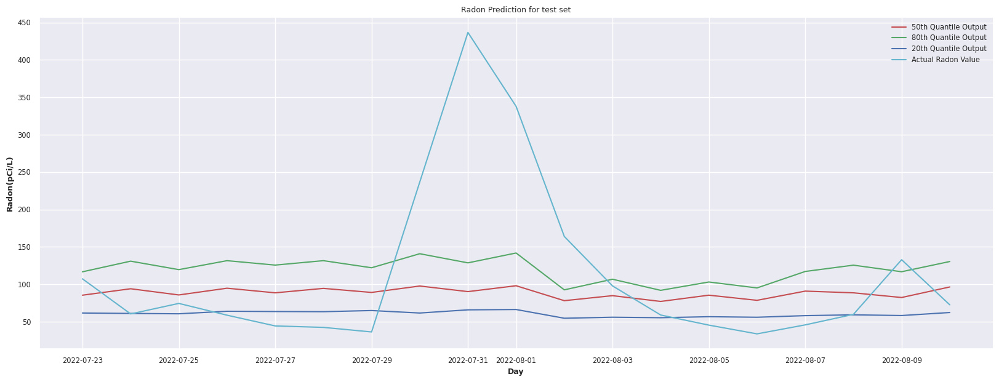

In [61]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [62]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6507 entries, 0 to 6506
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     6507 non-null   object        
 1   DeviceName   6507 non-null   object        
 2   SyncDate     6507 non-null   datetime64[ns]
 3   Radon        6507 non-null   float64       
 4   eC02         6507 non-null   int64         
 5   VOC          6507 non-null   int64         
 6   Temperature  6507 non-null   int64         
 7   AirPressure  6507 non-null   float64       
 8   Humidity     6507 non-null   int64         
 9   LogIndex     6507 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 559.2+ KB


In [64]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [65]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
6502,2022-05-10 04:48:28,56,76,30.16,7.90
6503,2022-05-10 03:48:28,56,75,30.16,6.80
6504,2022-05-10 02:48:28,57,74,30.16,5.30
6505,2022-05-10 01:48:28,58,74,30.17,3.80


In [66]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [67]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,76.62,53.71,30.19,10.74
2022-05-11,80.50,52.46,30.15,22.81
2022-05-12,81.92,49.92,30.07,17.61
2022-05-13,74.58,60.96,30.03,8.23
2022-05-14,78.88,59.38,30.00,7.87
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [68]:
df = df[df.index<= '2022-8-10']

In [69]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,76.62,53.71,30.19,10.74
2022-05-11,80.50,52.46,30.15,22.81
2022-05-12,81.92,49.92,30.07,17.61
2022-05-13,74.58,60.96,30.03,8.23
2022-05-14,78.88,59.38,30.00,7.87
...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61
2022-08-07,80.09,90.17,30.21,57.94
2022-08-08,81.58,89.75,30.14,61.90


In [70]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [71]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [72]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [73]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [74]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [75]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,76.62,53.71,30.19,10.74,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,80.50,52.46,30.15,22.81,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,81.92,49.92,30.07,17.61,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,74.58,60.96,30.03,8.23,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,78.88,59.38,30.00,7.87,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,80.09,90.17,30.21,57.94,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,81.58,89.75,30.14,61.90,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [76]:
df.dropna(inplace=True)

In [77]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,76.62,53.71,30.19,10.74,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,80.50,52.46,30.15,22.81,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,81.92,49.92,30.07,17.61,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,74.58,60.96,30.03,8.23,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,78.88,59.38,30.00,7.87,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,80.09,90.17,30.21,57.94,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,81.58,89.75,30.14,61.90,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [78]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [79]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [80]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,84.39,69.27,30.05,51.36,76.83,0.18,0.75,4.30,293.74,0.01,0.15,0.05,0.37,2.15,28.44,29.00,77.70,29.00,301.24,0.10
std,5.09,14.74,0.09,66.67,4.29,0.11,0.40,1.50,10.43,0.02,0.35,0.15,0.68,2.21,4.48,0.09,8.79,0.09,9.53,0.09
min,72.58,44.21,29.86,0.53,65.19,0.02,0.17,2.04,231.74,0.00,0.00,0.00,0.00,0.00,22.72,28.81,50.50,28.81,231.71,0.00
25%,80.96,58.54,29.98,16.92,74.01,0.11,0.51,3.33,288.05,0.00,0.00,0.00,0.00,0.64,25.40,28.93,72.20,28.93,298.84,0.04
50%,83.96,68.00,30.05,25.15,77.24,0.15,0.62,4.07,295.40,0.00,0.00,0.00,0.02,0.76,26.05,29.00,77.62,29.00,302.76,0.08
75%,87.42,83.42,30.11,58.91,79.63,0.24,0.94,5.02,300.25,0.00,0.09,0.01,0.40,3.43,31.96,29.07,83.47,29.07,306.52,0.13
max,96.62,90.92,30.21,383.82,86.16,0.65,2.44,9.81,310.53,0.08,2.11,0.74,2.67,8.01,37.50,29.16,93.24,29.16,314.83,0.45


In [81]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [82]:
df.fillna(0, inplace=True)

In [83]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Yearly Rain (in),0.59
Humidity,0.56
Humidity_lag_1,0.53
Yearly Rain (in)_lag_1,0.52
...,...
Avg Wind Speed (10 mins) (mph),-0.29
Wind Gust (mph),-0.30
Wind Speed (mph),-0.32
Avg Wind Speed (10 mins) (mph)_lag_1,-0.33


In [84]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Yearly Rain (in) 0.5893116748025733
Humidity 0.556200114029641
Humidity_lag_1 0.5296450923952701
Yearly Rain (in)_lag_1 0.5222581347836044
Yearly Rain (in)_lag_39 0.48875346516846063
Outdoor h Temperature (°F)_lag_39 0.48769721765652935
Temperature_lag_39 0.48310016831114
Outdoor h Temperature (°F)_lag_38 0.4798877740144988
Yearly Rain (in)_lag_38 0.47764399069216223
Temperature_lag_38 0.47609350345443807
Humidity_lag_2 0.475595723301739
Yearly Rain (in)_lag_37 0.4689757931770926
Outdoor h Temperature (°F)_lag_37 0.46680652484631796
Wind Direction (°)_lag_39 0.46228775863628735
Temperature_lag_37 0.4618627624146429
Yearly Rain (in)_lag_2 0.46066294287678217
Yearly Rain (in)_lag_36 0.45973151012222585
Avg Wind Direction (10 mins) (°)_lag_39 0.45784235173711024
AirPressure_lag_39 0.45522552054536497
Relative Pressure (inHg)_lag_39 0.45521570604016803
Absolute Pressure (inHg)_lag_39 0.45521570604016803
Wind Direction (°)_lag_38 0.45122505974337784
Yearly Rain (in)_lag_35 0.45108

In [87]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.50]
df_corrH

,Radon
Radon,1.00
Yearly Rain (in),0.59
Humidity,0.56
Humidity_lag_1,0.53
Yearly Rain (in)_lag_1,0.52


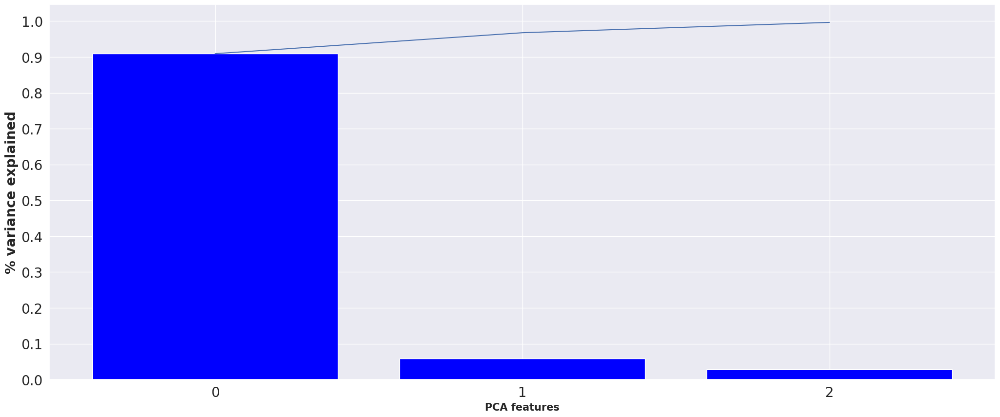

In [89]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=3)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [90]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1', 'pca2'], dtype='object')

In [91]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,-0.59


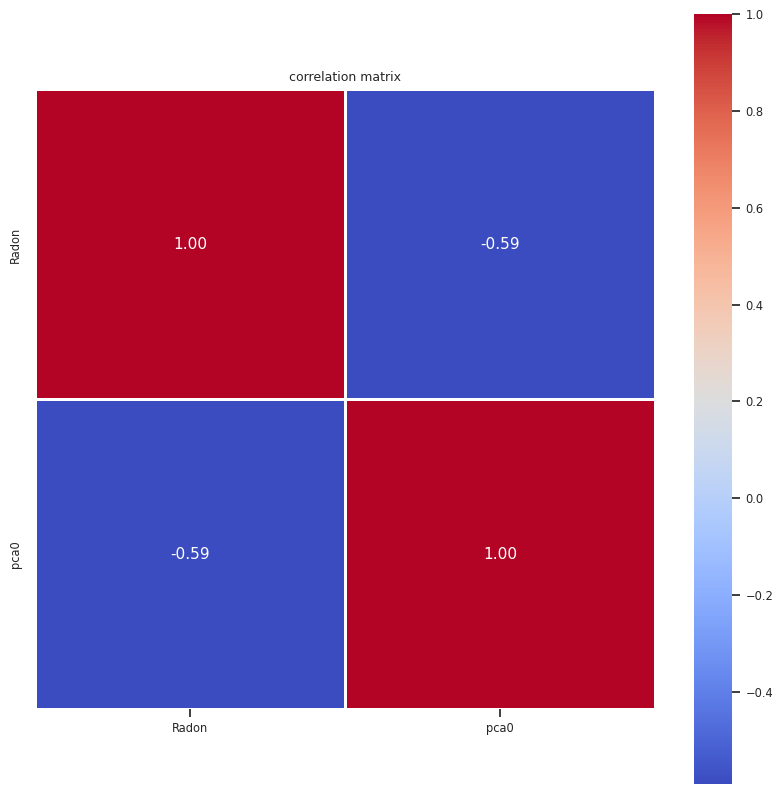

In [92]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [93]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [94]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [95]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [96]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [97]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [98]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-10 00:00:00
training end: 2022-07-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-07-23 00:00:00
test end: 2022-08-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-10,0.03
2022-08-10,0.35


In [99]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0
SyncDate,
2022-05-10,1.00
2022-08-10,-0.17


In [100]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-10,0.03
2022-07-22,0.79


In [101]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [102]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [103]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [104]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 04:21:21 (running for 00:00:00.20)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |          lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+----------

(build_fit_tft_model pid=1400985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1400985)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1400985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400985)   rank_zero_deprecation(
(build_fit_tft_model pid=1400985) Auto select gpus: [0]
(build_fit_tft_model pid=1400985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400985) HPU available: False, using: 0 HPUs
(build_fit_tft

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_000464c8,2023-02-23_04-22-57,True,,cada10c8c0544410a82d23cb7da934b2,ip-172-31-10-87,10,1.98837,172.31.10.87,1402173,1.48133,5.72124,0.180257,5.72124,1677126177,0,,10,000464c8,0.00468206
build_fit_tft_model_0109bd1d,2023-02-23_05-46-33,True,,332ecb48aa6a4939bf552700c439da0d,ip-172-31-10-87,10,0.990478,172.31.10.87,1493816,1.4721,5.94618,0.137366,5.94618,1677131193,0,,10,0109bd1d,0.00536299
build_fit_tft_model_02b804d5,2023-02-23_04-48-29,True,,117d322cbda5411eab4a2415203c9edf,ip-172-31-10-87,40,0.227674,172.31.10.87,1427060,0.785596,11.2934,0.156775,11.2934,1677127709,0,,40,02b804d5,0.0054636
build_fit_tft_model_0312b86d,2023-02-23_06-41-32,True,,ea582cce1bdc4f52805c76e7eae9411c,ip-172-31-10-87,70,0.168508,172.31.10.87,1559209,0.865341,17.801,0.151329,17.801,1677134492,0,,70,0312b86d,0.00546694
build_fit_tft_model_03516f0f,2023-02-23_05-30-01,True,,c56c97b33c924ad9b2be3b80117b86e2,ip-172-31-10-87,10,0.343694,172.31.10.87,1474345,1.18053,6.58596,0.148716,6.58596,1677130201,0,,10,03516f0f,0.00512552
build_fit_tft_model_03a11f74,2023-02-23_05-57-47,True,,3d408a2468c9441ba5001b816d1715db,ip-172-31-10-87,10,0.32554,172.31.10.87,1506582,1.3438,6.57831,0.167073,6.57831,1677131867,0,,10,03a11f74,0.0055387
build_fit_tft_model_040380a9,2023-02-23_05-47-03,True,,fb226738dffa44c1ac5fff736e2a31d5,ip-172-31-10-87,10,0.464334,172.31.10.87,1494357,1.07713,5.97412,0.149429,5.97412,1677131223,0,,10,040380a9,0.00524378
build_fit_tft_model_0425e291,2023-02-23_06-07-11,True,,213c0efefc2548aca250eb9900516eeb,ip-172-31-10-87,10,0.396622,172.31.10.87,1517076,1.14158,5.6356,0.170372,5.6356,1677132431,0,,10,0425e291,0.0102372
build_fit_tft_model_0446569c,2023-02-23_04-24-39,True,,b0fe80c4d5bd48859c960a939b4e259a,ip-172-31-10-87,10,0.265576,172.31.10.87,1403589,1.27128,6.12381,0.204484,6.12381,1677126279,0,,10,0446569c,0.00570583
build_fit_tft_model_048cc6f9,2023-02-23_06-46-51,True,,13562d97ebcf46b1a8be49d4b8ac71f3,ip-172-31-10-87,40,0.194766,172.31.10.87,1565870,0.869512,14.0635,0.236392,14.0635,1677134811,0,,40,048cc6f9,0.0131741


== Status ==
Current time: 2023-02-23 04:21:34 (running for 00:00:13.38)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 9acb6063 with sMAPE=1.8533297777175903 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2802913748998319, 'lr': 0.00019636436598279665, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+----------------------+
| Trial name                   | status 

== Status ==
Current time: 2023-02-23 04:21:54 (running for 00:00:33.91)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3772879838943481 | Iter 20.000: -1.5694551467895508 | Iter 10.000: -1.7218592166900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 9acb6063 with sMAPE=1.3524214029312134 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2802913748998319, 'lr': 0.00019636436598279665, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+-------------------

== Status ==
Current time: 2023-02-23 04:22:16 (running for 00:00:55.30)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -1.5694551467895508 | Iter 10.000: -1.7218592166900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 9acb6063 with sMAPE=1.1614038944244385 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.2802913748998319, 'lr': 0.00019636436598279665, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1401658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401658)   rank_zero_deprecation(
(build_fit_tft_model pid=1401658) Auto select gpus: [0]
(build_fit_tft_model pid=1401658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401658) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401658) 
(build_fit_tft_model pid=1401658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401658) ---------------

== Status ==
Current time: 2023-02-23 04:22:22 (running for 00:01:01.70)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -1.5694551467895508 | Iter 10.000: -1.7218592166900635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 86ca58a0 with sMAPE=1.0247009992599487 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.17311106252712866, 'lr': 1.0305903800979197e-05, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1401903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401903)   rank_zero_deprecation(
(build_fit_tft_model pid=1401903) Auto select gpus: [0]
(build_fit_tft_model pid=1401903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401903) 
(build_fit_tft_model pid=1401903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401903) ---------------

== Status ==
Current time: 2023-02-23 04:22:38 (running for 00:01:17.74)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -1.276052474975586 | Iter 10.000: -1.4529366493225098
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 86ca58a0 with sMAPE=1.027214765548706 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.17311106252712866, 'lr': 1.0305903800979197e-05, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1402173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402173)   rank_zero_deprecation(
(build_fit_tft_model pid=1402173) Auto select gpus: [0]
(build_fit_tft_model pid=1402173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402173) 
(build_fit_tft_model pid=1402173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402173) ---------------

== Status ==
Current time: 2023-02-23 04:22:55 (running for 00:01:34.94)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -0.9858267307281494 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 86ca58a0 with sMAPE=1.027214765548706 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.17311106252712866, 'lr': 1.0305903800979197e-05, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1402412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1402412)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1402412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402412)   rank_zero_deprecation(
(build_fit_tft_model pid=1402412) Auto select gpus: [0]
(build_fit_tft_model pid=1402412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402412) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:23:09 (running for 00:01:48.75)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -0.9858267307281494 | Iter 10.000: -1.3326724171638489
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5d7759d6 with sMAPE=1.0170916318893433 and parameters={'in_len': 4, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.19464684236876542, 'lr': 7.225902132188553e-05, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1402628) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402628)   rank_zero_deprecation(
(build_fit_tft_model pid=1402628) Auto select gpus: [0]
(build_fit_tft_model pid=1402628) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402628) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402628) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402628) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402628) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402628) 
(build_fit_tft_model pid=1402628)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402628) ---------------

== Status ==
Current time: 2023-02-23 04:23:25 (running for 00:02:04.91)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.3772879838943481 | Iter 20.000: -1.142760992050171 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 86ca58a0 with sMAPE=1.027214765548706 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.17311106252712866, 'lr': 1.0305903800979197e-05, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1402956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402956)   rank_zero_deprecation(
(build_fit_tft_model pid=1402956) Auto select gpus: [0]
(build_fit_tft_model pid=1402956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402956) 
(build_fit_tft_model pid=1402956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402956) ---------------

== Status ==
Current time: 2023-02-23 04:23:46 (running for 00:02:25.82)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.0438993871212006 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.1313076615333557
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6d82cb68 with sMAPE=0.649249792098999 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3814917479236172, 'lr': 0.005345494359736463, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+

(build_fit_tft_model pid=1403176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403176)   rank_zero_deprecation(
(build_fit_tft_model pid=1403176) Auto select gpus: [0]
(build_fit_tft_model pid=1403176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403176) 
(build_fit_tft_model pid=1403176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403176) ---------------

== Status ==
Current time: 2023-02-23 04:24:02 (running for 00:02:41.80)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -1.0438993871212006 | Iter 20.000: -1.181621015071869 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6d82cb68 with sMAPE=0.649249792098999 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.3814917479236172, 'lr': 0.005345494359736463, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1403400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403400)   rank_zero_deprecation(
(build_fit_tft_model pid=1403400) Auto select gpus: [0]
(build_fit_tft_model pid=1403400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403400) 
(build_fit_tft_model pid=1403400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403400) ---------------

== Status ==
Current time: 2023-02-23 04:24:24 (running for 00:03:03.94)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.089099109172821
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+

(build_fit_tft_model pid=1403589) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403589)   rank_zero_deprecation(
(build_fit_tft_model pid=1403589) Auto select gpus: [0]
(build_fit_tft_model pid=1403589) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403589) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403589) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403589) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403589) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403589) 
(build_fit_tft_model pid=1403589)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403589) ---------------

== Status ==
Current time: 2023-02-23 04:24:38 (running for 00:03:17.05)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1403847) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1403847)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1403847) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403847)   rank_zero_deprecation(
(build_fit_tft_model pid=1403847) Auto select gpus: [0]
(build_fit_tft_model pid=1403847) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403847) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403847) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403847) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:24:52 (running for 00:03:31.66)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.138745367527008
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

== Status ==
Current time: 2023-02-23 04:25:07 (running for 00:03:46.37)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1404188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404188)   rank_zero_deprecation(
(build_fit_tft_model pid=1404188) Auto select gpus: [0]
(build_fit_tft_model pid=1404188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404188) 
(build_fit_tft_model pid=1404188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404188) ---------------

== Status ==
Current time: 2023-02-23 04:25:13 (running for 00:03:52.89)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1404404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404404)   rank_zero_deprecation(
(build_fit_tft_model pid=1404404) Auto select gpus: [0]
(build_fit_tft_model pid=1404404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404404) 
(build_fit_tft_model pid=1404404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404404) ---------------

== Status ==
Current time: 2023-02-23 04:25:26 (running for 00:04:05.80)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.1551068425178528
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1404655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404655)   rank_zero_deprecation(
(build_fit_tft_model pid=1404655) Auto select gpus: [0]
(build_fit_tft_model pid=1404655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404655) 
(build_fit_tft_model pid=1404655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404655) ---------------

== Status ==
Current time: 2023-02-23 04:25:42 (running for 00:04:21.37)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1404924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404924)   rank_zero_deprecation(
(build_fit_tft_model pid=1404924) Auto select gpus: [0]
(build_fit_tft_model pid=1404924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404924) 
(build_fit_tft_model pid=1404924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404924) ---------------

== Status ==
Current time: 2023-02-23 04:25:56 (running for 00:04:35.71)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1405134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405134)   rank_zero_deprecation(
(build_fit_tft_model pid=1405134) Auto select gpus: [0]
(build_fit_tft_model pid=1405134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405134) 
(build_fit_tft_model pid=1405134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405134) ---------------

== Status ==
Current time: 2023-02-23 04:26:09 (running for 00:04:48.69)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:26:21 (running for 00:05:00.38)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1405395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405395)   rank_zero_deprecation(
(build_fit_tft_model pid=1405395) Auto select gpus: [0]
(build_fit_tft_model pid=1405395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405395) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405395) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405395) 
(build_fit_tft_model pid=1405395)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405395) ---------------

== Status ==
Current time: 2023-02-23 04:26:28 (running for 00:05:07.59)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0284305810928345 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1405661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405661)   rank_zero_deprecation(
(build_fit_tft_model pid=1405661) Auto select gpus: [0]
(build_fit_tft_model pid=1405661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405661) 
(build_fit_tft_model pid=1405661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405661) ---------------

== Status ==
Current time: 2023-02-23 04:26:43 (running for 00:05:22.74)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.1382548809051514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1405853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405853)   rank_zero_deprecation(
(build_fit_tft_model pid=1405853) Auto select gpus: [0]
(build_fit_tft_model pid=1405853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405853) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405853) 
(build_fit_tft_model pid=1405853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405853) ---------------

== Status ==
Current time: 2023-02-23 04:26:56 (running for 00:05:35.79)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1406093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1406093)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1406093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406093)   rank_zero_deprecation(
(build_fit_tft_model pid=1406093) Auto select gpus: [0]
(build_fit_tft_model pid=1406093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406093) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:27:10 (running for 00:05:49.36)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1406361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406361)   rank_zero_deprecation(
(build_fit_tft_model pid=1406361) Auto select gpus: [0]
(build_fit_tft_model pid=1406361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406361) 
(build_fit_tft_model pid=1406361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406361) ---------------

== Status ==
Current time: 2023-02-23 04:27:26 (running for 00:06:05.74)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1406577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406577)   rank_zero_deprecation(
(build_fit_tft_model pid=1406577) Auto select gpus: [0]
(build_fit_tft_model pid=1406577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406577) 
(build_fit_tft_model pid=1406577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406577) ---------------

== Status ==
Current time: 2023-02-23 04:27:40 (running for 00:06:19.88)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1406837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1406837)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1406837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406837)   rank_zero_deprecation(
(build_fit_tft_model pid=1406837) Auto select gpus: [0]
(build_fit_tft_model pid=1406837) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406837) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406837) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406837) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:27:56 (running for 00:06:35.11)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.22988361120224
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:28:06 (running for 00:06:45.37)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.2282730340957642
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1407127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1407127)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1407127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407127)   rank_zero_deprecation(
(build_fit_tft_model pid=1407127) Auto select gpus: [0]
(build_fit_tft_model pid=1407127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407127) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:28:19 (running for 00:06:58.40)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.2282730340957642
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1407367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1407367)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1407367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407367)   rank_zero_deprecation(
(build_fit_tft_model pid=1407367) Auto select gpus: [0]
(build_fit_tft_model pid=1407367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407367) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:28:36 (running for 00:07:15.14)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.20838063955307
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1407632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407632)   rank_zero_deprecation(
(build_fit_tft_model pid=1407632) Auto select gpus: [0]
(build_fit_tft_model pid=1407632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407632) 
(build_fit_tft_model pid=1407632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407632) ---------------

== Status ==
Current time: 2023-02-23 04:28:50 (running for 00:07:29.67)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.2282730340957642
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:29:01 (running for 00:07:40.38)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7625706791877747 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.20838063955307
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1407908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407908)   rank_zero_deprecation(
(build_fit_tft_model pid=1407908) Auto select gpus: [0]
(build_fit_tft_model pid=1407908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407908) 
(build_fit_tft_model pid=1407908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407908) ---------------

== Status ==
Current time: 2023-02-23 04:29:07 (running for 00:07:46.92)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7625706791877747 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.20838063955307
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1408126) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408126)   rank_zero_deprecation(
(build_fit_tft_model pid=1408126) Auto select gpus: [0]
(build_fit_tft_model pid=1408126) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408126) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408126) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408126) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408126) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408126) 
(build_fit_tft_model pid=1408126)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408126) ---------------

== Status ==
Current time: 2023-02-23 04:29:23 (running for 00:08:02.21)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7625706791877747 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:29:34 (running for 00:08:13.39)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1408458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408458)   rank_zero_deprecation(
(build_fit_tft_model pid=1408458) Auto select gpus: [0]
(build_fit_tft_model pid=1408458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408458) 
(build_fit_tft_model pid=1408458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408458) ---------------

== Status ==
Current time: 2023-02-23 04:29:40 (running for 00:08:19.43)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:29:54 (running for 00:08:33.40)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1408720) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408720)   rank_zero_deprecation(
(build_fit_tft_model pid=1408720) Auto select gpus: [0]
(build_fit_tft_model pid=1408720) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408720) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408720) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408720) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408720) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408720) 
(build_fit_tft_model pid=1408720)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408720) ---------------

== Status ==
Current time: 2023-02-23 04:30:01 (running for 00:08:40.18)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1408934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408934)   rank_zero_deprecation(
(build_fit_tft_model pid=1408934) Auto select gpus: [0]
(build_fit_tft_model pid=1408934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408934) 
(build_fit_tft_model pid=1408934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408934) ---------------

== Status ==
Current time: 2023-02-23 04:30:15 (running for 00:08:54.77)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1409169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409169)   rank_zero_deprecation(
(build_fit_tft_model pid=1409169) Auto select gpus: [0]
(build_fit_tft_model pid=1409169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409169) 
(build_fit_tft_model pid=1409169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409169) ---------------

== Status ==
Current time: 2023-02-23 04:30:28 (running for 00:09:07.87)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1409349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409349)   rank_zero_deprecation(
(build_fit_tft_model pid=1409349) Auto select gpus: [0]
(build_fit_tft_model pid=1409349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409349) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409349) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409349) 
(build_fit_tft_model pid=1409349)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409349) ---------------

== Status ==
Current time: 2023-02-23 04:30:42 (running for 00:09:21.49)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.20838063955307
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

(build_fit_tft_model pid=1409623) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409623)   rank_zero_deprecation(
(build_fit_tft_model pid=1409623) Auto select gpus: [0]
(build_fit_tft_model pid=1409623) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409623) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409623) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409623) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409623) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409623) 
(build_fit_tft_model pid=1409623)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409623) ---------------

== Status ==
Current time: 2023-02-23 04:30:56 (running for 00:09:35.80)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.1913866996765137
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1409887) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409887)   rank_zero_deprecation(
(build_fit_tft_model pid=1409887) Auto select gpus: [0]
(build_fit_tft_model pid=1409887) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409887) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409887) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409887) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409887) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409887) 
(build_fit_tft_model pid=1409887)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409887) ---------------

== Status ==
Current time: 2023-02-23 04:31:12 (running for 00:09:51.70)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.0710344314575195 | Iter 10.000: -1.1899374723434448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:31:25 (running for 00:10:04.40)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1410243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1410243)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1410243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410243)   rank_zero_deprecation(
(build_fit_tft_model pid=1410243) Auto select gpus: [0]
(build_fit_tft_model pid=1410243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410243) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:31:33 (running for 00:10:12.77)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1410563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1410563)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1410563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410563)   rank_zero_deprecation(
(build_fit_tft_model pid=1410563) Auto select gpus: [0]
(build_fit_tft_model pid=1410563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410563) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:31:49 (running for 00:10:28.22)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0701181888580322 | Iter 10.000: -1.1899374723434448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:31:59 (running for 00:10:38.45)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:32:11 (running for 00:10:50.42)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1411054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411054)   rank_zero_deprecation(
(build_fit_tft_model pid=1411054) Auto select gpus: [0]
(build_fit_tft_model pid=1411054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411054) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411054) 
(build_fit_tft_model pid=1411054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411054) ---------------

== Status ==
Current time: 2023-02-23 04:32:18 (running for 00:10:58.03)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -1.069201946258545 | Iter 10.000: -1.188488245010376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:32:31 (running for 00:11:10.42)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0275143384933472 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1411411) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411411)   rank_zero_deprecation(
(build_fit_tft_model pid=1411411) Auto select gpus: [0]
(build_fit_tft_model pid=1411411) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411411) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411411) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411411) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411411) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411411) 
(build_fit_tft_model pid=1411411)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411411) ---------------

== Status ==
Current time: 2023-02-23 04:32:38 (running for 00:11:18.04)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7383049130439758 | Iter 20.000: -1.0275143384933472 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:32:49 (running for 00:11:28.30)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -0.9858267307281494 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1411724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1411724)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1411724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411724)   rank_zero_deprecation(
(build_fit_tft_model pid=1411724) Auto select gpus: [0]
(build_fit_tft_model pid=1411724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411724) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:33:04 (running for 00:11:43.14)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -0.9858267307281494 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:33:14 (running for 00:11:53.32)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7244078516960144 | Iter 20.000: -0.9842382669448853 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:33:28 (running for 00:12:07.43)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9842382669448853 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1412293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412293)   rank_zero_deprecation(
(build_fit_tft_model pid=1412293) Auto select gpus: [0]
(build_fit_tft_model pid=1412293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412293) 
(build_fit_tft_model pid=1412293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412293) ---------------

== Status ==
Current time: 2023-02-23 04:33:35 (running for 00:12:15.03)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9842382669448853 | Iter 10.000: -1.1611344814300537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1412588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412588)   rank_zero_deprecation(
(build_fit_tft_model pid=1412588) Auto select gpus: [0]
(build_fit_tft_model pid=1412588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412588) 
(build_fit_tft_model pid=1412588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412588) ---------------

== Status ==
Current time: 2023-02-23 04:33:51 (running for 00:12:30.61)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9842382669448853 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1412930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1412930)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1412930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412930)   rank_zero_deprecation(
(build_fit_tft_model pid=1412930) Auto select gpus: [0]
(build_fit_tft_model pid=1412930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412930) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:34:06 (running for 00:12:46.03)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9842382669448853 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:34:17 (running for 00:12:56.29)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9826498031616211 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:34:28 (running for 00:13:07.46)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9826498031616211 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1413325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1413325)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1413325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413325)   rank_zero_deprecation(
(build_fit_tft_model pid=1413325) Auto select gpus: [0]
(build_fit_tft_model pid=1413325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413325) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:34:37 (running for 00:13:16.80)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9826498031616211 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:34:48 (running for 00:13:27.28)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: d311dcd0 with sMAPE=0.4497526288032532 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 10, 'dropout': 0.2920985350367721, 'lr': 0.008707690222140555, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1413781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413781)   rank_zero_deprecation(
(build_fit_tft_model pid=1413781) Auto select gpus: [0]
(build_fit_tft_model pid=1413781) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413781) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413781) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413781) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413781) 
(build_fit_tft_model pid=1413781)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413781) ---------------

== Status ==
Current time: 2023-02-23 04:35:01 (running for 00:13:40.52)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:35:11 (running for 00:13:50.80)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1295212507247925 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.1619482040405273
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:35:22 (running for 00:14:01.44)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.1619482040405273
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1414320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414320)   rank_zero_deprecation(
(build_fit_tft_model pid=1414320) Auto select gpus: [0]
(build_fit_tft_model pid=1414320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414320) 
(build_fit_tft_model pid=1414320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414320) ---------------

== Status ==
Current time: 2023-02-23 04:35:29 (running for 00:14:08.57)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.1619482040405273
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1414575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414575)   rank_zero_deprecation(
(build_fit_tft_model pid=1414575) Auto select gpus: [0]
(build_fit_tft_model pid=1414575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414575) 
(build_fit_tft_model pid=1414575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414575) ---------------

== Status ==
Current time: 2023-02-23 04:35:42 (running for 00:14:21.59)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1414775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414775)   rank_zero_deprecation(
(build_fit_tft_model pid=1414775) Auto select gpus: [0]
(build_fit_tft_model pid=1414775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414775) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414775) 
(build_fit_tft_model pid=1414775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414775) ---------------

== Status ==
Current time: 2023-02-23 04:35:55 (running for 00:14:34.97)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:36:07 (running for 00:14:46.43)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1415038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415038)   rank_zero_deprecation(
(build_fit_tft_model pid=1415038) Auto select gpus: [0]
(build_fit_tft_model pid=1415038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415038) 
(build_fit_tft_model pid=1415038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415038) ---------------

== Status ==
Current time: 2023-02-23 04:36:14 (running for 00:14:53.95)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1415331) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415331)   rank_zero_deprecation(
(build_fit_tft_model pid=1415331) Auto select gpus: [0]
(build_fit_tft_model pid=1415331) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415331) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415331) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415331) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415331) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415331) 
(build_fit_tft_model pid=1415331)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415331) ---------------

== Status ==
Current time: 2023-02-23 04:36:29 (running for 00:15:08.82)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1415566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415566)   rank_zero_deprecation(
(build_fit_tft_model pid=1415566) Auto select gpus: [0]
(build_fit_tft_model pid=1415566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415566) 
(build_fit_tft_model pid=1415566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415566) ---------------

== Status ==
Current time: 2023-02-23 04:36:42 (running for 00:15:21.78)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9770843684673309 | Iter 10.000: -1.186251163482666
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:36:56 (running for 00:15:35.48)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1415886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415886)   rank_zero_deprecation(
(build_fit_tft_model pid=1415886) Auto select gpus: [0]
(build_fit_tft_model pid=1415886) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415886) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415886) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415886) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415886) 
(build_fit_tft_model pid=1415886)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415886) ---------------

== Status ==
Current time: 2023-02-23 04:37:02 (running for 00:15:41.66)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9715189337730408 | Iter 10.000: -1.184014081954956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:37:13 (running for 00:15:52.44)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9712848365306854 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1416140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416140)   rank_zero_deprecation(
(build_fit_tft_model pid=1416140) Auto select gpus: [0]
(build_fit_tft_model pid=1416140) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416140) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416140) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416140) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416140) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416140) 
(build_fit_tft_model pid=1416140)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416140) ---------------

== Status ==
Current time: 2023-02-23 04:37:19 (running for 00:15:58.73)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7041296064853668 | Iter 20.000: -0.9712848365306854 | Iter 10.000: -1.1729811429977417
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:37:30 (running for 00:16:09.45)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9710507392883301 | Iter 10.000: -1.1619482040405273
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1416404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416404)   rank_zero_deprecation(
(build_fit_tft_model pid=1416404) Auto select gpus: [0]
(build_fit_tft_model pid=1416404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416404) 
(build_fit_tft_model pid=1416404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416404) ---------------

== Status ==
Current time: 2023-02-23 04:37:36 (running for 00:16:15.92)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.9710507392883301 | Iter 10.000: -1.1619482040405273
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:37:50 (running for 00:16:29.47)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7062847912311554 | Iter 20.000: -0.9406633973121643 | Iter 10.000: -1.15546452999115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1416730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416730)   rank_zero_deprecation(
(build_fit_tft_model pid=1416730) Auto select gpus: [0]
(build_fit_tft_model pid=1416730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416730) 
(build_fit_tft_model pid=1416730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416730) ---------------

== Status ==
Current time: 2023-02-23 04:37:56 (running for 00:16:35.77)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7062847912311554 | Iter 20.000: -0.9406633973121643 | Iter 10.000: -1.15546452999115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:38:07 (running for 00:16:46.42)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9102760553359985 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1417005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417005)   rank_zero_deprecation(
(build_fit_tft_model pid=1417005) Auto select gpus: [0]
(build_fit_tft_model pid=1417005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417005) 
(build_fit_tft_model pid=1417005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417005) ---------------

== Status ==
Current time: 2023-02-23 04:38:19 (running for 00:16:58.64)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9102760553359985 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1417265) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417265)   rank_zero_deprecation(
(build_fit_tft_model pid=1417265) Auto select gpus: [0]
(build_fit_tft_model pid=1417265) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417265) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417265) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417265) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417265) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417265) 
(build_fit_tft_model pid=1417265)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417265) ---------------

== Status ==
Current time: 2023-02-23 04:38:33 (running for 00:17:12.83)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9102760553359985 | Iter 10.000: -1.15546452999115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1417467) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417467)   rank_zero_deprecation(
(build_fit_tft_model pid=1417467) Auto select gpus: [0]
(build_fit_tft_model pid=1417467) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417467) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417467) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417467) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417467) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417467) 
(build_fit_tft_model pid=1417467)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417467) ---------------

== Status ==
Current time: 2023-02-23 04:38:51 (running for 00:17:30.28)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9406633973121643 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1417739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417739)   rank_zero_deprecation(
(build_fit_tft_model pid=1417739) Auto select gpus: [0]
(build_fit_tft_model pid=1417739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417739) 
(build_fit_tft_model pid=1417739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417739) ---------------

== Status ==
Current time: 2023-02-23 04:39:04 (running for 00:17:44.00)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9406633973121643 | Iter 10.000: -1.15546452999115
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1417953) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417953)   rank_zero_deprecation(
(build_fit_tft_model pid=1417953) Auto select gpus: [0]
(build_fit_tft_model pid=1417953) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417953) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417953) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417953) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417953) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417953) 
(build_fit_tft_model pid=1417953)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417953) ---------------

== Status ==
Current time: 2023-02-23 04:39:19 (running for 00:17:58.73)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9710507392883301 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1418217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418217)   rank_zero_deprecation(
(build_fit_tft_model pid=1418217) Auto select gpus: [0]
(build_fit_tft_model pid=1418217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418217) 
(build_fit_tft_model pid=1418217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418217) ---------------

== Status ==
Current time: 2023-02-23 04:39:35 (running for 00:18:14.25)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9712848365306854 | Iter 10.000: -1.143617868423462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1418479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418479)   rank_zero_deprecation(
(build_fit_tft_model pid=1418479) Auto select gpus: [0]
(build_fit_tft_model pid=1418479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418479) 
(build_fit_tft_model pid=1418479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418479) ---------------

== Status ==
Current time: 2023-02-23 04:39:49 (running for 00:18:29.04)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9712848365306854 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1418691) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418691)   rank_zero_deprecation(
(build_fit_tft_model pid=1418691) Auto select gpus: [0]
(build_fit_tft_model pid=1418691) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418691) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418691) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418691) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418691) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418691) 
(build_fit_tft_model pid=1418691)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418691) ---------------

== Status ==
Current time: 2023-02-23 04:40:03 (running for 00:18:42.78)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9712848365306854 | Iter 10.000: -1.1507529616355896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:40:14 (running for 00:18:53.45)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9710507392883301 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1418997) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418997)   rank_zero_deprecation(
(build_fit_tft_model pid=1418997) Auto select gpus: [0]
(build_fit_tft_model pid=1418997) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418997) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418997) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418997) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418997) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418997) 
(build_fit_tft_model pid=1418997)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418997) ---------------

== Status ==
Current time: 2023-02-23 04:40:25 (running for 00:19:04.75)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9710507392883301 | Iter 10.000: -1.1489808559417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:40:36 (running for 00:19:15.49)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9449945390224457 | Iter 10.000: -1.143617868423462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1419236) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419236)   rank_zero_deprecation(
(build_fit_tft_model pid=1419236) Auto select gpus: [0]
(build_fit_tft_model pid=1419236) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419236) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419236) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419236) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419236) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419236) 
(build_fit_tft_model pid=1419236)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419236) ---------------

== Status ==
Current time: 2023-02-23 04:40:42 (running for 00:19:21.80)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9449945390224457 | Iter 10.000: -1.143617868423462
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:40:56 (running for 00:19:35.49)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1382548809051514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1419516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419516)   rank_zero_deprecation(
(build_fit_tft_model pid=1419516) Auto select gpus: [0]
(build_fit_tft_model pid=1419516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419516) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419516) 
(build_fit_tft_model pid=1419516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419516) ---------------

== Status ==
Current time: 2023-02-23 04:41:03 (running for 00:19:42.51)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1382548809051514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1419760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419760)   rank_zero_deprecation(
(build_fit_tft_model pid=1419760) Auto select gpus: [0]
(build_fit_tft_model pid=1419760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419760) 
(build_fit_tft_model pid=1419760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419760) ---------------

== Status ==
Current time: 2023-02-23 04:41:19 (running for 00:19:58.50)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9275736510753632 | Iter 10.000: -1.1322272419929504
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:41:29 (running for 00:20:08.66)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420177)   rank_zero_deprecation(
(build_fit_tft_model pid=1420177) Auto select gpus: [0]
(build_fit_tft_model pid=1420177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420177) 
(build_fit_tft_model pid=1420177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420177) ---------------

== Status ==
Current time: 2023-02-23 04:41:44 (running for 00:20:23.20)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420426) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420426)   rank_zero_deprecation(
(build_fit_tft_model pid=1420426) Auto select gpus: [0]
(build_fit_tft_model pid=1420426) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420426) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420426) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420426) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420426) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420426) 
(build_fit_tft_model pid=1420426)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420426) ---------------

== Status ==
Current time: 2023-02-23 04:41:57 (running for 00:20:36.90)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1322272419929504
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420651) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420651)   rank_zero_deprecation(
(build_fit_tft_model pid=1420651) Auto select gpus: [0]
(build_fit_tft_model pid=1420651) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420651) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420651) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420651) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420651) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420651) 
(build_fit_tft_model pid=1420651)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420651) ---------------

== Status ==
Current time: 2023-02-23 04:42:12 (running for 00:20:51.77)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9275736510753632 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1420903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420903)   rank_zero_deprecation(
(build_fit_tft_model pid=1420903) Auto select gpus: [0]
(build_fit_tft_model pid=1420903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420903) 
(build_fit_tft_model pid=1420903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420903) ---------------

== Status ==
Current time: 2023-02-23 04:42:25 (running for 00:21:04.92)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.9275736510753632 | Iter 10.000: -1.1322272419929504
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:42:36 (running for 00:21:15.51)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421179)   rank_zero_deprecation(
(build_fit_tft_model pid=1421179) Auto select gpus: [0]
(build_fit_tft_model pid=1421179) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421179) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421179) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421179) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421179) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421179) 
(build_fit_tft_model pid=1421179)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421179) ---------------

== Status ==
Current time: 2023-02-23 04:42:42 (running for 00:21:22.01)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9189383387565613 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421448)   rank_zero_deprecation(
(build_fit_tft_model pid=1421448) Auto select gpus: [0]
(build_fit_tft_model pid=1421448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421448) 
(build_fit_tft_model pid=1421448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421448) ---------------

== Status ==
Current time: 2023-02-23 04:42:58 (running for 00:21:38.00)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9146071970462799 | Iter 10.000: -1.1133494973182678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421706)   rank_zero_deprecation(
(build_fit_tft_model pid=1421706) Auto select gpus: [0]
(build_fit_tft_model pid=1421706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421706) 
(build_fit_tft_model pid=1421706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421706) ---------------

== Status ==
Current time: 2023-02-23 04:43:11 (running for 00:21:50.90)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.9146071970462799 | Iter 10.000: -1.1261996030807495
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:43:22 (running for 00:22:01.50)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9102760553359985 | Iter 10.000: -1.1133494973182678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1421964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421964)   rank_zero_deprecation(
(build_fit_tft_model pid=1421964) Auto select gpus: [0]
(build_fit_tft_model pid=1421964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421964) 
(build_fit_tft_model pid=1421964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421964) ---------------

== Status ==
Current time: 2023-02-23 04:43:28 (running for 00:22:07.81)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.9102760553359985 | Iter 10.000: -1.1133494973182678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:43:39 (running for 00:22:18.52)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.9058288037776947 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1422237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422237)   rank_zero_deprecation(
(build_fit_tft_model pid=1422237) Auto select gpus: [0]
(build_fit_tft_model pid=1422237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422237) 
(build_fit_tft_model pid=1422237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422237) ---------------

== Status ==
Current time: 2023-02-23 04:43:45 (running for 00:22:25.02)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.9058288037776947 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1422462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422462)   rank_zero_deprecation(
(build_fit_tft_model pid=1422462) Auto select gpus: [0]
(build_fit_tft_model pid=1422462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422462) 
(build_fit_tft_model pid=1422462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422462) ---------------

== Status ==
Current time: 2023-02-23 04:44:02 (running for 00:22:41.76)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.9013815522193909 | Iter 10.000: -1.096988022327423
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1422773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422773)   rank_zero_deprecation(
(build_fit_tft_model pid=1422773) Auto select gpus: [0]
(build_fit_tft_model pid=1422773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1422773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1422773) 
(build_fit_tft_model pid=1422773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1422773) ---------------

== Status ==
Current time: 2023-02-23 04:44:19 (running for 00:22:58.44)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.9013815522193909 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1423000) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423000)   rank_zero_deprecation(
(build_fit_tft_model pid=1423000) Auto select gpus: [0]
(build_fit_tft_model pid=1423000) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423000) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423000) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423000) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423000) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423000) 
(build_fit_tft_model pid=1423000)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423000) ---------------

== Status ==
Current time: 2023-02-23 04:44:34 (running for 00:23:13.23)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.9013815522193909 | Iter 10.000: -1.1133494973182678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:44:45 (running for 00:23:24.54)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.898756206035614 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1423260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423260)   rank_zero_deprecation(
(build_fit_tft_model pid=1423260) Auto select gpus: [0]
(build_fit_tft_model pid=1423260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423260) 
(build_fit_tft_model pid=1423260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423260) ---------------

== Status ==
Current time: 2023-02-23 04:44:53 (running for 00:23:32.60)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.898756206035614 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:45:06 (running for 00:23:45.55)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.096988022327423
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1423701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423701)   rank_zero_deprecation(
(build_fit_tft_model pid=1423701) Auto select gpus: [0]
(build_fit_tft_model pid=1423701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423701) 
(build_fit_tft_model pid=1423701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423701) ---------------

== Status ==
Current time: 2023-02-23 04:45:14 (running for 00:23:53.50)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.096988022327423
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1423954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1423954)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1423954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423954)   rank_zero_deprecation(
(build_fit_tft_model pid=1423954) Auto select gpus: [0]
(build_fit_tft_model pid=1423954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423954) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:45:28 (running for 00:24:07.91)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.1004993915557861
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1424250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424250)   rank_zero_deprecation(
(build_fit_tft_model pid=1424250) Auto select gpus: [0]
(build_fit_tft_model pid=1424250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424250) 
(build_fit_tft_model pid=1424250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424250) ---------------

== Status ==
Current time: 2023-02-23 04:45:47 (running for 00:24:26.33)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.898756206035614 | Iter 10.000: -1.096988022327423
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

== Status ==
Current time: 2023-02-23 04:45:57 (running for 00:24:36.49)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1424658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424658)   rank_zero_deprecation(
(build_fit_tft_model pid=1424658) Auto select gpus: [0]
(build_fit_tft_model pid=1424658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424658) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424658) 
(build_fit_tft_model pid=1424658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424658) ---------------

== Status ==
Current time: 2023-02-23 04:46:09 (running for 00:24:48.50)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:46:21 (running for 00:25:00.56)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1424948) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424948)   rank_zero_deprecation(
(build_fit_tft_model pid=1424948) Auto select gpus: [0]
(build_fit_tft_model pid=1424948) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424948) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424948) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424948) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424948) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424948) 
(build_fit_tft_model pid=1424948)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424948) ---------------

== Status ==
Current time: 2023-02-23 04:46:29 (running for 00:25:08.60)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1425212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425212)   rank_zero_deprecation(
(build_fit_tft_model pid=1425212) Auto select gpus: [0]
(build_fit_tft_model pid=1425212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425212) 
(build_fit_tft_model pid=1425212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425212) ---------------

== Status ==
Current time: 2023-02-23 04:46:43 (running for 00:25:22.81)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

(build_fit_tft_model pid=1425482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425482)   rank_zero_deprecation(
(build_fit_tft_model pid=1425482) Auto select gpus: [0]
(build_fit_tft_model pid=1425482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425482) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425482) 
(build_fit_tft_model pid=1425482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425482) ---------------

== Status ==
Current time: 2023-02-23 04:47:00 (running for 00:25:39.10)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1425823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1425823)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1425823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425823)   rank_zero_deprecation(
(build_fit_tft_model pid=1425823) Auto select gpus: [0]
(build_fit_tft_model pid=1425823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425823) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:15 (running for 00:25:54.18)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.09347665309906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

== Status ==
Current time: 2023-02-23 04:47:26 (running for 00:26:05.57)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.898756206035614 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1426152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1426152)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1426152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426152)   rank_zero_deprecation(
(build_fit_tft_model pid=1426152) Auto select gpus: [0]
(build_fit_tft_model pid=1426152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426152) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:34 (running for 00:26:13.49)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.898756206035614 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

== Status ==
Current time: 2023-02-23 04:47:44 (running for 00:26:23.91)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:47:55 (running for 00:26:34.49)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1426718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426718)   rank_zero_deprecation(
(build_fit_tft_model pid=1426718) Auto select gpus: [0]
(build_fit_tft_model pid=1426718) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426718) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426718) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426718) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426718) 
(build_fit_tft_model pid=1426718)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426718) ---------------

== Status ==
Current time: 2023-02-23 04:48:08 (running for 00:26:47.07)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1427060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427060)   rank_zero_deprecation(
(build_fit_tft_model pid=1427060) Auto select gpus: [0]
(build_fit_tft_model pid=1427060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427060) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427060) 
(build_fit_tft_model pid=1427060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427060) ---------------

== Status ==
Current time: 2023-02-23 04:48:22 (running for 00:27:01.94)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7071014642715454 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0925565958023071
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:48:35 (running for 00:27:14.61)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1427412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427412)   rank_zero_deprecation(
(build_fit_tft_model pid=1427412) Auto select gpus: [0]
(build_fit_tft_model pid=1427412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427412) 
(build_fit_tft_model pid=1427412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427412) ---------------

== Status ==
Current time: 2023-02-23 04:48:42 (running for 00:27:21.66)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1427767) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427767)   rank_zero_deprecation(
(build_fit_tft_model pid=1427767) Auto select gpus: [0]
(build_fit_tft_model pid=1427767) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427767) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427767) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427767) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427767) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427767) 
(build_fit_tft_model pid=1427767)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427767) ---------------

== Status ==
Current time: 2023-02-23 04:48:59 (running for 00:27:38.08)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0881790518760681
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1428040) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428040)   rank_zero_deprecation(
(build_fit_tft_model pid=1428040) Auto select gpus: [0]
(build_fit_tft_model pid=1428040) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428040) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428040) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428040) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428040) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428040) 
(build_fit_tft_model pid=1428040)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428040) ---------------

== Status ==
Current time: 2023-02-23 04:49:13 (running for 00:27:52.67)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0916365385055542
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:49:24 (running for 00:28:03.64)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0881790518760681
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1428385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428385)   rank_zero_deprecation(
(build_fit_tft_model pid=1428385) Auto select gpus: [0]
(build_fit_tft_model pid=1428385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428385) 
(build_fit_tft_model pid=1428385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428385) ---------------

== Status ==
Current time: 2023-02-23 04:49:32 (running for 00:28:11.19)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0881790518760681
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1428624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428624)   rank_zero_deprecation(
(build_fit_tft_model pid=1428624) Auto select gpus: [0]
(build_fit_tft_model pid=1428624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428624) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428624) 
(build_fit_tft_model pid=1428624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428624) ---------------

== Status ==
Current time: 2023-02-23 04:49:48 (running for 00:28:27.12)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.084721565246582
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1428930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428930)   rank_zero_deprecation(
(build_fit_tft_model pid=1428930) Auto select gpus: [0]
(build_fit_tft_model pid=1428930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428930) 
(build_fit_tft_model pid=1428930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428930) ---------------

== Status ==
Current time: 2023-02-23 04:50:06 (running for 00:28:45.31)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0816614031791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1429246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429246)   rank_zero_deprecation(
(build_fit_tft_model pid=1429246) Auto select gpus: [0]
(build_fit_tft_model pid=1429246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429246) 
(build_fit_tft_model pid=1429246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429246) ---------------

== Status ==
Current time: 2023-02-23 04:50:21 (running for 00:29:00.13)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.084721565246582
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:50:32 (running for 00:29:11.59)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8842976689338684 | Iter 10.000: -1.0816614031791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1429574) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429574)   rank_zero_deprecation(
(build_fit_tft_model pid=1429574) Auto select gpus: [0]
(build_fit_tft_model pid=1429574) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429574) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429574) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429574) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429574) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429574) 
(build_fit_tft_model pid=1429574)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429574) ---------------

== Status ==
Current time: 2023-02-23 04:50:40 (running for 00:29:19.27)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8842976689338684 | Iter 10.000: -1.0816614031791687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:50:52 (running for 00:29:31.58)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0786012411117554
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1429888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1429888)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1429888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429888)   rank_zero_deprecation(
(build_fit_tft_model pid=1429888) Auto select gpus: [0]
(build_fit_tft_model pid=1429888) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429888) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429888) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429888) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:51:00 (running for 00:29:39.60)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0786012411117554
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:51:12 (running for 00:29:51.62)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0777044296264648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1430292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430292)   rank_zero_deprecation(
(build_fit_tft_model pid=1430292) Auto select gpus: [0]
(build_fit_tft_model pid=1430292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430292) 
(build_fit_tft_model pid=1430292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430292) ---------------

== Status ==
Current time: 2023-02-23 04:51:19 (running for 00:29:59.01)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0777044296264648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:51:30 (running for 00:30:09.25)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8267126083374023 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4da960b1 with sMAPE=0.4611221253871918 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.3592273920339432, 'lr': 0.011756478704643213, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1430710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430710)   rank_zero_deprecation(
(build_fit_tft_model pid=1430710) Auto select gpus: [0]
(build_fit_tft_model pid=1430710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430710) 
(build_fit_tft_model pid=1430710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430710) ---------------

== Status ==
Current time: 2023-02-23 04:51:45 (running for 00:30:24.39)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1431060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431060)   rank_zero_deprecation(
(build_fit_tft_model pid=1431060) Auto select gpus: [0]
(build_fit_tft_model pid=1431060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431060) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431060) 
(build_fit_tft_model pid=1431060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431060) ---------------

== Status ==
Current time: 2023-02-23 04:52:00 (running for 00:30:39.31)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0777044296264648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1431408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431408)   rank_zero_deprecation(
(build_fit_tft_model pid=1431408) Auto select gpus: [0]
(build_fit_tft_model pid=1431408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431408) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431408) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431408) 
(build_fit_tft_model pid=1431408)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431408) ---------------

== Status ==
Current time: 2023-02-23 04:52:16 (running for 00:30:55.27)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1431725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431725)   rank_zero_deprecation(
(build_fit_tft_model pid=1431725) Auto select gpus: [0]
(build_fit_tft_model pid=1431725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431725) 
(build_fit_tft_model pid=1431725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431725) ---------------

== Status ==
Current time: 2023-02-23 04:52:30 (running for 00:31:09.90)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.0777044296264648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:52:45 (running for 00:31:24.62)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1432049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432049)   rank_zero_deprecation(
(build_fit_tft_model pid=1432049) Auto select gpus: [0]
(build_fit_tft_model pid=1432049) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432049) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432049) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432049) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432049) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432049) 
(build_fit_tft_model pid=1432049)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432049) ---------------

== Status ==
Current time: 2023-02-23 04:52:53 (running for 00:31:32.57)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1432338) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432338)   rank_zero_deprecation(
(build_fit_tft_model pid=1432338) Auto select gpus: [0]
(build_fit_tft_model pid=1432338) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432338) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432338) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432338) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432338) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432338) 
(build_fit_tft_model pid=1432338)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432338) ---------------

== Status ==
Current time: 2023-02-23 04:53:08 (running for 00:31:48.03)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8961308598518372 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 04:53:19 (running for 00:31:58.64)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1432684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432684)   rank_zero_deprecation(
(build_fit_tft_model pid=1432684) Auto select gpus: [0]
(build_fit_tft_model pid=1432684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432684) 
(build_fit_tft_model pid=1432684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432684) ---------------

== Status ==
Current time: 2023-02-23 04:53:27 (running for 00:32:06.67)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8902142643928528 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:53:39 (running for 00:32:18.60)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8842976689338684 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1433015) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433015)   rank_zero_deprecation(
(build_fit_tft_model pid=1433015) Auto select gpus: [0]
(build_fit_tft_model pid=1433015) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433015) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433015) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433015) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433015) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433015) 
(build_fit_tft_model pid=1433015)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433015) ---------------

== Status ==
Current time: 2023-02-23 04:53:46 (running for 00:32:25.91)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8842976689338684 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:53:59 (running for 00:32:38.64)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7363865971565247 | Iter 20.000: -0.8812768757343292 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1433344) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433344)   rank_zero_deprecation(
(build_fit_tft_model pid=1433344) Auto select gpus: [0]
(build_fit_tft_model pid=1433344) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433344) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433344) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433344) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433344) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433344) 
(build_fit_tft_model pid=1433344)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433344) ---------------

== Status ==
Current time: 2023-02-23 04:54:06 (running for 00:32:46.03)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7363865971565247 | Iter 20.000: -0.8812768757343292 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:54:17 (running for 00:32:56.18)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 916ddf81 with sMAPE=0.477376788854599 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.3601949136961604, 'lr': 0.006935943442647254, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1433823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433823)   rank_zero_deprecation(
(build_fit_tft_model pid=1433823) Auto select gpus: [0]
(build_fit_tft_model pid=1433823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433823) 
(build_fit_tft_model pid=1433823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433823) ---------------

== Status ==
Current time: 2023-02-23 04:54:33 (running for 00:33:12.76)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1434140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434140)   rank_zero_deprecation(
(build_fit_tft_model pid=1434140) Auto select gpus: [0]
(build_fit_tft_model pid=1434140) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434140) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434140) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434140) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434140) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434140) 
(build_fit_tft_model pid=1434140)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434140) ---------------

== Status ==
Current time: 2023-02-23 04:54:48 (running for 00:33:27.80)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1434379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434379)   rank_zero_deprecation(
(build_fit_tft_model pid=1434379) Auto select gpus: [0]
(build_fit_tft_model pid=1434379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434379) 
(build_fit_tft_model pid=1434379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434379) ---------------

== Status ==
Current time: 2023-02-23 04:55:03 (running for 00:33:42.24)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1434718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434718)   rank_zero_deprecation(
(build_fit_tft_model pid=1434718) Auto select gpus: [0]
(build_fit_tft_model pid=1434718) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434718) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434718) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434718) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434718) 
(build_fit_tft_model pid=1434718)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434718) ---------------

== Status ==
Current time: 2023-02-23 04:55:17 (running for 00:33:56.97)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1434968) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434968)   rank_zero_deprecation(
(build_fit_tft_model pid=1434968) Auto select gpus: [0]
(build_fit_tft_model pid=1434968) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434968) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434968) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434968) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434968) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434968) 
(build_fit_tft_model pid=1434968)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434968) ---------------

== Status ==
Current time: 2023-02-23 04:55:34 (running for 00:34:13.60)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1435312) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435312)   rank_zero_deprecation(
(build_fit_tft_model pid=1435312) Auto select gpus: [0]
(build_fit_tft_model pid=1435312) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435312) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435312) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435312) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435312) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435312) 
(build_fit_tft_model pid=1435312)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435312) ---------------

== Status ==
Current time: 2023-02-23 04:55:49 (running for 00:34:28.57)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7357670664787292 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:56:00 (running for 00:34:39.65)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1435660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435660)   rank_zero_deprecation(
(build_fit_tft_model pid=1435660) Auto select gpus: [0]
(build_fit_tft_model pid=1435660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435660) 
(build_fit_tft_model pid=1435660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435660) ---------------

== Status ==
Current time: 2023-02-23 04:56:07 (running for 00:34:47.00)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1436014) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436014)   rank_zero_deprecation(
(build_fit_tft_model pid=1436014) Auto select gpus: [0]
(build_fit_tft_model pid=1436014) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436014) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436014) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436014) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436014) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436014) 
(build_fit_tft_model pid=1436014)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436014) ---------------

== Status ==
Current time: 2023-02-23 04:56:24 (running for 00:35:03.14)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1436318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436318)   rank_zero_deprecation(
(build_fit_tft_model pid=1436318) Auto select gpus: [0]
(build_fit_tft_model pid=1436318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436318) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436318) 
(build_fit_tft_model pid=1436318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436318) ---------------

== Status ==
Current time: 2023-02-23 04:56:39 (running for 00:35:18.68)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7231389284133911 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:56:53 (running for 00:35:32.65)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7261134386062622 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1436751) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436751)   rank_zero_deprecation(
(build_fit_tft_model pid=1436751) Auto select gpus: [0]
(build_fit_tft_model pid=1436751) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436751) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436751) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436751) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436751) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436751) 
(build_fit_tft_model pid=1436751)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436751) ---------------

== Status ==
Current time: 2023-02-23 04:57:00 (running for 00:35:40.01)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7261134386062622 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1437001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437001)   rank_zero_deprecation(
(build_fit_tft_model pid=1437001) Auto select gpus: [0]
(build_fit_tft_model pid=1437001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437001) 
(build_fit_tft_model pid=1437001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437001) ---------------

== Status ==
Current time: 2023-02-23 04:57:16 (running for 00:35:55.44)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7261134386062622 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1437296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437296)   rank_zero_deprecation(
(build_fit_tft_model pid=1437296) Auto select gpus: [0]
(build_fit_tft_model pid=1437296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437296) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437296) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437296) 
(build_fit_tft_model pid=1437296)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437296) ---------------

== Status ==
Current time: 2023-02-23 04:57:32 (running for 00:36:11.55)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7261134386062622 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1437540) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437540)   rank_zero_deprecation(
(build_fit_tft_model pid=1437540) Auto select gpus: [0]
(build_fit_tft_model pid=1437540) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437540) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437540) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437540) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437540) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437540) 
(build_fit_tft_model pid=1437540)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437540) ---------------

== Status ==
Current time: 2023-02-23 04:57:47 (running for 00:36:26.51)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7261134386062622 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 04:57:57 (running for 00:36:36.62)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1438024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438024)   rank_zero_deprecation(
(build_fit_tft_model pid=1438024) Auto select gpus: [0]
(build_fit_tft_model pid=1438024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438024) 
(build_fit_tft_model pid=1438024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438024) ---------------

== Status ==
Current time: 2023-02-23 04:58:10 (running for 00:36:49.47)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1438271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438271)   rank_zero_deprecation(
(build_fit_tft_model pid=1438271) Auto select gpus: [0]
(build_fit_tft_model pid=1438271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438271) 
(build_fit_tft_model pid=1438271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438271) ---------------

== Status ==
Current time: 2023-02-23 04:58:25 (running for 00:37:04.20)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1438583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438583)   rank_zero_deprecation(
(build_fit_tft_model pid=1438583) Auto select gpus: [0]
(build_fit_tft_model pid=1438583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438583) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438583) 
(build_fit_tft_model pid=1438583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438583) ---------------

== Status ==
Current time: 2023-02-23 04:58:41 (running for 00:37:20.13)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1438879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438879)   rank_zero_deprecation(
(build_fit_tft_model pid=1438879) Auto select gpus: [0]
(build_fit_tft_model pid=1438879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438879) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438879) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438879) 
(build_fit_tft_model pid=1438879)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438879) ---------------

== Status ==
Current time: 2023-02-23 04:58:56 (running for 00:37:35.69)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1439132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439132)   rank_zero_deprecation(
(build_fit_tft_model pid=1439132) Auto select gpus: [0]
(build_fit_tft_model pid=1439132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439132) 
(build_fit_tft_model pid=1439132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439132) ---------------

== Status ==
Current time: 2023-02-23 04:59:11 (running for 00:37:50.37)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1439470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439470)   rank_zero_deprecation(
(build_fit_tft_model pid=1439470) Auto select gpus: [0]
(build_fit_tft_model pid=1439470) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439470) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439470) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439470) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439470) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439470) 
(build_fit_tft_model pid=1439470)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439470) ---------------

== Status ==
Current time: 2023-02-23 04:59:26 (running for 00:38:05.98)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0772055387496948
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1439740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1439740)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1439740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439740)   rank_zero_deprecation(
(build_fit_tft_model pid=1439740) Auto select gpus: [0]
(build_fit_tft_model pid=1439740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439740) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:59:42 (running for 00:38:21.19)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0776034593582153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:59:52 (running for 00:38:31.70)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0772055387496948
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1440147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1440147)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1440147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440147)   rank_zero_deprecation(
(build_fit_tft_model pid=1440147) Auto select gpus: [0]
(build_fit_tft_model pid=1440147) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440147) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440147) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440147) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:00:00 (running for 00:38:39.73)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0772055387496948
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1440452) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440452)   rank_zero_deprecation(
(build_fit_tft_model pid=1440452) Auto select gpus: [0]
(build_fit_tft_model pid=1440452) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440452) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440452) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440452) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440452) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440452) 
(build_fit_tft_model pid=1440452)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440452) ---------------

== Status ==
Current time: 2023-02-23 05:00:16 (running for 00:38:55.31)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0776034593582153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1440737) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440737)   rank_zero_deprecation(
(build_fit_tft_model pid=1440737) Auto select gpus: [0]
(build_fit_tft_model pid=1440737) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440737) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440737) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440737) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440737) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440737) 
(build_fit_tft_model pid=1440737)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440737) ---------------

== Status ==
Current time: 2023-02-23 05:00:30 (running for 00:39:09.75)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7183121144771576 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0781023502349854
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:00:45 (running for 00:39:24.68)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0776034593582153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1441215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441215)   rank_zero_deprecation(
(build_fit_tft_model pid=1441215) Auto select gpus: [0]
(build_fit_tft_model pid=1441215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441215) 
(build_fit_tft_model pid=1441215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441215) ---------------

== Status ==
Current time: 2023-02-23 05:00:52 (running for 00:39:32.04)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0776034593582153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1441500) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441500)   rank_zero_deprecation(
(build_fit_tft_model pid=1441500) Auto select gpus: [0]
(build_fit_tft_model pid=1441500) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441500) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441500) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441500) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441500) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441500) 
(build_fit_tft_model pid=1441500)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441500) ---------------

== Status ==
Current time: 2023-02-23 05:01:09 (running for 00:39:48.22)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.710510790348053 | Iter 20.000: -0.8792121708393097 | Iter 10.000: -1.0772055387496948
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:01:22 (running for 00:40:01.70)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7097717821598053 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1441815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441815)   rank_zero_deprecation(
(build_fit_tft_model pid=1441815) Auto select gpus: [0]
(build_fit_tft_model pid=1441815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441815) 
(build_fit_tft_model pid=1441815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441815) ---------------

== Status ==
Current time: 2023-02-23 05:01:30 (running for 00:40:09.29)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7097717821598053 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1442165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442165)   rank_zero_deprecation(
(build_fit_tft_model pid=1442165) Auto select gpus: [0]
(build_fit_tft_model pid=1442165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442165) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442165) 
(build_fit_tft_model pid=1442165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442165) ---------------

== Status ==
Current time: 2023-02-23 05:01:45 (running for 00:40:24.85)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7097717821598053 | Iter 20.000: -0.87825608253479 | Iter 10.000: -1.0772055387496948
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:01:57 (running for 00:40:36.66)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7097717821598053 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1442469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442469)   rank_zero_deprecation(
(build_fit_tft_model pid=1442469) Auto select gpus: [0]
(build_fit_tft_model pid=1442469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442469) 
(build_fit_tft_model pid=1442469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442469) ---------------

== Status ==
Current time: 2023-02-23 05:02:05 (running for 00:40:44.40)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7097717821598053 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.0768076181411743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:02:15 (running for 00:40:54.62)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7090327739715576 | Iter 20.000: -0.8697767853736877 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1442831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442831)   rank_zero_deprecation(
(build_fit_tft_model pid=1442831) Auto select gpus: [0]
(build_fit_tft_model pid=1442831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442831) 
(build_fit_tft_model pid=1442831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442831) ---------------

== Status ==
Current time: 2023-02-23 05:02:28 (running for 00:41:08.00)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7090327739715576 | Iter 20.000: -0.8697767853736877 | Iter 10.000: -1.070949375629425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1443133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443133)   rank_zero_deprecation(
(build_fit_tft_model pid=1443133) Auto select gpus: [0]
(build_fit_tft_model pid=1443133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443133) 
(build_fit_tft_model pid=1443133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443133) ---------------

== Status ==
Current time: 2023-02-23 05:02:45 (running for 00:41:24.88)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7090327739715576 | Iter 20.000: -0.8740164339542389 | Iter 10.000: -1.0650911331176758
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:02:58 (running for 00:41:37.72)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7063624560832977 | Iter 20.000: -0.8697767853736877 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1443565) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443565)   rank_zero_deprecation(
(build_fit_tft_model pid=1443565) Auto select gpus: [0]
(build_fit_tft_model pid=1443565) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443565) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443565) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443565) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443565) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443565) 
(build_fit_tft_model pid=1443565)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443565) ---------------

== Status ==
Current time: 2023-02-23 05:03:06 (running for 00:41:45.56)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7063624560832977 | Iter 20.000: -0.8697767853736877 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:03:16 (running for 00:41:55.81)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1444096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444096)   rank_zero_deprecation(
(build_fit_tft_model pid=1444096) Auto select gpus: [0]
(build_fit_tft_model pid=1444096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444096) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444096) 
(build_fit_tft_model pid=1444096)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444096) ---------------

== Status ==
Current time: 2023-02-23 05:03:33 (running for 00:42:12.37)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1444448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444448)   rank_zero_deprecation(
(build_fit_tft_model pid=1444448) Auto select gpus: [0]
(build_fit_tft_model pid=1444448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444448) 
(build_fit_tft_model pid=1444448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444448) ---------------

== Status ==
Current time: 2023-02-23 05:03:50 (running for 00:42:29.56)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7036921381950378 | Iter 20.000: -0.8697767853736877 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:04:00 (running for 00:42:39.73)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1444887) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444887)   rank_zero_deprecation(
(build_fit_tft_model pid=1444887) Auto select gpus: [0]
(build_fit_tft_model pid=1444887) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444887) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444887) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444887) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444887) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444887) 
(build_fit_tft_model pid=1444887)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444887) ---------------

== Status ==
Current time: 2023-02-23 05:04:15 (running for 00:42:54.65)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1445121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445121)   rank_zero_deprecation(
(build_fit_tft_model pid=1445121) Auto select gpus: [0]
(build_fit_tft_model pid=1445121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445121) 
(build_fit_tft_model pid=1445121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445121) ---------------

== Status ==
Current time: 2023-02-23 05:04:30 (running for 00:43:09.55)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1445425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445425)   rank_zero_deprecation(
(build_fit_tft_model pid=1445425) Auto select gpus: [0]
(build_fit_tft_model pid=1445425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445425) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445425) 
(build_fit_tft_model pid=1445425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445425) ---------------

== Status ==
Current time: 2023-02-23 05:04:45 (running for 00:43:24.70)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1445679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445679)   rank_zero_deprecation(
(build_fit_tft_model pid=1445679) Auto select gpus: [0]
(build_fit_tft_model pid=1445679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445679) 
(build_fit_tft_model pid=1445679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445679) ---------------

== Status ==
Current time: 2023-02-23 05:05:00 (running for 00:43:39.21)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8679576516151428 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:05:11 (running for 00:43:50.74)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8661385178565979 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1446003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446003)   rank_zero_deprecation(
(build_fit_tft_model pid=1446003) Auto select gpus: [0]
(build_fit_tft_model pid=1446003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446003) 
(build_fit_tft_model pid=1446003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446003) ---------------

== Status ==
Current time: 2023-02-23 05:05:19 (running for 00:43:58.32)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7028754651546478 | Iter 20.000: -0.8661385178565979 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:05:32 (running for 00:44:11.77)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.8650877773761749 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1446323) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446323)   rank_zero_deprecation(
(build_fit_tft_model pid=1446323) Auto select gpus: [0]
(build_fit_tft_model pid=1446323) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446323) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446323) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446323) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446323) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446323) 
(build_fit_tft_model pid=1446323)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446323) ---------------

== Status ==
Current time: 2023-02-23 05:05:40 (running for 00:44:19.24)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.7020587921142578 | Iter 20.000: -0.8650877773761749 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:05:53 (running for 00:44:32.76)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.864037036895752 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1446680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446680)   rank_zero_deprecation(
(build_fit_tft_model pid=1446680) Auto select gpus: [0]
(build_fit_tft_model pid=1446680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446680) 
(build_fit_tft_model pid=1446680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446680) ---------------

== Status ==
Current time: 2023-02-23 05:06:01 (running for 00:44:40.50)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6999036073684692 | Iter 20.000: -0.864037036895752 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:06:15 (running for 00:44:54.77)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1447044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447044)   rank_zero_deprecation(
(build_fit_tft_model pid=1447044) Auto select gpus: [0]
(build_fit_tft_model pid=1447044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447044) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447044) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447044) 
(build_fit_tft_model pid=1447044)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447044) ---------------

== Status ==
Current time: 2023-02-23 05:06:23 (running for 00:45:02.68)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:06:38 (running for 00:45:17.77)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1447409) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1447409)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1447409) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447409)   rank_zero_deprecation(
(build_fit_tft_model pid=1447409) Auto select gpus: [0]
(build_fit_tft_model pid=1447409) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447409) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447409) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447409) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:06:46 (running for 00:45:25.29)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1447730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447730)   rank_zero_deprecation(
(build_fit_tft_model pid=1447730) Auto select gpus: [0]
(build_fit_tft_model pid=1447730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447730) 
(build_fit_tft_model pid=1447730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447730) ---------------

== Status ==
Current time: 2023-02-23 05:07:02 (running for 00:45:41.55)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:07:14 (running for 00:45:53.76)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1448139) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448139)   rank_zero_deprecation(
(build_fit_tft_model pid=1448139) Auto select gpus: [0]
(build_fit_tft_model pid=1448139) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448139) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448139) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448139) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448139) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448139) 
(build_fit_tft_model pid=1448139)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448139) ---------------

== Status ==
Current time: 2023-02-23 05:07:22 (running for 00:46:01.26)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1448460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448460)   rank_zero_deprecation(
(build_fit_tft_model pid=1448460) Auto select gpus: [0]
(build_fit_tft_model pid=1448460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448460) 
(build_fit_tft_model pid=1448460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448460) ---------------

== Status ==
Current time: 2023-02-23 05:07:38 (running for 00:46:17.16)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1448802) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448802)   rank_zero_deprecation(
(build_fit_tft_model pid=1448802) Auto select gpus: [0]
(build_fit_tft_model pid=1448802) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448802) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448802) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448802) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448802) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448802) 
(build_fit_tft_model pid=1448802)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448802) ---------------

== Status ==
Current time: 2023-02-23 05:07:52 (running for 00:46:31.22)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1449098) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449098)   rank_zero_deprecation(
(build_fit_tft_model pid=1449098) Auto select gpus: [0]
(build_fit_tft_model pid=1449098) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449098) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449098) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449098) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449098) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449098) 
(build_fit_tft_model pid=1449098)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449098) ---------------

== Status ==
Current time: 2023-02-23 05:08:07 (running for 00:46:46.25)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:08:18 (running for 00:46:57.72)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1449462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449462)   rank_zero_deprecation(
(build_fit_tft_model pid=1449462) Auto select gpus: [0]
(build_fit_tft_model pid=1449462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449462) 
(build_fit_tft_model pid=1449462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449462) ---------------

== Status ==
Current time: 2023-02-23 05:08:26 (running for 00:47:05.56)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1449777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449777)   rank_zero_deprecation(
(build_fit_tft_model pid=1449777) Auto select gpus: [0]
(build_fit_tft_model pid=1449777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449777) 
(build_fit_tft_model pid=1449777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449777) ---------------

== Status ==
Current time: 2023-02-23 05:08:41 (running for 00:47:20.76)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:08:53 (running for 00:47:32.79)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1450261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450261)   rank_zero_deprecation(
(build_fit_tft_model pid=1450261) Auto select gpus: [0]
(build_fit_tft_model pid=1450261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450261) 
(build_fit_tft_model pid=1450261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450261) ---------------

== Status ==
Current time: 2023-02-23 05:09:00 (running for 00:47:39.93)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:09:11 (running for 00:47:50.77)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1450553) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450553)   rank_zero_deprecation(
(build_fit_tft_model pid=1450553) Auto select gpus: [0]
(build_fit_tft_model pid=1450553) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450553) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450553) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450553) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450553) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450553) 
(build_fit_tft_model pid=1450553)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450553) ---------------

== Status ==
Current time: 2023-02-23 05:09:19 (running for 00:47:58.60)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1450894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450894)   rank_zero_deprecation(
(build_fit_tft_model pid=1450894) Auto select gpus: [0]
(build_fit_tft_model pid=1450894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450894) 
(build_fit_tft_model pid=1450894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450894) ---------------

== Status ==
Current time: 2023-02-23 05:09:36 (running for 00:48:15.45)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1451109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451109)   rank_zero_deprecation(
(build_fit_tft_model pid=1451109) Auto select gpus: [0]
(build_fit_tft_model pid=1451109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451109) 
(build_fit_tft_model pid=1451109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451109) ---------------

== Status ==
Current time: 2023-02-23 05:09:50 (running for 00:48:29.78)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1451455) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451455)   rank_zero_deprecation(
(build_fit_tft_model pid=1451455) Auto select gpus: [0]
(build_fit_tft_model pid=1451455) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451455) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451455) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451455) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451455) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451455) 
(build_fit_tft_model pid=1451455)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451455) ---------------

== Status ==
Current time: 2023-02-23 05:10:05 (running for 00:48:44.54)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:10:15 (running for 00:48:54.64)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 2bbbc150 with sMAPE=0.4914683401584625 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4327093396908163, 'lr': 0.007284839793627085, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1451861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451861)   rank_zero_deprecation(
(build_fit_tft_model pid=1451861) Auto select gpus: [0]
(build_fit_tft_model pid=1451861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451861) 
(build_fit_tft_model pid=1451861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451861) ---------------

== Status ==
Current time: 2023-02-23 05:10:29 (running for 00:49:08.62)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1452180) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452180)   rank_zero_deprecation(
(build_fit_tft_model pid=1452180) Auto select gpus: [0]
(build_fit_tft_model pid=1452180) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452180) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452180) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452180) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452180) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452180) 
(build_fit_tft_model pid=1452180)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452180) ---------------

== Status ==
Current time: 2023-02-23 05:10:44 (running for 00:49:23.27)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1452488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452488)   rank_zero_deprecation(
(build_fit_tft_model pid=1452488) Auto select gpus: [0]
(build_fit_tft_model pid=1452488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452488) 
(build_fit_tft_model pid=1452488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452488) ---------------

== Status ==
Current time: 2023-02-23 05:10:59 (running for 00:49:38.90)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1452838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452838)   rank_zero_deprecation(
(build_fit_tft_model pid=1452838) Auto select gpus: [0]
(build_fit_tft_model pid=1452838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452838) 
(build_fit_tft_model pid=1452838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452838) ---------------

== Status ==
Current time: 2023-02-23 05:11:16 (running for 00:49:55.77)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1453199) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1453199)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1453199) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453199)   rank_zero_deprecation(
(build_fit_tft_model pid=1453199) Auto select gpus: [0]
(build_fit_tft_model pid=1453199) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453199) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453199) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453199) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:11:33 (running for 00:50:12.13)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1453435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1453435)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1453435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453435)   rank_zero_deprecation(
(build_fit_tft_model pid=1453435) Auto select gpus: [0]
(build_fit_tft_model pid=1453435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453435) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:11:48 (running for 00:50:27.27)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1453682) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453682)   rank_zero_deprecation(
(build_fit_tft_model pid=1453682) Auto select gpus: [0]
(build_fit_tft_model pid=1453682) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453682) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453682) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453682) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453682) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453682) 
(build_fit_tft_model pid=1453682)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453682) ---------------

== Status ==
Current time: 2023-02-23 05:12:03 (running for 00:50:42.70)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1454029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454029)   rank_zero_deprecation(
(build_fit_tft_model pid=1454029) Auto select gpus: [0]
(build_fit_tft_model pid=1454029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454029) 
(build_fit_tft_model pid=1454029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454029) ---------------

== Status ==
Current time: 2023-02-23 05:12:20 (running for 00:50:59.73)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1454372) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454372)   rank_zero_deprecation(
(build_fit_tft_model pid=1454372) Auto select gpus: [0]
(build_fit_tft_model pid=1454372) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454372) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454372) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454372) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454372) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454372) 
(build_fit_tft_model pid=1454372)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454372) ---------------

== Status ==
Current time: 2023-02-23 05:12:35 (running for 00:51:14.68)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1454674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454674)   rank_zero_deprecation(
(build_fit_tft_model pid=1454674) Auto select gpus: [0]
(build_fit_tft_model pid=1454674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454674) 
(build_fit_tft_model pid=1454674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454674) ---------------

== Status ==
Current time: 2023-02-23 05:12:52 (running for 00:51:31.49)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:13:05 (running for 00:51:44.85)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1455033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455033)   rank_zero_deprecation(
(build_fit_tft_model pid=1455033) Auto select gpus: [0]
(build_fit_tft_model pid=1455033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455033) 
(build_fit_tft_model pid=1455033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455033) ---------------

== Status ==
Current time: 2023-02-23 05:13:13 (running for 00:51:52.68)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1455337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455337)   rank_zero_deprecation(
(build_fit_tft_model pid=1455337) Auto select gpus: [0]
(build_fit_tft_model pid=1455337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455337) 
(build_fit_tft_model pid=1455337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455337) ---------------

== Status ==
Current time: 2023-02-23 05:13:28 (running for 00:52:07.70)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1455674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455674)   rank_zero_deprecation(
(build_fit_tft_model pid=1455674) Auto select gpus: [0]
(build_fit_tft_model pid=1455674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455674) 
(build_fit_tft_model pid=1455674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455674) ---------------

== Status ==
Current time: 2023-02-23 05:13:43 (running for 00:52:22.93)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1455931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455931)   rank_zero_deprecation(
(build_fit_tft_model pid=1455931) Auto select gpus: [0]
(build_fit_tft_model pid=1455931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455931) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455931) 
(build_fit_tft_model pid=1455931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455931) ---------------

== Status ==
Current time: 2023-02-23 05:13:59 (running for 00:52:39.00)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1456259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456259)   rank_zero_deprecation(
(build_fit_tft_model pid=1456259) Auto select gpus: [0]
(build_fit_tft_model pid=1456259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456259) 
(build_fit_tft_model pid=1456259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456259) ---------------

== Status ==
Current time: 2023-02-23 05:14:14 (running for 00:52:53.66)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0649716258049011
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:14:27 (running for 00:53:06.83)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1456726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456726)   rank_zero_deprecation(
(build_fit_tft_model pid=1456726) Auto select gpus: [0]
(build_fit_tft_model pid=1456726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456726) 
(build_fit_tft_model pid=1456726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456726) ---------------

== Status ==
Current time: 2023-02-23 05:14:35 (running for 00:53:14.74)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0648521184921265
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:14:48 (running for 00:53:27.85)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1457041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457041)   rank_zero_deprecation(
(build_fit_tft_model pid=1457041) Auto select gpus: [0]
(build_fit_tft_model pid=1457041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457041) 
(build_fit_tft_model pid=1457041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457041) ---------------

== Status ==
Current time: 2023-02-23 05:14:57 (running for 00:53:36.20)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.064770519733429
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1457390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457390)   rank_zero_deprecation(
(build_fit_tft_model pid=1457390) Auto select gpus: [0]
(build_fit_tft_model pid=1457390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457390) 
(build_fit_tft_model pid=1457390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457390) ---------------

== Status ==
Current time: 2023-02-23 05:15:14 (running for 00:53:53.18)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1457729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457729)   rank_zero_deprecation(
(build_fit_tft_model pid=1457729) Auto select gpus: [0]
(build_fit_tft_model pid=1457729) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457729) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457729) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457729) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457729) 
(build_fit_tft_model pid=1457729)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457729) ---------------

== Status ==
Current time: 2023-02-23 05:15:30 (running for 00:54:09.87)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1458023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458023)   rank_zero_deprecation(
(build_fit_tft_model pid=1458023) Auto select gpus: [0]
(build_fit_tft_model pid=1458023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458023) 
(build_fit_tft_model pid=1458023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458023) ---------------

== Status ==
Current time: 2023-02-23 05:15:45 (running for 00:54:24.85)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0646889209747314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1458370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458370)   rank_zero_deprecation(
(build_fit_tft_model pid=1458370) Auto select gpus: [0]
(build_fit_tft_model pid=1458370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458370) 
(build_fit_tft_model pid=1458370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458370) ---------------

== Status ==
Current time: 2023-02-23 05:16:02 (running for 00:54:41.75)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1458734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458734)   rank_zero_deprecation(
(build_fit_tft_model pid=1458734) Auto select gpus: [0]
(build_fit_tft_model pid=1458734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458734) 
(build_fit_tft_model pid=1458734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458734) ---------------

== Status ==
Current time: 2023-02-23 05:16:19 (running for 00:54:58.79)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1459007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459007)   rank_zero_deprecation(
(build_fit_tft_model pid=1459007) Auto select gpus: [0]
(build_fit_tft_model pid=1459007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459007) 
(build_fit_tft_model pid=1459007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459007) ---------------

== Status ==
Current time: 2023-02-23 05:16:34 (running for 00:55:13.64)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.06386137008667
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1459325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459325)   rank_zero_deprecation(
(build_fit_tft_model pid=1459325) Auto select gpus: [0]
(build_fit_tft_model pid=1459325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459325) 
(build_fit_tft_model pid=1459325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459325) ---------------

== Status ==
Current time: 2023-02-23 05:16:50 (running for 00:55:29.80)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.864037036895752 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:17:02 (running for 00:55:41.88)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0619083642959595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1459735) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459735)   rank_zero_deprecation(
(build_fit_tft_model pid=1459735) Auto select gpus: [0]
(build_fit_tft_model pid=1459735) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459735) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459735) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459735) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459735) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459735) 
(build_fit_tft_model pid=1459735)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459735) ---------------

== Status ==
Current time: 2023-02-23 05:17:10 (running for 00:55:49.28)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0619083642959595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1459975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459975)   rank_zero_deprecation(
(build_fit_tft_model pid=1459975) Auto select gpus: [0]
(build_fit_tft_model pid=1459975) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459975) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459975) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459975) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459975) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459975) 
(build_fit_tft_model pid=1459975)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459975) ---------------

== Status ==
Current time: 2023-02-23 05:17:25 (running for 00:56:04.08)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5616016685962677 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0630338191986084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:17:35 (running for 00:56:14.27)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0619083642959595
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1460404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1460404)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1460404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460404)   rank_zero_deprecation(
(build_fit_tft_model pid=1460404) Auto select gpus: [0]
(build_fit_tft_model pid=1460404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460404) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:17:48 (running for 00:56:27.39)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0619083642959595
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:17:58 (running for 00:56:37.81)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0607829093933105
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1460738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460738)   rank_zero_deprecation(
(build_fit_tft_model pid=1460738) Auto select gpus: [0]
(build_fit_tft_model pid=1460738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460738) 
(build_fit_tft_model pid=1460738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460738) ---------------

== Status ==
Current time: 2023-02-23 05:18:06 (running for 00:56:45.59)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0607829093933105
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:18:20 (running for 00:56:59.86)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0603771805763245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1461133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461133)   rank_zero_deprecation(
(build_fit_tft_model pid=1461133) Auto select gpus: [0]
(build_fit_tft_model pid=1461133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461133) 
(build_fit_tft_model pid=1461133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461133) ---------------

== Status ==
Current time: 2023-02-23 05:18:28 (running for 00:57:07.43)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0603771805763245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1461471) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461471)   rank_zero_deprecation(
(build_fit_tft_model pid=1461471) Auto select gpus: [0]
(build_fit_tft_model pid=1461471) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461471) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461471) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461471) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461471) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461471) 
(build_fit_tft_model pid=1461471)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461471) ---------------

== Status ==
Current time: 2023-02-23 05:18:44 (running for 00:57:23.39)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8572467863559723 | Iter 10.000: -1.0599714517593384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:18:55 (running for 00:57:34.91)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0599371790885925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1461804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461804)   rank_zero_deprecation(
(build_fit_tft_model pid=1461804) Auto select gpus: [0]
(build_fit_tft_model pid=1461804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461804) 
(build_fit_tft_model pid=1461804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461804) ---------------

== Status ==
Current time: 2023-02-23 05:19:03 (running for 00:57:42.48)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8504565358161926 | Iter 10.000: -1.0599371790885925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:19:13 (running for 00:57:52.84)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0599029064178467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1462167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462167)   rank_zero_deprecation(
(build_fit_tft_model pid=1462167) Auto select gpus: [0]
(build_fit_tft_model pid=1462167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462167) 
(build_fit_tft_model pid=1462167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462167) ---------------

== Status ==
Current time: 2023-02-23 05:19:22 (running for 00:58:01.10)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0599029064178467
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:19:33 (running for 00:58:12.88)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0597872138023376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1462556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462556)   rank_zero_deprecation(
(build_fit_tft_model pid=1462556) Auto select gpus: [0]
(build_fit_tft_model pid=1462556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462556) 
(build_fit_tft_model pid=1462556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462556) ---------------

== Status ==
Current time: 2023-02-23 05:19:42 (running for 00:58:21.06)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0597872138023376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1462874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462874)   rank_zero_deprecation(
(build_fit_tft_model pid=1462874) Auto select gpus: [0]
(build_fit_tft_model pid=1462874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462874) 
(build_fit_tft_model pid=1462874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462874) ---------------

== Status ==
Current time: 2023-02-23 05:19:57 (running for 00:58:36.21)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0596715211868286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:20:09 (running for 00:58:48.89)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0584893226623535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1463224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463224)   rank_zero_deprecation(
(build_fit_tft_model pid=1463224) Auto select gpus: [0]
(build_fit_tft_model pid=1463224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463224) 
(build_fit_tft_model pid=1463224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463224) ---------------

== Status ==
Current time: 2023-02-23 05:20:17 (running for 00:58:56.52)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0584893226623535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1463568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463568)   rank_zero_deprecation(
(build_fit_tft_model pid=1463568) Auto select gpus: [0]
(build_fit_tft_model pid=1463568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463568) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463568) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463568) 
(build_fit_tft_model pid=1463568)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463568) ---------------

== Status ==
Current time: 2023-02-23 05:20:32 (running for 00:59:11.44)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0596715211868286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1463920) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463920)   rank_zero_deprecation(
(build_fit_tft_model pid=1463920) Auto select gpus: [0]
(build_fit_tft_model pid=1463920) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463920) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463920) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463920) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463920) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463920) 
(build_fit_tft_model pid=1463920)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463920) ---------------

== Status ==
Current time: 2023-02-23 05:20:49 (running for 00:59:28.07)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0584893226623535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464138) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464138)   rank_zero_deprecation(
(build_fit_tft_model pid=1464138) Auto select gpus: [0]
(build_fit_tft_model pid=1464138) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464138) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464138) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464138) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464138) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464138) 
(build_fit_tft_model pid=1464138)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464138) ---------------

== Status ==
Current time: 2023-02-23 05:21:03 (running for 00:59:42.59)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0596715211868286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464447)   rank_zero_deprecation(
(build_fit_tft_model pid=1464447) Auto select gpus: [0]
(build_fit_tft_model pid=1464447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464447) 
(build_fit_tft_model pid=1464447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464447) ---------------

== Status ==
Current time: 2023-02-23 05:21:19 (running for 00:59:58.44)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8487819731235504 | Iter 10.000: -1.0597872138023376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:21:31 (running for 01:00:10.92)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0596715211868286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464812)   rank_zero_deprecation(
(build_fit_tft_model pid=1464812) Auto select gpus: [0]
(build_fit_tft_model pid=1464812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464812) 
(build_fit_tft_model pid=1464812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464812) ---------------

== Status ==
Current time: 2023-02-23 05:21:39 (running for 01:00:18.84)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0596715211868286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:21:50 (running for 01:00:29.89)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0584893226623535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465147)   rank_zero_deprecation(
(build_fit_tft_model pid=1465147) Auto select gpus: [0]
(build_fit_tft_model pid=1465147) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465147) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465147) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465147) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465147) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465147) 
(build_fit_tft_model pid=1465147)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465147) ---------------

== Status ==
Current time: 2023-02-23 05:21:58 (running for 01:00:37.66)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0584893226623535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465479)   rank_zero_deprecation(
(build_fit_tft_model pid=1465479) Auto select gpus: [0]
(build_fit_tft_model pid=1465479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465479) 
(build_fit_tft_model pid=1465479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465479) ---------------

== Status ==
Current time: 2023-02-23 05:22:16 (running for 01:00:55.99)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0573071241378784
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465826)   rank_zero_deprecation(
(build_fit_tft_model pid=1465826) Auto select gpus: [0]
(build_fit_tft_model pid=1465826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465826) 
(build_fit_tft_model pid=1465826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465826) ---------------

== Status ==
Current time: 2023-02-23 05:22:33 (running for 01:01:12.25)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.056175708770752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:22:43 (running for 01:01:22.91)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0550442934036255
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1466203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466203)   rank_zero_deprecation(
(build_fit_tft_model pid=1466203) Auto select gpus: [0]
(build_fit_tft_model pid=1466203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466203) 
(build_fit_tft_model pid=1466203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466203) ---------------

== Status ==
Current time: 2023-02-23 05:22:51 (running for 01:01:30.76)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0550442934036255
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:23:06 (running for 01:01:45.94)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0531123280525208
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1466671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466671)   rank_zero_deprecation(
(build_fit_tft_model pid=1466671) Auto select gpus: [0]
(build_fit_tft_model pid=1466671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466671) 
(build_fit_tft_model pid=1466671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466671) ---------------

== Status ==
Current time: 2023-02-23 05:23:14 (running for 01:01:53.60)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0531123280525208
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1466953) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466953)   rank_zero_deprecation(
(build_fit_tft_model pid=1466953) Auto select gpus: [0]
(build_fit_tft_model pid=1466953) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466953) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466953) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466953) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466953) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466953) 
(build_fit_tft_model pid=1466953)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466953) ---------------

== Status ==
Current time: 2023-02-23 05:23:32 (running for 01:02:11.91)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.051180362701416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:23:43 (running for 01:02:22.91)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0481248497962952
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467277)   rank_zero_deprecation(
(build_fit_tft_model pid=1467277) Auto select gpus: [0]
(build_fit_tft_model pid=1467277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467277) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467277) 
(build_fit_tft_model pid=1467277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467277) ---------------

== Status ==
Current time: 2023-02-23 05:23:51 (running for 01:02:30.77)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0481248497962952
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467573)   rank_zero_deprecation(
(build_fit_tft_model pid=1467573) Auto select gpus: [0]
(build_fit_tft_model pid=1467573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467573) 
(build_fit_tft_model pid=1467573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467573) ---------------

== Status ==
Current time: 2023-02-23 05:24:07 (running for 01:02:46.54)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0450693368911743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467842)   rank_zero_deprecation(
(build_fit_tft_model pid=1467842) Auto select gpus: [0]
(build_fit_tft_model pid=1467842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467842) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467842) 
(build_fit_tft_model pid=1467842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467842) ---------------

== Status ==
Current time: 2023-02-23 05:24:24 (running for 01:03:03.17)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0425769686698914
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:24:34 (running for 01:03:13.95)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1468260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468260)   rank_zero_deprecation(
(build_fit_tft_model pid=1468260) Auto select gpus: [0]
(build_fit_tft_model pid=1468260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468260) 
(build_fit_tft_model pid=1468260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468260) ---------------

== Status ==
Current time: 2023-02-23 05:24:42 (running for 01:03:21.26)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1468597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468597)   rank_zero_deprecation(
(build_fit_tft_model pid=1468597) Auto select gpus: [0]
(build_fit_tft_model pid=1468597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468597) 
(build_fit_tft_model pid=1468597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468597) ---------------

== Status ==
Current time: 2023-02-23 05:24:59 (running for 01:03:38.89)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:25:10 (running for 01:03:49.19)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5634143352508545 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1469057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469057)   rank_zero_deprecation(
(build_fit_tft_model pid=1469057) Auto select gpus: [0]
(build_fit_tft_model pid=1469057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469057) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469057) 
(build_fit_tft_model pid=1469057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469057) ---------------

== Status ==
Current time: 2023-02-23 05:25:23 (running for 01:04:02.20)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:25:33 (running for 01:04:12.94)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1469419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469419)   rank_zero_deprecation(
(build_fit_tft_model pid=1469419) Auto select gpus: [0]
(build_fit_tft_model pid=1469419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469419) 
(build_fit_tft_model pid=1469419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469419) ---------------

== Status ==
Current time: 2023-02-23 05:25:41 (running for 01:04:20.43)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1469693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1469693)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1469693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469693)   rank_zero_deprecation(
(build_fit_tft_model pid=1469693) Auto select gpus: [0]
(build_fit_tft_model pid=1469693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469693) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:25:56 (running for 01:04:35.36)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:26:06 (running for 01:04:45.92)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1470007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470007)   rank_zero_deprecation(
(build_fit_tft_model pid=1470007) Auto select gpus: [0]
(build_fit_tft_model pid=1470007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470007) 
(build_fit_tft_model pid=1470007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470007) ---------------

== Status ==
Current time: 2023-02-23 05:26:14 (running for 01:04:53.84)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1470325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470325)   rank_zero_deprecation(
(build_fit_tft_model pid=1470325) Auto select gpus: [0]
(build_fit_tft_model pid=1470325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470325) 
(build_fit_tft_model pid=1470325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470325) ---------------

== Status ==
Current time: 2023-02-23 05:26:31 (running for 01:05:10.69)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1470672) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470672)   rank_zero_deprecation(
(build_fit_tft_model pid=1470672) Auto select gpus: [0]
(build_fit_tft_model pid=1470672) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470672) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470672) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470672) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470672) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470672) 
(build_fit_tft_model pid=1470672)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470672) ---------------

== Status ==
Current time: 2023-02-23 05:26:47 (running for 01:05:26.32)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:26:57 (running for 01:05:36.59)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.032970666885376
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1471057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471057)   rank_zero_deprecation(
(build_fit_tft_model pid=1471057) Auto select gpus: [0]
(build_fit_tft_model pid=1471057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471057) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471057) 
(build_fit_tft_model pid=1471057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471057) ---------------

== Status ==
Current time: 2023-02-23 05:27:10 (running for 01:05:49.77)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1471406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471406)   rank_zero_deprecation(
(build_fit_tft_model pid=1471406) Auto select gpus: [0]
(build_fit_tft_model pid=1471406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471406) 
(build_fit_tft_model pid=1471406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471406) ---------------

== Status ==
Current time: 2023-02-23 05:27:26 (running for 01:06:05.58)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1471730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471730)   rank_zero_deprecation(
(build_fit_tft_model pid=1471730) Auto select gpus: [0]
(build_fit_tft_model pid=1471730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471730) 
(build_fit_tft_model pid=1471730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471730) ---------------

== Status ==
Current time: 2023-02-23 05:27:42 (running for 01:06:21.13)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1472076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472076)   rank_zero_deprecation(
(build_fit_tft_model pid=1472076) Auto select gpus: [0]
(build_fit_tft_model pid=1472076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472076) 
(build_fit_tft_model pid=1472076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472076) ---------------

== Status ==
Current time: 2023-02-23 05:27:58 (running for 01:06:37.73)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:28:09 (running for 01:06:48.15)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.5921676456928253 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:28:19 (running for 01:06:58.94)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1472576) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472576)   rank_zero_deprecation(
(build_fit_tft_model pid=1472576) Auto select gpus: [0]
(build_fit_tft_model pid=1472576) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472576) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472576) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472576) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472576) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472576) 
(build_fit_tft_model pid=1472576)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472576) ---------------

== Status ==
Current time: 2023-02-23 05:28:27 (running for 01:07:06.41)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1472796) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472796)   rank_zero_deprecation(
(build_fit_tft_model pid=1472796) Auto select gpus: [0]
(build_fit_tft_model pid=1472796) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472796) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472796) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472796) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472796) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472796) 
(build_fit_tft_model pid=1472796)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472796) ---------------

== Status ==
Current time: 2023-02-23 05:28:42 (running for 01:07:21.50)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:28:55 (running for 01:07:34.99)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1473183) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473183)   rank_zero_deprecation(
(build_fit_tft_model pid=1473183) Auto select gpus: [0]
(build_fit_tft_model pid=1473183) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473183) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473183) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473183) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473183) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473183) 
(build_fit_tft_model pid=1473183)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473183) ---------------

== Status ==
Current time: 2023-02-23 05:29:03 (running for 01:07:42.38)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:29:15 (running for 01:07:54.95)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0293061137199402
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1473550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473550)   rank_zero_deprecation(
(build_fit_tft_model pid=1473550) Auto select gpus: [0]
(build_fit_tft_model pid=1473550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473550) 
(build_fit_tft_model pid=1473550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473550) ---------------

== Status ==
Current time: 2023-02-23 05:29:23 (running for 01:08:02.95)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0293061137199402
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:29:36 (running for 01:08:15.95)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0256415605545044
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1473996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473996)   rank_zero_deprecation(
(build_fit_tft_model pid=1473996) Auto select gpus: [0]
(build_fit_tft_model pid=1473996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473996) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473996) 
(build_fit_tft_model pid=1473996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473996) ---------------

== Status ==
Current time: 2023-02-23 05:29:44 (running for 01:08:23.94)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0256415605545044
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1474345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474345)   rank_zero_deprecation(
(build_fit_tft_model pid=1474345) Auto select gpus: [0]
(build_fit_tft_model pid=1474345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474345) 
(build_fit_tft_model pid=1474345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474345) ---------------

== Status ==
Current time: 2023-02-23 05:29:59 (running for 01:08:38.95)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0293061137199402
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1474667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474667)   rank_zero_deprecation(
(build_fit_tft_model pid=1474667) Auto select gpus: [0]
(build_fit_tft_model pid=1474667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474667) 
(build_fit_tft_model pid=1474667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474667) ---------------

== Status ==
Current time: 2023-02-23 05:30:14 (running for 01:08:54.01)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1474909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474909)   rank_zero_deprecation(
(build_fit_tft_model pid=1474909) Auto select gpus: [0]
(build_fit_tft_model pid=1474909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474909) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474909) 
(build_fit_tft_model pid=1474909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474909) ---------------

== Status ==
Current time: 2023-02-23 05:30:29 (running for 01:09:08.88)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1475216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475216)   rank_zero_deprecation(
(build_fit_tft_model pid=1475216) Auto select gpus: [0]
(build_fit_tft_model pid=1475216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475216) 
(build_fit_tft_model pid=1475216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475216) ---------------

== Status ==
Current time: 2023-02-23 05:30:46 (running for 01:09:25.78)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1475472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475472)   rank_zero_deprecation(
(build_fit_tft_model pid=1475472) Auto select gpus: [0]
(build_fit_tft_model pid=1475472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475472) 
(build_fit_tft_model pid=1475472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475472) ---------------

== Status ==
Current time: 2023-02-23 05:31:01 (running for 01:09:41.02)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1475813) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475813)   rank_zero_deprecation(
(build_fit_tft_model pid=1475813) Auto select gpus: [0]
(build_fit_tft_model pid=1475813) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475813) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475813) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475813) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475813) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475813) 
(build_fit_tft_model pid=1475813)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475813) ---------------

== Status ==
Current time: 2023-02-23 05:31:17 (running for 01:09:56.47)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1476153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476153)   rank_zero_deprecation(
(build_fit_tft_model pid=1476153) Auto select gpus: [0]
(build_fit_tft_model pid=1476153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476153) 
(build_fit_tft_model pid=1476153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476153) ---------------

== Status ==
Current time: 2023-02-23 05:31:34 (running for 01:10:13.63)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0339438319206238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1476451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476451)   rank_zero_deprecation(
(build_fit_tft_model pid=1476451) Auto select gpus: [0]
(build_fit_tft_model pid=1476451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476451) 
(build_fit_tft_model pid=1476451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476451) ---------------

== Status ==
Current time: 2023-02-23 05:31:49 (running for 01:10:28.88)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1476750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1476750)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1476750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476750)   rank_zero_deprecation(
(build_fit_tft_model pid=1476750) Auto select gpus: [0]
(build_fit_tft_model pid=1476750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476750) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:32:06 (running for 01:10:45.18)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:32:16 (running for 01:10:56.02)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1477125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477125)   rank_zero_deprecation(
(build_fit_tft_model pid=1477125) Auto select gpus: [0]
(build_fit_tft_model pid=1477125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477125) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477125) 
(build_fit_tft_model pid=1477125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477125) ---------------

== Status ==
Current time: 2023-02-23 05:32:24 (running for 01:11:03.76)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1477451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477451)   rank_zero_deprecation(
(build_fit_tft_model pid=1477451) Auto select gpus: [0]
(build_fit_tft_model pid=1477451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477451) 
(build_fit_tft_model pid=1477451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477451) ---------------

== Status ==
Current time: 2023-02-23 05:32:39 (running for 01:11:18.66)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1477753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477753)   rank_zero_deprecation(
(build_fit_tft_model pid=1477753) Auto select gpus: [0]
(build_fit_tft_model pid=1477753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477753) 
(build_fit_tft_model pid=1477753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477753) ---------------

== Status ==
Current time: 2023-02-23 05:32:54 (running for 01:11:33.48)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1478055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478055)   rank_zero_deprecation(
(build_fit_tft_model pid=1478055) Auto select gpus: [0]
(build_fit_tft_model pid=1478055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478055) 
(build_fit_tft_model pid=1478055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478055) ---------------

== Status ==
Current time: 2023-02-23 05:33:11 (running for 01:11:50.65)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1478295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478295)   rank_zero_deprecation(
(build_fit_tft_model pid=1478295) Auto select gpus: [0]
(build_fit_tft_model pid=1478295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478295) 
(build_fit_tft_model pid=1478295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478295) ---------------

== Status ==
Current time: 2023-02-23 05:33:26 (running for 01:12:05.32)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1478579) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478579)   rank_zero_deprecation(
(build_fit_tft_model pid=1478579) Auto select gpus: [0]
(build_fit_tft_model pid=1478579) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478579) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478579) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478579) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478579) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478579) 
(build_fit_tft_model pid=1478579)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478579) ---------------

== Status ==
Current time: 2023-02-23 05:33:41 (running for 01:12:21.00)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1478890) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478890)   rank_zero_deprecation(
(build_fit_tft_model pid=1478890) Auto select gpus: [0]
(build_fit_tft_model pid=1478890) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478890) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478890) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478890) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478890) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478890) 
(build_fit_tft_model pid=1478890)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478890) ---------------

== Status ==
Current time: 2023-02-23 05:33:56 (running for 01:12:35.93)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:34:07 (running for 01:12:46.34)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1479345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479345)   rank_zero_deprecation(
(build_fit_tft_model pid=1479345) Auto select gpus: [0]
(build_fit_tft_model pid=1479345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479345) 
(build_fit_tft_model pid=1479345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479345) ---------------

== Status ==
Current time: 2023-02-23 05:34:22 (running for 01:13:01.40)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1479699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479699)   rank_zero_deprecation(
(build_fit_tft_model pid=1479699) Auto select gpus: [0]
(build_fit_tft_model pid=1479699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479699) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479699) 
(build_fit_tft_model pid=1479699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479699) ---------------

== Status ==
Current time: 2023-02-23 05:34:38 (running for 01:13:17.85)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1479996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479996)   rank_zero_deprecation(
(build_fit_tft_model pid=1479996) Auto select gpus: [0]
(build_fit_tft_model pid=1479996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479996) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479996) 
(build_fit_tft_model pid=1479996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479996) ---------------

== Status ==
Current time: 2023-02-23 05:34:54 (running for 01:13:33.55)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1480308) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480308)   rank_zero_deprecation(
(build_fit_tft_model pid=1480308) Auto select gpus: [0]
(build_fit_tft_model pid=1480308) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480308) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480308) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480308) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480308) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480308) 
(build_fit_tft_model pid=1480308)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480308) ---------------

== Status ==
Current time: 2023-02-23 05:35:11 (running for 01:13:50.38)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:35:23 (running for 01:14:03.03)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1480670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480670)   rank_zero_deprecation(
(build_fit_tft_model pid=1480670) Auto select gpus: [0]
(build_fit_tft_model pid=1480670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480670) 
(build_fit_tft_model pid=1480670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480670) ---------------

== Status ==
Current time: 2023-02-23 05:35:31 (running for 01:14:10.61)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1481019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481019)   rank_zero_deprecation(
(build_fit_tft_model pid=1481019) Auto select gpus: [0]
(build_fit_tft_model pid=1481019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481019) 
(build_fit_tft_model pid=1481019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481019) ---------------

== Status ==
Current time: 2023-02-23 05:35:47 (running for 01:14:26.31)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1481331) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481331)   rank_zero_deprecation(
(build_fit_tft_model pid=1481331) Auto select gpus: [0]
(build_fit_tft_model pid=1481331) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481331) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481331) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481331) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481331) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481331) 
(build_fit_tft_model pid=1481331)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481331) ---------------

== Status ==
Current time: 2023-02-23 05:36:03 (running for 01:14:42.84)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1481678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481678)   rank_zero_deprecation(
(build_fit_tft_model pid=1481678) Auto select gpus: [0]
(build_fit_tft_model pid=1481678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481678) 
(build_fit_tft_model pid=1481678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481678) ---------------

== Status ==
Current time: 2023-02-23 05:36:21 (running for 01:15:00.15)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1482030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482030)   rank_zero_deprecation(
(build_fit_tft_model pid=1482030) Auto select gpus: [0]
(build_fit_tft_model pid=1482030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482030) 
(build_fit_tft_model pid=1482030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482030) ---------------

== Status ==
Current time: 2023-02-23 05:36:35 (running for 01:15:15.02)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:36:48 (running for 01:15:27.06)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1482433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482433)   rank_zero_deprecation(
(build_fit_tft_model pid=1482433) Auto select gpus: [0]
(build_fit_tft_model pid=1482433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482433) 
(build_fit_tft_model pid=1482433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482433) ---------------

== Status ==
Current time: 2023-02-23 05:36:56 (running for 01:15:35.10)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:37:06 (running for 01:15:45.45)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1482881) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482881)   rank_zero_deprecation(
(build_fit_tft_model pid=1482881) Auto select gpus: [0]
(build_fit_tft_model pid=1482881) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482881) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482881) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482881) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482881) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482881) 
(build_fit_tft_model pid=1482881)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482881) ---------------

== Status ==
Current time: 2023-02-23 05:37:19 (running for 01:15:58.58)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:37:34 (running for 01:16:13.06)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1483297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483297)   rank_zero_deprecation(
(build_fit_tft_model pid=1483297) Auto select gpus: [0]
(build_fit_tft_model pid=1483297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483297) 
(build_fit_tft_model pid=1483297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483297) ---------------

== Status ==
Current time: 2023-02-23 05:37:41 (running for 01:16:20.39)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1483639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483639)   rank_zero_deprecation(
(build_fit_tft_model pid=1483639) Auto select gpus: [0]
(build_fit_tft_model pid=1483639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483639) 
(build_fit_tft_model pid=1483639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483639) ---------------

== Status ==
Current time: 2023-02-23 05:37:57 (running for 01:16:36.69)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1483980) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483980)   rank_zero_deprecation(
(build_fit_tft_model pid=1483980) Auto select gpus: [0]
(build_fit_tft_model pid=1483980) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483980) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483980) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483980) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483980) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483980) 
(build_fit_tft_model pid=1483980)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483980) ---------------

== Status ==
Current time: 2023-02-23 05:38:12 (running for 01:16:51.81)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1484280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484280)   rank_zero_deprecation(
(build_fit_tft_model pid=1484280) Auto select gpus: [0]
(build_fit_tft_model pid=1484280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484280) 
(build_fit_tft_model pid=1484280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484280) ---------------

== Status ==
Current time: 2023-02-23 05:38:29 (running for 01:17:08.37)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1484555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484555)   rank_zero_deprecation(
(build_fit_tft_model pid=1484555) Auto select gpus: [0]
(build_fit_tft_model pid=1484555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484555) 
(build_fit_tft_model pid=1484555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484555) ---------------

== Status ==
Current time: 2023-02-23 05:38:45 (running for 01:17:24.92)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1484903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484903)   rank_zero_deprecation(
(build_fit_tft_model pid=1484903) Auto select gpus: [0]
(build_fit_tft_model pid=1484903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484903) 
(build_fit_tft_model pid=1484903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484903) ---------------

== Status ==
Current time: 2023-02-23 05:39:01 (running for 01:17:40.65)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1485266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485266)   rank_zero_deprecation(
(build_fit_tft_model pid=1485266) Auto select gpus: [0]
(build_fit_tft_model pid=1485266) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485266) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485266) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485266) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485266) 
(build_fit_tft_model pid=1485266)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485266) ---------------

== Status ==
Current time: 2023-02-23 05:39:16 (running for 01:17:55.88)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1485520) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485520)   rank_zero_deprecation(
(build_fit_tft_model pid=1485520) Auto select gpus: [0]
(build_fit_tft_model pid=1485520) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485520) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485520) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485520) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485520) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485520) 
(build_fit_tft_model pid=1485520)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485520) ---------------

== Status ==
Current time: 2023-02-23 05:39:32 (running for 01:18:11.66)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:39:45 (running for 01:18:24.09)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1485928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485928)   rank_zero_deprecation(
(build_fit_tft_model pid=1485928) Auto select gpus: [0]
(build_fit_tft_model pid=1485928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485928) 
(build_fit_tft_model pid=1485928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485928) ---------------

== Status ==
Current time: 2023-02-23 05:39:53 (running for 01:18:32.45)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1486271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486271)   rank_zero_deprecation(
(build_fit_tft_model pid=1486271) Auto select gpus: [0]
(build_fit_tft_model pid=1486271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486271) 
(build_fit_tft_model pid=1486271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486271) ---------------

== Status ==
Current time: 2023-02-23 05:40:09 (running for 01:18:48.65)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1486591) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486591)   rank_zero_deprecation(
(build_fit_tft_model pid=1486591) Auto select gpus: [0]
(build_fit_tft_model pid=1486591) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486591) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486591) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486591) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486591) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486591) 
(build_fit_tft_model pid=1486591)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486591) ---------------

== Status ==
Current time: 2023-02-23 05:40:25 (running for 01:19:04.32)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1486971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486971)   rank_zero_deprecation(
(build_fit_tft_model pid=1486971) Auto select gpus: [0]
(build_fit_tft_model pid=1486971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486971) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486971) 
(build_fit_tft_model pid=1486971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486971) ---------------

== Status ==
Current time: 2023-02-23 05:40:43 (running for 01:19:22.44)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:40:57 (running for 01:19:36.11)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1487367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487367)   rank_zero_deprecation(
(build_fit_tft_model pid=1487367) Auto select gpus: [0]
(build_fit_tft_model pid=1487367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487367) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487367) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487367) 
(build_fit_tft_model pid=1487367)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487367) ---------------

== Status ==
Current time: 2023-02-23 05:41:04 (running for 01:19:43.97)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1487656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487656)   rank_zero_deprecation(
(build_fit_tft_model pid=1487656) Auto select gpus: [0]
(build_fit_tft_model pid=1487656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487656) 
(build_fit_tft_model pid=1487656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487656) ---------------

== Status ==
Current time: 2023-02-23 05:41:20 (running for 01:19:59.77)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1487988) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487988)   rank_zero_deprecation(
(build_fit_tft_model pid=1487988) Auto select gpus: [0]
(build_fit_tft_model pid=1487988) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487988) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487988) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487988) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487988) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487988) 
(build_fit_tft_model pid=1487988)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487988) ---------------

== Status ==
Current time: 2023-02-23 05:41:36 (running for 01:20:15.24)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1488285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488285)   rank_zero_deprecation(
(build_fit_tft_model pid=1488285) Auto select gpus: [0]
(build_fit_tft_model pid=1488285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488285) 
(build_fit_tft_model pid=1488285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488285) ---------------

== Status ==
Current time: 2023-02-23 05:41:51 (running for 01:20:30.71)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1488525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488525)   rank_zero_deprecation(
(build_fit_tft_model pid=1488525) Auto select gpus: [0]
(build_fit_tft_model pid=1488525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488525) 
(build_fit_tft_model pid=1488525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488525) ---------------

== Status ==
Current time: 2023-02-23 05:42:05 (running for 01:20:44.80)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1488771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488771)   rank_zero_deprecation(
(build_fit_tft_model pid=1488771) Auto select gpus: [0]
(build_fit_tft_model pid=1488771) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488771) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488771) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488771) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488771) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488771) 
(build_fit_tft_model pid=1488771)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488771) ---------------

== Status ==
Current time: 2023-02-23 05:42:20 (running for 01:20:59.95)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1489067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489067)   rank_zero_deprecation(
(build_fit_tft_model pid=1489067) Auto select gpus: [0]
(build_fit_tft_model pid=1489067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489067) 
(build_fit_tft_model pid=1489067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489067) ---------------

== Status ==
Current time: 2023-02-23 05:42:36 (running for 01:21:15.48)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1489421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489421)   rank_zero_deprecation(
(build_fit_tft_model pid=1489421) Auto select gpus: [0]
(build_fit_tft_model pid=1489421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489421) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489421) 
(build_fit_tft_model pid=1489421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489421) ---------------

== Status ==
Current time: 2023-02-23 05:42:51 (running for 01:21:30.79)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1489768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1489768)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1489768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489768)   rank_zero_deprecation(
(build_fit_tft_model pid=1489768) Auto select gpus: [0]
(build_fit_tft_model pid=1489768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489768) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:43:07 (running for 01:21:46.64)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1490081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490081)   rank_zero_deprecation(
(build_fit_tft_model pid=1490081) Auto select gpus: [0]
(build_fit_tft_model pid=1490081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490081) 
(build_fit_tft_model pid=1490081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490081) ---------------

== Status ==
Current time: 2023-02-23 05:43:22 (running for 01:22:01.94)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1490428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490428)   rank_zero_deprecation(
(build_fit_tft_model pid=1490428) Auto select gpus: [0]
(build_fit_tft_model pid=1490428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490428) 
(build_fit_tft_model pid=1490428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490428) ---------------

== Status ==
Current time: 2023-02-23 05:43:39 (running for 01:22:18.37)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1490746) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490746)   rank_zero_deprecation(
(build_fit_tft_model pid=1490746) Auto select gpus: [0]
(build_fit_tft_model pid=1490746) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490746) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490746) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490746) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490746) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490746) 
(build_fit_tft_model pid=1490746)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490746) ---------------

== Status ==
Current time: 2023-02-23 05:43:53 (running for 01:22:32.54)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1490988) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490988)   rank_zero_deprecation(
(build_fit_tft_model pid=1490988) Auto select gpus: [0]
(build_fit_tft_model pid=1490988) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490988) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490988) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490988) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490988) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490988) 
(build_fit_tft_model pid=1490988)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490988) ---------------

== Status ==
Current time: 2023-02-23 05:44:08 (running for 01:22:47.10)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1491247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491247)   rank_zero_deprecation(
(build_fit_tft_model pid=1491247) Auto select gpus: [0]
(build_fit_tft_model pid=1491247) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491247) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491247) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491247) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491247) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491247) 
(build_fit_tft_model pid=1491247)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491247) ---------------

== Status ==
Current time: 2023-02-23 05:44:22 (running for 01:23:01.74)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0424240231513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1491622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491622)   rank_zero_deprecation(
(build_fit_tft_model pid=1491622) Auto select gpus: [0]
(build_fit_tft_model pid=1491622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491622) 
(build_fit_tft_model pid=1491622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491622) ---------------

== Status ==
Current time: 2023-02-23 05:44:38 (running for 01:23:17.81)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1491915) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491915)   rank_zero_deprecation(
(build_fit_tft_model pid=1491915) Auto select gpus: [0]
(build_fit_tft_model pid=1491915) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491915) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491915) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491915) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491915) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491915) 
(build_fit_tft_model pid=1491915)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491915) ---------------

== Status ==
Current time: 2023-02-23 05:44:52 (running for 01:23:31.51)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0424240231513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:45:07 (running for 01:23:46.11)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492306)   rank_zero_deprecation(
(build_fit_tft_model pid=1492306) Auto select gpus: [0]
(build_fit_tft_model pid=1492306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492306) 
(build_fit_tft_model pid=1492306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492306) ---------------

== Status ==
Current time: 2023-02-23 05:45:14 (running for 01:23:53.84)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492522) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492522)   rank_zero_deprecation(
(build_fit_tft_model pid=1492522) Auto select gpus: [0]
(build_fit_tft_model pid=1492522) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492522) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492522) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492522) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492522) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492522) 
(build_fit_tft_model pid=1492522)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492522) ---------------

== Status ==
Current time: 2023-02-23 05:45:29 (running for 01:24:08.86)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0424240231513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492861)   rank_zero_deprecation(
(build_fit_tft_model pid=1492861) Auto select gpus: [0]
(build_fit_tft_model pid=1492861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492861) 
(build_fit_tft_model pid=1492861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492861) ---------------

== Status ==
Current time: 2023-02-23 05:45:44 (running for 01:24:24.01)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.044763445854187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1493198) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493198)   rank_zero_deprecation(
(build_fit_tft_model pid=1493198) Auto select gpus: [0]
(build_fit_tft_model pid=1493198) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493198) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493198) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493198) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493198) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493198) 
(build_fit_tft_model pid=1493198)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493198) ---------------

== Status ==
Current time: 2023-02-23 05:45:59 (running for 01:24:38.48)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0449163913726807
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1493554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493554)   rank_zero_deprecation(
(build_fit_tft_model pid=1493554) Auto select gpus: [0]
(build_fit_tft_model pid=1493554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493554) 
(build_fit_tft_model pid=1493554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493554) ---------------

== Status ==
Current time: 2023-02-23 05:46:16 (running for 01:24:55.47)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.044763445854187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1493816) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493816)   rank_zero_deprecation(
(build_fit_tft_model pid=1493816) Auto select gpus: [0]
(build_fit_tft_model pid=1493816) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493816) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493816) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493816) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493816) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493816) 
(build_fit_tft_model pid=1493816)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493816) ---------------

== Status ==
Current time: 2023-02-23 05:46:31 (running for 01:25:10.53)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0449163913726807
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1494086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494086)   rank_zero_deprecation(
(build_fit_tft_model pid=1494086) Auto select gpus: [0]
(build_fit_tft_model pid=1494086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494086) 
(build_fit_tft_model pid=1494086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494086) ---------------

== Status ==
Current time: 2023-02-23 05:46:46 (running for 01:25:25.96)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0450693368911743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1494357) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494357)   rank_zero_deprecation(
(build_fit_tft_model pid=1494357) Auto select gpus: [0]
(build_fit_tft_model pid=1494357) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494357) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494357) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494357) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494357) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494357) 
(build_fit_tft_model pid=1494357)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494357) ---------------

== Status ==
Current time: 2023-02-23 05:47:01 (running for 01:25:40.93)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0467019081115723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1494565) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494565)   rank_zero_deprecation(
(build_fit_tft_model pid=1494565) Auto select gpus: [0]
(build_fit_tft_model pid=1494565) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494565) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494565) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494565) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494565) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494565) 
(build_fit_tft_model pid=1494565)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494565) ---------------

== Status ==
Current time: 2023-02-23 05:47:17 (running for 01:25:56.11)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0483344793319702
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1494907) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494907)   rank_zero_deprecation(
(build_fit_tft_model pid=1494907) Auto select gpus: [0]
(build_fit_tft_model pid=1494907) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494907) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494907) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494907) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494907) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494907) 
(build_fit_tft_model pid=1494907)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494907) ---------------

== Status ==
Current time: 2023-02-23 05:47:32 (running for 01:26:11.19)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0497574210166931
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1495260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495260)   rank_zero_deprecation(
(build_fit_tft_model pid=1495260) Auto select gpus: [0]
(build_fit_tft_model pid=1495260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495260) 
(build_fit_tft_model pid=1495260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495260) ---------------

== Status ==
Current time: 2023-02-23 05:47:48 (running for 01:26:27.31)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0483344793319702
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1495543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495543)   rank_zero_deprecation(
(build_fit_tft_model pid=1495543) Auto select gpus: [0]
(build_fit_tft_model pid=1495543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495543) 
(build_fit_tft_model pid=1495543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495543) ---------------

== Status ==
Current time: 2023-02-23 05:48:05 (running for 01:26:44.18)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0467019081115723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1495854) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495854)   rank_zero_deprecation(
(build_fit_tft_model pid=1495854) Auto select gpus: [0]
(build_fit_tft_model pid=1495854) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495854) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495854) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495854) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495854) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495854) 
(build_fit_tft_model pid=1495854)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495854) ---------------

== Status ==
Current time: 2023-02-23 05:48:20 (running for 01:26:59.14)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0483344793319702
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1496182) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496182)   rank_zero_deprecation(
(build_fit_tft_model pid=1496182) Auto select gpus: [0]
(build_fit_tft_model pid=1496182) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496182) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496182) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496182) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496182) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496182) 
(build_fit_tft_model pid=1496182)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496182) ---------------

== Status ==
Current time: 2023-02-23 05:48:36 (running for 01:27:15.73)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6968914270401001 | Iter 20.000: -0.8471239805221558 | Iter 10.000: -1.0467019081115723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:48:48 (running for 01:27:27.16)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0450693368911743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1496477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496477)   rank_zero_deprecation(
(build_fit_tft_model pid=1496477) Auto select gpus: [0]
(build_fit_tft_model pid=1496477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496477) 
(build_fit_tft_model pid=1496477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496477) ---------------

== Status ==
Current time: 2023-02-23 05:48:55 (running for 01:27:35.02)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0450693368911743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1496753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496753)   rank_zero_deprecation(
(build_fit_tft_model pid=1496753) Auto select gpus: [0]
(build_fit_tft_model pid=1496753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496753) 
(build_fit_tft_model pid=1496753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496753) ---------------

== Status ==
Current time: 2023-02-23 05:49:10 (running for 01:27:49.68)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0467019081115723
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1497072) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497072)   rank_zero_deprecation(
(build_fit_tft_model pid=1497072) Auto select gpus: [0]
(build_fit_tft_model pid=1497072) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497072) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497072) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497072) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497072) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497072) 
(build_fit_tft_model pid=1497072)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497072) ---------------

== Status ==
Current time: 2023-02-23 05:49:27 (running for 01:28:06.89)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471239805221558 | Iter 10.000: -1.0450693368911743
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1497495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497495)   rank_zero_deprecation(
(build_fit_tft_model pid=1497495) Auto select gpus: [0]
(build_fit_tft_model pid=1497495) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497495) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497495) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497495) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497495) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497495) 
(build_fit_tft_model pid=1497495)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497495) ---------------

== Status ==
Current time: 2023-02-23 05:49:45 (running for 01:28:24.19)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8483856320381165 | Iter 10.000: -1.0449163913726807
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:49:57 (running for 01:28:36.17)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8471239805221558 | Iter 10.000: -1.044763445854187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1497875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497875)   rank_zero_deprecation(
(build_fit_tft_model pid=1497875) Auto select gpus: [0]
(build_fit_tft_model pid=1497875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497875) 
(build_fit_tft_model pid=1497875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497875) ---------------

== Status ==
Current time: 2023-02-23 05:50:04 (running for 01:28:43.47)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8471239805221558 | Iter 10.000: -1.044763445854187
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:50:15 (running for 01:28:54.14)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0424240231513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1498235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498235)   rank_zero_deprecation(
(build_fit_tft_model pid=1498235) Auto select gpus: [0]
(build_fit_tft_model pid=1498235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498235) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498235) 
(build_fit_tft_model pid=1498235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498235) ---------------

== Status ==
Current time: 2023-02-23 05:50:22 (running for 01:29:01.58)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.847115695476532 | Iter 10.000: -1.0424240231513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:50:37 (running for 01:29:16.20)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498610)   rank_zero_deprecation(
(build_fit_tft_model pid=1498610) Auto select gpus: [0]
(build_fit_tft_model pid=1498610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498610) 
(build_fit_tft_model pid=1498610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498610) ---------------

== Status ==
Current time: 2023-02-23 05:50:44 (running for 01:29:23.40)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8471074104309082 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:50:58 (running for 01:29:37.18)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1499012) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499012)   rank_zero_deprecation(
(build_fit_tft_model pid=1499012) Auto select gpus: [0]
(build_fit_tft_model pid=1499012) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499012) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499012) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499012) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499012) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499012) 
(build_fit_tft_model pid=1499012)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499012) ---------------

== Status ==
Current time: 2023-02-23 05:51:05 (running for 01:29:44.29)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.037889003753662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1499356) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499356)   rank_zero_deprecation(
(build_fit_tft_model pid=1499356) Auto select gpus: [0]
(build_fit_tft_model pid=1499356) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499356) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499356) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499356) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499356) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499356) 
(build_fit_tft_model pid=1499356)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499356) ---------------

== Status ==
Current time: 2023-02-23 05:51:23 (running for 01:30:02.09)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1499696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499696)   rank_zero_deprecation(
(build_fit_tft_model pid=1499696) Auto select gpus: [0]
(build_fit_tft_model pid=1499696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499696) 
(build_fit_tft_model pid=1499696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499696) ---------------

== Status ==
Current time: 2023-02-23 05:51:39 (running for 01:30:18.94)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1500040) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500040)   rank_zero_deprecation(
(build_fit_tft_model pid=1500040) Auto select gpus: [0]
(build_fit_tft_model pid=1500040) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500040) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500040) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500040) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500040) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500040) 
(build_fit_tft_model pid=1500040)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500040) ---------------

== Status ==
Current time: 2023-02-23 05:51:54 (running for 01:30:33.95)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:52:09 (running for 01:30:48.17)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1500400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500400)   rank_zero_deprecation(
(build_fit_tft_model pid=1500400) Auto select gpus: [0]
(build_fit_tft_model pid=1500400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500400) 
(build_fit_tft_model pid=1500400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500400) ---------------

== Status ==
Current time: 2023-02-23 05:52:16 (running for 01:30:55.61)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:52:28 (running for 01:31:07.11)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1500760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500760)   rank_zero_deprecation(
(build_fit_tft_model pid=1500760) Auto select gpus: [0]
(build_fit_tft_model pid=1500760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500760) 
(build_fit_tft_model pid=1500760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500760) ---------------

== Status ==
Current time: 2023-02-23 05:52:36 (running for 01:31:15.36)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:52:48 (running for 01:31:27.23)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1501118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501118)   rank_zero_deprecation(
(build_fit_tft_model pid=1501118) Auto select gpus: [0]
(build_fit_tft_model pid=1501118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501118) 
(build_fit_tft_model pid=1501118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501118) ---------------

== Status ==
Current time: 2023-02-23 05:52:55 (running for 01:31:34.85)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:53:08 (running for 01:31:47.15)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1501450) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501450)   rank_zero_deprecation(
(build_fit_tft_model pid=1501450) Auto select gpus: [0]
(build_fit_tft_model pid=1501450) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501450) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501450) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501450) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501450) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501450) 
(build_fit_tft_model pid=1501450)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501450) ---------------

== Status ==
Current time: 2023-02-23 05:53:15 (running for 01:31:54.88)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1501760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501760)   rank_zero_deprecation(
(build_fit_tft_model pid=1501760) Auto select gpus: [0]
(build_fit_tft_model pid=1501760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501760) 
(build_fit_tft_model pid=1501760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501760) ---------------

== Status ==
Current time: 2023-02-23 05:53:30 (running for 01:32:09.50)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1502003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502003)   rank_zero_deprecation(
(build_fit_tft_model pid=1502003) Auto select gpus: [0]
(build_fit_tft_model pid=1502003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502003) 
(build_fit_tft_model pid=1502003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502003) ---------------

== Status ==
Current time: 2023-02-23 05:53:47 (running for 01:32:26.27)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1502346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502346)   rank_zero_deprecation(
(build_fit_tft_model pid=1502346) Auto select gpus: [0]
(build_fit_tft_model pid=1502346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502346) 
(build_fit_tft_model pid=1502346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502346) ---------------

== Status ==
Current time: 2023-02-23 05:54:02 (running for 01:32:41.06)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1502641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502641)   rank_zero_deprecation(
(build_fit_tft_model pid=1502641) Auto select gpus: [0]
(build_fit_tft_model pid=1502641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502641) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502641) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502641) 
(build_fit_tft_model pid=1502641)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502641) ---------------

== Status ==
Current time: 2023-02-23 05:54:16 (running for 01:32:55.44)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1502888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502888)   rank_zero_deprecation(
(build_fit_tft_model pid=1502888) Auto select gpus: [0]
(build_fit_tft_model pid=1502888) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502888) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502888) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502888) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502888) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502888) 
(build_fit_tft_model pid=1502888)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502888) ---------------

== Status ==
Current time: 2023-02-23 05:54:31 (running for 01:33:10.70)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1503101) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503101)   rank_zero_deprecation(
(build_fit_tft_model pid=1503101) Auto select gpus: [0]
(build_fit_tft_model pid=1503101) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503101) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503101) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503101) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503101) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503101) 
(build_fit_tft_model pid=1503101)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503101) ---------------

== Status ==
Current time: 2023-02-23 05:54:47 (running for 01:33:26.05)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1503386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503386)   rank_zero_deprecation(
(build_fit_tft_model pid=1503386) Auto select gpus: [0]
(build_fit_tft_model pid=1503386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503386) 
(build_fit_tft_model pid=1503386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503386) ---------------

== Status ==
Current time: 2023-02-23 05:55:01 (running for 01:33:40.97)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:55:12 (running for 01:33:51.15)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1503783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503783)   rank_zero_deprecation(
(build_fit_tft_model pid=1503783) Auto select gpus: [0]
(build_fit_tft_model pid=1503783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503783) 
(build_fit_tft_model pid=1503783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503783) ---------------

== Status ==
Current time: 2023-02-23 05:55:24 (running for 01:34:03.66)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:55:38 (running for 01:34:17.21)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1504113) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504113)   rank_zero_deprecation(
(build_fit_tft_model pid=1504113) Auto select gpus: [0]
(build_fit_tft_model pid=1504113) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504113) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504113) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504113) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504113) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504113) 
(build_fit_tft_model pid=1504113)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504113) ---------------

== Status ==
Current time: 2023-02-23 05:55:46 (running for 01:34:25.21)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1504533) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504533)   rank_zero_deprecation(
(build_fit_tft_model pid=1504533) Auto select gpus: [0]
(build_fit_tft_model pid=1504533) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504533) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504533) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504533) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504533) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504533) 
(build_fit_tft_model pid=1504533)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504533) ---------------

== Status ==
Current time: 2023-02-23 05:56:03 (running for 01:34:42.79)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1504810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504810)   rank_zero_deprecation(
(build_fit_tft_model pid=1504810) Auto select gpus: [0]
(build_fit_tft_model pid=1504810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504810) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504810) 
(build_fit_tft_model pid=1504810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504810) ---------------

== Status ==
Current time: 2023-02-23 05:56:19 (running for 01:34:58.17)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1505114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1505114)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1505114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505114)   rank_zero_deprecation(
(build_fit_tft_model pid=1505114) Auto select gpus: [0]
(build_fit_tft_model pid=1505114) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505114) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505114) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505114) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:56:34 (running for 01:35:13.55)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1505451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505451)   rank_zero_deprecation(
(build_fit_tft_model pid=1505451) Auto select gpus: [0]
(build_fit_tft_model pid=1505451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505451) 
(build_fit_tft_model pid=1505451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505451) ---------------

== Status ==
Current time: 2023-02-23 05:56:49 (running for 01:35:28.65)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1505784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505784)   rank_zero_deprecation(
(build_fit_tft_model pid=1505784) Auto select gpus: [0]
(build_fit_tft_model pid=1505784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505784) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505784) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505784) 
(build_fit_tft_model pid=1505784)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505784) ---------------

== Status ==
Current time: 2023-02-23 05:57:07 (running for 01:35:46.70)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:57:20 (running for 01:35:59.26)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1506225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506225)   rank_zero_deprecation(
(build_fit_tft_model pid=1506225) Auto select gpus: [0]
(build_fit_tft_model pid=1506225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506225) 
(build_fit_tft_model pid=1506225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506225) ---------------

== Status ==
Current time: 2023-02-23 05:57:28 (running for 01:36:07.72)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8410220444202423 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1506582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506582)   rank_zero_deprecation(
(build_fit_tft_model pid=1506582) Auto select gpus: [0]
(build_fit_tft_model pid=1506582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506582) 
(build_fit_tft_model pid=1506582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506582) ---------------

== Status ==
Current time: 2023-02-23 05:57:46 (running for 01:36:25.50)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1506926) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506926)   rank_zero_deprecation(
(build_fit_tft_model pid=1506926) Auto select gpus: [0]
(build_fit_tft_model pid=1506926) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506926) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506926) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506926) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506926) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506926) 
(build_fit_tft_model pid=1506926)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506926) ---------------

== Status ==
Current time: 2023-02-23 05:58:01 (running for 01:36:40.98)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1507262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1507262)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1507262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507262)   rank_zero_deprecation(
(build_fit_tft_model pid=1507262) Auto select gpus: [0]
(build_fit_tft_model pid=1507262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507262) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:58:16 (running for 01:36:55.91)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:58:28 (running for 01:37:07.25)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1507616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507616)   rank_zero_deprecation(
(build_fit_tft_model pid=1507616) Auto select gpus: [0]
(build_fit_tft_model pid=1507616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507616) 
(build_fit_tft_model pid=1507616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507616) ---------------

== Status ==
Current time: 2023-02-23 05:58:36 (running for 01:37:15.21)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1507883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507883)   rank_zero_deprecation(
(build_fit_tft_model pid=1507883) Auto select gpus: [0]
(build_fit_tft_model pid=1507883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507883) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507883) 
(build_fit_tft_model pid=1507883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507883) ---------------

== Status ==
Current time: 2023-02-23 05:58:51 (running for 01:37:30.25)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1508212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508212)   rank_zero_deprecation(
(build_fit_tft_model pid=1508212) Auto select gpus: [0]
(build_fit_tft_model pid=1508212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508212) 
(build_fit_tft_model pid=1508212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508212) ---------------

== Status ==
Current time: 2023-02-23 05:59:05 (running for 01:37:44.81)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1508554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508554)   rank_zero_deprecation(
(build_fit_tft_model pid=1508554) Auto select gpus: [0]
(build_fit_tft_model pid=1508554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508554) 
(build_fit_tft_model pid=1508554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508554) ---------------

== Status ==
Current time: 2023-02-23 05:59:20 (running for 01:37:59.85)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1508882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508882)   rank_zero_deprecation(
(build_fit_tft_model pid=1508882) Auto select gpus: [0]
(build_fit_tft_model pid=1508882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508882) 
(build_fit_tft_model pid=1508882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508882) ---------------

== Status ==
Current time: 2023-02-23 05:59:38 (running for 01:38:17.79)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1509183) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509183)   rank_zero_deprecation(
(build_fit_tft_model pid=1509183) Auto select gpus: [0]
(build_fit_tft_model pid=1509183) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509183) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509183) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509183) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509183) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509183) 
(build_fit_tft_model pid=1509183)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509183) ---------------

== Status ==
Current time: 2023-02-23 05:59:56 (running for 01:38:35.31)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8461205959320068 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:00:07 (running for 01:38:46.25)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1509506) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509506)   rank_zero_deprecation(
(build_fit_tft_model pid=1509506) Auto select gpus: [0]
(build_fit_tft_model pid=1509506) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509506) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509506) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509506) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509506) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509506) 
(build_fit_tft_model pid=1509506)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509506) ---------------

== Status ==
Current time: 2023-02-23 06:00:14 (running for 01:38:54.02)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8451337814331055 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:00:30 (running for 01:39:09.30)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1509974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509974)   rank_zero_deprecation(
(build_fit_tft_model pid=1509974) Auto select gpus: [0]
(build_fit_tft_model pid=1509974) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509974) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509974) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509974) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509974) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509974) 
(build_fit_tft_model pid=1509974)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509974) ---------------

== Status ==
Current time: 2023-02-23 06:00:38 (running for 01:39:17.46)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8433099985122681 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1510286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510286)   rank_zero_deprecation(
(build_fit_tft_model pid=1510286) Auto select gpus: [0]
(build_fit_tft_model pid=1510286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510286) 
(build_fit_tft_model pid=1510286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510286) ---------------

== Status ==
Current time: 2023-02-23 06:00:56 (running for 01:39:35.37)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1510603) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510603)   rank_zero_deprecation(
(build_fit_tft_model pid=1510603) Auto select gpus: [0]
(build_fit_tft_model pid=1510603) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510603) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510603) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510603) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510603) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510603) 
(build_fit_tft_model pid=1510603)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510603) ---------------

== Status ==
Current time: 2023-02-23 06:01:11 (running for 01:39:50.14)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8414862155914307 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1510897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510897)   rank_zero_deprecation(
(build_fit_tft_model pid=1510897) Auto select gpus: [0]
(build_fit_tft_model pid=1510897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510897) 
(build_fit_tft_model pid=1510897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510897) ---------------

== Status ==
Current time: 2023-02-23 06:01:28 (running for 01:40:07.10)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1511136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511136)   rank_zero_deprecation(
(build_fit_tft_model pid=1511136) Auto select gpus: [0]
(build_fit_tft_model pid=1511136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511136) 
(build_fit_tft_model pid=1511136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511136) ---------------

== Status ==
Current time: 2023-02-23 06:01:42 (running for 01:40:21.88)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:01:54 (running for 01:40:33.31)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1511468) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511468)   rank_zero_deprecation(
(build_fit_tft_model pid=1511468) Auto select gpus: [0]
(build_fit_tft_model pid=1511468) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511468) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511468) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511468) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511468) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511468) 
(build_fit_tft_model pid=1511468)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511468) ---------------

== Status ==
Current time: 2023-02-23 06:02:01 (running for 01:40:40.95)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1511675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511675)   rank_zero_deprecation(
(build_fit_tft_model pid=1511675) Auto select gpus: [0]
(build_fit_tft_model pid=1511675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511675) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511675) 
(build_fit_tft_model pid=1511675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511675) ---------------

== Status ==
Current time: 2023-02-23 06:02:16 (running for 01:40:55.59)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1511924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511924)   rank_zero_deprecation(
(build_fit_tft_model pid=1511924) Auto select gpus: [0]
(build_fit_tft_model pid=1511924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511924) 
(build_fit_tft_model pid=1511924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511924) ---------------

== Status ==
Current time: 2023-02-23 06:02:30 (running for 01:41:10.01)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:02:45 (running for 01:41:24.27)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1512291) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512291)   rank_zero_deprecation(
(build_fit_tft_model pid=1512291) Auto select gpus: [0]
(build_fit_tft_model pid=1512291) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512291) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512291) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512291) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512291) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512291) 
(build_fit_tft_model pid=1512291)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512291) ---------------

== Status ==
Current time: 2023-02-23 06:02:52 (running for 01:41:31.91)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:03:03 (running for 01:41:42.34)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1512725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512725)   rank_zero_deprecation(
(build_fit_tft_model pid=1512725) Auto select gpus: [0]
(build_fit_tft_model pid=1512725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512725) 
(build_fit_tft_model pid=1512725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512725) ---------------

== Status ==
Current time: 2023-02-23 06:03:18 (running for 01:41:57.26)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1512991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512991)   rank_zero_deprecation(
(build_fit_tft_model pid=1512991) Auto select gpus: [0]
(build_fit_tft_model pid=1512991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512991) 
(build_fit_tft_model pid=1512991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512991) ---------------

== Status ==
Current time: 2023-02-23 06:03:32 (running for 01:42:11.89)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1513297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513297)   rank_zero_deprecation(
(build_fit_tft_model pid=1513297) Auto select gpus: [0]
(build_fit_tft_model pid=1513297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513297) 
(build_fit_tft_model pid=1513297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513297) ---------------

== Status ==
Current time: 2023-02-23 06:03:47 (running for 01:42:26.58)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:03:59 (running for 01:42:38.23)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1513610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513610)   rank_zero_deprecation(
(build_fit_tft_model pid=1513610) Auto select gpus: [0]
(build_fit_tft_model pid=1513610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513610) 
(build_fit_tft_model pid=1513610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513610) ---------------

== Status ==
Current time: 2023-02-23 06:04:06 (running for 01:42:45.67)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:04:18 (running for 01:42:57.30)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1513918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513918)   rank_zero_deprecation(
(build_fit_tft_model pid=1513918) Auto select gpus: [0]
(build_fit_tft_model pid=1513918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513918) 
(build_fit_tft_model pid=1513918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513918) ---------------

== Status ==
Current time: 2023-02-23 06:04:25 (running for 01:43:05.04)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:04:38 (running for 01:43:17.26)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1514274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1514274)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1514274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514274)   rank_zero_deprecation(
(build_fit_tft_model pid=1514274) Auto select gpus: [0]
(build_fit_tft_model pid=1514274) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514274) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514274) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514274) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:04:46 (running for 01:43:25.62)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1514616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514616)   rank_zero_deprecation(
(build_fit_tft_model pid=1514616) Auto select gpus: [0]
(build_fit_tft_model pid=1514616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514616) 
(build_fit_tft_model pid=1514616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514616) ---------------

== Status ==
Current time: 2023-02-23 06:05:03 (running for 01:43:42.73)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1514945) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514945)   rank_zero_deprecation(
(build_fit_tft_model pid=1514945) Auto select gpus: [0]
(build_fit_tft_model pid=1514945) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514945) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514945) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514945) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514945) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514945) 
(build_fit_tft_model pid=1514945)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514945) ---------------

== Status ==
Current time: 2023-02-23 06:05:19 (running for 01:43:58.83)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:05:32 (running for 01:44:11.33)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1515317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515317)   rank_zero_deprecation(
(build_fit_tft_model pid=1515317) Auto select gpus: [0]
(build_fit_tft_model pid=1515317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515317) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515317) 
(build_fit_tft_model pid=1515317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515317) ---------------

== Status ==
Current time: 2023-02-23 06:05:40 (running for 01:44:19.24)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1515636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515636)   rank_zero_deprecation(
(build_fit_tft_model pid=1515636) Auto select gpus: [0]
(build_fit_tft_model pid=1515636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515636) 
(build_fit_tft_model pid=1515636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515636) ---------------

== Status ==
Current time: 2023-02-23 06:05:55 (running for 01:44:34.26)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1515934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515934)   rank_zero_deprecation(
(build_fit_tft_model pid=1515934) Auto select gpus: [0]
(build_fit_tft_model pid=1515934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515934) 
(build_fit_tft_model pid=1515934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515934) ---------------

== Status ==
Current time: 2023-02-23 06:06:09 (running for 01:44:48.77)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1516237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516237)   rank_zero_deprecation(
(build_fit_tft_model pid=1516237) Auto select gpus: [0]
(build_fit_tft_model pid=1516237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516237) 
(build_fit_tft_model pid=1516237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516237) ---------------

== Status ==
Current time: 2023-02-23 06:06:24 (running for 01:45:03.87)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:06:36 (running for 01:45:15.29)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1516653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516653)   rank_zero_deprecation(
(build_fit_tft_model pid=1516653) Auto select gpus: [0]
(build_fit_tft_model pid=1516653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516653) 
(build_fit_tft_model pid=1516653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516653) ---------------

== Status ==
Current time: 2023-02-23 06:06:43 (running for 01:45:22.88)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6984864473342896 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:06:54 (running for 01:45:33.20)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1517076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517076)   rank_zero_deprecation(
(build_fit_tft_model pid=1517076) Auto select gpus: [0]
(build_fit_tft_model pid=1517076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517076) 
(build_fit_tft_model pid=1517076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517076) ---------------

== Status ==
Current time: 2023-02-23 06:07:09 (running for 01:45:48.84)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1517387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517387)   rank_zero_deprecation(
(build_fit_tft_model pid=1517387) Auto select gpus: [0]
(build_fit_tft_model pid=1517387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517387) 
(build_fit_tft_model pid=1517387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517387) ---------------

== Status ==
Current time: 2023-02-23 06:07:24 (running for 01:46:03.89)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1517740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517740)   rank_zero_deprecation(
(build_fit_tft_model pid=1517740) Auto select gpus: [0]
(build_fit_tft_model pid=1517740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517740) 
(build_fit_tft_model pid=1517740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517740) ---------------

== Status ==
Current time: 2023-02-23 06:07:42 (running for 01:46:21.88)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:07:57 (running for 01:46:36.36)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1518229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518229)   rank_zero_deprecation(
(build_fit_tft_model pid=1518229) Auto select gpus: [0]
(build_fit_tft_model pid=1518229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518229) 
(build_fit_tft_model pid=1518229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518229) ---------------

== Status ==
Current time: 2023-02-23 06:08:04 (running for 01:46:43.90)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1518500) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518500)   rank_zero_deprecation(
(build_fit_tft_model pid=1518500) Auto select gpus: [0]
(build_fit_tft_model pid=1518500) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518500) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518500) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518500) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518500) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518500) 
(build_fit_tft_model pid=1518500)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518500) ---------------

== Status ==
Current time: 2023-02-23 06:08:20 (running for 01:46:59.58)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:08:35 (running for 01:47:14.32)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1518900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518900)   rank_zero_deprecation(
(build_fit_tft_model pid=1518900) Auto select gpus: [0]
(build_fit_tft_model pid=1518900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518900) 
(build_fit_tft_model pid=1518900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518900) ---------------

== Status ==
Current time: 2023-02-23 06:08:43 (running for 01:47:22.09)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1519196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519196)   rank_zero_deprecation(
(build_fit_tft_model pid=1519196) Auto select gpus: [0]
(build_fit_tft_model pid=1519196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519196) 
(build_fit_tft_model pid=1519196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519196) ---------------

== Status ==
Current time: 2023-02-23 06:08:57 (running for 01:47:37.01)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1519474) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519474)   rank_zero_deprecation(
(build_fit_tft_model pid=1519474) Auto select gpus: [0]
(build_fit_tft_model pid=1519474) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519474) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519474) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519474) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519474) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519474) 
(build_fit_tft_model pid=1519474)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519474) ---------------

== Status ==
Current time: 2023-02-23 06:09:12 (running for 01:47:51.57)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:09:23 (running for 01:48:02.28)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1519786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519786)   rank_zero_deprecation(
(build_fit_tft_model pid=1519786) Auto select gpus: [0]
(build_fit_tft_model pid=1519786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519786) 
(build_fit_tft_model pid=1519786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519786) ---------------

== Status ==
Current time: 2023-02-23 06:09:31 (running for 01:48:10.06)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1520068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520068)   rank_zero_deprecation(
(build_fit_tft_model pid=1520068) Auto select gpus: [0]
(build_fit_tft_model pid=1520068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520068) 
(build_fit_tft_model pid=1520068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520068) ---------------

== Status ==
Current time: 2023-02-23 06:09:46 (running for 01:48:25.73)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1520436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520436)   rank_zero_deprecation(
(build_fit_tft_model pid=1520436) Auto select gpus: [0]
(build_fit_tft_model pid=1520436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520436) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520436) 
(build_fit_tft_model pid=1520436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520436) ---------------

== Status ==
Current time: 2023-02-23 06:10:04 (running for 01:48:43.97)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1520664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520664)   rank_zero_deprecation(
(build_fit_tft_model pid=1520664) Auto select gpus: [0]
(build_fit_tft_model pid=1520664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520664) 
(build_fit_tft_model pid=1520664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520664) ---------------

== Status ==
Current time: 2023-02-23 06:10:20 (running for 01:48:59.41)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1521062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521062)   rank_zero_deprecation(
(build_fit_tft_model pid=1521062) Auto select gpus: [0]
(build_fit_tft_model pid=1521062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521062) 
(build_fit_tft_model pid=1521062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521062) ---------------

== Status ==
Current time: 2023-02-23 06:10:37 (running for 01:49:16.78)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1521390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521390)   rank_zero_deprecation(
(build_fit_tft_model pid=1521390) Auto select gpus: [0]
(build_fit_tft_model pid=1521390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521390) 
(build_fit_tft_model pid=1521390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521390) ---------------

== Status ==
Current time: 2023-02-23 06:10:53 (running for 01:49:32.49)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1521636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521636)   rank_zero_deprecation(
(build_fit_tft_model pid=1521636) Auto select gpus: [0]
(build_fit_tft_model pid=1521636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521636) 
(build_fit_tft_model pid=1521636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521636) ---------------

== Status ==
Current time: 2023-02-23 06:11:08 (running for 01:49:47.41)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1521933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521933)   rank_zero_deprecation(
(build_fit_tft_model pid=1521933) Auto select gpus: [0]
(build_fit_tft_model pid=1521933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521933) 
(build_fit_tft_model pid=1521933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521933) ---------------

== Status ==
Current time: 2023-02-23 06:11:23 (running for 01:50:02.39)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1522231) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522231)   rank_zero_deprecation(
(build_fit_tft_model pid=1522231) Auto select gpus: [0]
(build_fit_tft_model pid=1522231) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522231) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522231) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522231) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522231) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522231) 
(build_fit_tft_model pid=1522231)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522231) ---------------

== Status ==
Current time: 2023-02-23 06:11:38 (running for 01:50:17.37)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1522580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1522580)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1522580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522580)   rank_zero_deprecation(
(build_fit_tft_model pid=1522580) Auto select gpus: [0]
(build_fit_tft_model pid=1522580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522580) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:11:55 (running for 01:50:34.28)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1522852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522852)   rank_zero_deprecation(
(build_fit_tft_model pid=1522852) Auto select gpus: [0]
(build_fit_tft_model pid=1522852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522852) 
(build_fit_tft_model pid=1522852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522852) ---------------

== Status ==
Current time: 2023-02-23 06:12:10 (running for 01:50:49.79)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:12:21 (running for 01:51:00.39)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1523205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523205)   rank_zero_deprecation(
(build_fit_tft_model pid=1523205) Auto select gpus: [0]
(build_fit_tft_model pid=1523205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523205) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523205) 
(build_fit_tft_model pid=1523205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523205) ---------------

== Status ==
Current time: 2023-02-23 06:12:29 (running for 01:51:08.17)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1523513) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523513)   rank_zero_deprecation(
(build_fit_tft_model pid=1523513) Auto select gpus: [0]
(build_fit_tft_model pid=1523513) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523513) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523513) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523513) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523513) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523513) 
(build_fit_tft_model pid=1523513)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523513) ---------------

== Status ==
Current time: 2023-02-23 06:12:44 (running for 01:51:23.13)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1523780) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523780)   rank_zero_deprecation(
(build_fit_tft_model pid=1523780) Auto select gpus: [0]
(build_fit_tft_model pid=1523780) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523780) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523780) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523780) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523780) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523780) 
(build_fit_tft_model pid=1523780)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523780) ---------------

== Status ==
Current time: 2023-02-23 06:12:58 (running for 01:51:37.68)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1524077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524077)   rank_zero_deprecation(
(build_fit_tft_model pid=1524077) Auto select gpus: [0]
(build_fit_tft_model pid=1524077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524077) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524077) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524077) 
(build_fit_tft_model pid=1524077)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524077) ---------------

== Status ==
Current time: 2023-02-23 06:13:14 (running for 01:51:53.10)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1524406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524406)   rank_zero_deprecation(
(build_fit_tft_model pid=1524406) Auto select gpus: [0]
(build_fit_tft_model pid=1524406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524406) 
(build_fit_tft_model pid=1524406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524406) ---------------

== Status ==
Current time: 2023-02-23 06:13:29 (running for 01:52:08.06)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:13:41 (running for 01:52:20.36)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1524759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524759)   rank_zero_deprecation(
(build_fit_tft_model pid=1524759) Auto select gpus: [0]
(build_fit_tft_model pid=1524759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524759) 
(build_fit_tft_model pid=1524759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524759) ---------------

== Status ==
Current time: 2023-02-23 06:13:48 (running for 01:52:28.00)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1525077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525077)   rank_zero_deprecation(
(build_fit_tft_model pid=1525077) Auto select gpus: [0]
(build_fit_tft_model pid=1525077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525077) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525077) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525077) 
(build_fit_tft_model pid=1525077)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525077) ---------------

== Status ==
Current time: 2023-02-23 06:14:04 (running for 01:52:43.26)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1525427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525427)   rank_zero_deprecation(
(build_fit_tft_model pid=1525427) Auto select gpus: [0]
(build_fit_tft_model pid=1525427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525427) 
(build_fit_tft_model pid=1525427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525427) ---------------

== Status ==
Current time: 2023-02-23 06:14:20 (running for 01:52:59.13)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:14:30 (running for 01:53:09.33)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6174930930137634 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1525819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525819)   rank_zero_deprecation(
(build_fit_tft_model pid=1525819) Auto select gpus: [0]
(build_fit_tft_model pid=1525819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525819) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525819) 
(build_fit_tft_model pid=1525819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525819) ---------------

== Status ==
Current time: 2023-02-23 06:14:47 (running for 01:53:26.75)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1526222) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526222)   rank_zero_deprecation(
(build_fit_tft_model pid=1526222) Auto select gpus: [0]
(build_fit_tft_model pid=1526222) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526222) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526222) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526222) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526222) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526222) 
(build_fit_tft_model pid=1526222)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526222) ---------------

== Status ==
Current time: 2023-02-23 06:15:04 (running for 01:53:43.81)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1526638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526638)   rank_zero_deprecation(
(build_fit_tft_model pid=1526638) Auto select gpus: [0]
(build_fit_tft_model pid=1526638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526638) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526638) 
(build_fit_tft_model pid=1526638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526638) ---------------

== Status ==
Current time: 2023-02-23 06:15:21 (running for 01:54:00.96)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1526978) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526978)   rank_zero_deprecation(
(build_fit_tft_model pid=1526978) Auto select gpus: [0]
(build_fit_tft_model pid=1526978) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526978) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526978) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526978) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526978) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526978) 
(build_fit_tft_model pid=1526978)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526978) ---------------

== Status ==
Current time: 2023-02-23 06:15:38 (running for 01:54:17.46)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1527328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527328)   rank_zero_deprecation(
(build_fit_tft_model pid=1527328) Auto select gpus: [0]
(build_fit_tft_model pid=1527328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527328) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527328) 
(build_fit_tft_model pid=1527328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527328) ---------------

== Status ==
Current time: 2023-02-23 06:15:55 (running for 01:54:34.29)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0406668782234192
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1527731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527731)   rank_zero_deprecation(
(build_fit_tft_model pid=1527731) Auto select gpus: [0]
(build_fit_tft_model pid=1527731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527731) 
(build_fit_tft_model pid=1527731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527731) ---------------

== Status ==
Current time: 2023-02-23 06:16:12 (running for 01:54:51.38)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.04124915599823
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:16:24 (running for 01:55:03.45)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0406668782234192
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1528236) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528236)   rank_zero_deprecation(
(build_fit_tft_model pid=1528236) Auto select gpus: [0]
(build_fit_tft_model pid=1528236) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528236) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528236) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528236) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528236) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528236) 
(build_fit_tft_model pid=1528236)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528236) ---------------

== Status ==
Current time: 2023-02-23 06:16:33 (running for 01:55:12.06)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0406668782234192
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1528644) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528644)   rank_zero_deprecation(
(build_fit_tft_model pid=1528644) Auto select gpus: [0]
(build_fit_tft_model pid=1528644) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528644) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528644) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528644) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528644) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528644) 
(build_fit_tft_model pid=1528644)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528644) ---------------

== Status ==
Current time: 2023-02-23 06:16:51 (running for 01:55:30.92)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6977484226226807 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:17:02 (running for 01:55:41.40)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6192070245742798 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1529263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529263)   rank_zero_deprecation(
(build_fit_tft_model pid=1529263) Auto select gpus: [0]
(build_fit_tft_model pid=1529263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529263) 
(build_fit_tft_model pid=1529263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529263) ---------------

== Status ==
Current time: 2023-02-23 06:17:21 (running for 01:56:00.79)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1529643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529643)   rank_zero_deprecation(
(build_fit_tft_model pid=1529643) Auto select gpus: [0]
(build_fit_tft_model pid=1529643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529643) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529643) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529643) 
(build_fit_tft_model pid=1529643)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529643) ---------------

== Status ==
Current time: 2023-02-23 06:17:39 (running for 01:56:18.20)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1530083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530083)   rank_zero_deprecation(
(build_fit_tft_model pid=1530083) Auto select gpus: [0]
(build_fit_tft_model pid=1530083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530083) 
(build_fit_tft_model pid=1530083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530083) ---------------

== Status ==
Current time: 2023-02-23 06:17:58 (running for 01:56:37.76)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1530437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530437)   rank_zero_deprecation(
(build_fit_tft_model pid=1530437) Auto select gpus: [0]
(build_fit_tft_model pid=1530437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530437) 
(build_fit_tft_model pid=1530437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530437) ---------------

== Status ==
Current time: 2023-02-23 06:18:16 (running for 01:56:55.42)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1530836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530836)   rank_zero_deprecation(
(build_fit_tft_model pid=1530836) Auto select gpus: [0]
(build_fit_tft_model pid=1530836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530836) 
(build_fit_tft_model pid=1530836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530836) ---------------

== Status ==
Current time: 2023-02-23 06:18:33 (running for 01:57:12.94)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6974086463451385 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:18:44 (running for 01:57:23.19)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0388896465301514
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1531386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531386)   rank_zero_deprecation(
(build_fit_tft_model pid=1531386) Auto select gpus: [0]
(build_fit_tft_model pid=1531386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531386) 
(build_fit_tft_model pid=1531386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531386) ---------------

== Status ==
Current time: 2023-02-23 06:18:58 (running for 01:57:37.34)
Memory usage on this node: 32.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:19:10 (running for 01:57:49.49)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1531704) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531704)   rank_zero_deprecation(
(build_fit_tft_model pid=1531704) Auto select gpus: [0]
(build_fit_tft_model pid=1531704) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531704) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531704) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531704) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531704) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531704) 
(build_fit_tft_model pid=1531704)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531704) ---------------

== Status ==
Current time: 2023-02-23 06:19:19 (running for 01:57:58.87)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1532046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1532046)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1532046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532046)   rank_zero_deprecation(
(build_fit_tft_model pid=1532046) Auto select gpus: [0]
(build_fit_tft_model pid=1532046) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532046) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532046) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532046) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:19:36 (running for 01:58:15.96)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1532523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532523)   rank_zero_deprecation(
(build_fit_tft_model pid=1532523) Auto select gpus: [0]
(build_fit_tft_model pid=1532523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532523) 
(build_fit_tft_model pid=1532523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532523) ---------------

== Status ==
Current time: 2023-02-23 06:19:55 (running for 01:58:34.62)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1532862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532862)   rank_zero_deprecation(
(build_fit_tft_model pid=1532862) Auto select gpus: [0]
(build_fit_tft_model pid=1532862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532862) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532862) 
(build_fit_tft_model pid=1532862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532862) ---------------

== Status ==
Current time: 2023-02-23 06:20:12 (running for 01:58:51.60)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1533242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533242)   rank_zero_deprecation(
(build_fit_tft_model pid=1533242) Auto select gpus: [0]
(build_fit_tft_model pid=1533242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533242) 
(build_fit_tft_model pid=1533242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533242) ---------------

== Status ==
Current time: 2023-02-23 06:20:29 (running for 01:59:08.41)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1533635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533635)   rank_zero_deprecation(
(build_fit_tft_model pid=1533635) Auto select gpus: [0]
(build_fit_tft_model pid=1533635) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533635) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533635) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533635) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533635) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533635) 
(build_fit_tft_model pid=1533635)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533635) ---------------

== Status ==
Current time: 2023-02-23 06:20:45 (running for 01:59:25.01)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0400846004486084
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1534068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534068)   rank_zero_deprecation(
(build_fit_tft_model pid=1534068) Auto select gpus: [0]
(build_fit_tft_model pid=1534068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534068) 
(build_fit_tft_model pid=1534068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534068) ---------------

== Status ==
Current time: 2023-02-23 06:21:04 (running for 01:59:43.14)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0394871234893799
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1534479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534479)   rank_zero_deprecation(
(build_fit_tft_model pid=1534479) Auto select gpus: [0]
(build_fit_tft_model pid=1534479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534479) 
(build_fit_tft_model pid=1534479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534479) ---------------

== Status ==
Current time: 2023-02-23 06:21:21 (running for 02:00:00.84)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1534800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534800)   rank_zero_deprecation(
(build_fit_tft_model pid=1534800) Auto select gpus: [0]
(build_fit_tft_model pid=1534800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534800) 
(build_fit_tft_model pid=1534800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534800) ---------------

== Status ==
Current time: 2023-02-23 06:21:40 (running for 02:00:19.49)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1535225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535225)   rank_zero_deprecation(
(build_fit_tft_model pid=1535225) Auto select gpus: [0]
(build_fit_tft_model pid=1535225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535225) 
(build_fit_tft_model pid=1535225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535225) ---------------

== Status ==
Current time: 2023-02-23 06:21:58 (running for 02:00:37.15)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8365921676158905 | Iter 10.000: -1.0388896465301514
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1535649) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535649)   rank_zero_deprecation(
(build_fit_tft_model pid=1535649) Auto select gpus: [0]
(build_fit_tft_model pid=1535649) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535649) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535649) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535649) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535649) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535649) 
(build_fit_tft_model pid=1535649)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535649) ---------------

== Status ==
Current time: 2023-02-23 06:22:17 (running for 02:00:56.06)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.0372915267944336
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1536070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536070)   rank_zero_deprecation(
(build_fit_tft_model pid=1536070) Auto select gpus: [0]
(build_fit_tft_model pid=1536070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536070) 
(build_fit_tft_model pid=1536070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536070) ---------------

== Status ==
Current time: 2023-02-23 06:22:35 (running for 02:01:14.47)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.0356934070587158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1536485) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536485)   rank_zero_deprecation(
(build_fit_tft_model pid=1536485) Auto select gpus: [0]
(build_fit_tft_model pid=1536485) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536485) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536485) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536485) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536485) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536485) 
(build_fit_tft_model pid=1536485)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536485) ---------------

== Status ==
Current time: 2023-02-23 06:22:54 (running for 02:01:33.62)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.0353052020072937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1536858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536858)   rank_zero_deprecation(
(build_fit_tft_model pid=1536858) Auto select gpus: [0]
(build_fit_tft_model pid=1536858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536858) 
(build_fit_tft_model pid=1536858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536858) ---------------

== Status ==
Current time: 2023-02-23 06:23:13 (running for 02:01:52.89)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1537264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537264)   rank_zero_deprecation(
(build_fit_tft_model pid=1537264) Auto select gpus: [0]
(build_fit_tft_model pid=1537264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537264) 
(build_fit_tft_model pid=1537264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537264) ---------------

== Status ==
Current time: 2023-02-23 06:23:33 (running for 02:02:12.64)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1537667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537667)   rank_zero_deprecation(
(build_fit_tft_model pid=1537667) Auto select gpus: [0]
(build_fit_tft_model pid=1537667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537667) 
(build_fit_tft_model pid=1537667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537667) ---------------

== Status ==
Current time: 2023-02-23 06:23:48 (running for 02:02:28.02)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0349169969558716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1538094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538094)   rank_zero_deprecation(
(build_fit_tft_model pid=1538094) Auto select gpus: [0]
(build_fit_tft_model pid=1538094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538094) 
(build_fit_tft_model pid=1538094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538094) ---------------

== Status ==
Current time: 2023-02-23 06:24:06 (running for 02:02:45.64)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0348148941993713
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1538492) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538492)   rank_zero_deprecation(
(build_fit_tft_model pid=1538492) Auto select gpus: [0]
(build_fit_tft_model pid=1538492) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538492) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538492) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538492) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538492) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538492) 
(build_fit_tft_model pid=1538492)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538492) ---------------

== Status ==
Current time: 2023-02-23 06:24:25 (running for 02:03:04.29)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.034712791442871
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1538897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538897)   rank_zero_deprecation(
(build_fit_tft_model pid=1538897) Auto select gpus: [0]
(build_fit_tft_model pid=1538897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538897) 
(build_fit_tft_model pid=1538897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538897) ---------------

== Status ==
Current time: 2023-02-23 06:24:42 (running for 02:03:21.58)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:24:54 (running for 02:03:33.64)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1539232) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539232)   rank_zero_deprecation(
(build_fit_tft_model pid=1539232) Auto select gpus: [0]
(build_fit_tft_model pid=1539232) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539232) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539232) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539232) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539232) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539232) 
(build_fit_tft_model pid=1539232)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539232) ---------------

== Status ==
Current time: 2023-02-23 06:25:03 (running for 02:03:42.14)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:25:13 (running for 02:03:52.41)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1539841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539841)   rank_zero_deprecation(
(build_fit_tft_model pid=1539841) Auto select gpus: [0]
(build_fit_tft_model pid=1539841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539841) 
(build_fit_tft_model pid=1539841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539841) ---------------

== Status ==
Current time: 2023-02-23 06:25:31 (running for 02:04:10.75)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1540283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540283)   rank_zero_deprecation(
(build_fit_tft_model pid=1540283) Auto select gpus: [0]
(build_fit_tft_model pid=1540283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540283) 
(build_fit_tft_model pid=1540283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540283) ---------------

== Status ==
Current time: 2023-02-23 06:25:51 (running for 02:04:30.18)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:26:03 (running for 02:04:42.62)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1540777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540777)   rank_zero_deprecation(
(build_fit_tft_model pid=1540777) Auto select gpus: [0]
(build_fit_tft_model pid=1540777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540777) 
(build_fit_tft_model pid=1540777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540777) ---------------

== Status ==
Current time: 2023-02-23 06:26:12 (running for 02:04:52.00)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1541099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541099)   rank_zero_deprecation(
(build_fit_tft_model pid=1541099) Auto select gpus: [0]
(build_fit_tft_model pid=1541099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541099) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541099) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541099) 
(build_fit_tft_model pid=1541099)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541099) ---------------

== Status ==
Current time: 2023-02-23 06:26:31 (running for 02:05:10.11)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1541469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541469)   rank_zero_deprecation(
(build_fit_tft_model pid=1541469) Auto select gpus: [0]
(build_fit_tft_model pid=1541469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541469) 
(build_fit_tft_model pid=1541469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541469) ---------------

== Status ==
Current time: 2023-02-23 06:26:47 (running for 02:05:26.50)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1541806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541806)   rank_zero_deprecation(
(build_fit_tft_model pid=1541806) Auto select gpus: [0]
(build_fit_tft_model pid=1541806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541806) 
(build_fit_tft_model pid=1541806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541806) ---------------

== Status ==
Current time: 2023-02-23 06:27:04 (running for 02:05:43.94)
Memory usage on this node: 32.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1542100) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542100)   rank_zero_deprecation(
(build_fit_tft_model pid=1542100) Auto select gpus: [0]
(build_fit_tft_model pid=1542100) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542100) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542100) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542100) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542100) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542100) 
(build_fit_tft_model pid=1542100)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542100) ---------------

== Status ==
Current time: 2023-02-23 06:27:21 (running for 02:06:00.50)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1542502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542502)   rank_zero_deprecation(
(build_fit_tft_model pid=1542502) Auto select gpus: [0]
(build_fit_tft_model pid=1542502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542502) 
(build_fit_tft_model pid=1542502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542502) ---------------

== Status ==
Current time: 2023-02-23 06:27:38 (running for 02:06:17.16)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8411940336227417 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:27:52 (running for 02:06:31.65)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1542875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542875)   rank_zero_deprecation(
(build_fit_tft_model pid=1542875) Auto select gpus: [0]
(build_fit_tft_model pid=1542875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542875) 
(build_fit_tft_model pid=1542875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542875) ---------------

== Status ==
Current time: 2023-02-23 06:28:01 (running for 02:06:40.82)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1543255) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543255)   rank_zero_deprecation(
(build_fit_tft_model pid=1543255) Auto select gpus: [0]
(build_fit_tft_model pid=1543255) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1543255) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1543255) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1543255) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1543255) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1543255) 
(build_fit_tft_model pid=1543255)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1543255) ---------------

== Status ==
Current time: 2023-02-23 06:28:19 (running for 02:06:58.17)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1543688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543688)   rank_zero_deprecation(


== Status ==
Current time: 2023-02-23 06:28:42 (running for 02:07:21.41)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1544025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544025)   rank_zero_deprecation(
(build_fit_tft_model pid=1544025) Auto select gpus: [0]
(build_fit_tft_model pid=1544025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544025) 
(build_fit_tft_model pid=1544025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544025) ---------------

== Status ==
Current time: 2023-02-23 06:28:58 (running for 02:07:37.91)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1544416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544416)   rank_zero_deprecation(
(build_fit_tft_model pid=1544416) Auto select gpus: [0]
(build_fit_tft_model pid=1544416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544416) 
(build_fit_tft_model pid=1544416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544416) ---------------

== Status ==
Current time: 2023-02-23 06:29:16 (running for 02:07:55.17)
Memory usage on this node: 32.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1544797) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544797)   rank_zero_deprecation(
(build_fit_tft_model pid=1544797) Auto select gpus: [0]
(build_fit_tft_model pid=1544797) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544797) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544797) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544797) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544797) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544797) 
(build_fit_tft_model pid=1544797)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544797) ---------------

== Status ==
Current time: 2023-02-23 06:29:32 (running for 02:08:11.95)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1545168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545168)   rank_zero_deprecation(
(build_fit_tft_model pid=1545168) Auto select gpus: [0]
(build_fit_tft_model pid=1545168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545168) 
(build_fit_tft_model pid=1545168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545168) ---------------

== Status ==
Current time: 2023-02-23 06:29:58 (running for 02:08:37.75)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1545459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545459)   rank_zero_deprecation(
(build_fit_tft_model pid=1545459) Auto select gpus: [0]
(build_fit_tft_model pid=1545459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545459) 
(build_fit_tft_model pid=1545459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545459) ---------------

== Status ==
Current time: 2023-02-23 06:30:14 (running for 02:08:53.72)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1545883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545883)   rank_zero_deprecation(
(build_fit_tft_model pid=1545883) Auto select gpus: [0]
(build_fit_tft_model pid=1545883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545883) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545883) 
(build_fit_tft_model pid=1545883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545883) ---------------

== Status ==
Current time: 2023-02-23 06:30:32 (running for 02:09:11.41)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6977431178092957 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0338417291641235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:30:42 (running for 02:09:21.62)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1546473) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546473)   rank_zero_deprecation(
(build_fit_tft_model pid=1546473) Auto select gpus: [0]
(build_fit_tft_model pid=1546473) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546473) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546473) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546473) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546473) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546473) 
(build_fit_tft_model pid=1546473)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546473) ---------------

== Status ==
Current time: 2023-02-23 06:30:58 (running for 02:09:37.66)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1546908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546908)   rank_zero_deprecation(
(build_fit_tft_model pid=1546908) Auto select gpus: [0]
(build_fit_tft_model pid=1546908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546908) 
(build_fit_tft_model pid=1546908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546908) ---------------

== Status ==
Current time: 2023-02-23 06:31:17 (running for 02:09:56.80)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1547297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547297)   rank_zero_deprecation(
(build_fit_tft_model pid=1547297) Auto select gpus: [0]
(build_fit_tft_model pid=1547297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547297) 
(build_fit_tft_model pid=1547297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547297) ---------------

== Status ==
Current time: 2023-02-23 06:31:34 (running for 02:10:14.03)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8409018516540527 | Iter 10.000: -1.032970666885376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:31:49 (running for 02:10:28.75)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1547825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547825)   rank_zero_deprecation(
(build_fit_tft_model pid=1547825) Auto select gpus: [0]
(build_fit_tft_model pid=1547825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547825) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547825) 
(build_fit_tft_model pid=1547825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547825) ---------------

== Status ==
Current time: 2023-02-23 06:31:58 (running for 02:10:37.79)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:32:12 (running for 02:10:51.73)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1548285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548285)   rank_zero_deprecation(
(build_fit_tft_model pid=1548285) Auto select gpus: [0]
(build_fit_tft_model pid=1548285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548285) 
(build_fit_tft_model pid=1548285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548285) ---------------

== Status ==
Current time: 2023-02-23 06:32:22 (running for 02:11:01.08)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1548716) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548716)   rank_zero_deprecation(
(build_fit_tft_model pid=1548716) Auto select gpus: [0]
(build_fit_tft_model pid=1548716) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548716) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548716) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548716) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548716) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548716) 
(build_fit_tft_model pid=1548716)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548716) ---------------

== Status ==
Current time: 2023-02-23 06:32:40 (running for 02:11:19.09)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0327025055885315
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1549160) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549160)   rank_zero_deprecation(
(build_fit_tft_model pid=1549160) Auto select gpus: [0]
(build_fit_tft_model pid=1549160) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549160) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549160) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549160) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549160) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549160) 
(build_fit_tft_model pid=1549160)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549160) ---------------

== Status ==
Current time: 2023-02-23 06:32:59 (running for 02:11:38.58)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8407298624515533 | Iter 10.000: -1.032434344291687
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:33:14 (running for 02:11:53.78)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1549617) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549617)   rank_zero_deprecation(
(build_fit_tft_model pid=1549617) Auto select gpus: [0]
(build_fit_tft_model pid=1549617) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549617) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549617) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549617) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549617) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549617) 
(build_fit_tft_model pid=1549617)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549617) ---------------

== Status ==
Current time: 2023-02-23 06:33:24 (running for 02:12:03.23)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:33:34 (running for 02:12:13.58)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1550057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550057)   rank_zero_deprecation(
(build_fit_tft_model pid=1550057) Auto select gpus: [0]
(build_fit_tft_model pid=1550057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550057) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550057) 
(build_fit_tft_model pid=1550057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550057) ---------------

== Status ==
Current time: 2023-02-23 06:33:49 (running for 02:12:28.47)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1550415) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550415)   rank_zero_deprecation(
(build_fit_tft_model pid=1550415) Auto select gpus: [0]
(build_fit_tft_model pid=1550415) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550415) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550415) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550415) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550415) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550415) 
(build_fit_tft_model pid=1550415)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550415) ---------------

== Status ==
Current time: 2023-02-23 06:34:08 (running for 02:12:47.15)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.840557873249054 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:34:22 (running for 02:13:01.75)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1550993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550993)   rank_zero_deprecation(
(build_fit_tft_model pid=1550993) Auto select gpus: [0]
(build_fit_tft_model pid=1550993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550993) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550993) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550993) 
(build_fit_tft_model pid=1550993)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550993) ---------------

== Status ==
Current time: 2023-02-23 06:34:31 (running for 02:13:10.92)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8401308655738831 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:34:46 (running for 02:13:25.80)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1551379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551379)   rank_zero_deprecation(
(build_fit_tft_model pid=1551379) Auto select gpus: [0]
(build_fit_tft_model pid=1551379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551379) 
(build_fit_tft_model pid=1551379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551379) ---------------

== Status ==
Current time: 2023-02-23 06:34:56 (running for 02:13:35.34)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1551786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551786)   rank_zero_deprecation(
(build_fit_tft_model pid=1551786) Auto select gpus: [0]
(build_fit_tft_model pid=1551786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551786) 
(build_fit_tft_model pid=1551786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551786) ---------------

== Status ==
Current time: 2023-02-23 06:35:13 (running for 02:13:52.26)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1552215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552215)   rank_zero_deprecation(
(build_fit_tft_model pid=1552215) Auto select gpus: [0]
(build_fit_tft_model pid=1552215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552215) 
(build_fit_tft_model pid=1552215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552215) ---------------

== Status ==
Current time: 2023-02-23 06:35:33 (running for 02:14:12.54)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1552558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552558)   rank_zero_deprecation(
(build_fit_tft_model pid=1552558) Auto select gpus: [0]
(build_fit_tft_model pid=1552558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552558) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552558) 
(build_fit_tft_model pid=1552558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552558) ---------------

== Status ==
Current time: 2023-02-23 06:35:50 (running for 02:14:29.44)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:36:00 (running for 02:14:39.67)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1553097) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553097)   rank_zero_deprecation(
(build_fit_tft_model pid=1553097) Auto select gpus: [0]
(build_fit_tft_model pid=1553097) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553097) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553097) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553097) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553097) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553097) 
(build_fit_tft_model pid=1553097)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553097) ---------------

== Status ==
Current time: 2023-02-23 06:36:15 (running for 02:14:54.74)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1553512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553512)   rank_zero_deprecation(
(build_fit_tft_model pid=1553512) Auto select gpus: [0]
(build_fit_tft_model pid=1553512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553512) 
(build_fit_tft_model pid=1553512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553512) ---------------

== Status ==
Current time: 2023-02-23 06:36:33 (running for 02:15:12.89)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1553909) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553909)   rank_zero_deprecation(
(build_fit_tft_model pid=1553909) Auto select gpus: [0]
(build_fit_tft_model pid=1553909) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553909) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553909) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553909) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553909) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553909) 
(build_fit_tft_model pid=1553909)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553909) ---------------

== Status ==
Current time: 2023-02-23 06:36:50 (running for 02:15:29.08)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1554317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1554317)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1554317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554317)   rank_zero_deprecation(
(build_fit_tft_model pid=1554317) Auto select gpus: [0]
(build_fit_tft_model pid=1554317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554317) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:37:08 (running for 02:15:47.14)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:37:19 (running for 02:15:58.89)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1554763) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1554763)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1554763) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554763)   rank_zero_deprecation(
(build_fit_tft_model pid=1554763) Auto select gpus: [0]
(build_fit_tft_model pid=1554763) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554763) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554763) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554763) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:37:28 (running for 02:16:08.01)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8397038578987122 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:37:39 (running for 02:16:18.65)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1555342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555342)   rank_zero_deprecation(
(build_fit_tft_model pid=1555342) Auto select gpus: [0]
(build_fit_tft_model pid=1555342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555342) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555342) 
(build_fit_tft_model pid=1555342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555342) ---------------

== Status ==
Current time: 2023-02-23 06:37:57 (running for 02:16:36.38)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1555671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555671)   rank_zero_deprecation(
(build_fit_tft_model pid=1555671) Auto select gpus: [0]
(build_fit_tft_model pid=1555671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555671) 
(build_fit_tft_model pid=1555671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555671) ---------------

== Status ==
Current time: 2023-02-23 06:38:15 (running for 02:16:54.25)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1556031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556031)   rank_zero_deprecation(
(build_fit_tft_model pid=1556031) Auto select gpus: [0]
(build_fit_tft_model pid=1556031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556031) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556031) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556031) 
(build_fit_tft_model pid=1556031)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556031) ---------------

== Status ==
Current time: 2023-02-23 06:38:32 (running for 02:17:11.85)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.697405993938446 | Iter 20.000: -0.8385035693645477 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:38:43 (running for 02:17:22.14)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1556573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556573)   rank_zero_deprecation(
(build_fit_tft_model pid=1556573) Auto select gpus: [0]
(build_fit_tft_model pid=1556573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556573) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:39:01 (running for 02:17:40.17)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1556573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556573) 
(build_fit_tft_model pid=1556573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556573) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1556573) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1556573) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1556573) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1556573) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1556573) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1556573) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:39:09 (running for 02:17:48.80)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1556946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556946)   rank_zero_deprecation(
(build_fit_tft_model pid=1556946) Auto select gpus: [0]
(build_fit_tft_model pid=1556946) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556946) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556946) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556946) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556946) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556946) 
(build_fit_tft_model pid=1556946)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556946) ---------------

== Status ==
Current time: 2023-02-23 06:39:19 (running for 02:17:58.36)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8373032808303833 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:39:29 (running for 02:18:08.99)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8372358977794647 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1557455) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557455)   rank_zero_deprecation(
(build_fit_tft_model pid=1557455) Auto select gpus: [0]
(build_fit_tft_model pid=1557455) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557455) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557455) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557455) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557455) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557455) 
(build_fit_tft_model pid=1557455)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557455) ---------------

== Status ==
Current time: 2023-02-23 06:39:47 (running for 02:18:26.37)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8372358977794647 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1557845) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557845)   rank_zero_deprecation(
(build_fit_tft_model pid=1557845) Auto select gpus: [0]
(build_fit_tft_model pid=1557845) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557845) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557845) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557845) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557845) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557845) 
(build_fit_tft_model pid=1557845)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557845) ---------------

== Status ==
Current time: 2023-02-23 06:40:04 (running for 02:18:43.69)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8372358977794647 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:40:15 (running for 02:18:54.06)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8371685147285461 | Iter 10.000: -1.029873788356781
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1558295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558295)   rank_zero_deprecation(
(build_fit_tft_model pid=1558295) Auto select gpus: [0]
(build_fit_tft_model pid=1558295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558295) 
(build_fit_tft_model pid=1558295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558295) ---------------

== Status ==
Current time: 2023-02-23 06:40:30 (running for 02:19:09.66)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8371685147285461 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1558612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558612)   rank_zero_deprecation(
(build_fit_tft_model pid=1558612) Auto select gpus: [0]
(build_fit_tft_model pid=1558612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558612) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558612) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558612) 
(build_fit_tft_model pid=1558612)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558612) ---------------

== Status ==
Current time: 2023-02-23 06:40:50 (running for 02:19:29.13)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6970688700675964 | Iter 20.000: -0.8371685147285461 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:41:00 (running for 02:19:39.69)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8365247845649719 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1559209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559209)   rank_zero_deprecation(
(build_fit_tft_model pid=1559209) Auto select gpus: [0]
(build_fit_tft_model pid=1559209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559209) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559209) 
(build_fit_tft_model pid=1559209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559209) ---------------

== Status ==
Current time: 2023-02-23 06:41:20 (running for 02:19:59.30)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8365247845649719 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 06:41:30 (running for 02:20:10.02)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1559698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559698)   rank_zero_deprecation(
(build_fit_tft_model pid=1559698) Auto select gpus: [0]
(build_fit_tft_model pid=1559698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559698) 
(build_fit_tft_model pid=1559698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559698) ---------------

== Status ==
Current time: 2023-02-23 06:41:48 (running for 02:20:27.35)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:42:01 (running for 02:20:41.00)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0282534956932068
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1560125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560125)   rank_zero_deprecation(
(build_fit_tft_model pid=1560125) Auto select gpus: [0]
(build_fit_tft_model pid=1560125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560125) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560125) 
(build_fit_tft_model pid=1560125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560125) ---------------

== Status ==
Current time: 2023-02-23 06:42:10 (running for 02:20:49.28)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0282534956932068
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1560422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1560422)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1560422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560422)   rank_zero_deprecation(
(build_fit_tft_model pid=1560422) Auto select gpus: [0]
(build_fit_tft_model pid=1560422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560422) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:42:27 (running for 02:21:06.19)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1560763) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1560763)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1560763) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560763)   rank_zero_deprecation(
(build_fit_tft_model pid=1560763) Auto select gpus: [0]
(build_fit_tft_model pid=1560763) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560763) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560763) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560763) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:42:43 (running for 02:21:22.91)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1561179) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561179)   rank_zero_deprecation(
(build_fit_tft_model pid=1561179) Auto select gpus: [0]
(build_fit_tft_model pid=1561179) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561179) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561179) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561179) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561179) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561179) 
(build_fit_tft_model pid=1561179)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561179) ---------------

== Status ==
Current time: 2023-02-23 06:43:01 (running for 02:21:40.66)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1561583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561583)   rank_zero_deprecation(
(build_fit_tft_model pid=1561583) Auto select gpus: [0]
(build_fit_tft_model pid=1561583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561583) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561583) 
(build_fit_tft_model pid=1561583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561583) ---------------

== Status ==
Current time: 2023-02-23 06:43:19 (running for 02:21:58.96)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1561908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561908)   rank_zero_deprecation(
(build_fit_tft_model pid=1561908) Auto select gpus: [0]
(build_fit_tft_model pid=1561908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561908) 
(build_fit_tft_model pid=1561908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561908) ---------------

== Status ==
Current time: 2023-02-23 06:43:36 (running for 02:22:15.20)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1562273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562273)   rank_zero_deprecation(
(build_fit_tft_model pid=1562273) Auto select gpus: [0]
(build_fit_tft_model pid=1562273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562273) 
(build_fit_tft_model pid=1562273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562273) ---------------

== Status ==
Current time: 2023-02-23 06:43:55 (running for 02:22:34.09)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0319812297821045
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:44:05 (running for 02:22:44.99)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0315629243850708
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1562844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562844)   rank_zero_deprecation(
(build_fit_tft_model pid=1562844) Auto select gpus: [0]
(build_fit_tft_model pid=1562844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562844) 
(build_fit_tft_model pid=1562844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562844) ---------------

== Status ==
Current time: 2023-02-23 06:44:15 (running for 02:22:54.10)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358810544013977 | Iter 10.000: -1.0315629243850708
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:44:28 (running for 02:23:07.19)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1563303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563303)   rank_zero_deprecation(
(build_fit_tft_model pid=1563303) Auto select gpus: [0]
(build_fit_tft_model pid=1563303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563303) 
(build_fit_tft_model pid=1563303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563303) ---------------

== Status ==
Current time: 2023-02-23 06:44:37 (running for 02:23:16.95)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1563665) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563665)   rank_zero_deprecation(
(build_fit_tft_model pid=1563665) Auto select gpus: [0]
(build_fit_tft_model pid=1563665) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563665) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563665) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563665) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563665) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563665) 
(build_fit_tft_model pid=1563665)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563665) ---------------

== Status ==
Current time: 2023-02-23 06:44:55 (running for 02:23:34.76)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0315629243850708
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 06:45:10 (running for 02:23:50.02)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1564159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564159)   rank_zero_deprecation(
(build_fit_tft_model pid=1564159) Auto select gpus: [0]
(build_fit_tft_model pid=1564159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564159) 
(build_fit_tft_model pid=1564159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564159) ---------------

== Status ==
Current time: 2023-02-23 06:45:20 (running for 02:23:59.26)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1564614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564614)   rank_zero_deprecation(
(build_fit_tft_model pid=1564614) Auto select gpus: [0]
(build_fit_tft_model pid=1564614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564614) 
(build_fit_tft_model pid=1564614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564614) ---------------

== Status ==
Current time: 2023-02-23 06:45:40 (running for 02:24:19.95)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1564952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564952)   rank_zero_deprecation(
(build_fit_tft_model pid=1564952) Auto select gpus: [0]
(build_fit_tft_model pid=1564952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564952) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564952) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564952) 
(build_fit_tft_model pid=1564952)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564952) ---------------

== Status ==
Current time: 2023-02-23 06:45:58 (running for 02:24:37.59)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8358272612094879 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 24b53513 with sMAPE=0.4933319687843323 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.4750688937661537, 'lr': 0.01726747402879867, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 06:46:09 (running for 02:24:48.82)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1565430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565430)   rank_zero_deprecation(
(build_fit_tft_model pid=1565430) Auto select gpus: [0]
(build_fit_tft_model pid=1565430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565430) 
(build_fit_tft_model pid=1565430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565430) ---------------

== Status ==
Current time: 2023-02-23 06:46:25 (running for 02:25:04.11)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1565870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565870)   rank_zero_deprecation(
(build_fit_tft_model pid=1565870) Auto select gpus: [0]
(build_fit_tft_model pid=1565870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565870) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565870) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565870) 
(build_fit_tft_model pid=1565870)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565870) ---------------

== Status ==
Current time: 2023-02-23 06:46:42 (running for 02:25:21.74)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0315455198287964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:46:57 (running for 02:25:37.03)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1566325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566325)   rank_zero_deprecation(
(build_fit_tft_model pid=1566325) Auto select gpus: [0]
(build_fit_tft_model pid=1566325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566325) 
(build_fit_tft_model pid=1566325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566325) ---------------

== Status ==
Current time: 2023-02-23 06:47:07 (running for 02:25:46.45)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1566718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566718)   rank_zero_deprecation(
(build_fit_tft_model pid=1566718) Auto select gpus: [0]
(build_fit_tft_model pid=1566718) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566718) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566718) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566718) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566718) 
(build_fit_tft_model pid=1566718)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566718) ---------------

== Status ==
Current time: 2023-02-23 06:47:26 (running for 02:26:05.85)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:47:37 (running for 02:26:16.52)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1567286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567286)   rank_zero_deprecation(
(build_fit_tft_model pid=1567286) Auto select gpus: [0]
(build_fit_tft_model pid=1567286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567286) 
(build_fit_tft_model pid=1567286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567286) ---------------

== Status ==
Current time: 2023-02-23 06:47:55 (running for 02:26:34.54)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1567637) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567637)   rank_zero_deprecation(
(build_fit_tft_model pid=1567637) Auto select gpus: [0]
(build_fit_tft_model pid=1567637) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567637) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567637) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567637) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567637) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567637) 
(build_fit_tft_model pid=1567637)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567637) ---------------

== Status ==
Current time: 2023-02-23 06:48:15 (running for 02:26:54.52)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6950548589229584 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:48:30 (running for 02:27:09.11)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1568216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568216)   rank_zero_deprecation(
(build_fit_tft_model pid=1568216) Auto select gpus: [0]
(build_fit_tft_model pid=1568216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568216) 
(build_fit_tft_model pid=1568216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568216) ---------------

== Status ==
Current time: 2023-02-23 06:48:38 (running for 02:27:17.94)
Memory usage on this node: 32.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.028302550315857
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1568516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568516)   rank_zero_deprecation(
(build_fit_tft_model pid=1568516) Auto select gpus: [0]
(build_fit_tft_model pid=1568516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568516) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568516) 
(build_fit_tft_model pid=1568516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568516) ---------------

== Status ==
Current time: 2023-02-23 06:48:56 (running for 02:27:35.34)
Memory usage on this node: 32.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.029873788356781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1568885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568885)   rank_zero_deprecation(
(build_fit_tft_model pid=1568885) Auto select gpus: [0]
(build_fit_tft_model pid=1568885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568885) 
(build_fit_tft_model pid=1568885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568885) ---------------

== Status ==
Current time: 2023-02-23 06:49:14 (running for 02:27:53.09)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1569188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569188)   rank_zero_deprecation(
(build_fit_tft_model pid=1569188) Auto select gpus: [0]
(build_fit_tft_model pid=1569188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569188) 
(build_fit_tft_model pid=1569188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569188) ---------------

== Status ==
Current time: 2023-02-23 06:49:31 (running for 02:28:10.65)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1569654) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569654)   rank_zero_deprecation(
(build_fit_tft_model pid=1569654) Auto select gpus: [0]
(build_fit_tft_model pid=1569654) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569654) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569654) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569654) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569654) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569654) 
(build_fit_tft_model pid=1569654)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569654) ---------------

== Status ==
Current time: 2023-02-23 06:49:48 (running for 02:28:27.94)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1570015) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570015)   rank_zero_deprecation(
(build_fit_tft_model pid=1570015) Auto select gpus: [0]
(build_fit_tft_model pid=1570015) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570015) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570015) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570015) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570015) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570015) 
(build_fit_tft_model pid=1570015)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570015) ---------------

== Status ==
Current time: 2023-02-23 06:50:09 (running for 02:28:48.36)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.6960344314575195 | Iter 20.000: -0.8357734680175781 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:50:24 (running for 02:29:03.12)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1570422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570422)   rank_zero_deprecation(
(build_fit_tft_model pid=1570422) Auto select gpus: [0]
(build_fit_tft_model pid=1570422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570422) 
(build_fit_tft_model pid=1570422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570422) ---------------

== Status ==
Current time: 2023-02-23 06:50:33 (running for 02:29:12.73)
Memory usage on this node: 32.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1570866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570866)   rank_zero_deprecation(
(build_fit_tft_model pid=1570866) Auto select gpus: [0]
(build_fit_tft_model pid=1570866) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570866) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570866) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570866) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570866) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570866) 
(build_fit_tft_model pid=1570866)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570866) ---------------

== Status ==
Current time: 2023-02-23 06:50:51 (running for 02:29:30.84)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8352420032024384 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:51:06 (running for 02:29:45.15)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8347105383872986 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1571440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571440)   rank_zero_deprecation(
(build_fit_tft_model pid=1571440) Auto select gpus: [0]
(build_fit_tft_model pid=1571440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571440) 
(build_fit_tft_model pid=1571440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571440) ---------------

== Status ==
Current time: 2023-02-23 06:51:15 (running for 02:29:54.81)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8347105383872986 | Iter 10.000: -1.031445026397705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1571809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571809)   rank_zero_deprecation(
(build_fit_tft_model pid=1571809) Auto select gpus: [0]
(build_fit_tft_model pid=1571809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571809) 
(build_fit_tft_model pid=1571809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571809) ---------------

== Status ==
Current time: 2023-02-23 06:51:33 (running for 02:30:12.30)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8347105383872986 | Iter 10.000: -1.0314865708351135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1572249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572249)   rank_zero_deprecation(
(build_fit_tft_model pid=1572249) Auto select gpus: [0]
(build_fit_tft_model pid=1572249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572249) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572249) 
(build_fit_tft_model pid=1572249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572249) ---------------

== Status ==
Current time: 2023-02-23 06:51:49 (running for 02:30:28.97)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.6209209561347961 | Iter 40.000: -0.696551650762558 | Iter 20.000: -0.8347105383872986 | Iter 10.000: -1.031528115272522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/32.4 GiB heap, 0.0/16.2 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 6695cd97 with sMAPE=0.4565431475639343 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

Best hyperparameters found were:  {'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.25891951929192536, 'lr': 0.007090935703009664, 'include_hour': False}


In [105]:
analysis.best_config

{'in_len': 32,
 'out_len': 2,
 'lstm_layers': 2,
 'num_attention_heads': 8,
 'dropout': 0.25891951929192536,
 'lr': 0.007090935703009664,
 'include_hour': False}

In [106]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [59]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [60]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 108.77
50th MAPE: 77.29
50th SMAPE: 58.52
80th RMSE: 103.41
80th MAPE: 64.03
80th SMAPE: 66.45
90th RMSE: 124.31
90th MAPE: 67.08
90th SMAPE: 84.28


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-07-23,107.31,85.45,39.57,48.48,61.63,116.70,155.31,230.93
2022-07-24,60.42,94.05,38.27,50.43,61.04,130.94,160.61,242.77
2022-08-09,132.86,82.34,35.44,49.80,58.26,116.80,163.52,242.55
2022-08-10,72.56,96.46,34.07,51.54,62.29,130.45,175.18,251.46


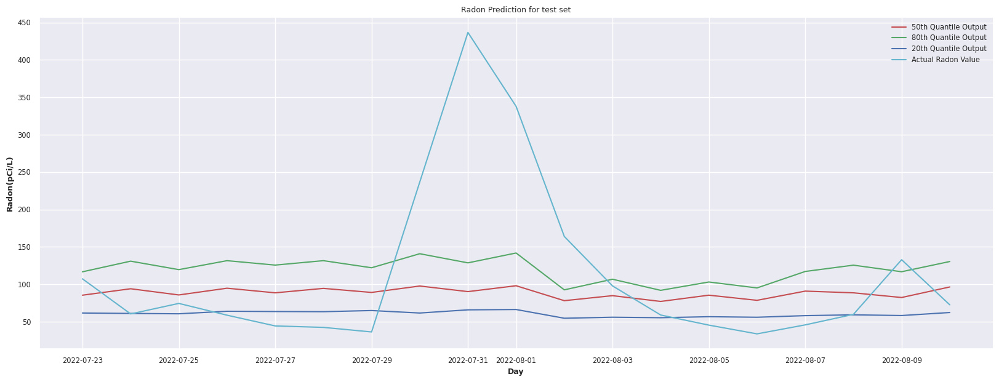

In [61]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()